# Preliminaries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
import seaborn as sns

pd.set_option('display.max_columns', None)

In [3]:
dataset = pd.read_csv('df_merged_no_nans.csv')
dataset.loc[dataset['basicMonthlySalary'] < 100, 'basicMonthlySalary'] *= 1000
dataset
# dataset = dataset.drop('Unnamed: 0', axis=1)

# cols_to_drop = [
#     'id', 'fullName', 'firstName', 'middleName', 'lastName', 'mobileNumber',
#     'dateEntry', 'mobilePrefix', 'address', 'occupation'
# ]
cols_to_drop = [
    'id', 'fullName', 'firstName', 'lastName', 'address', 'dateEntry', 'occupation'
]

dataset = dataset.drop(cols_to_drop, axis=1)

boolean_columns = [col for col in dataset.columns if dataset[col].dtype == bool]
dataset[boolean_columns] = dataset[boolean_columns].apply(lambda x: x.astype('int64'))

columns_to_move = ['lastFirstName', 'age', 'gender', 'province', 'job']
columns_remaining = [col for col in dataset.columns if col not in columns_to_move]

new_column_order = columns_to_move + columns_remaining
dataset = dataset[new_column_order]
dataset.insert(0, 'userId', dataset.pop('userId'))

def map_ageing_class(row):
    found_in_hdmf = row['foundInHDMF']
    home_ownership_class = row['home_ownership_class']

    if home_ownership_class == 0:
        return np.nan
    elif found_in_hdmf in [' Current', 'FP', '01 mos', '02 mos', '03 mos']:
        return 0
    elif found_in_hdmf in ['04 mos', '05 mos']:
        return 1

# One-hot encoding of categorical columns
# dataset = pd.get_dummies(dataset, columns=['gender'], prefix='gender', drop_first='True')
# dataset = pd.get_dummies(dataset, columns=['province'], prefix='province')
# dataset = pd.get_dummies(dataset, columns=['job'], prefix='job')

dataset['home_ownership_class'] = ((dataset['foundInOS'] != 'False') |
                                   (dataset['foundInHDMF'] != 'False')).astype('int64')



# dataset['ageing_class'] = dataset['home_ownership_class'].astype('int64')
# dataset['ageing_class'] = dataset.apply(map_ageing_class, axis=1)

cols_to_drop = ['foundInOS', 'foundInHDMF']
dataset = dataset.drop(cols_to_drop, axis=1)

dataset

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,MALE,METRO MANILA,SERVICE AND SALES,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,FEMALE,METRO MANILA,SERVICE AND SALES,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
3,1719,"OSCARES, ELMER",32,MALE,UNKNOWN,MACHINE OPERATOR,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0
1066,12852,"TEJADA, JERIC",27,MALE,LAGUNA,CRAFT AND TRADE,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,FEMALE,CAVITE,SERVICE AND SALES,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# HO_T01

In [4]:
ho_t01 = dataset.copy()
ho_t01_num = ho_t01.drop(columns=['gender', 'province', 'job'])
ho_t01

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,MALE,METRO MANILA,SERVICE AND SALES,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,FEMALE,METRO MANILA,SERVICE AND SALES,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
3,1719,"OSCARES, ELMER",32,MALE,UNKNOWN,MACHINE OPERATOR,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0
1066,12852,"TEJADA, JERIC",27,MALE,LAGUNA,CRAFT AND TRADE,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,FEMALE,CAVITE,SERVICE AND SALES,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# Outlier Analysis

In [5]:
from sklearn.covariance import EllipticEnvelope
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest

def plot_hist_ee(df, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = EllipticEnvelope(random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel('Elliptic Envelope scores')
    plt.ylabel('Frequency')
    plt.title(f'Elliptic Envelope score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ee(df, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'Elliptic Envelope, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_gmm(df, n_components, covariance_type='full', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = GaussianMixture(n_components=n_components,
                            covariance_type=covariance_type,
                            random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_components}-component Gaussian Mixture Model scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_components}-component Gaussian Mixture Model score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_gmm(df, n_components, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_components}-component Gaussian Mixture Model, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_lof(df, n_neighbors=20, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = LocalOutlierFactor(n_neighbors=n_neighbors)
    model.fit(scaled_data)
    
#     model_scores = model.score_samples(scaled_data)
    model_scores = model.negative_outlier_factor_
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_lof(df, n_neighbors, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_ocsvm(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_hist_ocsvm2(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'ageing_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ocsvm(df, kernel, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

def plot_hist_if(df, n_estimators=100, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = IsolationForest(n_estimators=n_estimators, random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_estimators}-estimator Isolation Forest (IF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_if(df, n_estimators, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

## Elliptic Envelope

In [6]:
# scores = plot_hist_ee(ho_t01_num, bins=10_000, xlim=-1e8)

In [25]:
# for i in np.arange(-1e11, 1, 2e10):
#     plot_ee(ho_t01, scores, i)

## Gaussian Mixture Model (GMM)

### 1-component GMM

In [7]:
# k = 1

# scores = plot_hist_gmm(ho_t01_num, k, covariance_type='full',
#                        bins=1_000)

In [8]:
# for i in np.arange(-600, -150, 30):
#     plot_gmm(ho_t01, k, scores, i)

## Local Outlier Factor

## One-Class SVM

## Isolation Forest

In [9]:
# k = 'rbf'

# scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
#                          bins=1_000)

# ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
# print(ho_t01_outliers)

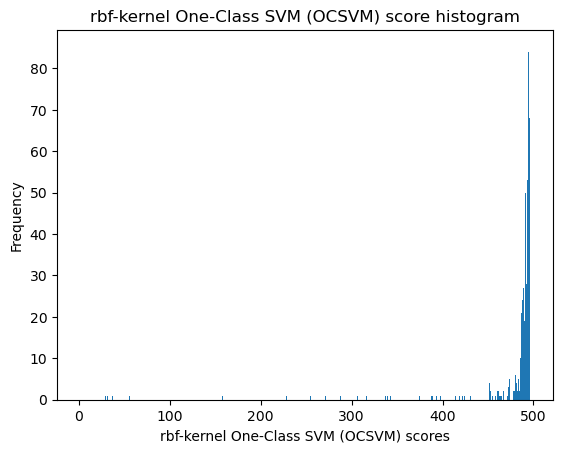

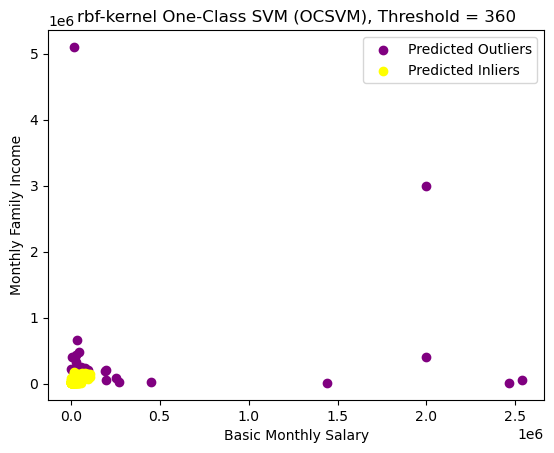

Number of predicted outliers: 38


,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,pred_outlier
14,5415,"LAMOSTE, JO-ANN",36,2534900,3,2,5,50000.0,5000,5000,5000,5000,4000,5000,2000,5000,1000,5000,10000,10000,1000,2500,4500,5000,500,5000,5000,5000,5000,2500,2500,5500,5000,5000,5000,5000,500,500,100,1,1,5000,1,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,True
24,8342,"VALDEZ, MOSES",28,50000,3,4,8,200000.0,10000,10000,10000,4000,0,0,0,0,0,2100,10000,1000,2000,2000,0,1000,0,2000,2000,2000,1000,599,1899,0,0,0,0,0,0,0,0,0,0,10000,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
32,9274,"ALMUETE, CRISTEL",35,200000,3,2,3,50000.0,2000,1000,500,1000,100,100,1500,2000,1000,1000,1000,1000,500,500,2000,1000,500,500,500,1000,500,700,500,100,100,100,100,1000,100,100,100,100,100,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,True
50,9989,"BITAS, SHARRAH",23,37266,3,2,4,50000.0,6000,2000,2000,2500,0,0,0,0,0,0,5000,1000,300,2500,0,0,0,0,0,500,500,100,1500,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
70,10503,"CASTRO, GLENDA",46,200000,3,1,5,200000.0,5000,1000,500,1000,500,1000,1000,500,500,500,1000,0,1000,1000,2000,0,0,0,100,500,500,500,1000,0,0,0,0,0,0,0,0,0,0,5000,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,1,True
114,10596,"ALERE, DINOS",40,19000,1,0,0,190000.0,1,3,4,3,1,1,1,2,2,1,4,4,5,5,4500,2,6,6,6,6,6,8,2,8,8,8,8,6,9,9,9,9,9,10,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,True
162,10679,"GONEZ, JAMES",25,80000,3,2,3,203000.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,1,True
200,10764,"SANTOS, JOHN CARLO",27,60000,3,1,5,65000.0,5000,1000,500,500,0,0,0,0,0,0,20000,5000,500,6000,0,1000,300,300,300,300,300,0,1625,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,True
231,11170,"SANTOR, EMELITA",54,7500,1,6,3,16000.0,1000,500,100,48,0,0,0,0,0,0,0,0,100,150,150000,0,0,0,0,0,0,20,366,0,0,10,0,24,0,0,0,0,0,1000,0,0,1,1,0,0,0,0,1,1,0,0,1,1,0,0,True
253,11201,"ABALOS, GLYNN",36,80000,3,2,2,230000.0,13000,2000,1000,3640,0,0,0,0,0,0,0,0,2275,3900,57200,0,0,3000,0,0,0,1300,1625,0,0,0,0,0,0,0,0,0,0,50000,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,True


[14, 24, 32, 50, 70, 114, 162, 200, 231, 253, 299, 323, 325, 380, 391, 405, 417, 435, 515, 556, 558, 563, 568, 584, 608, 677, 692, 702, 706, 762, 773, 830, 868, 912, 929, 940, 1009, 1046]


In [6]:
k = 'rbf'

scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
                         bins=1_000)

ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
print(ho_t01_outliers)

# EDA on Dataset

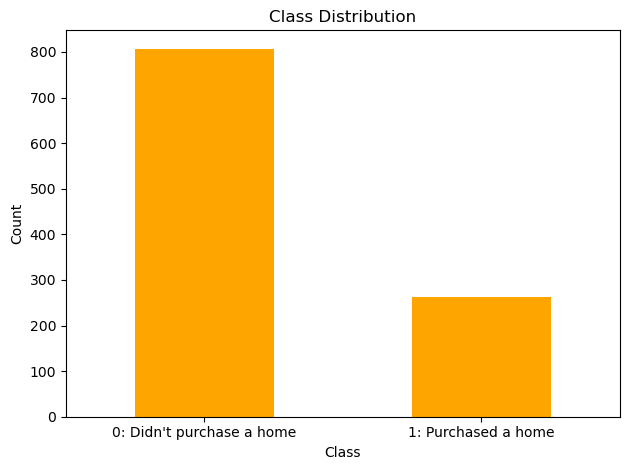

In [7]:
df = ho_t01
class_counts = df['home_ownership_class'].value_counts()
class_counts = class_counts.rename({0: "0: Didn't purchase a home",
                                    1: "1: Purchased a home"})

# Plot
# plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar', color='orange')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [10]:
pd.__version__

'1.5.3'

# HO_T01: Original

In [8]:
# ho_t01

# HO_T02: OHE Original, VarThresh

In [9]:
ho_t02 = ho_t01.copy()
ho_t02 = pd.get_dummies(ho_t02, columns=['gender'], prefix='gender', drop_first='True')
ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

In [10]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t02_X = ho_t02.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t02_y = ho_t02.copy()[['home_ownership_class']]
# ho_t02_y

In [11]:
from sklearn.feature_selection import VarianceThreshold

In [12]:
df = ho_t02_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t02_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [13]:
ho_t02_X_f02 = ho_t02_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
# ho_t02_X_f02 = ho_t02_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t02_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t02_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)

cinema | gambling | Correlation: 0.9071628455995576
cinema | smallLottery | Correlation: 0.9034179721740393
cinema | otherVices | Correlation: 0.9092351539530946
alcohol | gambling | Correlation: 0.9279949020777091
alcohol | smallLottery | Correlation: 0.9255905923368998
alcohol | otherVices | Correlation: 0.9232576094080833
gambling | smallLottery | Correlation: 0.9944469455269906
gambling | otherVices | Correlation: 0.9903118675408641
smallLottery | otherVices | Correlation: 0.9940848459135442

After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1066,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1067,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,0.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1068,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [14]:
ho_t02_X_f02 = ho_t02.copy().drop(columns=filtered_out_columns)
# ho_t02_X_f02 = ho_t02_X_f02.copy().drop(columns=cols_to_drop)
ho_t02_X_f02

ho_t02 = ho_t02_X_f02.copy()

In [15]:
ho_t02

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1,1,0,1,0,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0,0,0,1,0,1
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0,1,0,1,0,1
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1,1,0,0,0,0
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0,1,0,1,1,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0,0,1,0,0,1
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0,0,0,0,0,1


# HO_T03: OHE, VarThresh, Removed correlated features

In [16]:
ho_t03 = ho_t01.copy()
ho_t03 = pd.get_dummies(ho_t03, columns=['gender'], prefix='gender', drop_first='True')
ho_t03 = pd.get_dummies(ho_t03, columns=['province'], prefix='province')
ho_t03 = pd.get_dummies(ho_t03, columns=['job'], prefix='job')
# ho_t02

In [17]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t03_X = ho_t03.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t03_y = ho_t03.copy()[['home_ownership_class']]
# ho_t02_y

In [18]:
df = ho_t03_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t03_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [19]:
ho_t03_X_f02 = ho_t03_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
ho_t03_X_f02 = ho_t03_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t03_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t03_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1066,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1067,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1068,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [20]:
ho_t03_X_f02 = ho_t03.copy().drop(columns=filtered_out_columns)
ho_t03_X_f02 = ho_t03_X_f02.copy().drop(columns=cols_to_drop)
ho_t03_X_f02

ho_t03 = ho_t03_X_f02.copy()

In [21]:
ho_t03

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1,1,0,1,0,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0,0,0,1,0,1
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,100,100,100,200,200,200,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0,1,0,1,0,1
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,100,200,400,0,0,0,0,0,876,0,0,500,1,0,0,1,0,1,0,1,1,0,0,0,0
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,500,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0,1,0,1,1,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,500,1,0,1,1,0,0,0,0,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,1000,0,0,0,300,0,0,0,500,0,0,0,0,2000,0,0,0,1,0,1,0,0,0,1,0,0,1
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0,0,0,0,0,1


# HO_T04: OHE, Removed Outliers, VarThresh

In [22]:
ho_t04 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t04

In [23]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t04))
print(f"Number of positive class points: {(ho_t04['home_ownership_class'] == 1).sum()}, {(ho_t04['home_ownership_class'] == 1).sum() / len(ho_t04) :.1%}")
print(f"Number of negative class points: {(ho_t04['home_ownership_class'] == 0).sum()}, {(ho_t04['home_ownership_class'] == 0).sum() / len(ho_t04) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [24]:
ho_t04 = pd.get_dummies(ho_t04, columns=['gender'], prefix='gender', drop_first='True')
ho_t04 = pd.get_dummies(ho_t04, columns=['province'], prefix='province')
ho_t04 = pd.get_dummies(ho_t04, columns=['job'], prefix='job')
# ho_t02

In [25]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t04_X = ho_t04.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t04_y = ho_t04.copy()[['home_ownership_class']]
# ho_t02_y

In [26]:
df = ho_t04_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t04_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [27]:
ho_t04_X_f02 = ho_t04_X_f01.copy()
# cols_to_drop = [
#     'smallLottery', 'otherVices', 'alcohol', 'cinema'
# ]
# ho_t04_X_f02 = ho_t04_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t04_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t04_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)

cinema | alcohol | Correlation: 0.9019659670569984
cinema | gambling | Correlation: 0.9133348945332308
cinema | smallLottery | Correlation: 0.9097980167545852
cinema | otherVices | Correlation: 0.9099542412290466
alcohol | gambling | Correlation: 0.9333895599687774
alcohol | smallLottery | Correlation: 0.9312160098441578
alcohol | otherVices | Correlation: 0.932142262462858
gambling | smallLottery | Correlation: 0.99447768866585
gambling | otherVices | Correlation: 0.9935861638948069
smallLottery | otherVices | Correlation: 0.9973344027764826

After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1028,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1029,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,0.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1030,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [28]:
ho_t04_X_f02 = ho_t04.copy().drop(columns=filtered_out_columns)
# ho_t04_X_f02 = ho_t04_X_f02.copy().drop(columns=cols_to_drop)
ho_t04_X_f02

ho_t04 = ho_t04_X_f02.copy()

# HO_T05: OHE, Removed Outliers, VarThresh, Removed highly correlated features

In [29]:
ho_t05 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [30]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t05))
print(f"Number of positive class points: {(ho_t05['home_ownership_class'] == 1).sum()}, {(ho_t05['home_ownership_class'] == 1).sum() / len(ho_t05) :.1%}")
print(f"Number of negative class points: {(ho_t05['home_ownership_class'] == 0).sum()}, {(ho_t05['home_ownership_class'] == 0).sum() / len(ho_t05) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [31]:
ho_t05 = pd.get_dummies(ho_t05, columns=['gender'], prefix='gender', drop_first='True')
ho_t05 = pd.get_dummies(ho_t05, columns=['province'], prefix='province')
ho_t05 = pd.get_dummies(ho_t05, columns=['job'], prefix='job')
# ho_t02

In [32]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t05_X = ho_t05.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t05_y = ho_t05.copy()[['home_ownership_class']]
# ho_t02_y

In [33]:
df = ho_t05_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t05_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [34]:
ho_t05_X_f02 = ho_t05_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema'
]
ho_t05_X_f02 = ho_t05_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t05_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t05_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,24.0,19000.0,2.0,3.0,3.0,40000.0,1000.0,500.0,200.0,200.0,0.0,0.0,0.0,50.0,0.0,0.0,500.0,450.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,26.0,15000.0,3.0,2.0,4.0,30000.0,5000.0,3000.0,2000.0,2000.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,0.0,200.0,200.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0
2,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
3,32.0,21200.0,2.0,0.0,5.0,12000.0,2000.0,500.0,200.0,392.0,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0,200.0,200.0,3000.0,0.0,0.0,0.0,100.0,200.0,400.0,0.0,0.0,0.0,0.0,0.0,876.0,0.0,0.0,500.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
4,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,34.0,19000.0,2.0,2.0,4.0,19000.0,5000.0,1000.0,1000.0,1.0,1.0,1.0,1000.0,500.0,1.0,1000.0,1000.0,500.0,200.0,1500.0,5000.0,1000.0,1.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
1028,27.0,20000.0,2.0,1.0,1.0,20000.0,5000.0,500.0,400.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,1672.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1029,27.0,13962.0,1.0,2.0,4.0,40000.0,4.0,2.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,0.0,30000.0,1000.0,150.0,1000.0,2000.0,500.0,1000.0,0.0,0.0,0.0,300.0,0.0,0.0,0.0,500.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
1030,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [35]:
ho_t05_X_f02 = ho_t05.copy().drop(columns=filtered_out_columns)
ho_t05_X_f02 = ho_t05_X_f02.copy().drop(columns=cols_to_drop)
ho_t05_X_f02

ho_t05 = ho_t05_X_f02.copy()

# HO_T06: OHE, Removed Outliers, VarThresh, Removed highly correlated features via VIF

In [36]:
ho_t06 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [37]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t06))
print(f"Number of positive class points: {(ho_t06['home_ownership_class'] == 1).sum()}, {(ho_t06['home_ownership_class'] == 1).sum() / len(ho_t06) :.1%}")
print(f"Number of negative class points: {(ho_t06['home_ownership_class'] == 0).sum()}, {(ho_t06['home_ownership_class'] == 0).sum() / len(ho_t06) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 1070
Number of positive class points: 263, 24.6%
Number of negative class points: 807, 75.4%

OUTLIERS REMOVED
Number of outliers: 38
Number of positive class outliers: 15, 39.5%
Number of negative class outliers: 23, 60.5%

AFTER OUTLIER REMOVAL
Number of data points: 1032
Number of positive class points: 248, 24.0%
Number of negative class points: 784, 76.0%


In [38]:
ho_t06 = pd.get_dummies(ho_t06, columns=['gender'], prefix='gender', drop_first='True')
ho_t06 = pd.get_dummies(ho_t06, columns=['province'], prefix='province')
ho_t06 = pd.get_dummies(ho_t06, columns=['job'], prefix='job')
# ho_t02

In [39]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t06_X = ho_t06.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t06_y = ho_t06.copy()[['home_ownership_class']]
# ho_t02_y

In [40]:
df = ho_t06_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t06_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 48
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERAT

In [41]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t06_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [42]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'otherVices',
 'gambling',
 'age',
 'preferredNetDisposableIncomeId',
 'houseOnlyFamily',
 'alcohol']

In [43]:
ho_t06_X_f02 = ho_t06.copy().drop(columns=filtered_out_columns)
ho_t06_X_f02 = ho_t06_X_f02.copy().drop(columns=columns_to_remove)
ho_t06_X_f02

ho_t06 = ho_t06_X_f02.copy()

# HO_T07 (discarded): OHE, VarThresh, Removed highly correlated features via VIF

In [204]:
ho_t07 = ho_t01.copy()

# ho_t05

In [205]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [206]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [207]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [208]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [209]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [ ]:
ho_t07_X_f02 = ho_t07.copy().drop(columns=filtered_out_columns)
ho_t07_X_f02 = ho_t07_X_f02.copy().drop(columns=columns_to_remove)
ho_t07_X_f02

ho_t07 = ho_t07_X_f02.copy()

# HO_T07: OHE, VarThresh, Added new features (retained only those won't be removed by VIF)

In [60]:
df = ho_t01.copy()

# df['monthlyFamilyIncome - basicMonthlySalary'] = df['monthlyFamilyIncome'] - df['basicMonthlySalary']
df['monthlyVices'] = (
    df['smoking'] + df['alcohol'] + df['gambling'] +
    df['smallLottery'] + df['otherVices']
)
df['monthlyUtilityBills'] = (
    df['water'] + df['electricity'] + df['rent'] +
    df['internet'] + df['mobileLoad']
)
df['totalMonthlyExpenses'] = (
    df['food'] + df['hygiene'] + df['houseCleaning'] +
    df['fare'] + df['parking'] + df['gasoline'] +
    df['tuition'] + df['allowance'] + df['uniform'] +
    df['otherEducation'] + df['emergency'] + df['medicine'] +
    df['repair'] + df['cinema'] + df['dineOut'] +
    df['leisure'] + df['personalCare'] + df['clothing'] +
    df['vehicleLoan'] + df['monthlyUtilityBills'] +
    df['informalLenders'] + df['companyLoan'] + df['privateLoans'] +
    df['governmentLoans'] + df['monthlyVices']
)
# df['monthlyFamilyIncome - totalMonthlyExpenses'] = df['monthlyFamilyIncome'] - df['totalMonthlyExpenses']
# df['basicMonthlySalary - totalMonthlyExpenses'] = df['basicMonthlySalary'] - df['totalMonthlyExpenses']
# df['monthlyFamilyIncome / workingFamilyCount'] = np.where(
#     df['workingFamilyCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['workingFamilyCount']
# )
# df['monthlyFamilyIncome / residentsCount'] = np.where(
#     df['residentsCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['residentsCount']
# )
df['basicMonthlySalary / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['basicMonthlySalary'] / df['monthlyFamilyIncome']
)
df['totalMonthlyExpenses / basicMonthlySalary'] = np.where(
    df['basicMonthlySalary'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['basicMonthlySalary']
)
df['totalMonthlyExpenses / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['monthlyFamilyIncome']
)
# df['monthlyVices / basicMonthlySalary'] = np.where(
#     df['basicMonthlySalary'] == 0,
#     0,
#     df['monthlyVices'] / df['basicMonthlySalary']
# )

ho_t07 = df.copy()

In [61]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [62]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [63]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [64]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

divide by zero encountered in scalar divide


In [65]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['vehicleLoan',
 'gambling',
 'rent',
 'repair',
 'cinema',
 'dineOut',
 'leisure',
 'personalCare',
 'clothing',
 'mobileLoad',
 'internet',
 'smallLottery',
 'informalLenders',
 'companyLoan',
 'privateLoans',
 'governmentLoans',
 'smoking',
 'electricity',
 'water',
 'medicine',
 'houseCleaning',
 'totalMonthlyExpenses',
 'monthlyUtilityBills',
 'monthlyVices',
 'otherVices',
 'food',
 'hygiene',
 'fare',
 'emergency',
 'parking',
 'gasoline',
 'tuition',
 'allowance',
 'uniform',
 'otherEducation',
 'alcohol',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

# HO_T08: Dropped cat features, VarThresh

In [66]:
ho_t08 = ho_t01.copy().drop(columns=['gender', 'province', 'job'])

# ho_t05

In [67]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t08_X = ho_t08.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t08_y = ho_t08.copy()[['home_ownership_class']]
# ho_t02_y

In [68]:
df = ho_t08_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t08_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 8
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee']


In [69]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t08_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [70]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [71]:
ho_t08 = ho_t08.copy().drop(columns=filtered_out_columns)
# ho_t08_X_f02 = ho_t08_X_f02.copy().drop(columns=columns_to_remove)
ho_t08

ho_t08 = ho_t08.copy()

In [72]:
ho_t08

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0


# Functions for Classification Modeling and Others

In [44]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [45]:
# ho_t02.info()

In [46]:
ho_t02['userId'] = ho_t02['userId'].astype('str')
ho_t02 = adjust_data_types(ho_t02)
ho_t02.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [47]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from lightgbm import LGBMClassifier
from xgboost.sklearn import XGBClassifier

from sklearn.feature_selection import RFE, RFECV, VarianceThreshold

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer, confusion_matrix, roc_curve
from sklearn.model_selection import GridSearchCV, StratifiedKFold, permutation_test_score
from sklearn.base import clone


from imblearn.metrics import geometric_mean_score
import shap

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline

import dice_ml

from catboost import CatBoostClassifier

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
UserConfigValidationException will be deprecated from dice_ml.utils. Please import UserConfigValidationException from raiutils.exceptions.


In [48]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)
    return specificity

specificity_scorer = make_scorer(specificity_score)

def npv_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    npv = tn / (tn + fn)
    return npv

npv_scorer = make_scorer(npv_score)

g_mean_scorer = make_scorer(geometric_mean_score)


skf = StratifiedKFold(10, shuffle=True, random_state=0)

# def get_cat_cols(df):
#     one_hot_encoded_columns = []

#     for idx, column in enumerate(df.columns):
#         if df[column].nunique() == 2 and set(df[column].unique()) == {0, 1}:
#             one_hot_encoded_columns.append(idx)

#     return one_hot_encoded_columns

def get_cat_cols(df):
    return df.select_dtypes(include=['object']).columns.tolist()

# get_cat_cols(ho_t02)
# cat_cols = get_cat_cols(ho_t02)
# num_cols = [col for col in ho_t02.columns if col not in cat_cols]
# cat_cols, num_cols

In [49]:
from sklearn.decomposition import PCA

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours, TomekLinks
from imblearn.combine import SMOTEENN, SMOTETomek


from sklearn.base import BaseEstimator, TransformerMixin

class DropCategoricalFeatures(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Assuming X is a DataFrame
        non_categorical_cols = X.select_dtypes(exclude=['object']).columns.tolist()
        return X[non_categorical_cols]


def knn_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', KNeighborsClassifier())
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_neighbors': list(range(1, 16)),
        'classifier__metric': ['euclidean', 'cosine', 'hamming', 'braycurtis',
                               'chebyshev', 'canberra', 'cityblock', 'sqeuclidean'
                              ]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

#         y_hat = modified_estimator.predict_proba(X_test)[:, 1]

#         fpr, tpr, thresholds = roc_curve(y_test, y_hat)
#         gmeans = np.sqrt(tpr * (1-fpr))
#         ix = np.argmax(gmeans)
#         print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

#         plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
#         plt.plot(fpr, tpr, marker='.', label='Original')
#         plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

#         plt.xlabel('False Positive Rate')
#         plt.ylabel('True Positive Rate')
#         plt.legend()

#         plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def svm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', SVC(random_state=random_state, max_iter=1000,
                           verbose=True))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__probability': [True, False],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def logreg_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
#         ('drop_categorical', None),
#         ('encoder', None),
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LogisticRegression(random_state=random_state, max_iter=1000))
    ])

    param_grid = {
#         'drop_categorical': [None, DropCategoricalFeatures()]
#         'encoder': [None, OneHotEncoder(sparse_output=False)],
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__penalty': ['l2', None],
        'classifier__solver': ['liblinear', 'lbfgs', 'newton-cholesky']
#         'classifier__penalty': ['l1', l2', 'elasticnet', 'None']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df



def dt_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]


    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', DecisionTreeClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(), 
#             RobustScaler(),
#             MinMaxScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
            SMOTEENN(random_state=random_state),
            SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
            TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
#         'classifier__max_depth': [3],
# #         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [1],
#         'classifier__max_depth': [2, 5],
#         'classifier__min_samples_split': [3],
#         'classifier__min_samples_leaf': [3],
# #         'classifier__max_features': ['auto', 'sqrt', 'log2', None],
#         'classifier__criterion': ["entropy", "log_loss"]
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [2, 3],
        'classifier__max_depth': [2, 3, 5],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [1, 2, 3],
        'classifier__max_features': ['auto', 'sqrt', 'log2', None],
        'classifier__criterion': ["gini", "entropy", "log_loss"]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.decomposition import TruncatedSVD

def rf_class2(df, scorer, label_col, random_state=0):
#     df_majority = df[df.home_ownership_class == 0]
#     df_minority = df[df.home_ownership_class == 1]

# #     display(df_majority)
# #     display(df_minority)
# #     print(len(df_majority), len(df_minority))
#     # Randomly downsample majority class
#     df_majority_downsampled = df_majority.sample(frac=0.2,
#                                                  random_state=random_state)
#     df = pd.concat([df_majority_downsampled, df_minority], axis=0)

    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)

#     n_components = X_scaled.shape[1]  # Maximum number of components
#     svd = TruncatedSVD(n_components=n_components)
#     X_svd = svd.fit_transform(X_scaled)

#     # Step 3: Find number of components that explain at least 90% variance
#     cum_variance = np.cumsum(svd.explained_variance_ratio_)
#     num_components = np.argmax(cum_variance >= 0.90) + 1  # +1 because Python indexing starts from 0
#     X_selected = X_svd[:, :num_components]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

#     X_resampled, y_resampled = RandomOverSampler(random_state=random_state).fit_resample(X_train, y_train)
#     class_counts_original = np.bincount(y_train.astype(int))
#     class_counts_resampled = np.bincount(y_resampled.astype(int))

    # Assuming 0 is the majority class, calculate its upweight factor
#     majority_class_original = class_counts_original[0]
#     majority_class_resampled = class_counts_resampled[0]
#     upweight_factor = majority_class_original / majority_class_resampled

#     minority_class_original = class_counts_original[1]
#     minority_class_resampled = class_counts_resampled[1]
#     downweight_factor = minority_class_original / minority_class_resampled

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', RandomForestClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_estimators': [200, 300],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__oob_score': [True, False],
        'classifier__criterion': ["gini", "entropy", "log_loss"]

#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__oob_score': [True, False],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
    }
#         'classifier__n_estimators': [200, 250, 300],
# #         'classifier__max_depth': [2, 3, 4],
#         'classifier__max_depth': [2],
#         'classifier__class_weight': [{0: 263/807, 1:1}],
#         'classifier__oob_score': [True],
# #         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
#     }
    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         modified_estimator = best_estimator
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def gbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', GradientBoostingClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
        'classifier__n_estimators': [200, 250],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def lgbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     plt.figure(figsize=(10, 6))
#     plt.plot(range(1, len(explained_var_ratio)+1), cumulative_explained_var, marker='o', linestyle='--')
#     plt.title('Cumulative Explained Variance Plot')
#     plt.xlabel('Number of Components')
#     plt.ylabel('Cumulative Explained Variance')
#     plt.grid(True)
#     plt.show()

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LGBMClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [400, 450],
#         'classifier__learning_rate': [0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__max_depth': [2, 3],
#         'classifier__boosting_type': ['gbdt', 'dart', 'goss']

        'classifier__n_estimators': [200, 300, 400],
        'classifier__learning_rate': [0.1, 0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
        'classifier__max_depth': [2, 3],
        'classifier__boosting_type': ['gbdt', 'dart', 'goss']
    }
#         'classifier__num_leaves': [20, 31, 40],
#         'classifier__min_child_samples': [10, 20, 30],
#         'classifier__max_depth': [-1, 5, 10],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def xgb_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', XGBClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
# #         'classifier__n_estimators': [200, 250],
#         'classifier__learning_rate': [2, 3],
# #         'classifier__max_depth': [2, 3],
#         'classifier__max_leaves': [5],
#         'classifier__grow_policy': ['depthwise', 'lossguide']
        'classifier__n_estimators': [200, 250],
        'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__max_depth': [None, 2, 3],
        'classifier__max_leaves': [10, 20, 30],
        'classifier__grow_policy': ['depthwise', 'lossguide']
    }
#         'classifier__max_depth': [None, 5, 10],
#         'classifier__max_leaves': [0, 10, 20],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def adaboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', AdaBoostClassifier(
            random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)],
        'classifier__n_estimators': [200, 300],
        'classifier__estimator': [DecisionTreeClassifier(
            random_state=random_state,
#             criterion='entropy', max_depth=3,
#             min_samples_leaf=2, min_samples_split=2
        ),
                                  RandomForestClassifier(
            random_state=random_state,
#             max_depth=3, min_samples_leaf=2,
#             min_samples_split=2, n_estimators=250,
#             oob_score=True
                                                        )],
#         'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]


        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.linear_model import RidgeClassifier

def ridge_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]
    
    cat_transformer = Pipeline([
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    num_transformer = Pipeline([
        ('variance_threshold', VarianceThreshold(threshold=0.15))
    ])
    
    preprocessor = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols),
            ('cat', cat_transformer, cat_cols)
        ],
        remainder='passthrough'
    )

    preprocessor_num = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols)
        ],
        remainder='drop'
    )

    preprocessor_drop_cat = ColumnTransformer(
        transformers = [
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    pipeline = Pipeline([
#         ('preprocessor', None),
        ('preprocessor', preprocessor_drop_cat),
#         ('scaler', None),
        ('resampling', None),
        ('var_threshold', VarianceThreshold(threshold=0.15)),
        ('classifier', RidgeClassifier(max_iter=1000, random_state=random_state))
    ])

    param_grid = {
#         'preprocessor': [
#             preprocessor_drop_cat,
#             preprocessor,
#             preprocessor_num            
#         ],
        'resampling': [ADASYN(random_state=random_state),
                       SMOTEENN(random_state=random_state),
                       SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
                       TomekLinks(),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__alpha': [0.01, 0.1, 1, 10, 100, 1000],
        'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag', 'saga'],
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=10, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
            isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
            modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
        modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time) / 60

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def catboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', CatBoostClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_leaf': [2, 3],
#         'classifier__min_samples_split': [2, 3],
#         'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

# HO-T02 runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2006 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 5, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': TomekLinks()}
Best Validation Score (G-mean): 0.43520021645021645
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()), ('resampling', TomekLinks()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=5, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 95.81179904937744 secs
Run 1 - Random State: 0
Test G-mean: 0.3927982039710776
Best Threshold=0.217877, G-Mean=0.569


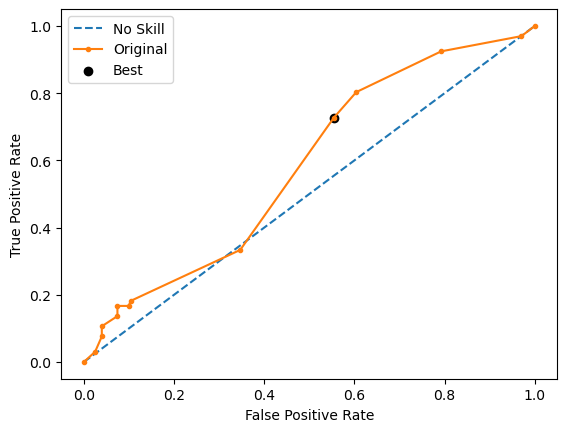

Run 2 - Random State: 1
Test G-mean: 0.31501575118134845
Best Threshold=0.389610, G-Mean=0.512


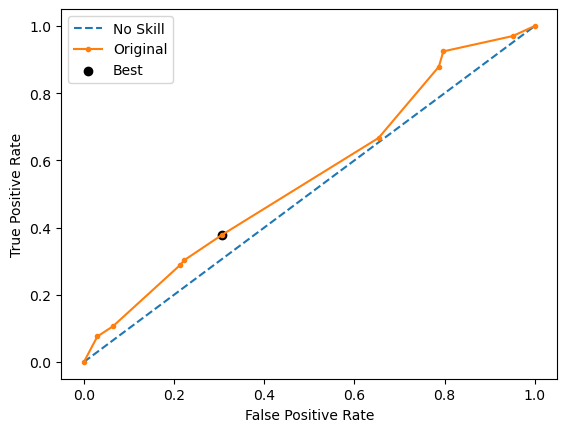

Run 3 - Random State: 2
Test G-mean: 0.374518392609282
Best Threshold=0.240223, G-Mean=0.613


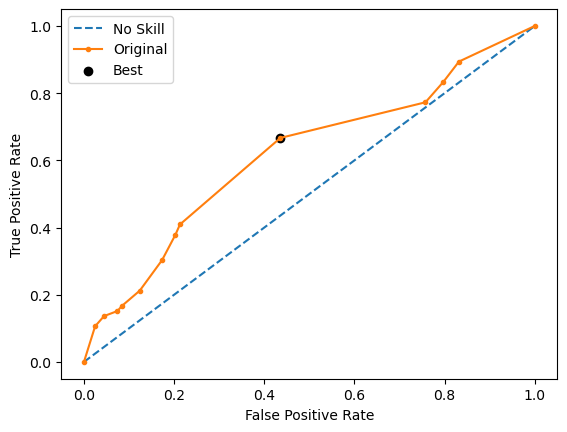

Run 4 - Random State: 3
Test G-mean: 0.39801487608399566
Best Threshold=0.242424, G-Mean=0.650


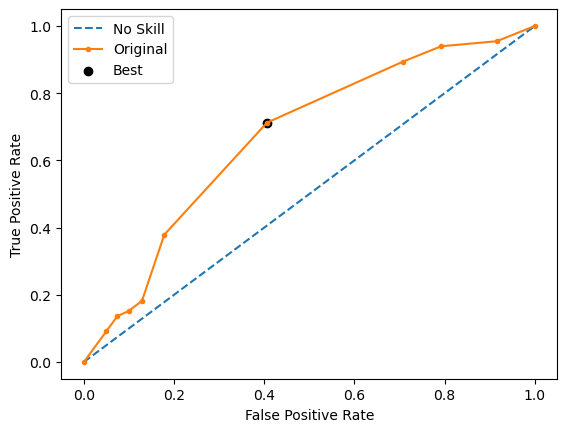

Run 5 - Random State: 4
Test G-mean: 0.3429457117039338
Best Threshold=0.333333, G-Mean=0.571


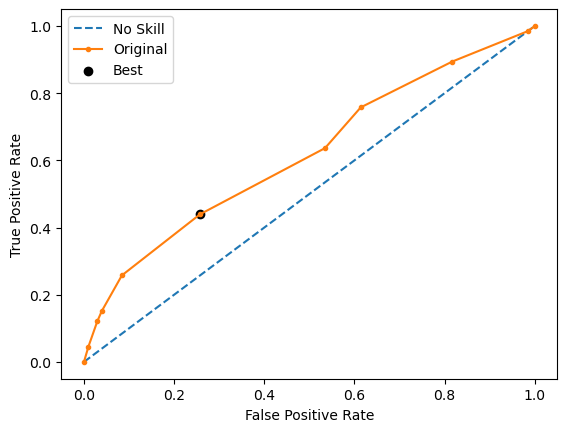

Ave Test G-mean: 0.3646585871099275
Stdev Test G-mean: 0.035133872306959676
Ave Test Specificity: 0.9257425742574258
Ave Test Recall: 0.14545454545454545
Ave Test NPV: 0.7682484613270273
Ave Test Accuracy: 0.7335820895522389
Ave Test Precision: 0.412058993637941
Ave Test F1-Score: 0.21049411660129555
Ave Runtime: 0.04039473533630371


In [47]:
ho_t02_dt_gs, ho_t02_dt_be, ho_t02_dt_model_info, ho_t02_dt_metrics_df = dt_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.3822507471888277
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.480350528512093
Std Train Score (G-mean) 0.02434942934215453
GridSearchCV Runtime: 1050.8129675388336 secs
Run 1 - Random State: 0
Test G-mean: 0.5005247771142309
Best Threshold=0.438449, G-Mean=0.624


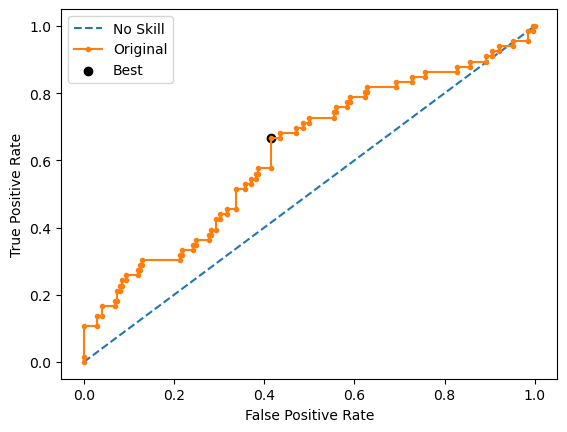

Run 2 - Random State: 1
Test G-mean: 0.5138349955387079
Best Threshold=0.462863, G-Mean=0.606


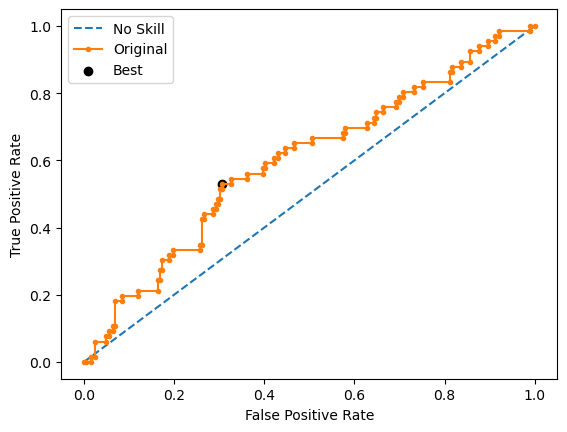

Run 3 - Random State: 2
Test G-mean: 0.5159473036677449
Best Threshold=0.441338, G-Mean=0.614


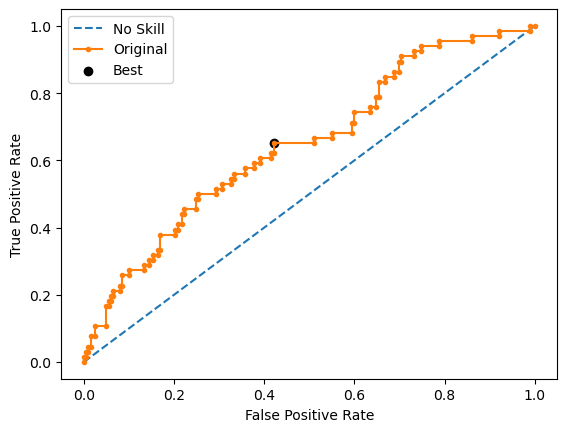

Run 4 - Random State: 3
Test G-mean: 0.506483615297925
Best Threshold=0.438868, G-Mean=0.623


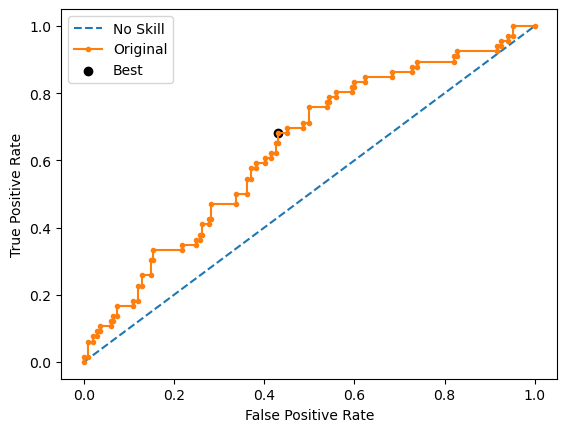

Run 5 - Random State: 4
Test G-mean: 0.5020211176038832
Best Threshold=0.457776, G-Mean=0.613


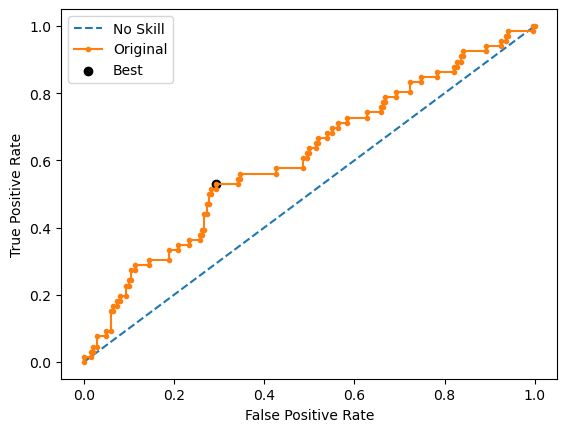

Ave Test G-mean: 0.5077623618444983
Stdev Test G-mean: 0.006907421073066079
Ave Test Specificity: 0.8267326732673267
Ave Test Recall: 0.31212121212121213
Ave Test NPV: 0.7862272144991105
Ave Test Accuracy: 0.7
Ave Test Precision: 0.3717604971281442
Ave Test F1-Score: 0.3388507452143816
Ave Runtime: 2.1067548274993895


In [48]:
ho_t02_rf_gs, ho_t02_rf_be, ho_t02_rf_model_info, ho_t02_rf_metrics_df = rf_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.3435174718212644
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1000.0, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 177.35126852989197 secs


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 1 - Random State: 0
Test G-mean: 0.5889267216456958
Best Threshold=0.481174, G-Mean=0.599


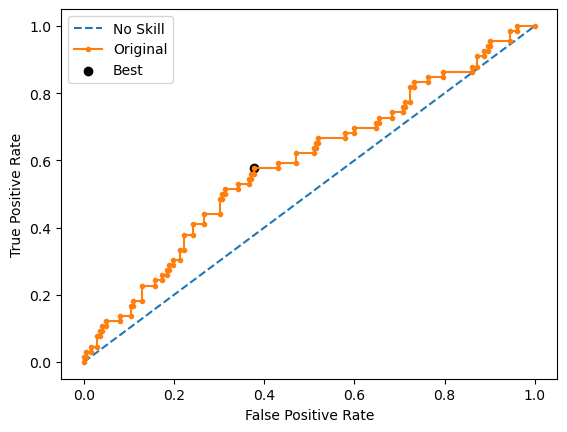

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.5455545462887259
Best Threshold=0.486568, G-Mean=0.592


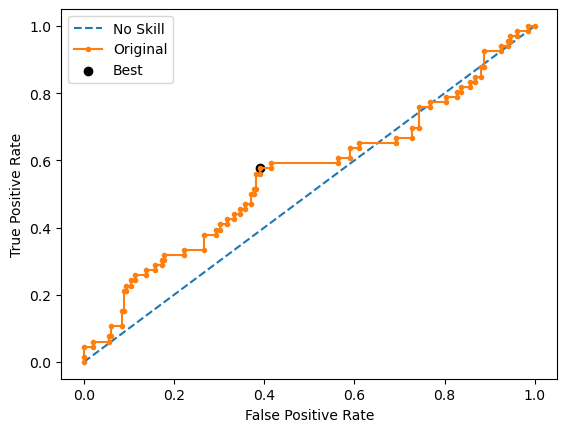

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 3 - Random State: 2
Test G-mean: 0.5682493209226676
Best Threshold=0.487350, G-Mean=0.580


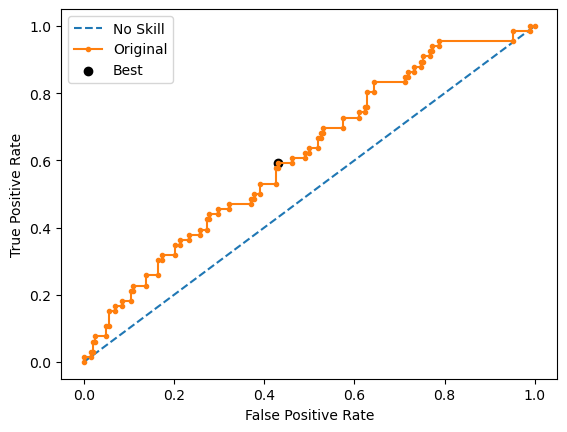

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 4 - Random State: 3
Test G-mean: 0.5391929829915173
Best Threshold=0.510902, G-Mean=0.556


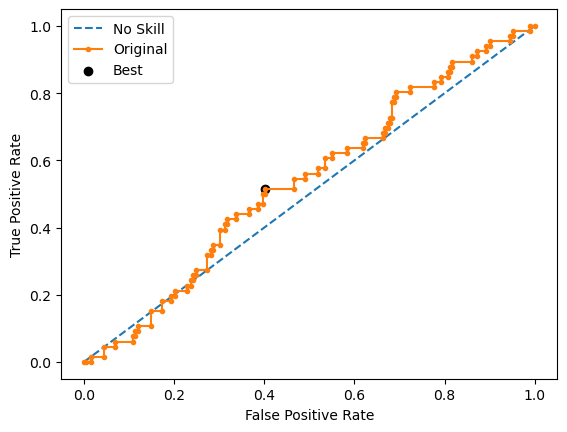

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 5 - Random State: 4
Test G-mean: 0.5672584756685631
Best Threshold=0.507887, G-Mean=0.576


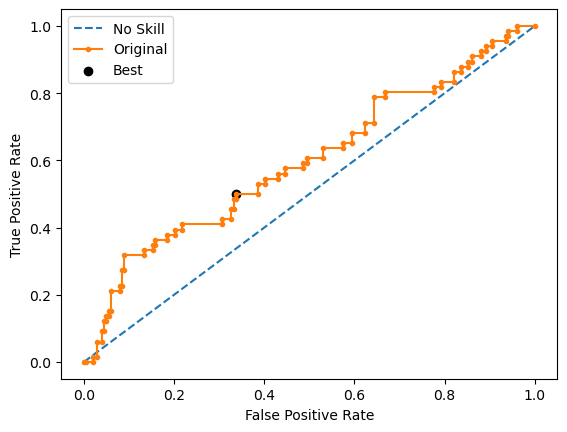

Ave Test G-mean: 0.5618364095034339
Stdev Test G-mean: 0.019888646763154782
Ave Test Specificity: 0.6247524752475248
Ave Test Recall: 0.5060606060606061
Ave Test NPV: 0.7943738223845795
Ave Test Accuracy: 0.5955223880597016
Ave Test Precision: 0.3070459755947245
Ave Test F1-Score: 0.3817535164922474
Ave Runtime: 0.9164715766906738


In [49]:
ho_t02_logreg_gs, ho_t02_logreg_be, ho_t02_logreg_model_info, ho_t02_logreg_metrics_df = logreg_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 10.0, 'classifier__kernel': 'poly', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(C=10.0, kernel='poly', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.3794389494611066
Std Train Score (G-mean) 0.07190913977284323
GridSearchCV Runtime: 458.7589271068573 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.2725021573172849
Best Threshold=0.415581, G-Mean=0.500


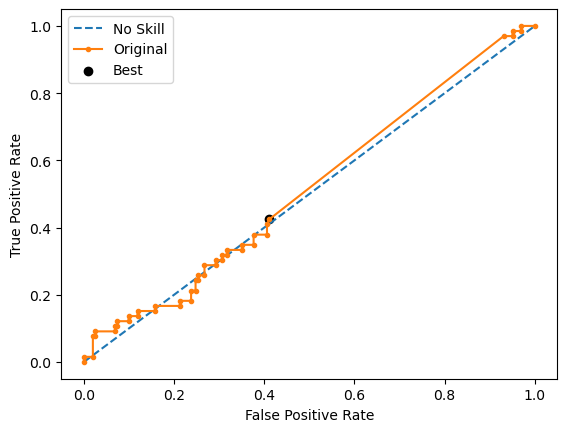

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.0
Best Threshold=0.404077, G-Mean=0.511


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
invalid value encountered in scalar divide


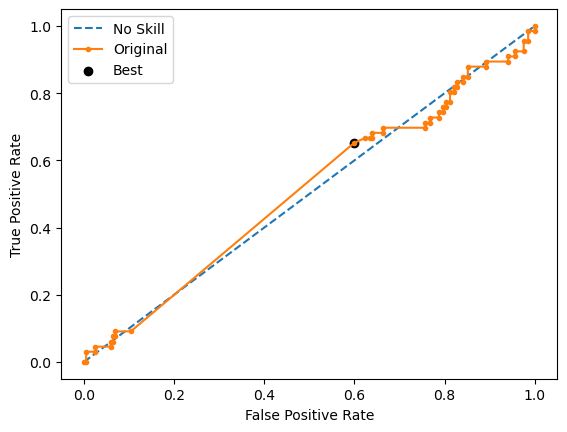

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.24496122264566697
Best Threshold=0.413015, G-Mean=0.532


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


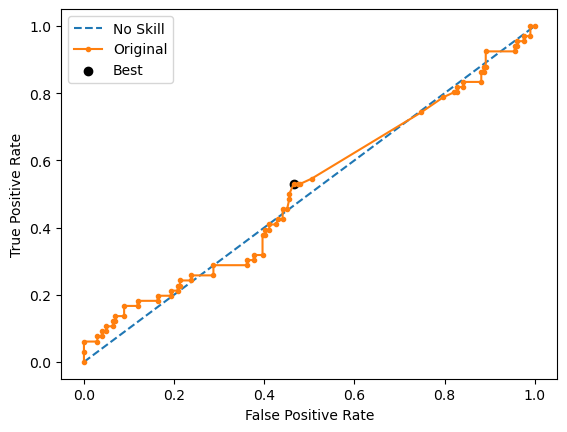

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.1224806113228335


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Threshold=0.405029, G-Mean=0.458


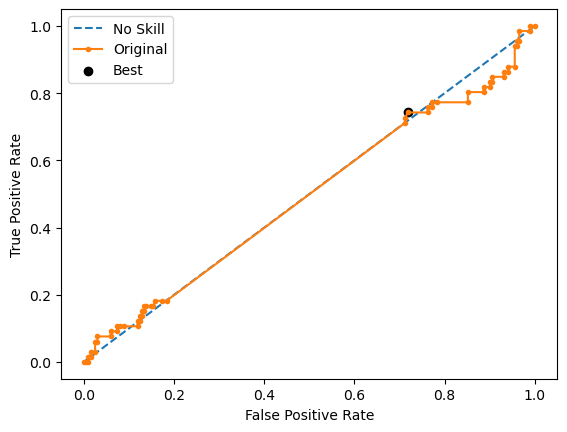

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.24187982674265854
Best Threshold=0.414703, G-Mean=0.499


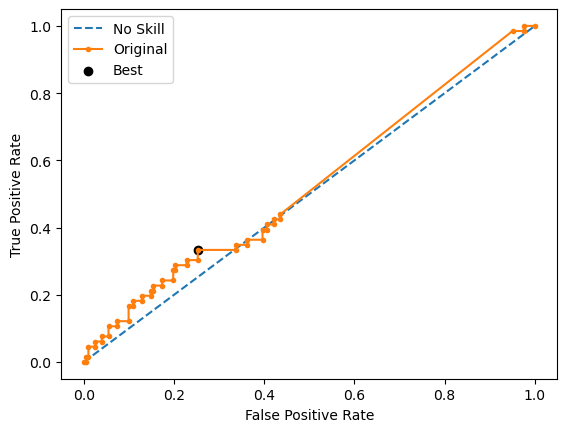

Ave Test G-mean: 0.17636476360568878
Stdev Test G-mean: 0.11428924694525662
Ave Test Specificity: 0.7851485148514852
Ave Test Recall: 0.24242424242424238
Ave Test NPV: 0.760327347012506
Ave Test Accuracy: 0.6514925373134328
Ave Test Precision: 0.4330921151816674
Ave Test F1-Score: 0.15450712728504973
Ave Runtime: 0.10776877403259277


In [50]:
ho_t02_svm_gs, ho_t02_svm_be, ho_t02_svm_model_info, ho_t02_svm_metrics_df = svm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [51]:
ho_t02_knn_gs, ho_t02_knn_be, ho_t02_knn_model_info, ho_t02_knn_metrics_df = knn_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 10, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4416666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=10))])
Mean Train Score (G-mean) 0.502546305163815
Std Train Score (G-mean) 0.016717624003737618
GridSearchCV Runtime: 319.8666570186615 secs
Run 1 - Random State: 0
Test G-mean: 0.24373333911071626
Run 2 - Random State: 1
Test G-mean: 0.0
Run 3 - Random State: 2
Test G-mean: 0.17190973007811267
Run 4 - Random State: 3
Test G-mean: 0.17103486572196108
Run 5 - Random State: 4
Test G-mean: 0.1224806113228335
Ave Test G-mean: 0.1418317092467247
Stdev Test G-mean: 0.09032185864022059
Ave Test Specificity: 0.9742574257425742
Ave Test Recall: 0.02727272727272727
Ave Test NPV: 0.7540188627501575
Ave Test Accu

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.3908496732026144
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.7804269732627283
Std Train Score (G-mean) 0.013860633559912256
GridSearchCV Runtime: 383.11739683151245 secs
Run 1 - Random State: 0
Test G-mean: 0.4371717190203308
Best Threshold=0.217907, G-Mean=0.575


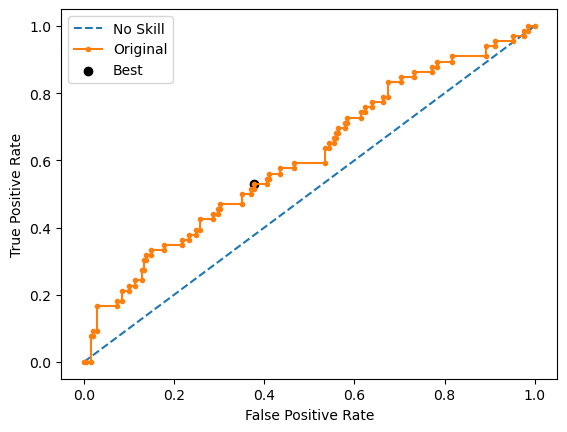

Run 2 - Random State: 1
Test G-mean: 0.39688254128288075
Best Threshold=0.213012, G-Mean=0.603


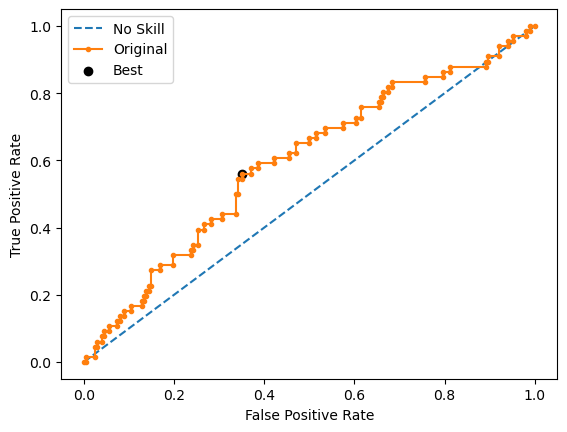

Run 3 - Random State: 2
Test G-mean: 0.4371717190203308
Best Threshold=0.165575, G-Mean=0.527


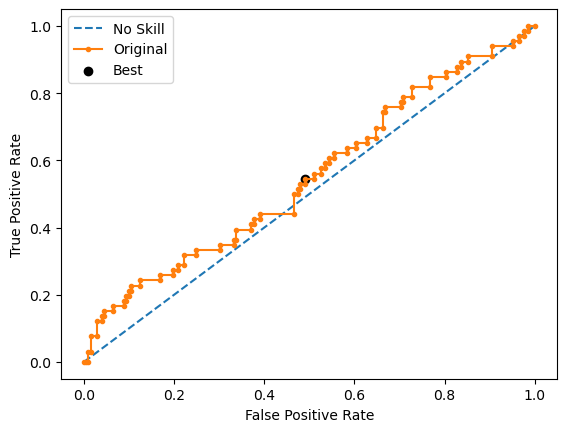

Run 4 - Random State: 3
Test G-mean: 0.4013927149453028
Best Threshold=0.260950, G-Mean=0.575


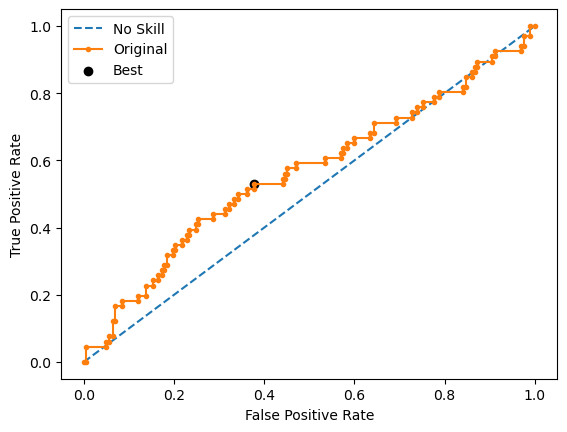

Run 5 - Random State: 4
Test G-mean: 0.38644525355268544
Best Threshold=0.186889, G-Mean=0.575


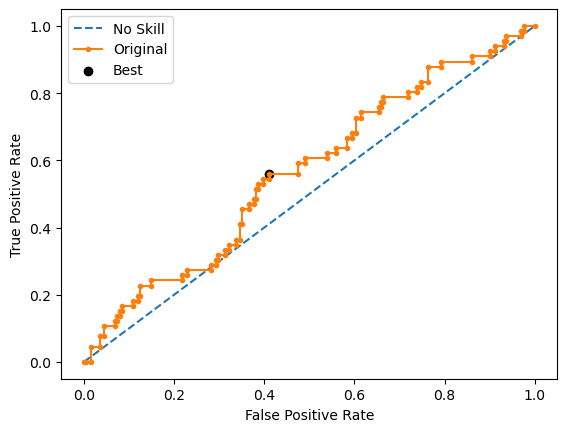

Ave Test G-mean: 0.4118127895643061
Stdev Test G-mean: 0.023775789989097875
Ave Test Specificity: 0.8900990099009901
Ave Test Recall: 0.1909090909090909
Ave Test NPV: 0.7709874382367119
Ave Test Accuracy: 0.7179104477611941
Ave Test Precision: 0.3635657724628313
Ave Test F1-Score: 0.2501369973732067
Ave Runtime: 4.542000818252563


In [52]:
ho_t02_gbm_gs, ho_t02_gbm_be, ho_t02_gbm_model_info, ho_t02_gbm_metrics_df = gbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4283152958152958
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints=None, learning_rate=0.1

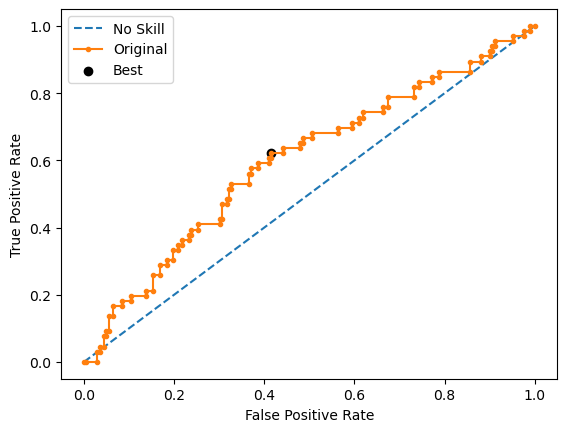

Run 2 - Random State: 1
Test G-mean: 0.3643669528478574
Best Threshold=0.241925, G-Mean=0.575


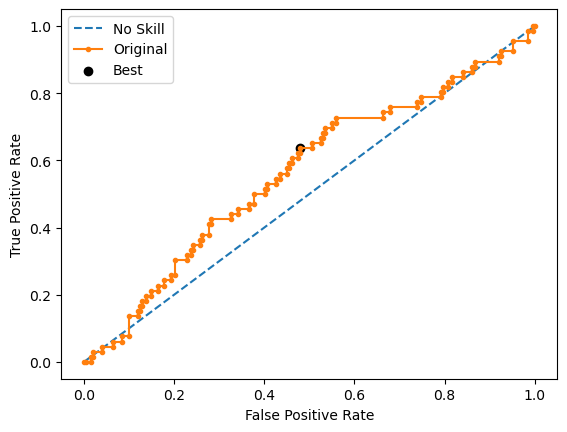

Run 3 - Random State: 2
Test G-mean: 0.37351566418978943
Best Threshold=0.199203, G-Mean=0.542


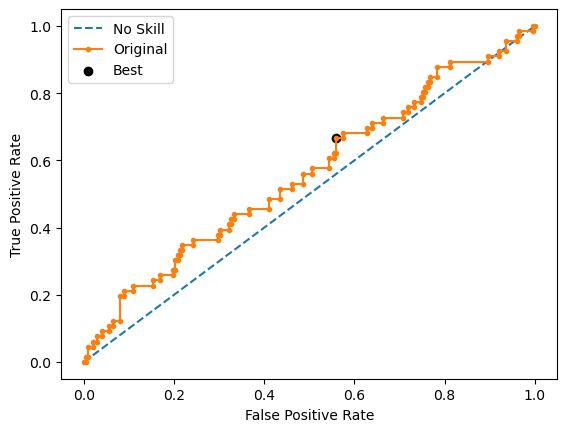

Run 4 - Random State: 3
Test G-mean: 0.290100699484824
Best Threshold=0.295051, G-Mean=0.585


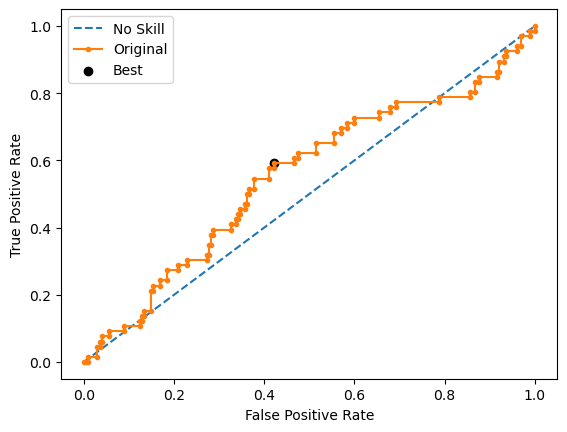

Run 5 - Random State: 4
Test G-mean: 0.374518392609282
Best Threshold=0.245347, G-Mean=0.570


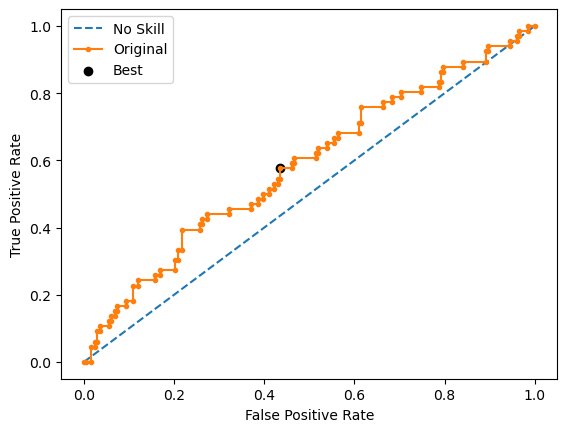

Ave Test G-mean: 0.3558035094669331
Stdev Test G-mean: 0.03702418007096474
Ave Test Specificity: 0.916831683168317
Ave Test Recall: 0.1393939393939394
Ave Test NPV: 0.7652625220914392
Ave Test Accuracy: 0.7253731343283581
Ave Test Precision: 0.3581653129479216
Ave Test F1-Score: 0.1995682923429196
Ave Runtime: 0.23853907585144044


In [53]:
ho_t02_xgb_gs, ho_t02_xgb_be, ho_t02_xgb_model_info, ho_t02_xgb_metrics_df = xgb_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4086904761904762
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.822519630854974
Std Train Score (G-mean) 0.008063175885365755
GridSearchCV Runtime: 15.213269472122192 secs
Run 1 - Random State: 0
Test G-mean: 0.2424992383246983
Best Threshold=0.880797, G-Mean=0.242


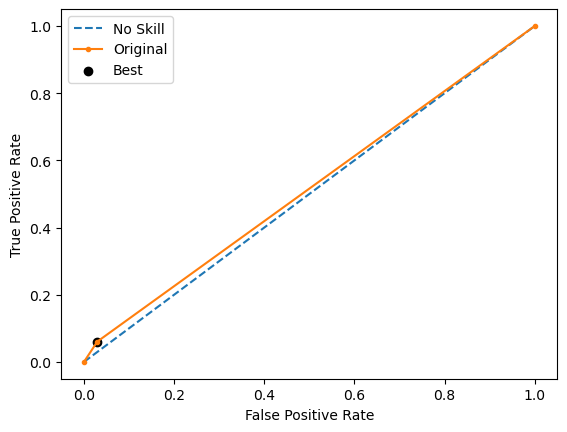

Run 2 - Random State: 1
Test G-mean: 0.294717976833085
Best Threshold=0.880797, G-Mean=0.295


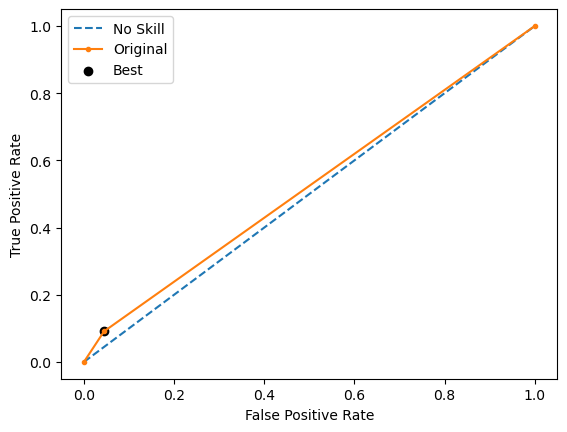

Run 3 - Random State: 2
Test G-mean: 0.24001200090007502
Best Threshold=0.880797, G-Mean=0.240


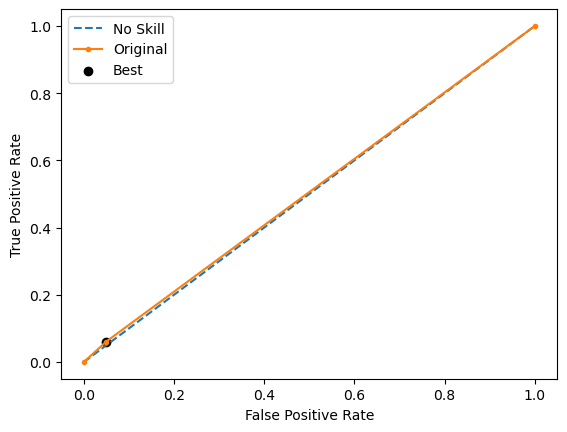

Run 4 - Random State: 3
Test G-mean: 0.2683415747141542
Best Threshold=0.880797, G-Mean=0.268


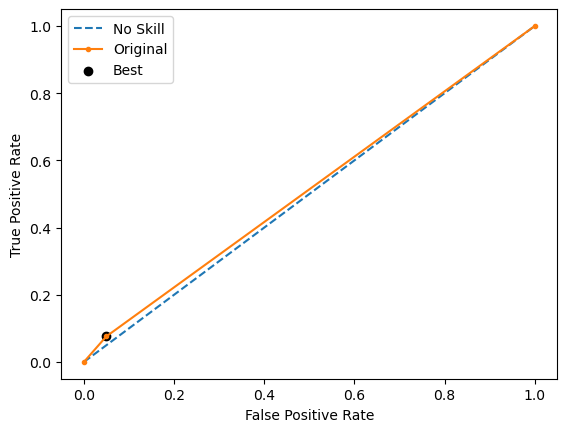

Run 5 - Random State: 4
Test G-mean: 0.29548050844867463
Best Threshold=0.880797, G-Mean=0.295


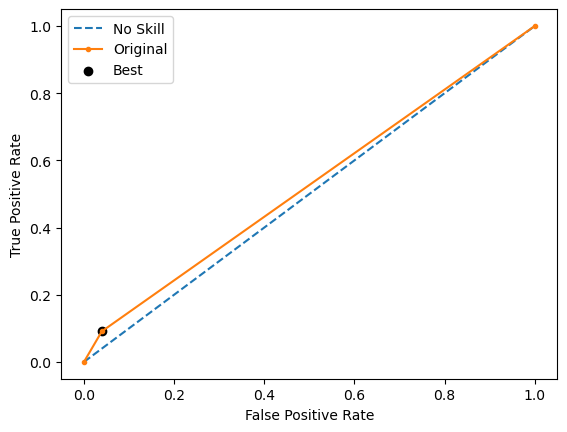

Ave Test G-mean: 0.26821025984413743
Stdev Test G-mean: 0.02693761866592863
Ave Test Specificity: 0.9574257425742573
Ave Test Recall: 0.07575757575757576
Ave Test NPV: 0.7602228184570963
Ave Test Accuracy: 0.7402985074626866
Ave Test Precision: 0.36952380952380953
Ave Test F1-Score: 0.12537361923326834
Ave Runtime: 0.9065824031829834


In [54]:
ho_t02_adaboost_gs, ho_t02_adaboost_be, ho_t02_adaboost_model_info, ho_t02_adaboost_metrics_df = adaboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003534 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6850
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

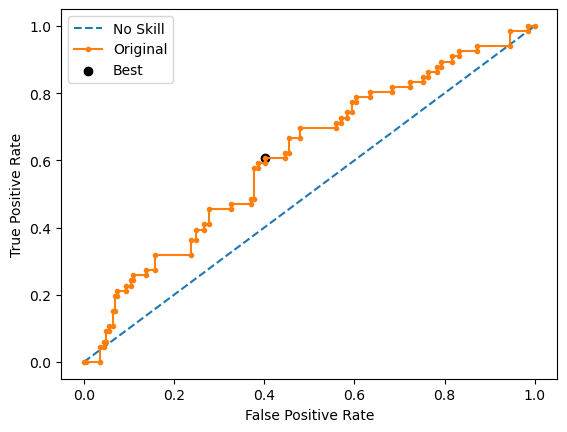

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7100
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

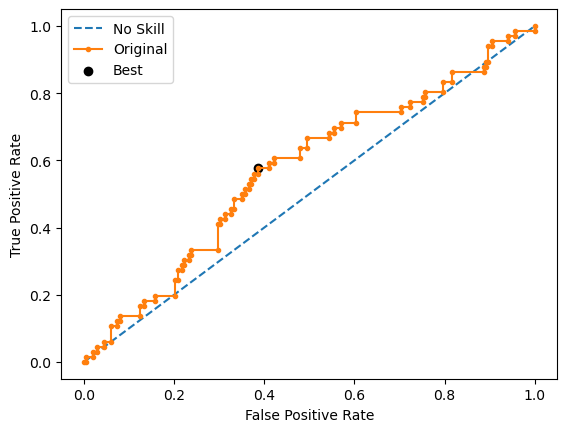

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6559
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

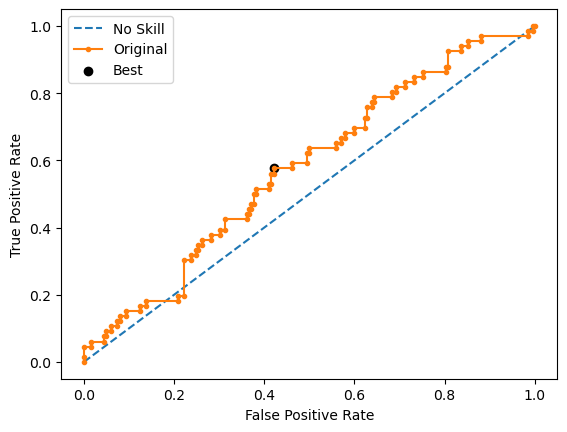

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6891
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

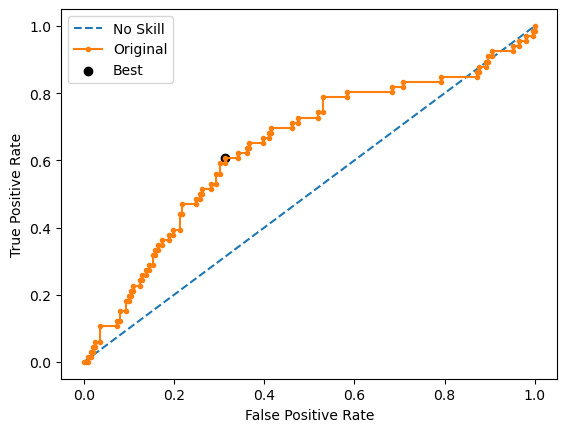

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004182 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6719
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

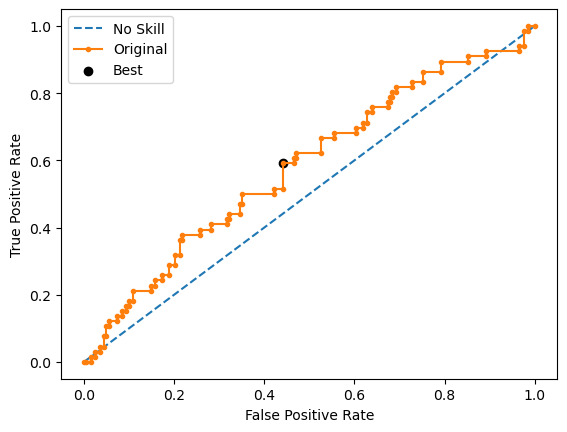

Ave Test G-mean: 0.3301723124746444
Stdev Test G-mean: 0.020832071691118597
Ave Test Specificity: 0.9267326732673267
Ave Test Recall: 0.1181818181818182
Ave Test NPV: 0.762836461008267
Ave Test Accuracy: 0.7276119402985075
Ave Test Precision: 0.3474198427102238
Ave Test F1-Score: 0.1755779608935542
Ave Runtime: 0.7794332504272461


In [55]:
ho_t02_lgbm_gs, ho_t02_lgbm_be, ho_t02_lgbm_model_info, ho_t02_lgbm_metrics_df = lgbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.011176
0:	learn: 0.6883111	total: 139ms	remaining: 2m 18s
1:	learn: 0.6857035	total: 144ms	remaining: 1m 11s
2:	learn: 0.6818250	total: 148ms	remaining: 49.2s
3:	learn: 0.6768980	total: 153ms	remaining: 38.2s
4:	learn: 0.6717882	total: 158ms	remaining: 31.4s
5:	learn: 0.6671970	total: 162ms	remaining: 26.8s
6:	learn: 0.6645735	total: 166ms	remaining: 23.6s
7:	learn: 0.6602367	total: 171ms	remaining: 21.2s
8:	learn: 0.6570723	total: 175ms	remaining: 19.3s
9:	learn: 0.6543065	total: 179ms	remaining: 17.7s
10:	learn: 0.6499798	total: 183ms	remaining: 16.5s
11:	learn: 0.6458893	total: 188ms	remaining: 15.5s
12:	learn: 0.6431163	total: 192ms	remaining: 14.6s
13:	learn: 0.6396973	total: 197ms	remaining: 13.9s
14:	learn: 0.6368865	total: 213ms	remaining: 14s
15:	learn: 0.6333351	total: 222ms	remaining: 13.7s
16:	learn: 0.6298373	total: 227ms	remaining: 13.1s
17:	learn: 0.6268413	total: 231ms	remaining: 12.6s
1

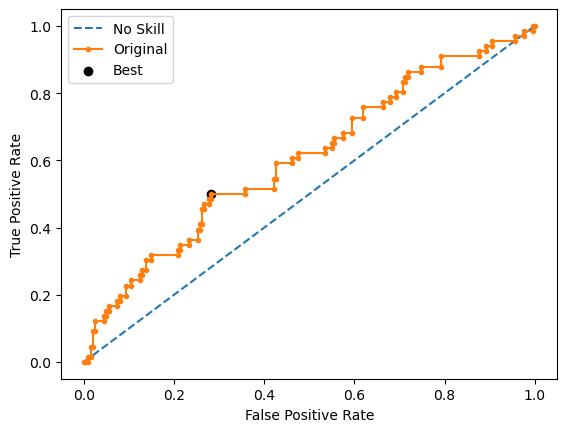

Learning rate set to 0.011176
0:	learn: 0.6884848	total: 5.24ms	remaining: 5.24s
1:	learn: 0.6845636	total: 9.81ms	remaining: 4.9s
2:	learn: 0.6797403	total: 14.3ms	remaining: 4.76s
3:	learn: 0.6764691	total: 19ms	remaining: 4.72s
4:	learn: 0.6714744	total: 23.7ms	remaining: 4.71s
5:	learn: 0.6677773	total: 27.9ms	remaining: 4.63s
6:	learn: 0.6644752	total: 32.3ms	remaining: 4.58s
7:	learn: 0.6595822	total: 36.9ms	remaining: 4.58s
8:	learn: 0.6562041	total: 41.5ms	remaining: 4.57s
9:	learn: 0.6516703	total: 46.1ms	remaining: 4.57s
10:	learn: 0.6475836	total: 50.3ms	remaining: 4.53s
11:	learn: 0.6439579	total: 54.9ms	remaining: 4.52s
12:	learn: 0.6402635	total: 59.5ms	remaining: 4.52s
13:	learn: 0.6369727	total: 61.5ms	remaining: 4.33s
14:	learn: 0.6343421	total: 65.8ms	remaining: 4.32s
15:	learn: 0.6304398	total: 70.2ms	remaining: 4.32s
16:	learn: 0.6278281	total: 74.6ms	remaining: 4.32s
17:	learn: 0.6243998	total: 79.2ms	remaining: 4.32s
18:	learn: 0.6205662	total: 83.7ms	remaining: 4

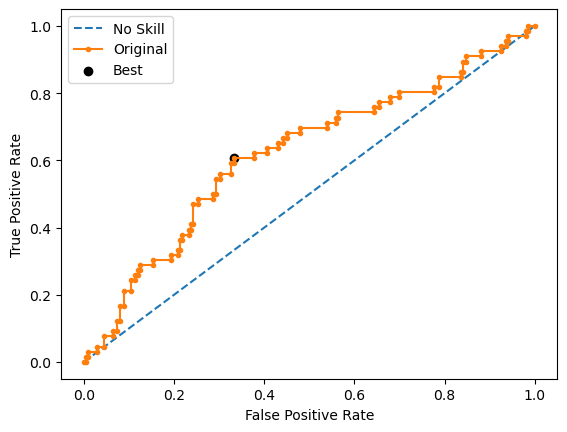

Learning rate set to 0.011176
0:	learn: 0.6891852	total: 5.57ms	remaining: 5.57s
1:	learn: 0.6857757	total: 10.5ms	remaining: 5.23s
2:	learn: 0.6807290	total: 14.9ms	remaining: 4.94s
3:	learn: 0.6769208	total: 19.2ms	remaining: 4.79s
4:	learn: 0.6724188	total: 23.9ms	remaining: 4.75s
5:	learn: 0.6672405	total: 28ms	remaining: 4.64s
6:	learn: 0.6640098	total: 32.4ms	remaining: 4.6s
7:	learn: 0.6605783	total: 36.5ms	remaining: 4.52s
8:	learn: 0.6571278	total: 40.9ms	remaining: 4.5s
9:	learn: 0.6549766	total: 45.5ms	remaining: 4.5s
10:	learn: 0.6521624	total: 50ms	remaining: 4.5s
11:	learn: 0.6478265	total: 54.7ms	remaining: 4.5s
12:	learn: 0.6443023	total: 59.3ms	remaining: 4.5s
13:	learn: 0.6399292	total: 63.5ms	remaining: 4.47s
14:	learn: 0.6361957	total: 67.7ms	remaining: 4.44s
15:	learn: 0.6321835	total: 71.9ms	remaining: 4.42s
16:	learn: 0.6291958	total: 76.1ms	remaining: 4.4s
17:	learn: 0.6268371	total: 80.3ms	remaining: 4.38s
18:	learn: 0.6237612	total: 84.7ms	remaining: 4.37s
19:

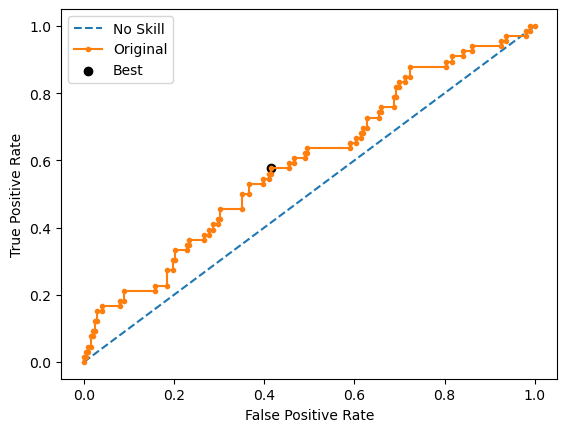

Learning rate set to 0.011176
0:	learn: 0.6885629	total: 5.02ms	remaining: 5.02s
1:	learn: 0.6821813	total: 9.54ms	remaining: 4.76s
2:	learn: 0.6787153	total: 13.8ms	remaining: 4.57s
3:	learn: 0.6743848	total: 18.2ms	remaining: 4.52s
4:	learn: 0.6696955	total: 22.6ms	remaining: 4.49s
5:	learn: 0.6659967	total: 27ms	remaining: 4.47s
6:	learn: 0.6626121	total: 31.3ms	remaining: 4.44s
7:	learn: 0.6576001	total: 35.7ms	remaining: 4.42s
8:	learn: 0.6544028	total: 40ms	remaining: 4.4s
9:	learn: 0.6503119	total: 44.4ms	remaining: 4.39s
10:	learn: 0.6454292	total: 48.8ms	remaining: 4.38s
11:	learn: 0.6407359	total: 53ms	remaining: 4.36s
12:	learn: 0.6377571	total: 57.5ms	remaining: 4.37s
13:	learn: 0.6334260	total: 61.8ms	remaining: 4.35s
14:	learn: 0.6302171	total: 66ms	remaining: 4.33s
15:	learn: 0.6260475	total: 70.6ms	remaining: 4.34s
16:	learn: 0.6223851	total: 74.8ms	remaining: 4.32s
17:	learn: 0.6194210	total: 79ms	remaining: 4.31s
18:	learn: 0.6163734	total: 83.3ms	remaining: 4.3s
19:	

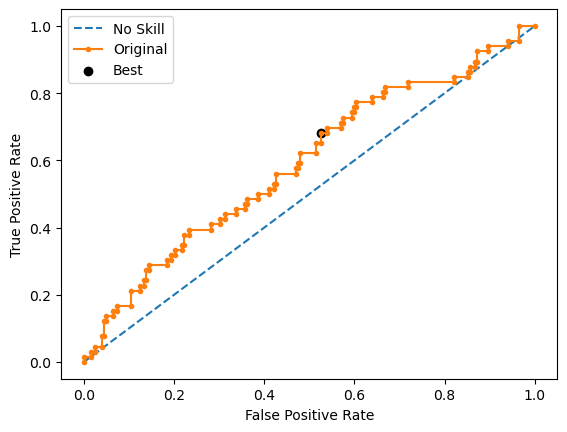

Learning rate set to 0.011176
0:	learn: 0.6891346	total: 10.5ms	remaining: 10.5s
1:	learn: 0.6834692	total: 18.4ms	remaining: 9.19s
2:	learn: 0.6794378	total: 25ms	remaining: 8.32s
3:	learn: 0.6766796	total: 30.4ms	remaining: 7.57s
4:	learn: 0.6719618	total: 34.9ms	remaining: 6.95s
5:	learn: 0.6671834	total: 39.9ms	remaining: 6.61s
6:	learn: 0.6646393	total: 44.9ms	remaining: 6.37s
7:	learn: 0.6610002	total: 49ms	remaining: 6.08s
8:	learn: 0.6572693	total: 53.4ms	remaining: 5.88s
9:	learn: 0.6531254	total: 57.8ms	remaining: 5.72s
10:	learn: 0.6492896	total: 62.4ms	remaining: 5.61s
11:	learn: 0.6458666	total: 66.8ms	remaining: 5.5s
12:	learn: 0.6428218	total: 71.3ms	remaining: 5.41s
13:	learn: 0.6386981	total: 75.9ms	remaining: 5.34s
14:	learn: 0.6348430	total: 80.2ms	remaining: 5.27s
15:	learn: 0.6317748	total: 84.4ms	remaining: 5.19s
16:	learn: 0.6287733	total: 88.8ms	remaining: 5.13s
17:	learn: 0.6254196	total: 93.1ms	remaining: 5.08s
18:	learn: 0.6222574	total: 97.7ms	remaining: 5.0

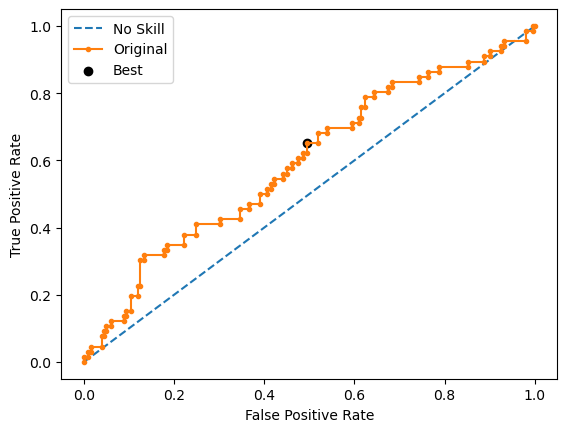

Ave Test G-mean: 0.3417932927179431
Stdev Test G-mean: 0.03286551631068118
Ave Test Specificity: 0.9465346534653465
Ave Test Recall: 0.12424242424242424
Ave Test NPV: 0.7678431096566574
Ave Test Accuracy: 0.7440298507462686
Ave Test Precision: 0.4405042016806722
Ave Test F1-Score: 0.1930167083220677
Ave Runtime: 4.644887495040893


In [56]:
ho_t02_catboost_gs, ho_t02_catboost_be, ho_t02_catboost_model_info, ho_t02_catboost_metrics_df = catboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [57]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t02_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t02_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t02_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
2,Logistic Regression,0.561836,0.019889,0.343517,NaN,0.624752,0.506061,0.307046,0.381754,0.595522
4,Random Forest,0.507762,0.006907,0.382251,0.480351,0.826733,0.312121,0.371760,0.338851,0.700000
5,Gradient Boosting Machine (GBM),0.411813,0.023776,0.390850,0.780427,0.890099,0.190909,0.363566,0.250137,0.717910
3,Decision Tree,0.364659,0.035134,0.435200,NaN,0.925743,0.145455,0.412059,0.210494,0.733582
7,Extreme Gradient Boosting (XGBoost),0.355804,0.037024,0.428315,0.742976,0.916832,0.139394,0.358165,0.199568,0.725373
9,CatBoost,0.341793,0.032866,0.373582,0.831818,0.946535,0.124242,0.440504,0.193017,0.744030
6,LightGBM,0.330172,0.020832,0.522659,0.633743,0.926733,0.118182,0.347420,0.175578,0.727612
8,AdaBoost,0.268210,0.026938,0.408690,0.822520,0.957426,0.075758,0.369524,0.125374,0.740299
1,SVM Classifier,0.176365,0.114289,0.500000,0.379439,0.785149,0.242424,0.433092,0.154507,0.651493
0,k-Nearest Neighbors,0.141832,0.090322,0.441667,0.502546,0.974257,0.027273,0.268254,0.049044,0.741045


In [58]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t02_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.744030,CatBoost
Highest Test G-mean,0.561836,Logistic Regression
Highest Test Recall,0.506061,Logistic Regression
Highest Test Precision,0.440504,CatBoost
Highest Test Specificity,0.974257,k-Nearest Neighbors
Highest Test F1-score,0.381754,Logistic Regression


In [81]:
# var_df

# HO-T03 Runs

In [50]:
ho_t03.shape, ho_t02.shape

((1070, 51), (1070, 55))

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2527 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 5, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': TomekLinks()}
Best Validation Score (G-mean): 0.4792063492063492
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()), ('resampling', TomekLinks()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=5, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 35.220125675201416 secs
Run 1 - Random State: 0
Test G-mean: 0.41026434366535963
Best Threshold=0.213115, G-Mean=0.575


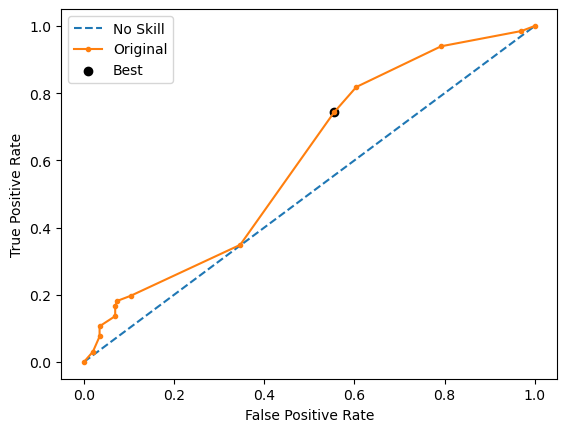

Run 2 - Random State: 1
Test G-mean: 0.4545004478168383
Best Threshold=0.183333, G-Mean=0.573


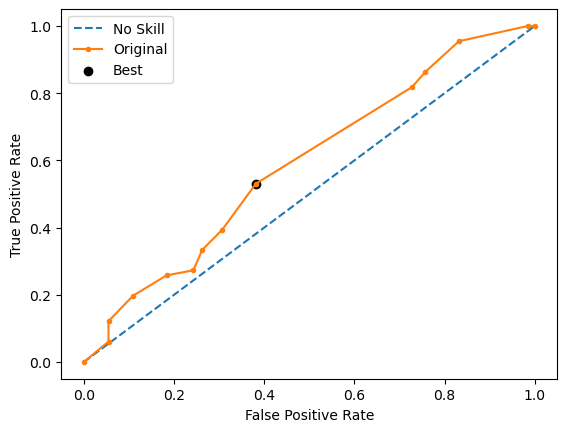

Run 3 - Random State: 2
Test G-mean: 0.40362890336194074
Best Threshold=0.255924, G-Mean=0.590


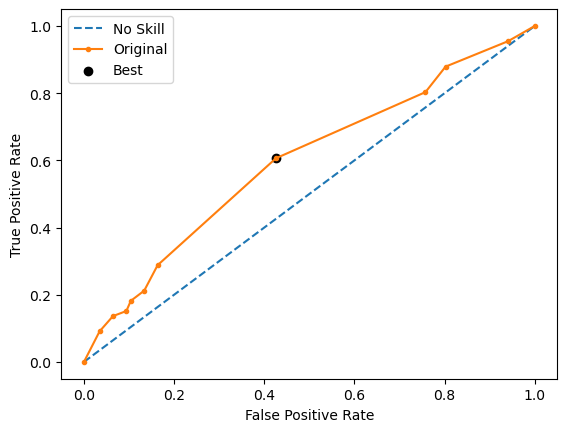

Run 4 - Random State: 3
Test G-mean: 0.4154422453553834
Best Threshold=0.234375, G-Mean=0.625


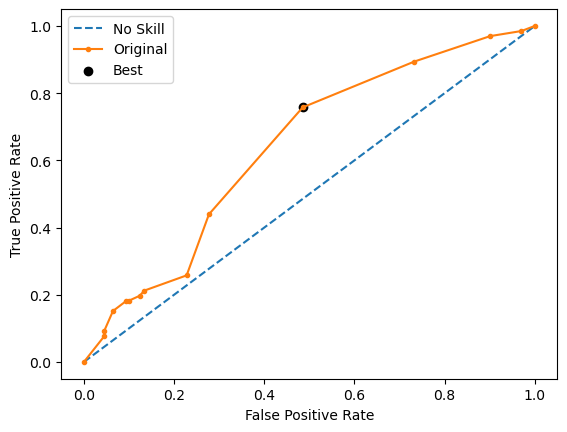

Run 5 - Random State: 4
Test G-mean: 0.36001800135011247
Best Threshold=0.285714, G-Mean=0.560


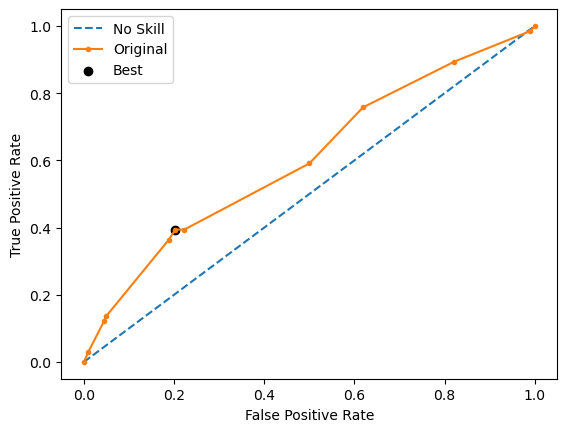

Ave Test G-mean: 0.4087707883099269
Stdev Test G-mean: 0.03369426517411584
Ave Test Specificity: 0.8811881188118811
Ave Test Recall: 0.1939393939393939
Ave Test NPV: 0.7695979921014802
Ave Test Accuracy: 0.7119402985074628
Ave Test Precision: 0.3785053996365858
Ave Test F1-Score: 0.24658603123299017
Ave Runtime: 0.039365720748901364


In [51]:
ho_t03_dt_gs, ho_t03_dt_be, ho_t03_dt_model_info, ho_t03_dt_metrics_df = dt_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.1, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.3524186926334759
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.1, max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 21.018913507461548 secs
Run 1 - Random State: 0
Test G-mean: 0.5864378832741741
Best Threshold=0.468996, G-Mean=0.611



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

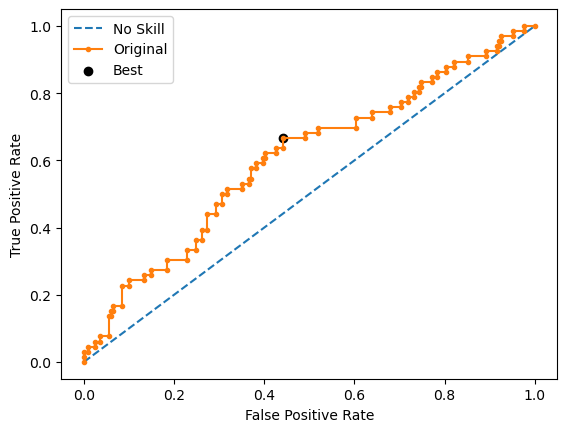

Run 2 - Random State: 1
Test G-mean: 0.5607418685494373
Best Threshold=0.525048, G-Mean=0.581


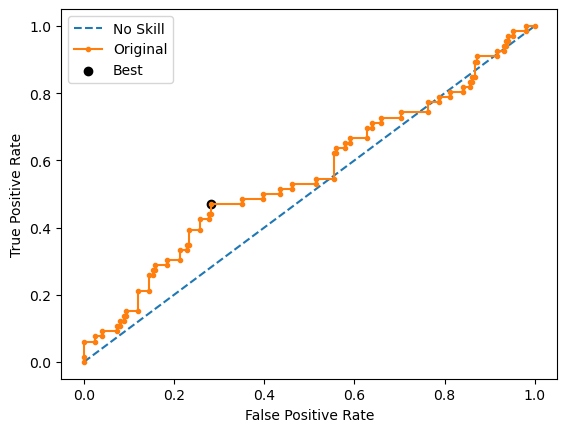

Run 3 - Random State: 2
Test G-mean: 0.6411248740381323
Best Threshold=0.535599, G-Mean=0.660


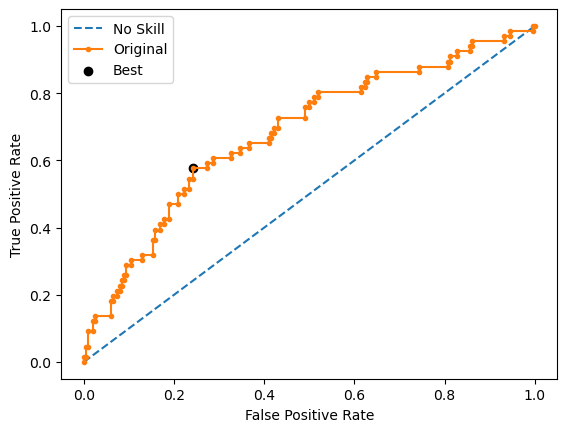

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.512490, G-Mean=0.575


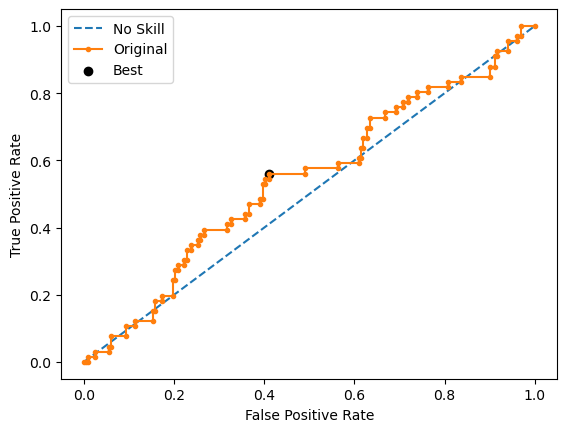

Run 5 - Random State: 4
Test G-mean: 0.5391234231662919
Best Threshold=0.418372, G-Mean=0.551


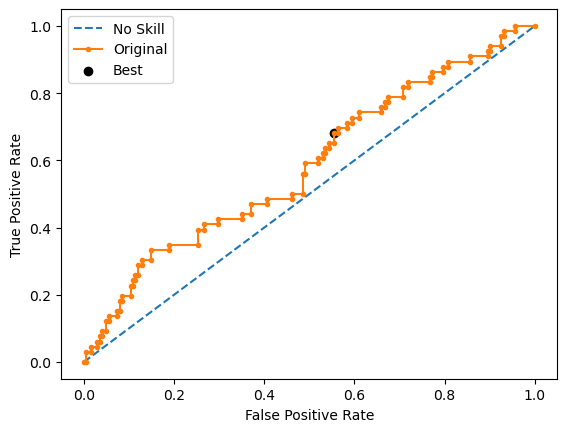

Ave Test G-mean: 0.5779812342829735
Stdev Test G-mean: 0.039070787833841575
Ave Test Specificity: 0.6316831683168317
Ave Test Recall: 0.5303030303030303
Ave Test NPV: 0.8043049927993691
Ave Test Accuracy: 0.6067164179104478
Ave Test Precision: 0.32097154177703724
Ave Test F1-Score: 0.39945352408046814
Ave Runtime: 0.026644468307495117


In [52]:
ho_t03_logreg_gs, ho_t03_logreg_be, ho_t03_logreg_model_info, ho_t03_logreg_metrics_df = logreg_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'linear', 'classifier__probability': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5128571428571428
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, kernel='linear', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.37799792818803096
Std Train Score (G-mean) 0.06576996354081502
GridSearchCV Runtime: 54.54291868209839 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.29548050844867463
Best Threshold=0.508737, G-Mean=0.296


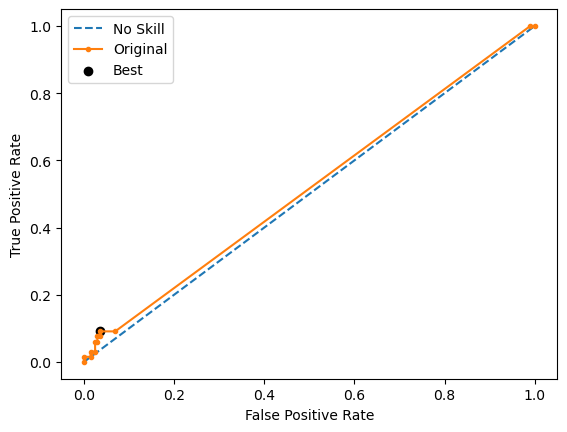

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.17190973007811267
Best Threshold=0.510005, G-Mean=0.531


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


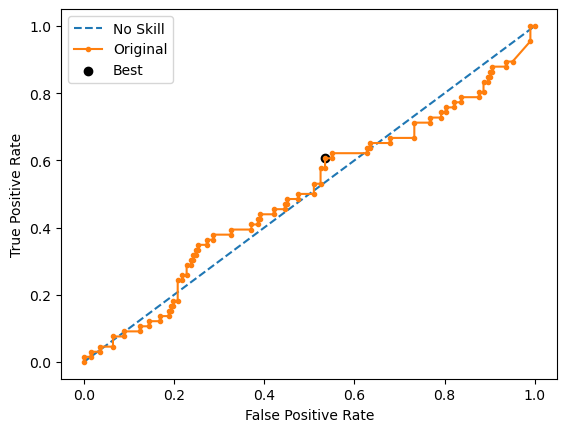

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.06928549666419949
Best Threshold=0.506872, G-Mean=0.174


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


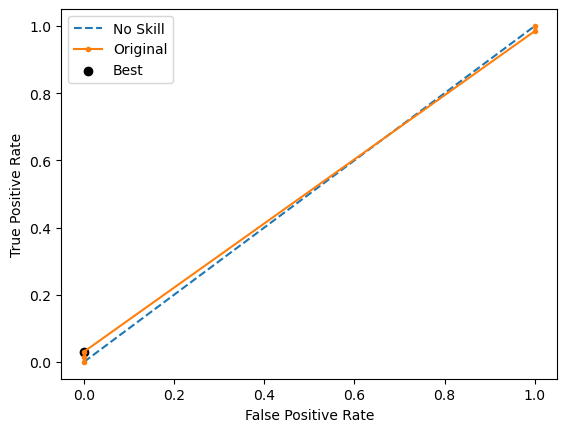

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.20893627123250683
Best Threshold=0.526503, G-Mean=0.546


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


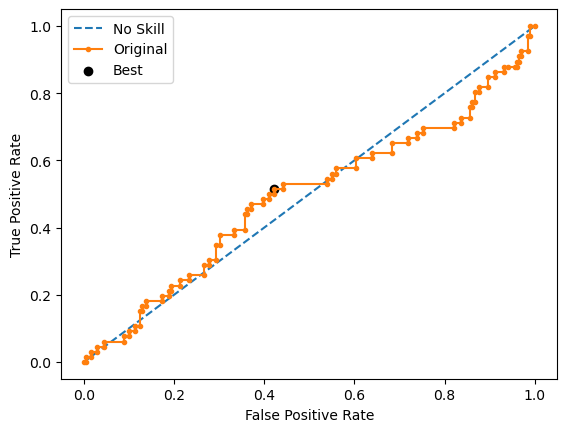

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.1537119472789075
Best Threshold=0.506890, G-Mean=0.211


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


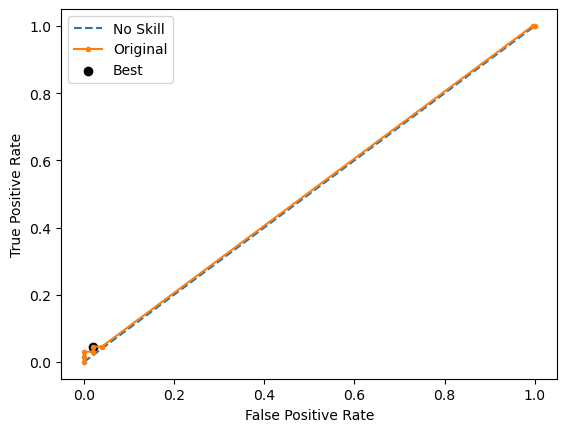

Ave Test G-mean: 0.1798647907404802
Stdev Test G-mean: 0.08244267652262273
Ave Test Specificity: 0.5851485148514851
Ave Test Recall: 0.41818181818181815
Ave Test NPV: 0.6463531892305223
Ave Test Accuracy: 0.5440298507462688
Ave Test Precision: 0.29416602265658864
Ave Test F1-Score: 0.21118532291903383
Ave Runtime: 0.16298265457153321


In [53]:
ho_t03_svm_gs, ho_t03_svm_be, ho_t03_svm_model_info, ho_t03_svm_metrics_df = svm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [54]:
ho_t03_knn_gs, ho_t03_knn_be, ho_t03_knn_model_info, ho_t03_knn_metrics_df = knn_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 2, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.4375
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=2))])
Mean Train Score (G-mean) 0.5033306626200721
Std Train Score (G-mean) 0.017188171238449818
GridSearchCV Runtime: 35.09056878089905 secs
Run 1 - Random State: 0
Test G-mean: 0.20947407462212095
Run 2 - Random State: 1
Test G-mean: 0.3571942871545926
Run 3 - Random State: 2
Test G-mean: 0.26764185624883424
Run 4 - Random State: 3
Test G-mean: 0.26553163786085926
Run 5 - Random State: 4
Test G-mean: 0.2924184516323919
Ave Test G-mean: 0.27845206150375973
Stdev Test G-mean: 0.05347232628351092
Ave Test Specificity: 0.9435643564356436
Ave Test Recall: 0.08484848484848484
Ave Test NPV: 0.7594126449345989
Ave Test Acc

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4770387945387945
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
          

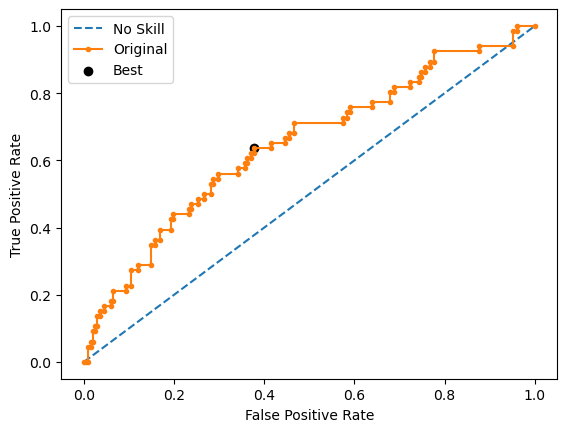

Run 2 - Random State: 1
Test G-mean: 0.4154422453553834
Best Threshold=0.080792, G-Mean=0.620


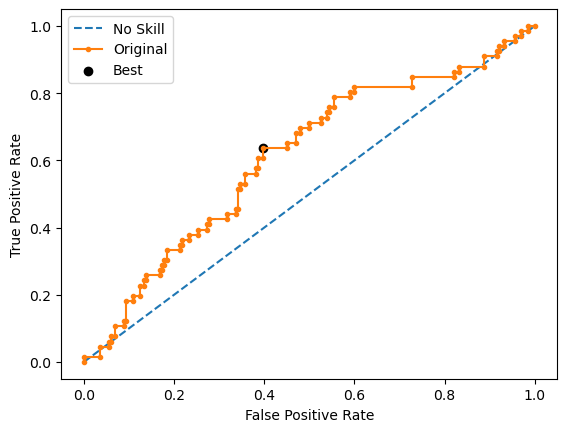

Run 3 - Random State: 2
Test G-mean: 0.374518392609282
Best Threshold=0.104210, G-Mean=0.591


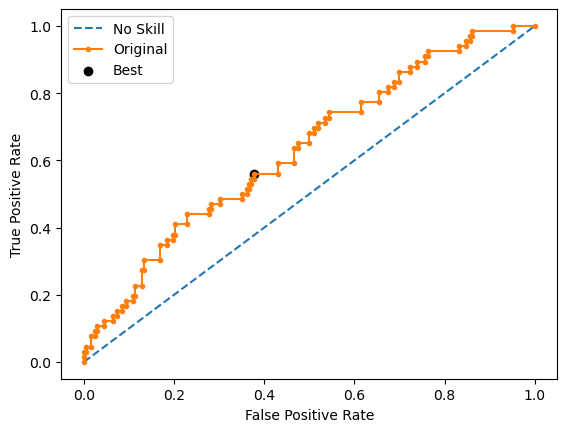

Run 4 - Random State: 3
Test G-mean: 0.4212692093835929
Best Threshold=0.230927, G-Mean=0.562


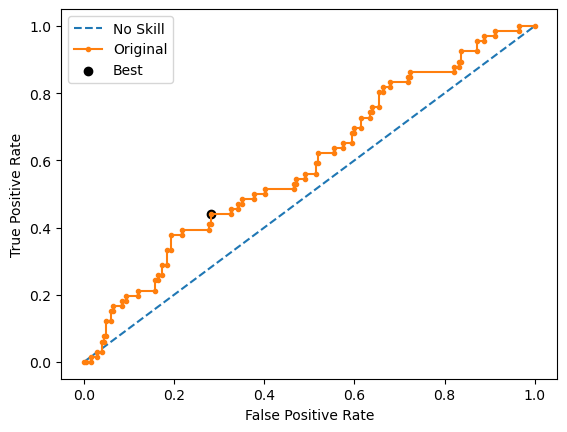

Run 5 - Random State: 4
Test G-mean: 0.4212692093835929
Best Threshold=0.070872, G-Mean=0.585


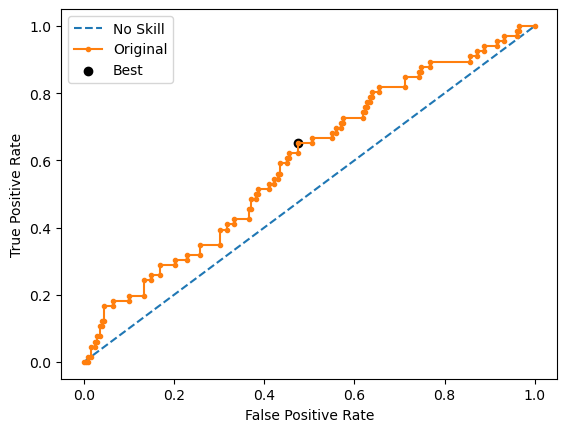

Ave Test G-mean: 0.4172512498052631
Stdev Test G-mean: 0.028259252540552476
Ave Test Specificity: 0.901980198019802
Ave Test Recall: 0.19393939393939394
Ave Test NPV: 0.7740199989516466
Ave Test Accuracy: 0.7276119402985074
Ave Test Precision: 0.3942321043249836
Ave Test F1-Score: 0.25900654900654907
Ave Runtime: 0.27036705017089846


In [55]:
ho_t03_xgb_gs, ho_t03_xgb_be, ho_t03_xgb_model_info, ho_t03_xgb_metrics_df = xgb_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001624 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6722
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

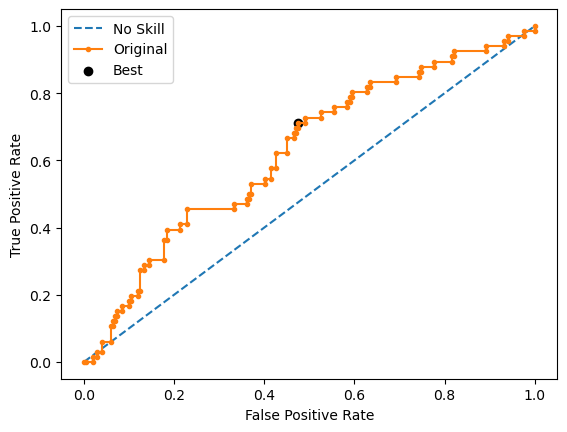

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6920
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Run 2 - Random State: 1
Test G-mean: 0.34664393287871076
Best Threshold=0.297506, G-Mean=0.608


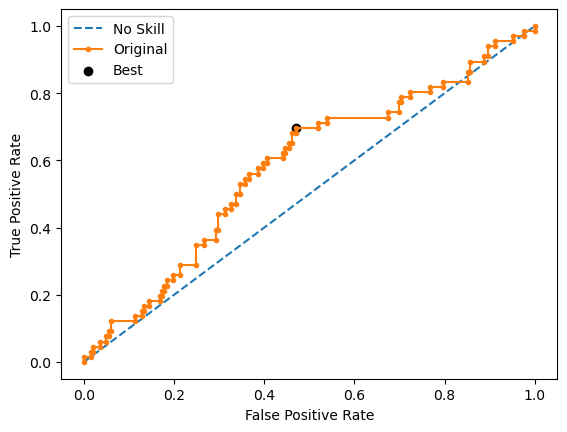

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6431
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

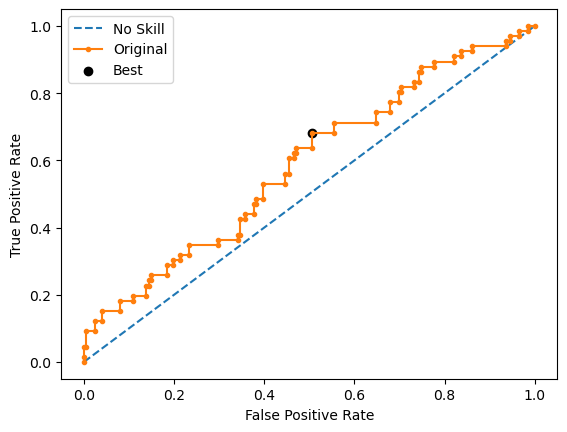

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000919 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6617
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

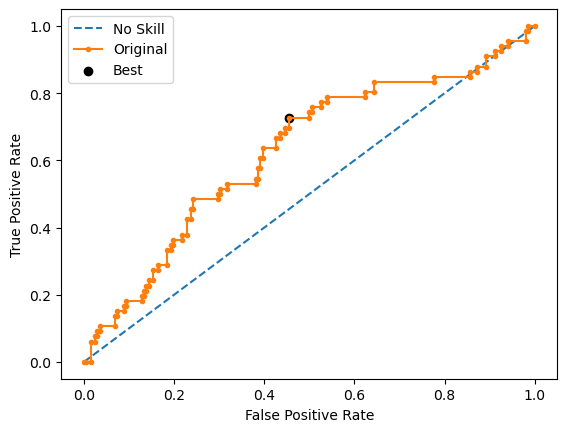

[LightGBM] [Info] Number of positive: 605, number of negative: 605
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001141 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6719
[LightGBM] [Info] Number of data points in the train set: 1210, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

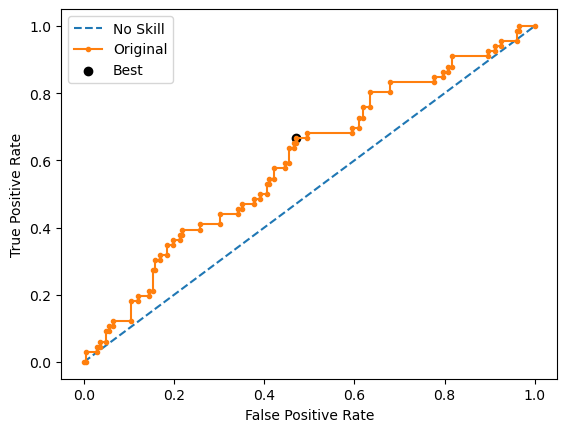

Ave Test G-mean: 0.3256374783233958
Stdev Test G-mean: 0.05535207534601146
Ave Test Specificity: 0.9227722772277227
Ave Test Recall: 0.1181818181818182
Ave Test NPV: 0.7620985390670276
Ave Test Accuracy: 0.7246268656716418
Ave Test Precision: 0.3337972816233686
Ave Test F1-Score: 0.1720675931033399
Ave Runtime: 0.141005277633667


In [56]:
ho_t03_lgbm_gs, ho_t03_lgbm_be, ho_t03_lgbm_model_info, ho_t03_lgbm_metrics_df = lgbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.35845238095238097
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.7798960630754594
Std Train Score (G-mean) 0.014153582110879179
GridSearchCV Runtime: 83.9287121295929 secs
Run 1 - Random State: 0
Test G-mean: 0.3885744446176318
Best Threshold=0.256713, G-Mean=0.612


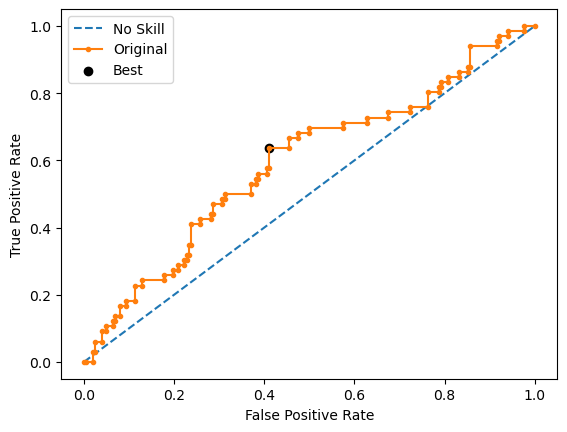

Run 2 - Random State: 1
Test G-mean: 0.37150208798893447
Best Threshold=0.318772, G-Mean=0.610


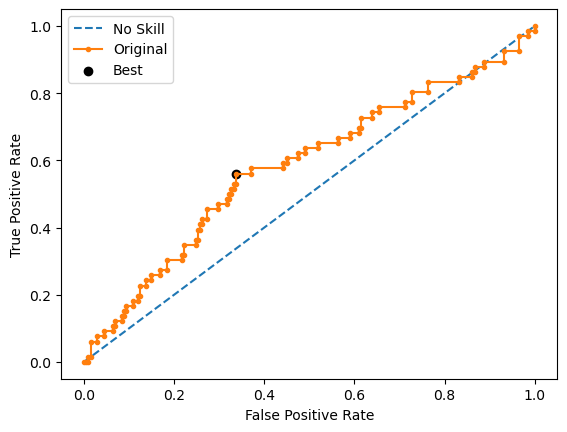

Run 3 - Random State: 2
Test G-mean: 0.37251023662127564
Best Threshold=0.277583, G-Mean=0.556


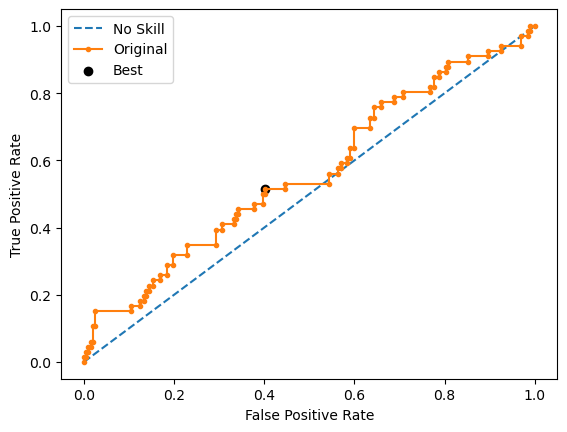

Run 4 - Random State: 3
Test G-mean: 0.32773577936213716
Best Threshold=0.294863, G-Mean=0.595


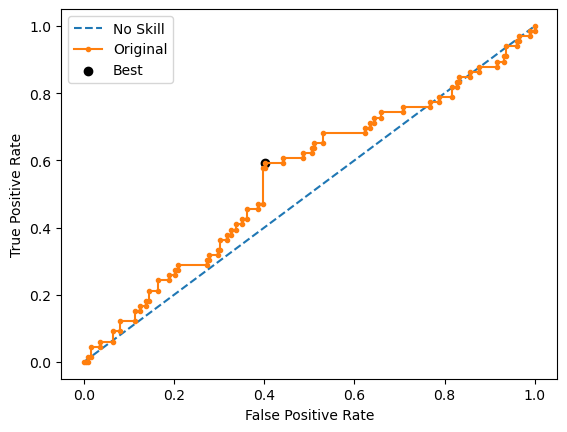

Run 5 - Random State: 4
Test G-mean: 0.40696014750361686
Best Threshold=0.283373, G-Mean=0.576


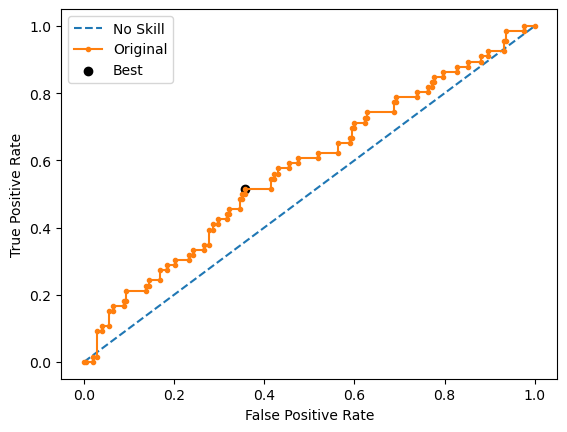

Ave Test G-mean: 0.3734565392187192
Stdev Test G-mean: 0.029351942362632128
Ave Test Specificity: 0.905940594059406
Ave Test Recall: 0.15454545454545454
Ave Test NPV: 0.7663185179529031
Ave Test Accuracy: 0.7208955223880598
Ave Test Precision: 0.3504488820617853
Ave Test F1-Score: 0.21438696823251657
Ave Runtime: 1.668383741378784


In [57]:
ho_t03_gbm_gs, ho_t03_gbm_be, ho_t03_gbm_model_info, ho_t03_gbm_metrics_df = gbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.42833333333333334
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8232703840438862
Std Train Score (G-mean) 0.009452441657244199
GridSearchCV Runtime: 10.425258159637451 secs
Run 1 - Random State: 0
Test G-mean: 0.29851115706299675
Best Threshold=0.880797, G-Mean=0.299


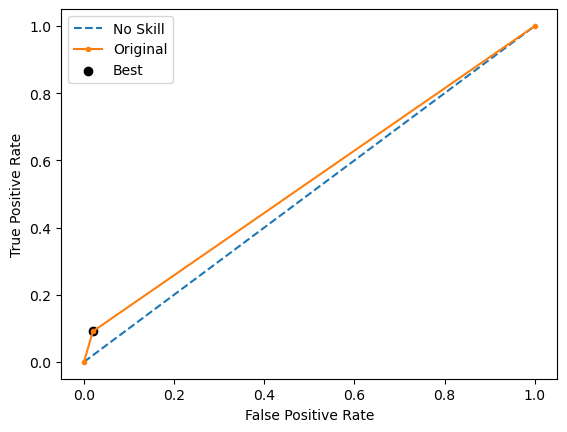

Run 2 - Random State: 1
Test G-mean: 0.2939534671748003
Best Threshold=0.880797, G-Mean=0.294


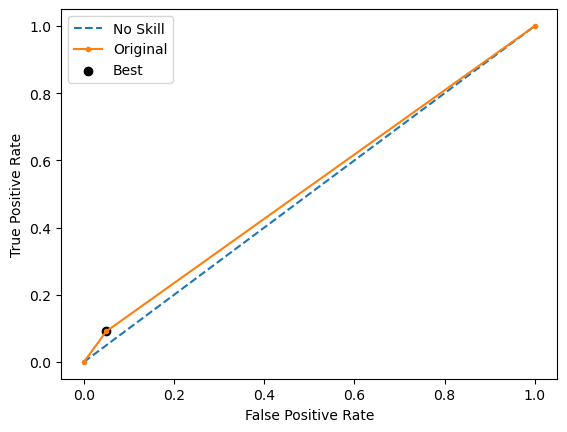

Run 3 - Random State: 2
Test G-mean: 0.20785648999259854
Best Threshold=0.880797, G-Mean=0.208


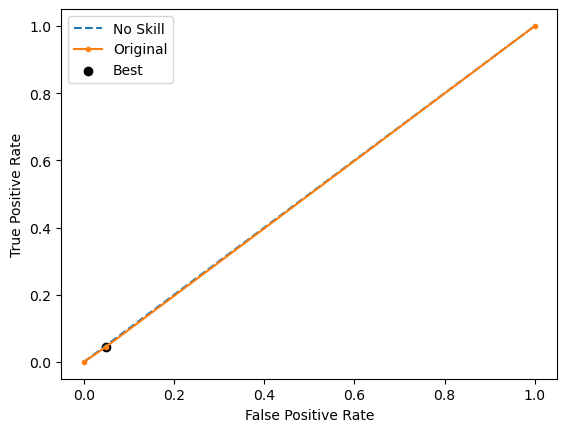

Run 4 - Random State: 3
Test G-mean: 0.1705957510931298
Best Threshold=0.880797, G-Mean=0.171


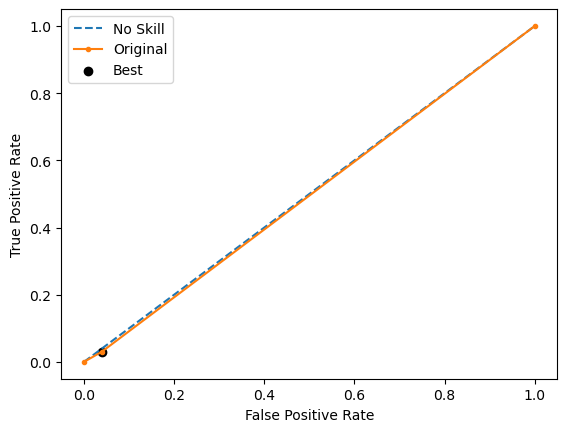

Run 5 - Random State: 4
Test G-mean: 0.20947407462212095
Best Threshold=0.880797, G-Mean=0.209


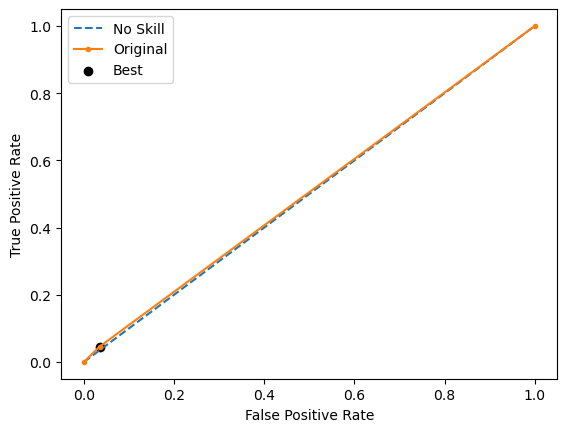

Ave Test G-mean: 0.23607818798912925
Stdev Test G-mean: 0.057095569433819535
Ave Test Specificity: 0.9613861386138612
Ave Test Recall: 0.06060606060606061
Ave Test NPV: 0.7580079473649926
Ave Test Accuracy: 0.7395522388059701
Ave Test Precision: 0.34115384615384614
Ave Test F1-Score: 0.1023529029427536
Ave Runtime: 0.33254432678222656


In [58]:
ho_t03_adaboost_gs, ho_t03_adaboost_be, ho_t03_adaboost_model_info, ho_t03_adaboost_metrics_df = adaboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4232575757575757
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=2,
                                        n_estimators=200, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.46865221624101405
Std Train Score (G-mean) 0.025969406188614177
GridSearchCV Runtime: 230.82668018341064 secs
Run 1 - Random State: 0
Test G-mean: 0.2969996984545409
Best Threshold=0.415621, G-Mean=0.657


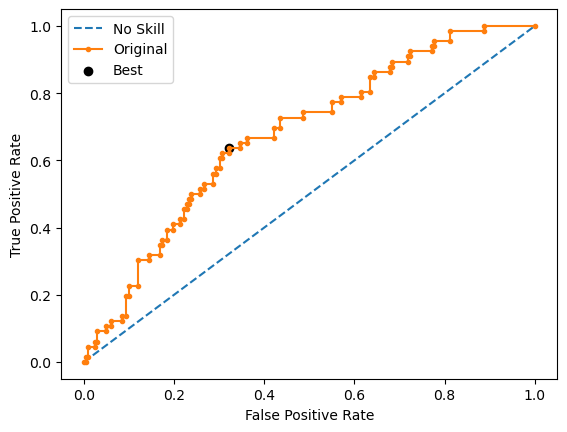

Run 2 - Random State: 1
Test G-mean: 0.41308844598514327
Best Threshold=0.412908, G-Mean=0.581


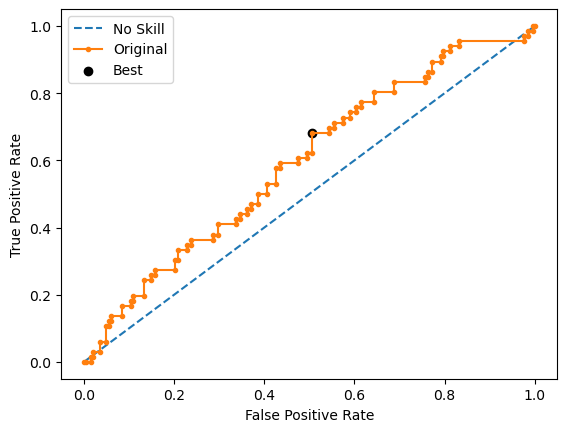

Run 3 - Random State: 2
Test G-mean: 0.38146369611687236
Best Threshold=0.416879, G-Mean=0.628


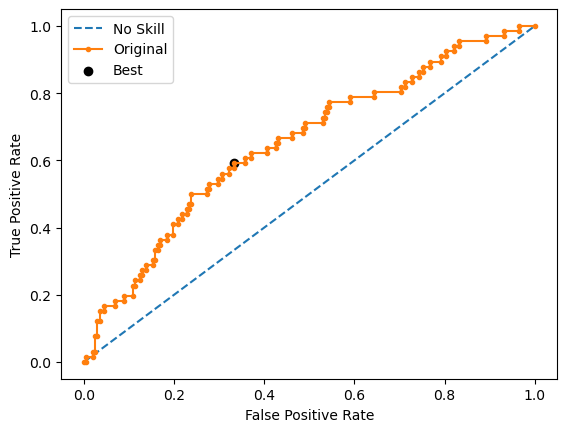

Run 4 - Random State: 3
Test G-mean: 0.20893627123250683
Best Threshold=0.408877, G-Mean=0.635


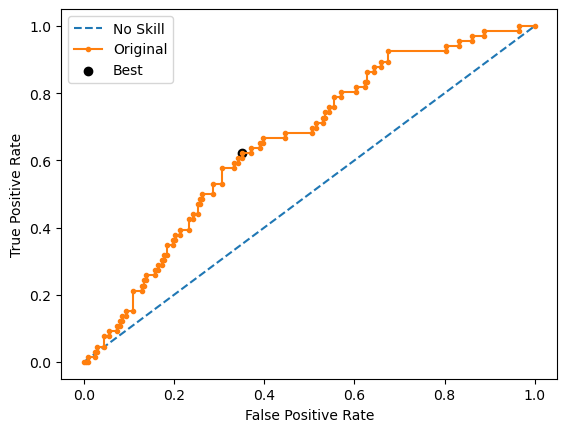

Run 5 - Random State: 4
Test G-mean: 0.42587338119878
Best Threshold=0.453426, G-Mean=0.619


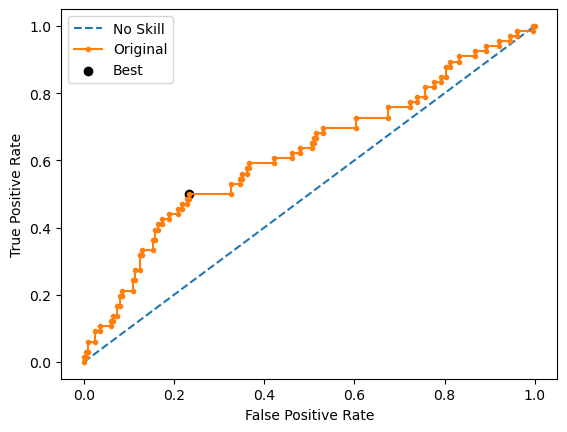

Ave Test G-mean: 0.3452722985975687
Stdev Test G-mean: 0.09127313117730257
Ave Test Specificity: 0.9356435643564357
Ave Test Recall: 0.13636363636363635
Ave Test NPV: 0.7684550701405926
Ave Test Accuracy: 0.7388059701492538
Ave Test Precision: 0.42031173807035876
Ave Test F1-Score: 0.19776613985154204
Ave Runtime: 0.2782719612121582


In [59]:
ho_t03_rf_gs, ho_t03_rf_be, ho_t03_rf_model_info, ho_t03_rf_metrics_df = rf_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.011211
0:	learn: 0.6873736	total: 160ms	remaining: 2m 40s
1:	learn: 0.6819573	total: 163ms	remaining: 1m 21s
2:	learn: 0.6791818	total: 168ms	remaining: 55.8s
3:	learn: 0.6749826	total: 171ms	remaining: 42.6s
4:	learn: 0.6705153	total: 174ms	remaining: 34.6s
5:	learn: 0.6676125	total: 177ms	remaining: 29.3s
6:	learn: 0.6621671	total: 179ms	remaining: 25.4s
7:	learn: 0.6570961	total: 182ms	remaining: 22.6s
8:	learn: 0.6517320	total: 184ms	remaining: 20.3s
9:	learn: 0.6489594	total: 187ms	remaining: 18.5s
10:	learn: 0.6448234	total: 190ms	remaining: 17.1s
11:	learn: 0.6402182	total: 193ms	remaining: 15.9s
12:	learn: 0.6364974	total: 196ms	remaining: 14.9s
13:	learn: 0.6323075	total: 199ms	remaining: 14s
14:	learn: 0.6301060	total: 203ms	remaining: 13.3s
15:	learn: 0.6267599	total: 206ms	remaining: 12.7s
16:	learn: 0.6231479	total: 209ms	remaining: 12.1s
17:	learn: 0.6201350	total: 212ms	remaining: 11.6s
18:	learn: 0.6155950	total: 215ms	remaining: 11.1s
19:	learn: 

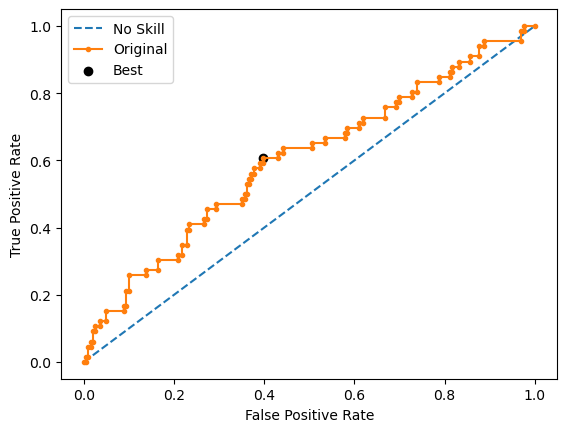

Learning rate set to 0.011196
0:	learn: 0.6880572	total: 4.2ms	remaining: 4.19s
1:	learn: 0.6833547	total: 8.27ms	remaining: 4.13s
2:	learn: 0.6806898	total: 12.2ms	remaining: 4.06s
3:	learn: 0.6769231	total: 16.1ms	remaining: 4.01s
4:	learn: 0.6733935	total: 19.7ms	remaining: 3.91s
5:	learn: 0.6692538	total: 23.1ms	remaining: 3.82s
6:	learn: 0.6651423	total: 27.4ms	remaining: 3.88s
7:	learn: 0.6626593	total: 30.5ms	remaining: 3.78s
8:	learn: 0.6588645	total: 34.4ms	remaining: 3.79s
9:	learn: 0.6546459	total: 38.8ms	remaining: 3.84s
10:	learn: 0.6502957	total: 42.8ms	remaining: 3.85s
11:	learn: 0.6467652	total: 47.4ms	remaining: 3.9s
12:	learn: 0.6438772	total: 49.9ms	remaining: 3.79s
13:	learn: 0.6404820	total: 52ms	remaining: 3.66s
14:	learn: 0.6380866	total: 54.3ms	remaining: 3.56s
15:	learn: 0.6353138	total: 56.9ms	remaining: 3.5s
16:	learn: 0.6301305	total: 58.9ms	remaining: 3.4s
17:	learn: 0.6267768	total: 60.9ms	remaining: 3.33s
18:	learn: 0.6229210	total: 63.4ms	remaining: 3.27

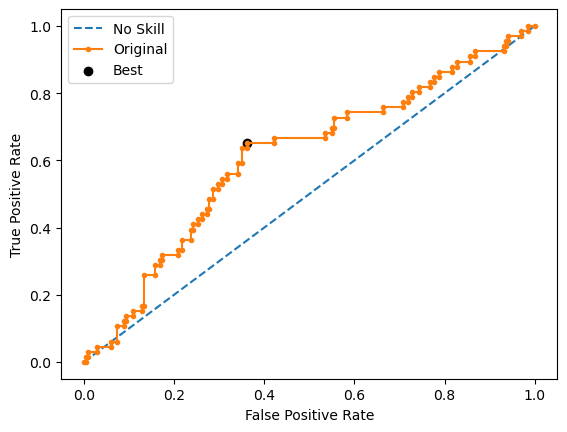

Learning rate set to 0.011215
0:	learn: 0.6879043	total: 4.71ms	remaining: 4.7s
1:	learn: 0.6846674	total: 12.6ms	remaining: 6.29s
2:	learn: 0.6807014	total: 16.4ms	remaining: 5.45s
3:	learn: 0.6759469	total: 20.3ms	remaining: 5.04s
4:	learn: 0.6721707	total: 24.6ms	remaining: 4.91s
5:	learn: 0.6678336	total: 29.4ms	remaining: 4.87s
6:	learn: 0.6633770	total: 33.1ms	remaining: 4.7s
7:	learn: 0.6597911	total: 35.8ms	remaining: 4.44s
8:	learn: 0.6557491	total: 39.3ms	remaining: 4.33s
9:	learn: 0.6520593	total: 43.1ms	remaining: 4.26s
10:	learn: 0.6480077	total: 45.9ms	remaining: 4.12s
11:	learn: 0.6449319	total: 48.1ms	remaining: 3.96s
12:	learn: 0.6407656	total: 51ms	remaining: 3.87s
13:	learn: 0.6371556	total: 53.3ms	remaining: 3.75s
14:	learn: 0.6350127	total: 56.4ms	remaining: 3.7s
15:	learn: 0.6320406	total: 59.6ms	remaining: 3.67s
16:	learn: 0.6298946	total: 62.2ms	remaining: 3.6s
17:	learn: 0.6265151	total: 65.3ms	remaining: 3.56s
18:	learn: 0.6238530	total: 68.2ms	remaining: 3.52

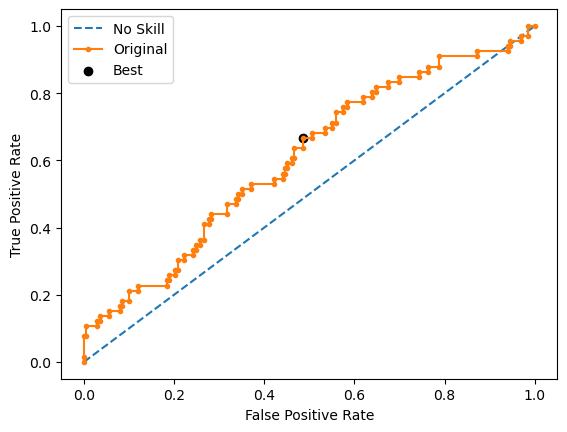

Learning rate set to 0.011188
0:	learn: 0.6880001	total: 4.74ms	remaining: 4.74s
1:	learn: 0.6822752	total: 8.62ms	remaining: 4.3s
2:	learn: 0.6781085	total: 13.2ms	remaining: 4.4s
3:	learn: 0.6728956	total: 17.6ms	remaining: 4.39s
4:	learn: 0.6692646	total: 21.2ms	remaining: 4.22s
5:	learn: 0.6653149	total: 23.9ms	remaining: 3.96s
6:	learn: 0.6607226	total: 26.6ms	remaining: 3.78s
7:	learn: 0.6564806	total: 29.4ms	remaining: 3.64s
8:	learn: 0.6528493	total: 33.3ms	remaining: 3.67s
9:	learn: 0.6478876	total: 35.8ms	remaining: 3.54s
10:	learn: 0.6436544	total: 38.4ms	remaining: 3.45s
11:	learn: 0.6410623	total: 42.2ms	remaining: 3.48s
12:	learn: 0.6366623	total: 45.7ms	remaining: 3.47s
13:	learn: 0.6328191	total: 49.1ms	remaining: 3.46s
14:	learn: 0.6302680	total: 52.3ms	remaining: 3.43s
15:	learn: 0.6271322	total: 55.1ms	remaining: 3.39s
16:	learn: 0.6234915	total: 58ms	remaining: 3.35s
17:	learn: 0.6197822	total: 61ms	remaining: 3.33s
18:	learn: 0.6166665	total: 63.8ms	remaining: 3.29

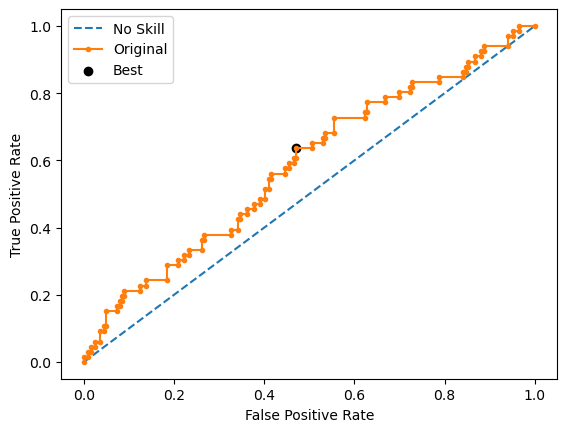

Learning rate set to 0.011219
0:	learn: 0.6884686	total: 5.92ms	remaining: 5.92s
1:	learn: 0.6840294	total: 9.84ms	remaining: 4.91s
2:	learn: 0.6800671	total: 14.1ms	remaining: 4.69s
3:	learn: 0.6779080	total: 16.5ms	remaining: 4.11s
4:	learn: 0.6752844	total: 18.9ms	remaining: 3.75s
5:	learn: 0.6711262	total: 21.6ms	remaining: 3.57s
6:	learn: 0.6663197	total: 24.5ms	remaining: 3.47s
7:	learn: 0.6619335	total: 27.1ms	remaining: 3.35s
8:	learn: 0.6588421	total: 29.4ms	remaining: 3.24s
9:	learn: 0.6553162	total: 32.6ms	remaining: 3.23s
10:	learn: 0.6496016	total: 35.4ms	remaining: 3.18s
11:	learn: 0.6463770	total: 38.2ms	remaining: 3.15s
12:	learn: 0.6429177	total: 41.2ms	remaining: 3.12s
13:	learn: 0.6391760	total: 43.8ms	remaining: 3.08s
14:	learn: 0.6359649	total: 46.9ms	remaining: 3.08s
15:	learn: 0.6317820	total: 49.1ms	remaining: 3.02s
16:	learn: 0.6277372	total: 51.3ms	remaining: 2.96s
17:	learn: 0.6247832	total: 54.3ms	remaining: 2.96s
18:	learn: 0.6211598	total: 57.1ms	remaining

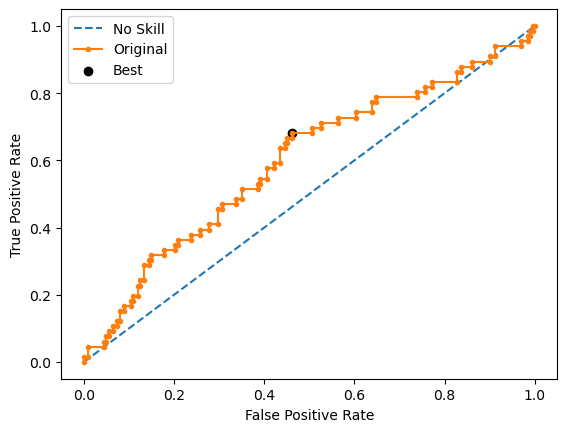

Ave Test G-mean: 0.32880947265791244
Stdev Test G-mean: 0.03354534767640231
Ave Test Specificity: 0.9455445544554456
Ave Test Recall: 0.11515151515151516
Ave Test NPV: 0.7658074740900213
Ave Test Accuracy: 0.741044776119403
Ave Test Precision: 0.41819412662090005
Ave Test F1-Score: 0.17986011048484798
Ave Runtime: 2.876487398147583


In [60]:
ho_t03_catboost_gs, ho_t03_catboost_be, ho_t03_catboost_model_info, ho_t03_catboost_metrics_df = catboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [65]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t03_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t03_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t03_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
2,Logistic Regression,0.577981,0.039071,0.352419,NaN,0.631683,0.530303,0.320972,0.399454,0.606716
7,Extreme Gradient Boosting (XGBoost),0.417251,0.028259,0.477039,0.742665,0.901980,0.193939,0.394232,0.259007,0.727612
3,Decision Tree,0.408771,0.033694,0.479206,NaN,0.881188,0.193939,0.378505,0.246586,0.711940
5,Gradient Boosting Machine (GBM),0.373457,0.029352,0.358452,0.779896,0.905941,0.154545,0.350449,0.214387,0.720896
4,Random Forest,0.345272,0.091273,0.423258,0.468652,0.935644,0.136364,0.420312,0.197766,0.738806
9,CatBoost,0.328809,0.033545,0.378214,0.831267,0.945545,0.115152,0.418194,0.179860,0.741045
6,LightGBM,0.325637,0.055352,0.497879,0.632819,0.922772,0.118182,0.333797,0.172068,0.724627
0,k-Nearest Neighbors,0.278452,0.053472,0.437500,0.503331,0.943564,0.084848,0.323616,0.133190,0.732090
8,AdaBoost,0.236078,0.057096,0.428333,0.823270,0.961386,0.060606,0.341154,0.102353,0.739552
1,SVM Classifier,0.179865,0.082443,0.512857,0.377998,0.585149,0.418182,0.294166,0.211185,0.544030


In [66]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t03_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.741045,CatBoost
Highest Test G-mean,0.577981,Logistic Regression
Highest Test Recall,0.530303,Logistic Regression
Highest Test Precision,0.420312,Random Forest
Highest Test Specificity,0.961386,AdaBoost
Highest Test F1-score,0.399454,Logistic Regression


# HO-T04 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1828 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 5, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'resampling': TomekLinks()}
Best Validation Score (G-mean): 0.40436507936507937
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()), ('resampling', TomekLinks()),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        max_features='sqrt', min_samples_leaf=3,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 135.10592412948608 secs
Run 1 - Random State: 0
Test G-mean: 0.44726879456155344
Best Threshold=0.320000, G-Mean=0.565


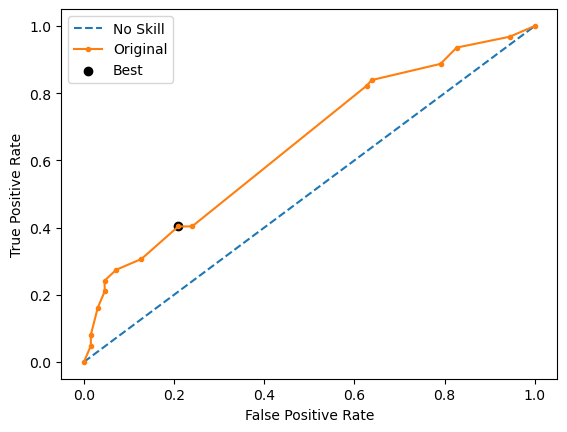

Run 2 - Random State: 1
Test G-mean: 0.21657760530082668
Best Threshold=0.240000, G-Mean=0.499


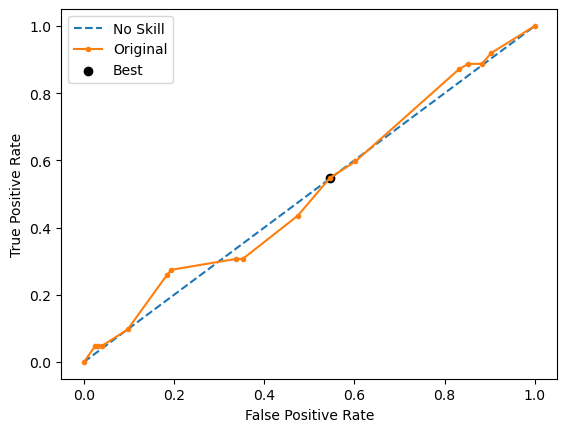

Run 3 - Random State: 2
Test G-mean: 0.4264540629514137
Best Threshold=0.250000, G-Mean=0.566


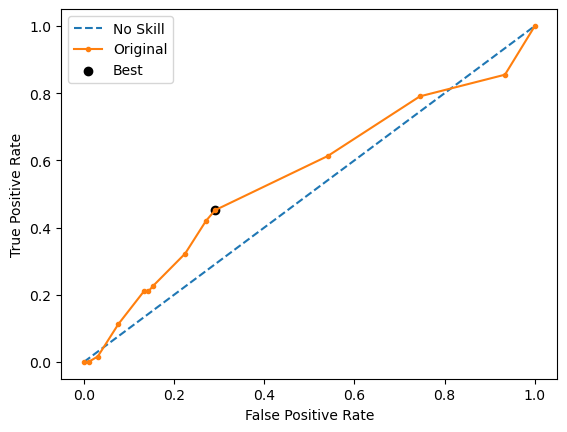

Run 4 - Random State: 3
Test G-mean: 0.37015467471401725
Best Threshold=0.336245, G-Mean=0.586


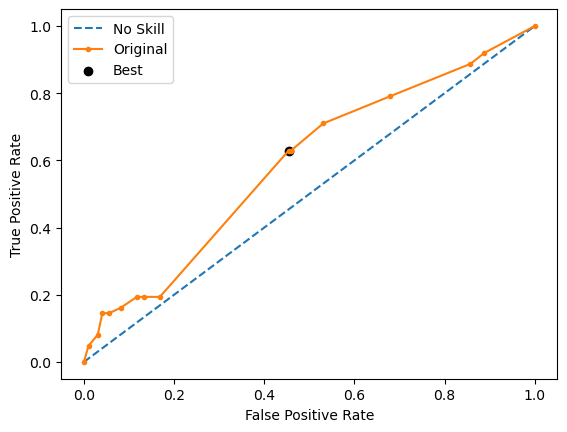

Run 5 - Random State: 4
Test G-mean: 0.37839966540785525
Best Threshold=0.315789, G-Mean=0.537


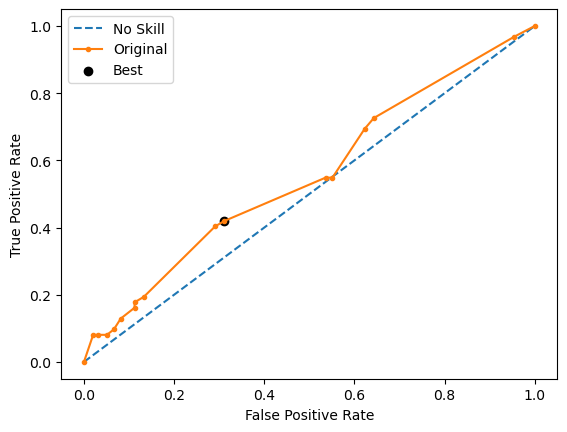

Ave Test G-mean: 0.3677709605871332
Stdev Test G-mean: 0.09047333067216158
Ave Test Specificity: 0.9244897959183673
Ave Test Recall: 0.15483870967741936
Ave Test NPV: 0.7757806453496714
Ave Test Accuracy: 0.7395348837209302
Ave Test Precision: 0.4040151515151515
Ave Test F1-Score: 0.21674694938406955
Ave Runtime: 0.03063178062438965


In [62]:
ho_t04_dt_gs, ho_t04_dt_be, ho_t04_dt_model_info, ho_t04_dt_metrics_df = dt_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.3465673006044523
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1000000.0, max_iter=1000,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 52.12882161140442 secs
Run 1 - Random State: 0
Test G-mean: 0.49520412266792313
Best Threshold=0.424085, G-Mean=0.617


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


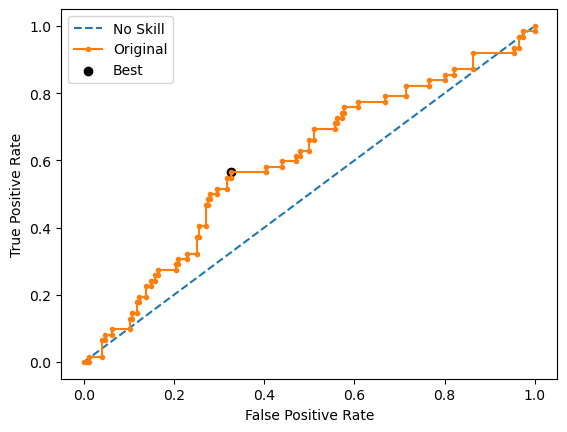

Run 2 - Random State: 1
Test G-mean: 0.570275333983824
Best Threshold=0.480407, G-Mean=0.582


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


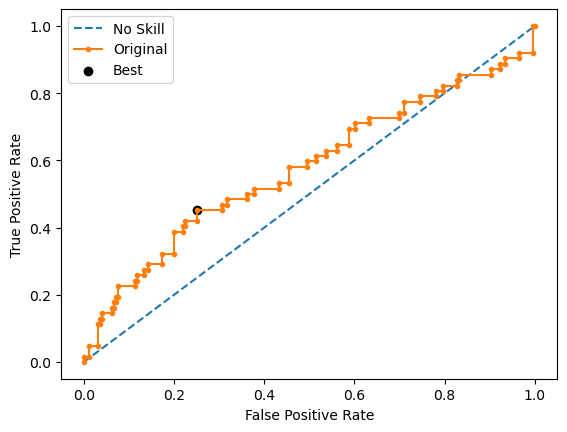

Run 3 - Random State: 2
Test G-mean: 0.48985763271502053
Best Threshold=0.444492, G-Mean=0.575


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


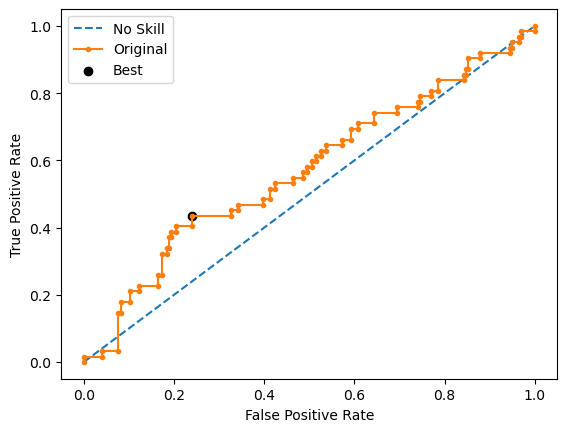

Run 4 - Random State: 3
Test G-mean: 0.4858938404903532
Best Threshold=0.311004, G-Mean=0.589


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


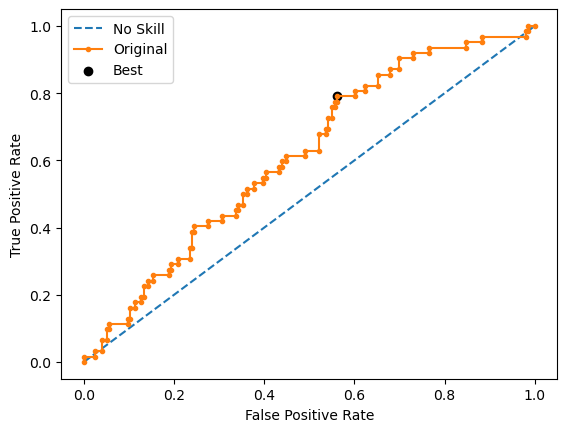

Run 5 - Random State: 4
Test G-mean: 0.4834318832887613
Best Threshold=0.356007, G-Mean=0.558


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


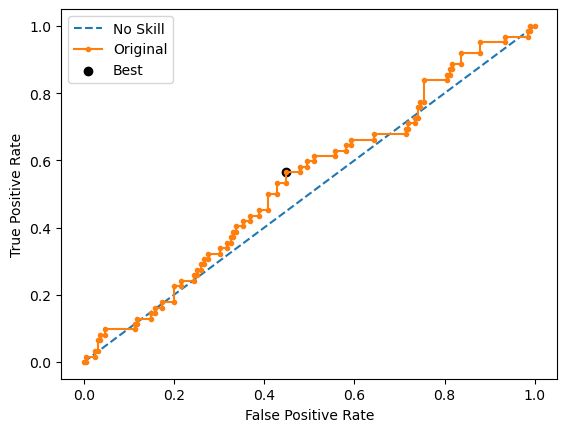

Ave Test G-mean: 0.5049325626291764
Stdev Test G-mean: 0.03679784632652041
Ave Test Specificity: 0.7714285714285715
Ave Test Recall: 0.332258064516129
Ave Test NPV: 0.7850225526457497
Ave Test Accuracy: 0.665891472868217
Ave Test Precision: 0.316647030107851
Ave Test F1-Score: 0.3231022671299149
Ave Runtime: 0.1817783832550049


In [63]:
ho_t04_logreg_gs, ho_t04_logreg_be, ho_t04_logreg_model_info, ho_t04_logreg_metrics_df = logreg_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1.0, 'classifier__kernel': 'poly', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5111904761904762
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(kernel='poly', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2927512954005278
Std Train Score (G-mean) 0.06423447485126267
GridSearchCV Runtime: 55.964396238327026 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.2160069123317937
Best Threshold=0.376333, G-Mean=0.477


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


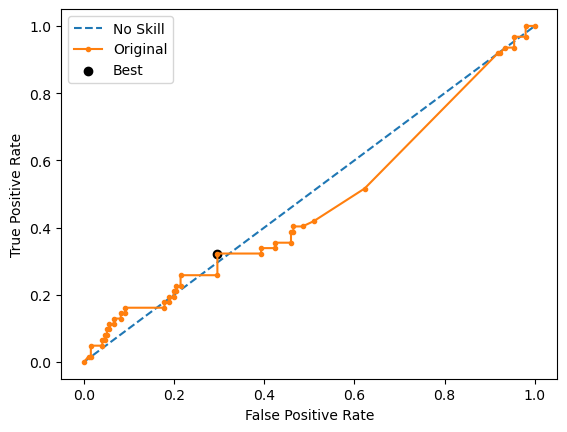

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.2781250115577218
Best Threshold=0.395106, G-Mean=0.509


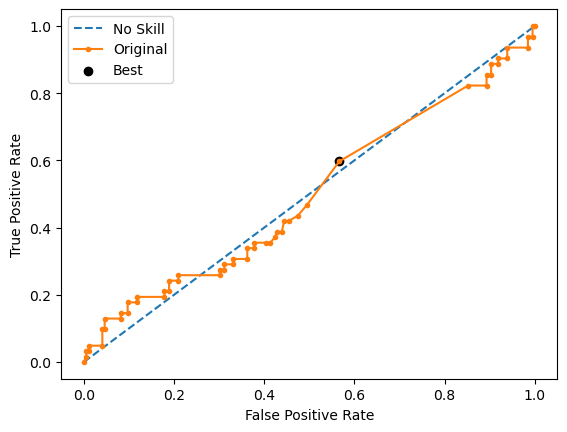

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.389565, G-Mean=0.500


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


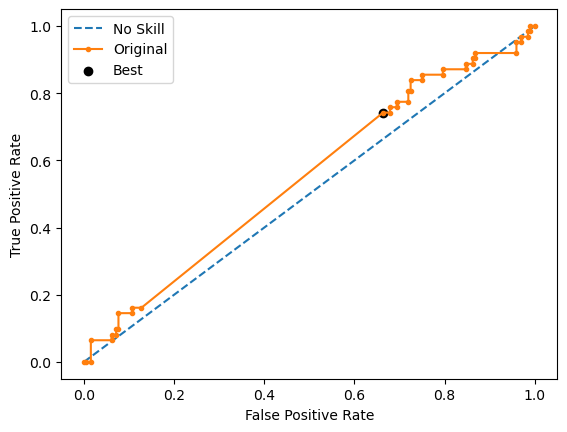

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.21486097898330503
Best Threshold=0.361018, G-Mean=0.460


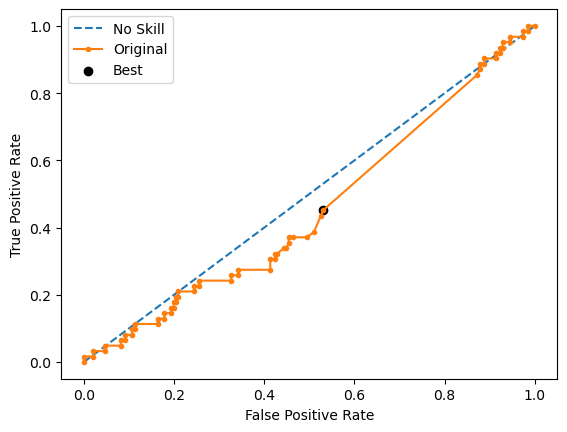

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.2160069123317937
Best Threshold=0.386946, G-Mean=0.485


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


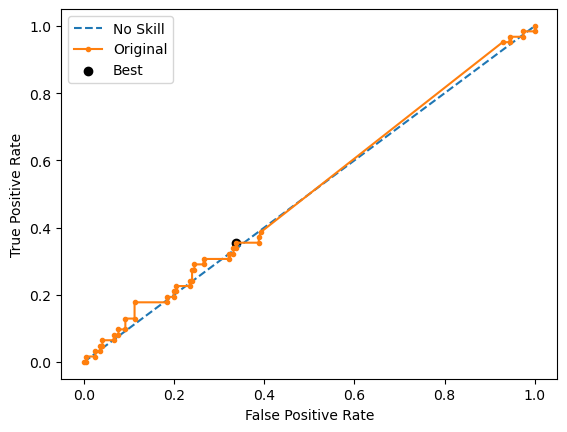

Ave Test G-mean: 0.18499996304092287
Stdev Test G-mean: 0.10690159384705572
Ave Test Specificity: 0.9683673469387756
Ave Test Recall: 0.04516129032258065
Ave Test NPV: 0.7622786022538487
Ave Test Accuracy: 0.7465116279069768
Ave Test Precision: 0.24692307692307694
Ave Test F1-Score: 0.07621621621621621
Ave Runtime: 0.059929418563842776


In [67]:
ho_t04_svm_gs, ho_t04_svm_be, ho_t04_svm_model_info, ho_t04_svm_metrics_df = svm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [68]:
ho_t04_knn_gs, ho_t04_knn_be, ho_t04_knn_model_info, ho_t04_knn_metrics_df = knn_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 12, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.55
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=12))])
Mean Train Score (G-mean) 0.5168898767551461
Std Train Score (G-mean) 0.018091255999262017
GridSearchCV Runtime: 35.55286526679993 secs
Run 1 - Random State: 0
Test G-mean: 0.1786865988049889
Run 2 - Random State: 1
Test G-mean: 0.25073952503362573
Run 3 - Random State: 2
Test G-mean: 0.12635050572216766
Run 4 - Random State: 3
Test G-mean: 0.24743582965269675
Run 5 - Random State: 4
Test G-mean: 0.12536976251681287
Ave Test G-mean: 0.18571644434605838
Stdev Test G-mean: 0.06175098976850134
Ave Test Specificity: 0.9755102040816327
Ave Test Recall: 0.03870967741935484
Ave Test NPV: 0.7623727408561272
Ave Test 

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.501031746031746
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
               

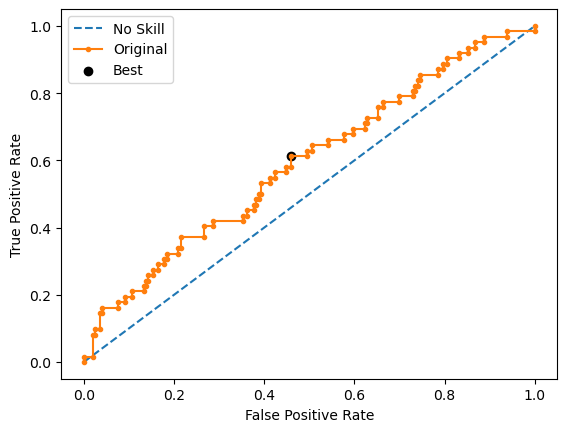

Run 2 - Random State: 1
Test G-mean: 0.3870007561406776
Best Threshold=0.346381, G-Mean=0.602


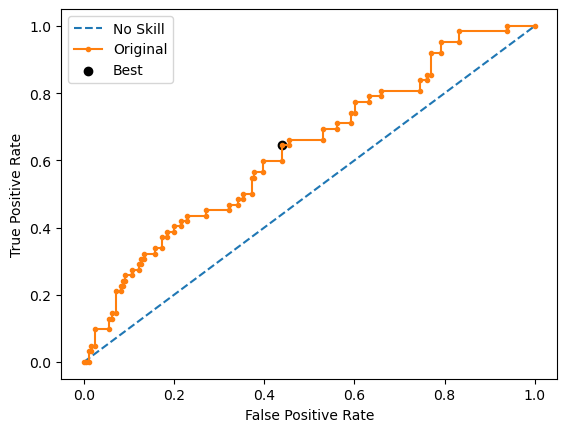

Run 3 - Random State: 2
Test G-mean: 0.24408742322731114
Best Threshold=0.366415, G-Mean=0.594


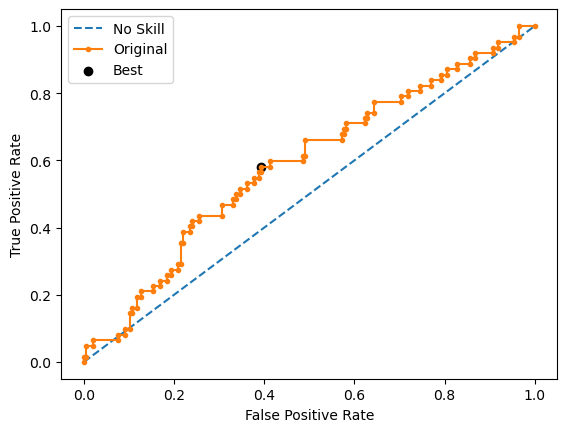

Run 4 - Random State: 3
Test G-mean: 0.47915742374995496
Best Threshold=0.408026, G-Mean=0.594


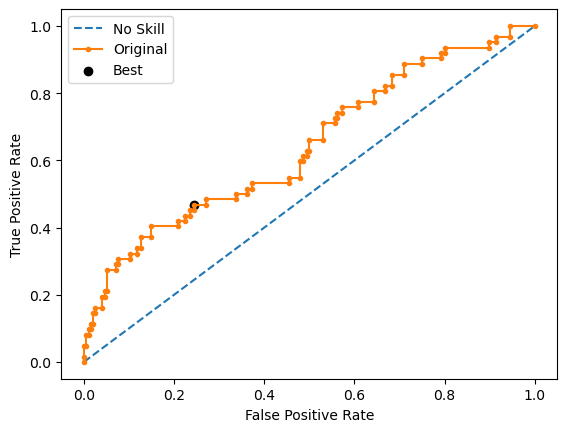

Run 5 - Random State: 4
Test G-mean: 0.36103865964609944
Best Threshold=0.398412, G-Mean=0.568


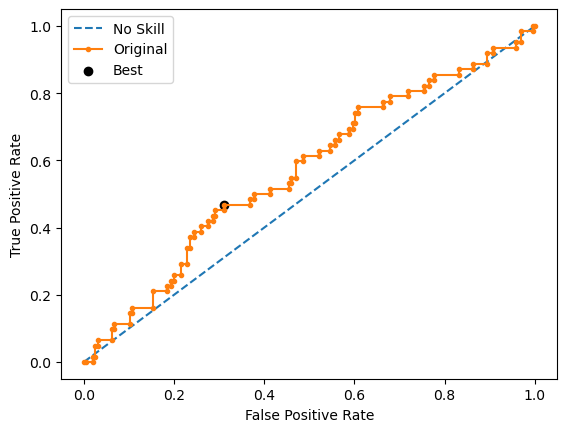

Ave Test G-mean: 0.3725029321964038
Stdev Test G-mean: 0.08449564772837946
Ave Test Specificity: 0.9295918367346939
Ave Test Recall: 0.15483870967741936
Ave Test NPV: 0.7766909544639307
Ave Test Accuracy: 0.7434108527131783
Ave Test Precision: 0.4075075620084695
Ave Test F1-Score: 0.22357115893342674
Ave Runtime: 0.17369303703308106


In [69]:
ho_t04_xgb_gs, ho_t04_xgb_be, ho_t04_xgb_model_info, ho_t04_xgb_metrics_df = xgb_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002118 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6521
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

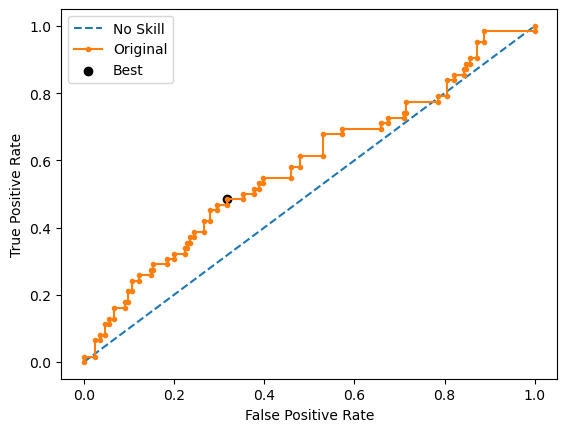

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000794 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6475
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

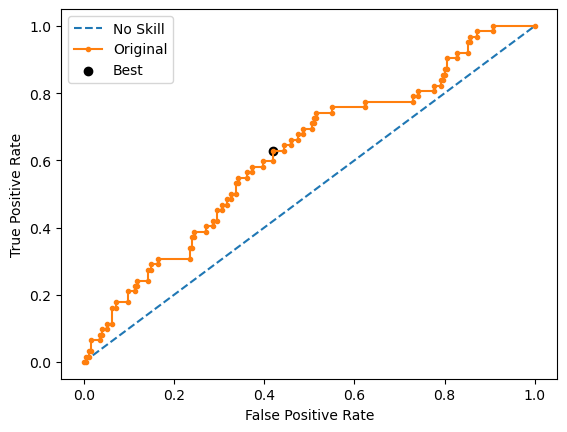

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001415 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6596
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

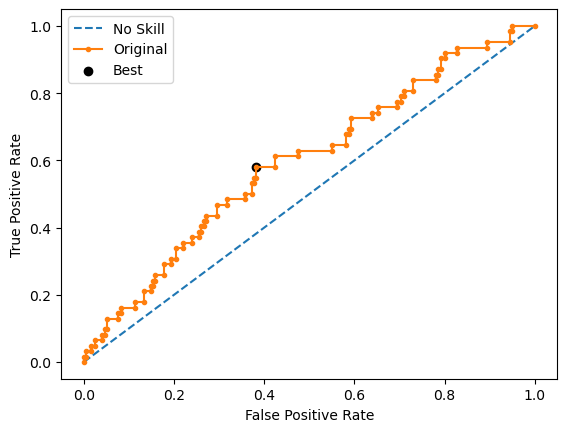

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6770
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

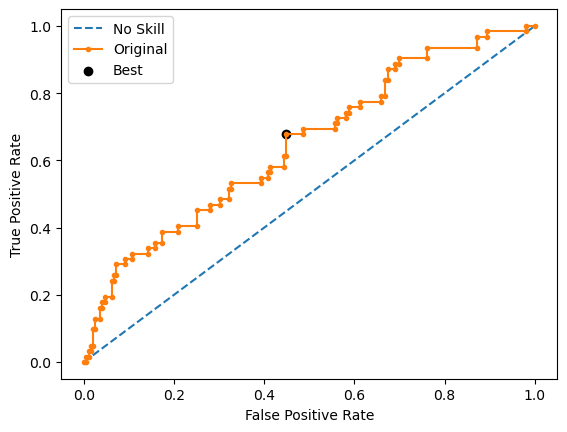

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001283 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6646
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

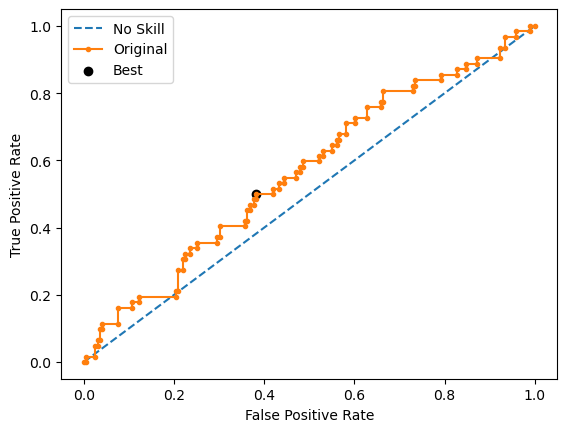

Ave Test G-mean: 0.35531343721456027
Stdev Test G-mean: 0.06684508972254796
Ave Test Specificity: 0.9387755102040817
Ave Test Recall: 0.13870967741935486
Ave Test NPV: 0.7752016370340566
Ave Test Accuracy: 0.7465116279069768
Ave Test Precision: 0.4101823361823362
Ave Test F1-Score: 0.20502132531980105
Ave Runtime: 0.14330410957336426


In [70]:
ho_t04_lgbm_gs, ho_t04_lgbm_be, ho_t04_lgbm_model_info, ho_t04_lgbm_metrics_df = lgbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5178571428571428
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8313587148493793
Std Train Score (G-mean) 0.009611448197179427
GridSearchCV Runtime: 12.369494199752808 secs
Run 1 - Random State: 0
Test G-mean: 0.21714679841196405
Best Threshold=0.880797, G-Mean=0.217


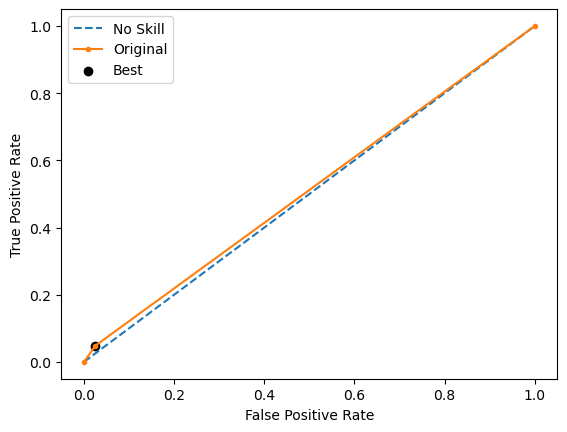

Run 2 - Random State: 1
Test G-mean: 0.30709194734009604
Best Threshold=0.880797, G-Mean=0.307


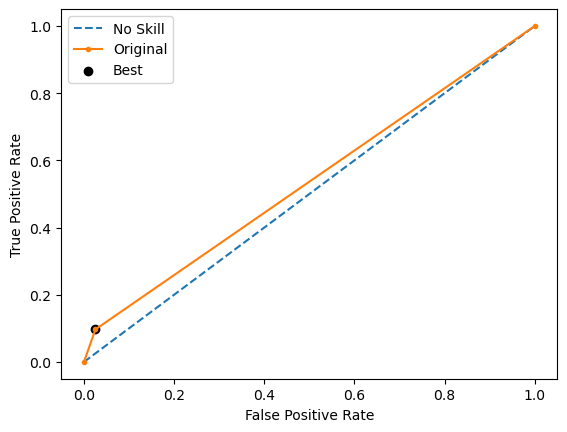

Run 3 - Random State: 2
Test G-mean: 0.2796004861638617
Best Threshold=0.880797, G-Mean=0.280


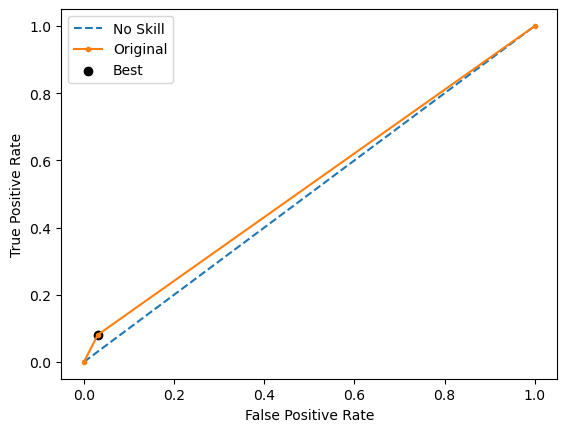

Run 4 - Random State: 3
Test G-mean: 0.24942329796316198
Best Threshold=0.880797, G-Mean=0.249


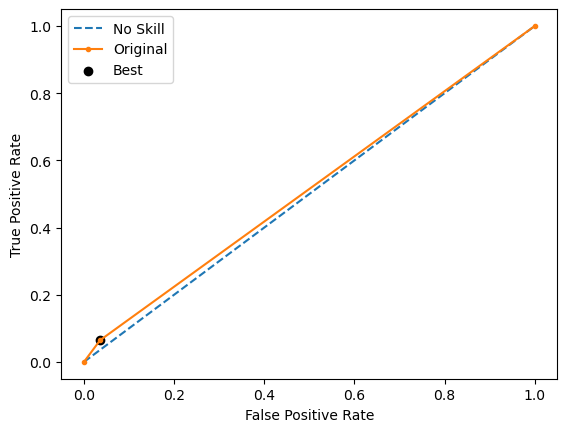

Run 5 - Random State: 4
Test G-mean: 0.25008227744175365
Best Threshold=0.880797, G-Mean=0.250


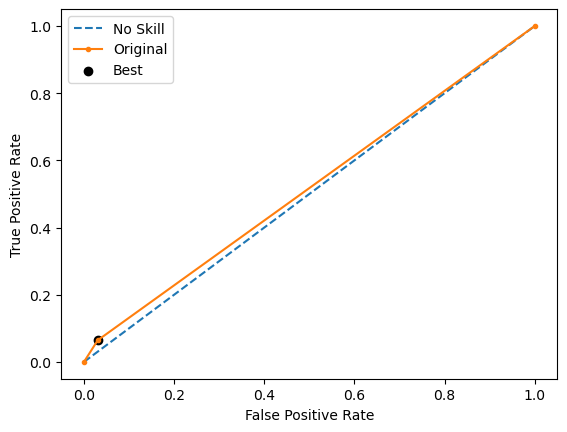

Ave Test G-mean: 0.2606689614641675
Stdev Test G-mean: 0.034081585013034
Ave Test Specificity: 0.9704081632653061
Ave Test Recall: 0.07096774193548386
Ave Test NPV: 0.7675642679900745
Ave Test Accuracy: 0.7542635658914729
Ave Test Precision: 0.42772727272727273
Ave Test F1-Score: 0.12155686018699716
Ave Runtime: 0.3385478019714355


In [71]:
ho_t04_adaboost_gs, ho_t04_adaboost_be, ho_t04_adaboost_model_info, ho_t04_adaboost_metrics_df = adaboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.43992063492063493
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.7907411228811999
Std Train Score (G-mean) 0.014573967336020798
GridSearchCV Runtime: 81.51913452148438 secs
Run 1 - Random State: 0
Test G-mean: 0.3620628848518285
Best Threshold=0.336582, G-Mean=0.596


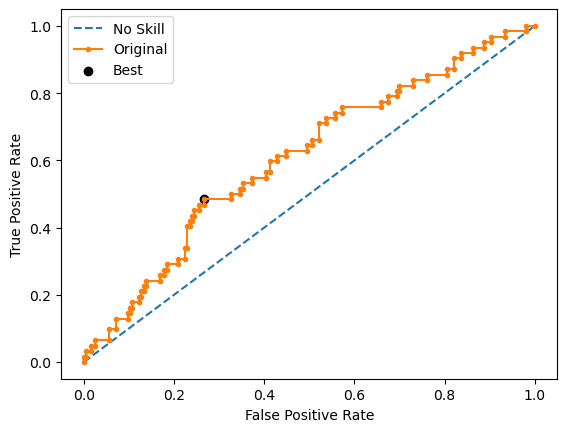

Run 2 - Random State: 1
Test G-mean: 0.4036534927370442
Best Threshold=0.265363, G-Mean=0.578


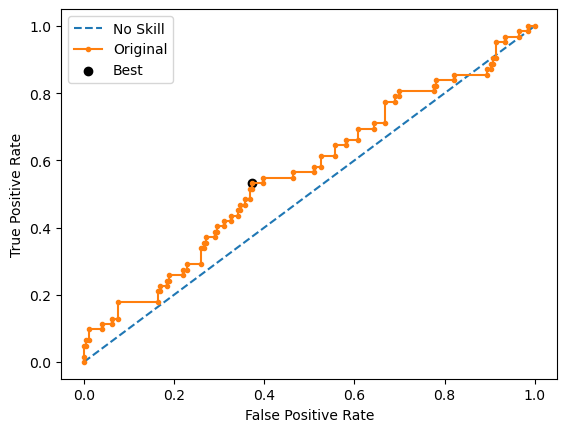

Run 3 - Random State: 2
Test G-mean: 0.3681484015397691
Best Threshold=0.241161, G-Mean=0.593


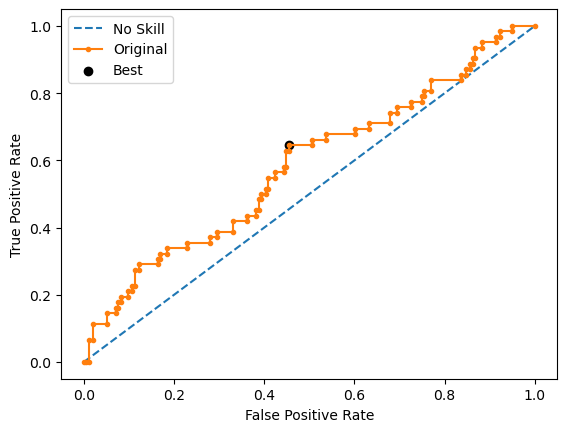

Run 4 - Random State: 3
Test G-mean: 0.3837979361932545
Best Threshold=0.262183, G-Mean=0.605


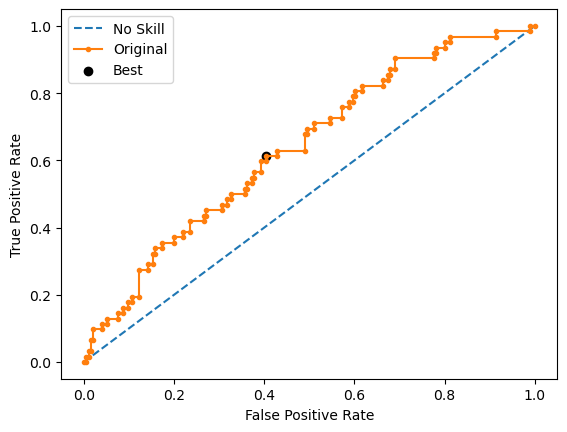

Run 5 - Random State: 4
Test G-mean: 0.31930945076151773
Best Threshold=0.249851, G-Mean=0.527


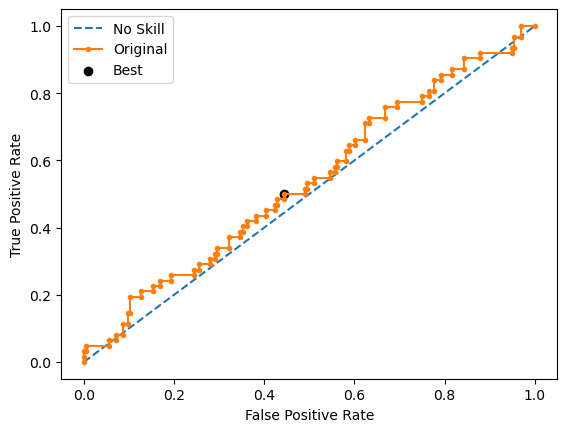

Ave Test G-mean: 0.3673944332166828
Stdev Test G-mean: 0.03132472554195821
Ave Test Specificity: 0.9142857142857143
Ave Test Recall: 0.14838709677419354
Ave Test NPV: 0.7724065069600353
Ave Test Accuracy: 0.7302325581395348
Ave Test Precision: 0.3555056055056055
Ave Test F1-Score: 0.20905734714723478
Ave Runtime: 1.640909481048584


In [72]:
ho_t04_gbm_gs, ho_t04_gbm_be, ho_t04_gbm_model_info, ho_t04_gbm_metrics_df = gbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.40523809523809523
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=2,
                                        min_samples_leaf=2, n_estimators=200,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.48399427614133644
Std Train Score (G-mean) 0.02349097226670289
GridSearchCV Runtime: 245.73075342178345 secs
Run 1 - Random State: 0
Test G-mean: 0.24810008810871542
Best Threshold=0.393364, G-Mean=0.672


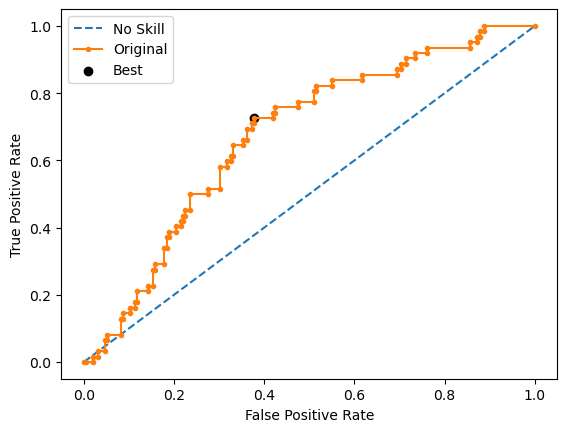

Run 2 - Random State: 1
Test G-mean: 0.24676978314267814
Best Threshold=0.404880, G-Mean=0.598


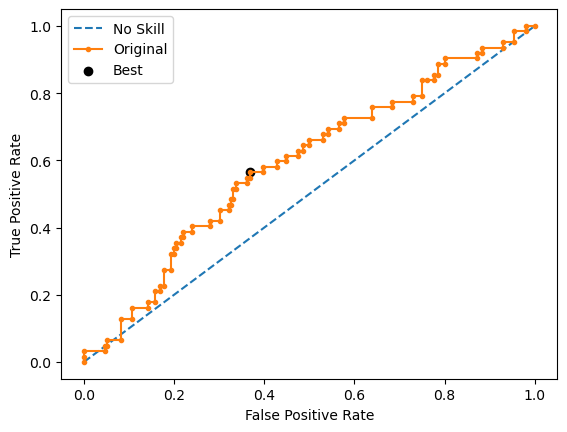

Run 3 - Random State: 2
Test G-mean: 0.2527010114443354
Best Threshold=0.404792, G-Mean=0.605


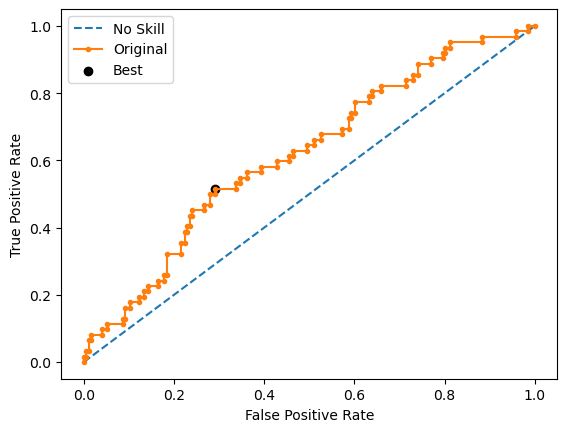

Run 4 - Random State: 3
Test G-mean: 0.17636890537566463
Best Threshold=0.385971, G-Mean=0.596


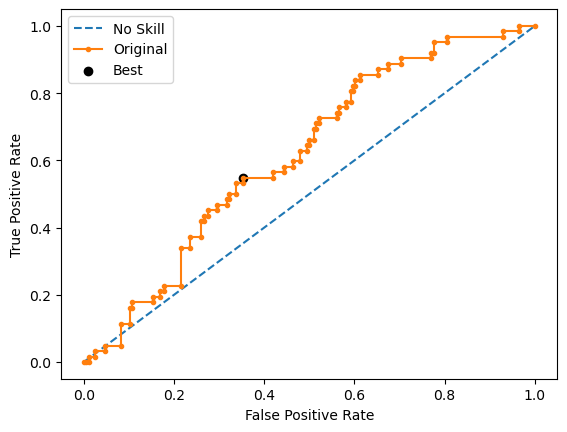

Run 5 - Random State: 4
Test G-mean: 0.2160069123317937
Best Threshold=0.385747, G-Mean=0.610


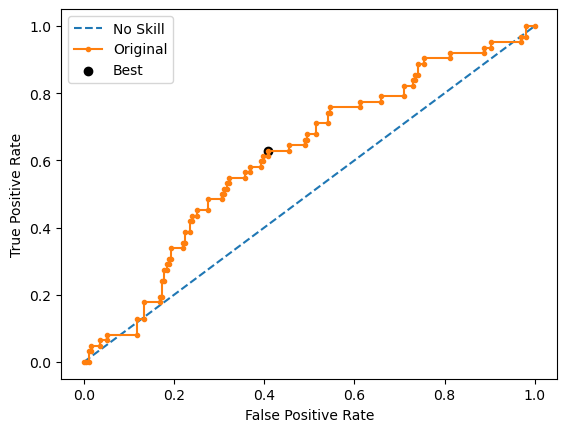

Ave Test G-mean: 0.22798934008063748
Stdev Test G-mean: 0.03231122786017821
Ave Test Specificity: 0.963265306122449
Ave Test Recall: 0.05483870967741935
Ave Test NPV: 0.7631112734327129
Ave Test Accuracy: 0.7449612403100775
Ave Test Precision: 0.3526495726495727
Ave Test F1-Score: 0.09357623817772946
Ave Runtime: 0.296315860748291


In [73]:
ho_t04_rf_gs, ho_t04_rf_be, ho_t04_rf_model_info, ho_t04_rf_metrics_df = rf_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.011041
0:	learn: 0.6897393	total: 3.21ms	remaining: 3.21s
1:	learn: 0.6841279	total: 5.83ms	remaining: 2.91s
2:	learn: 0.6798146	total: 8.62ms	remaining: 2.86s
3:	learn: 0.6749653	total: 11.3ms	remaining: 2.81s
4:	learn: 0.6705410	total: 14.2ms	remaining: 2.82s
5:	learn: 0.6662830	total: 16.8ms	remaining: 2.79s
6:	learn: 0.6623527	total: 19.6ms	remaining: 2.77s
7:	learn: 0.6571081	total: 22ms	remaining: 2.73s
8:	learn: 0.6536600	total: 24.7ms	remaining: 2.72s
9:	learn: 0.6497836	total: 27.2ms	remaining: 2.7s
10:	learn: 0.6475675	total: 30.1ms	remaining: 2.71s
11:	learn: 0.6439513	total: 33.3ms	remaining: 2.74s
12:	learn: 0.6404952	total: 36.4ms	remaining: 2.76s
13:	learn: 0.6373916	total: 39.6ms	remaining: 2.79s
14:	learn: 0.6343869	total: 42.6ms	remaining: 2.8s
15:	learn: 0.6316362	total: 45.8ms	remaining: 2.82s
16:	learn: 0.6264435	total: 49.3ms	remaining: 2.85s
17:	learn: 0.6237244	total: 52.8ms	remaining: 2.88s
18:	learn: 0.6205315	total: 55.9ms	remaining: 2.

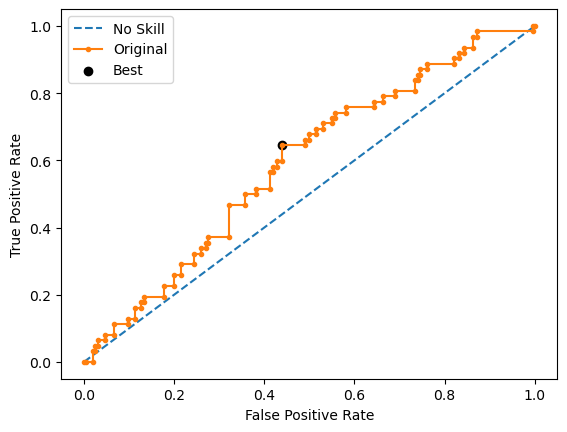

Learning rate set to 0.011041
0:	learn: 0.6888356	total: 2.72ms	remaining: 2.72s
1:	learn: 0.6851868	total: 5.51ms	remaining: 2.75s
2:	learn: 0.6821615	total: 8.08ms	remaining: 2.68s
3:	learn: 0.6780090	total: 11.6ms	remaining: 2.88s
4:	learn: 0.6735296	total: 14.8ms	remaining: 2.94s
5:	learn: 0.6692733	total: 17.7ms	remaining: 2.93s
6:	learn: 0.6666558	total: 20.1ms	remaining: 2.85s
7:	learn: 0.6634860	total: 22.5ms	remaining: 2.79s
8:	learn: 0.6597944	total: 25.1ms	remaining: 2.76s
9:	learn: 0.6573230	total: 27.9ms	remaining: 2.76s
10:	learn: 0.6534985	total: 30.7ms	remaining: 2.76s
11:	learn: 0.6486816	total: 33.6ms	remaining: 2.77s
12:	learn: 0.6458832	total: 36.3ms	remaining: 2.76s
13:	learn: 0.6424937	total: 39.2ms	remaining: 2.76s
14:	learn: 0.6375698	total: 42.5ms	remaining: 2.79s
15:	learn: 0.6337857	total: 45.6ms	remaining: 2.81s
16:	learn: 0.6305598	total: 49.3ms	remaining: 2.85s
17:	learn: 0.6279635	total: 52.4ms	remaining: 2.86s
18:	learn: 0.6252924	total: 55.9ms	remaining

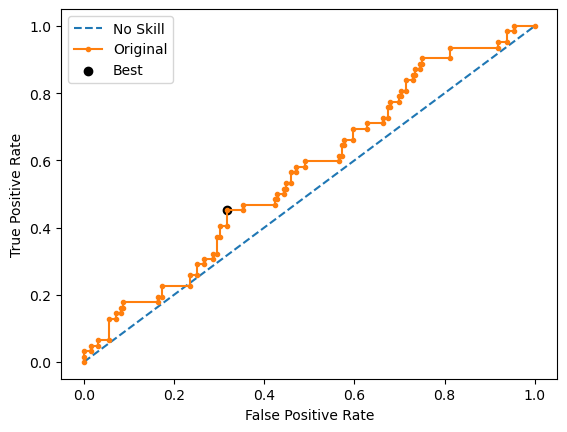

Learning rate set to 0.011041
0:	learn: 0.6880859	total: 3.42ms	remaining: 3.41s
1:	learn: 0.6822332	total: 5.68ms	remaining: 2.84s
2:	learn: 0.6779114	total: 10.1ms	remaining: 3.36s
3:	learn: 0.6738665	total: 13.2ms	remaining: 3.3s
4:	learn: 0.6695909	total: 16ms	remaining: 3.19s
5:	learn: 0.6642097	total: 19.4ms	remaining: 3.22s
6:	learn: 0.6599906	total: 22ms	remaining: 3.12s
7:	learn: 0.6553172	total: 24.9ms	remaining: 3.08s
8:	learn: 0.6514397	total: 28.2ms	remaining: 3.1s
9:	learn: 0.6481419	total: 31.1ms	remaining: 3.08s
10:	learn: 0.6440340	total: 34.3ms	remaining: 3.09s
11:	learn: 0.6401849	total: 37.9ms	remaining: 3.12s
12:	learn: 0.6362774	total: 40.6ms	remaining: 3.08s
13:	learn: 0.6327638	total: 43.3ms	remaining: 3.05s
14:	learn: 0.6295930	total: 46.7ms	remaining: 3.07s
15:	learn: 0.6270442	total: 49.4ms	remaining: 3.04s
16:	learn: 0.6246941	total: 53ms	remaining: 3.06s
17:	learn: 0.6214533	total: 55.9ms	remaining: 3.05s
18:	learn: 0.6184495	total: 58.6ms	remaining: 3.03s


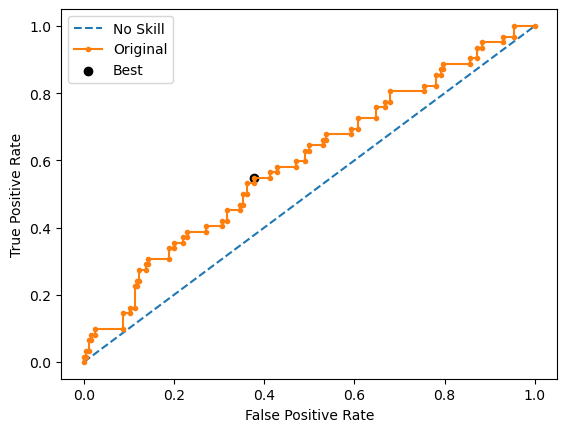

Learning rate set to 0.011041
0:	learn: 0.6894139	total: 5.11ms	remaining: 5.1s
1:	learn: 0.6839937	total: 9.31ms	remaining: 4.65s
2:	learn: 0.6788964	total: 13.4ms	remaining: 4.46s
3:	learn: 0.6744967	total: 17.8ms	remaining: 4.43s
4:	learn: 0.6693236	total: 21.7ms	remaining: 4.33s
5:	learn: 0.6647768	total: 25.6ms	remaining: 4.25s
6:	learn: 0.6607485	total: 30.1ms	remaining: 4.27s
7:	learn: 0.6573416	total: 32.5ms	remaining: 4.02s
8:	learn: 0.6530205	total: 35.8ms	remaining: 3.94s
9:	learn: 0.6496459	total: 38.3ms	remaining: 3.79s
10:	learn: 0.6462046	total: 41.6ms	remaining: 3.74s
11:	learn: 0.6419946	total: 44.1ms	remaining: 3.63s
12:	learn: 0.6387007	total: 47.5ms	remaining: 3.6s
13:	learn: 0.6352784	total: 50.5ms	remaining: 3.56s
14:	learn: 0.6319602	total: 52.9ms	remaining: 3.47s
15:	learn: 0.6301047	total: 55.8ms	remaining: 3.43s
16:	learn: 0.6249834	total: 58.4ms	remaining: 3.37s
17:	learn: 0.6225389	total: 61.2ms	remaining: 3.34s
18:	learn: 0.6196997	total: 64ms	remaining: 3.

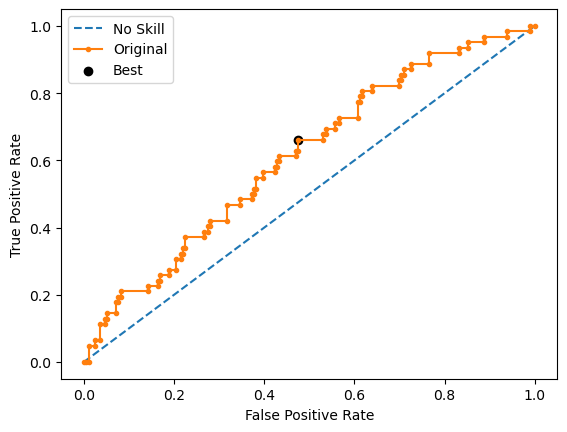

Learning rate set to 0.011041
0:	learn: 0.6886076	total: 3.73ms	remaining: 3.73s
1:	learn: 0.6846852	total: 7.61ms	remaining: 3.79s
2:	learn: 0.6797869	total: 11.3ms	remaining: 3.76s
3:	learn: 0.6761379	total: 14.1ms	remaining: 3.51s
4:	learn: 0.6723613	total: 16.6ms	remaining: 3.31s
5:	learn: 0.6684215	total: 19.5ms	remaining: 3.23s
6:	learn: 0.6642164	total: 26.3ms	remaining: 3.73s
7:	learn: 0.6595258	total: 29.2ms	remaining: 3.62s
8:	learn: 0.6554039	total: 33.6ms	remaining: 3.7s
9:	learn: 0.6520382	total: 37.2ms	remaining: 3.68s
10:	learn: 0.6481258	total: 39.9ms	remaining: 3.58s
11:	learn: 0.6445152	total: 42.8ms	remaining: 3.52s
12:	learn: 0.6405441	total: 46.2ms	remaining: 3.51s
13:	learn: 0.6372748	total: 49.4ms	remaining: 3.48s
14:	learn: 0.6333923	total: 52.6ms	remaining: 3.46s
15:	learn: 0.6298414	total: 55.7ms	remaining: 3.42s
16:	learn: 0.6249765	total: 58.2ms	remaining: 3.37s
17:	learn: 0.6222429	total: 61ms	remaining: 3.33s
18:	learn: 0.6196445	total: 63.5ms	remaining: 3

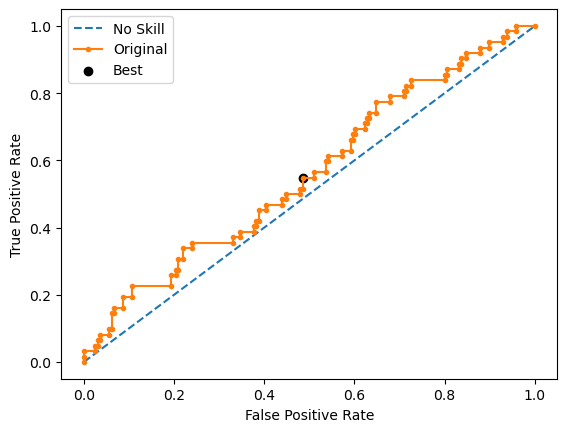

Ave Test G-mean: 0.3282633489254545
Stdev Test G-mean: 0.04099628398898757
Ave Test Specificity: 0.9428571428571428
Ave Test Recall: 0.11612903225806452
Ave Test NPV: 0.771315977670656
Ave Test Accuracy: 0.7441860465116279
Ave Test Precision: 0.39859465153582807
Ave Test F1-Score: 0.17750087857136349
Ave Runtime: 3.0999550819396973


In [74]:
ho_t04_catboost_gs, ho_t04_catboost_be, ho_t04_catboost_model_info, ho_t04_catboost_metrics_df = catboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [75]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t04_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t04_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t04_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
2,Logistic Regression,0.504933,0.036798,0.346567,NaN,0.771429,0.332258,0.316647,0.323102,0.665891
7,Extreme Gradient Boosting (XGBoost),0.372503,0.084496,0.501032,0.761886,0.929592,0.154839,0.407508,0.223571,0.743411
3,Decision Tree,0.367771,0.090473,0.404365,NaN,0.924490,0.154839,0.404015,0.216747,0.739535
5,Gradient Boosting Machine (GBM),0.367394,0.031325,0.439921,0.790741,0.914286,0.148387,0.355506,0.209057,0.730233
6,LightGBM,0.355313,0.066845,0.531667,0.655338,0.938776,0.138710,0.410182,0.205021,0.746512
9,CatBoost,0.328263,0.040996,0.448016,0.839741,0.942857,0.116129,0.398595,0.177501,0.744186
8,AdaBoost,0.260669,0.034082,0.517857,0.831359,0.970408,0.070968,0.427727,0.121557,0.754264
4,Random Forest,0.227989,0.032311,0.405238,0.483994,0.963265,0.054839,0.352650,0.093576,0.744961
0,k-Nearest Neighbors,0.185716,0.061751,0.550000,0.516890,0.975510,0.038710,0.346032,0.067745,0.750388
1,SVM Classifier,0.185000,0.106902,0.511190,0.292751,0.968367,0.045161,0.246923,0.076216,0.746512


In [76]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t04_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.754264,AdaBoost
Highest Test G-mean,0.504933,Logistic Regression
Highest Test Recall,0.332258,Logistic Regression
Highest Test Precision,0.427727,AdaBoost
Highest Test Specificity,0.975510,k-Nearest Neighbors
Highest Test F1-score,0.323102,Logistic Regression


# HO-T05 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2352 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': TomekLinks()}
Best Validation Score (G-mean): 0.55
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()), ('resampling', TomekLinks()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, max_features='log2',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 117.73657751083374 secs
Run 1 - Random State: 0
Test G-mean: 0.12536976251681287
Best Threshold=0.285246, G-Mean=0.523


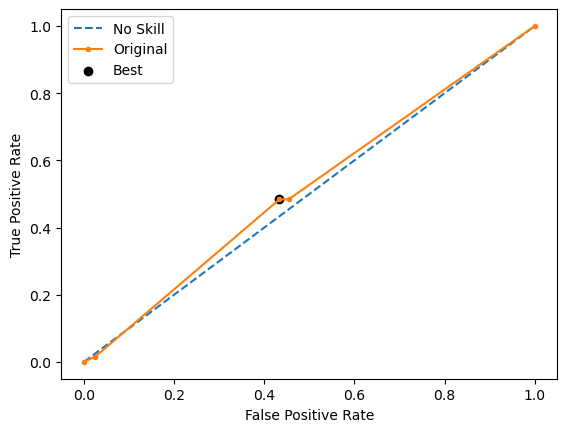

Run 2 - Random State: 1
Test G-mean: 0.0
Best Threshold=0.283516, G-Mean=0.491


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


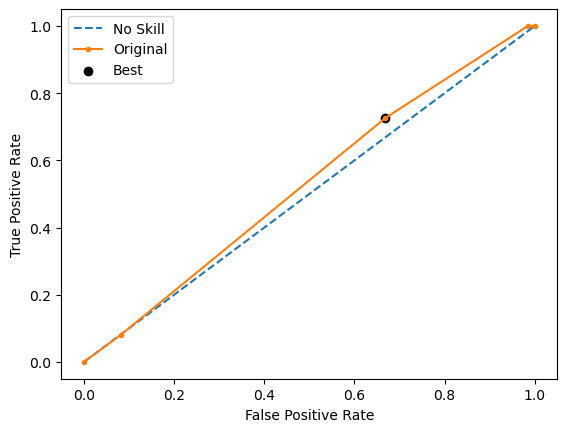

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.388889, G-Mean=0.320


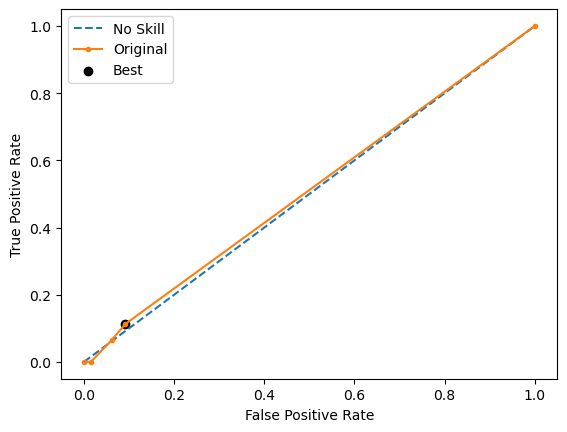

Run 4 - Random State: 3
Test G-mean: 0.1744925870521215
Best Threshold=0.278884, G-Mean=0.499


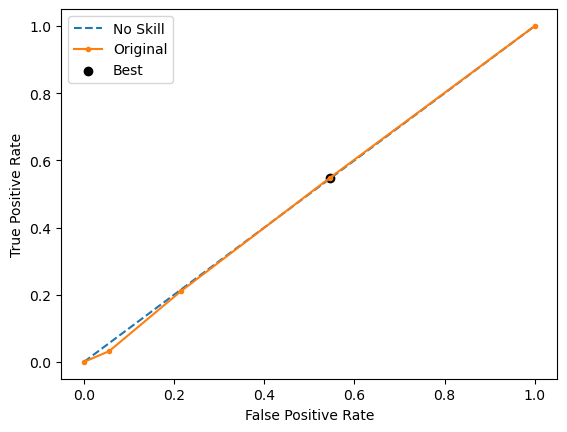

Run 5 - Random State: 4
Test G-mean: 0.21486097898330503
Best Threshold=0.285714, G-Mean=0.274


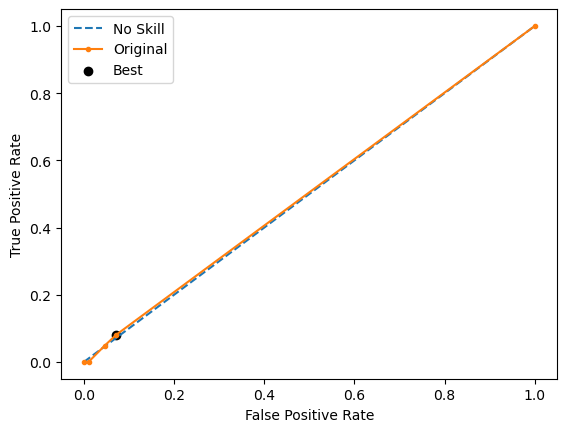

Ave Test G-mean: 0.10294466571044789
Stdev Test G-mean: 0.0991746686258003
Ave Test Specificity: 0.9714285714285713
Ave Test Recall: 0.01935483870967742
Ave Test NPV: 0.757950763591502
Ave Test Accuracy: 0.7426356589147287
Ave Test Precision: 0.1141025641025641
Ave Test F1-Score: 0.032765235824059345
Ave Runtime: 0.036469554901123045


In [77]:
ho_t05_dt_gs, ho_t05_dt_be, ho_t05_dt_model_info, ho_t05_dt_metrics_df = dt_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.36688866688866695
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 53.30505919456482 secs
Run 1 - Random State: 0
Test G-mean: 0.32289731000901806
Best Threshold=0.499941, G-Mean=0.580


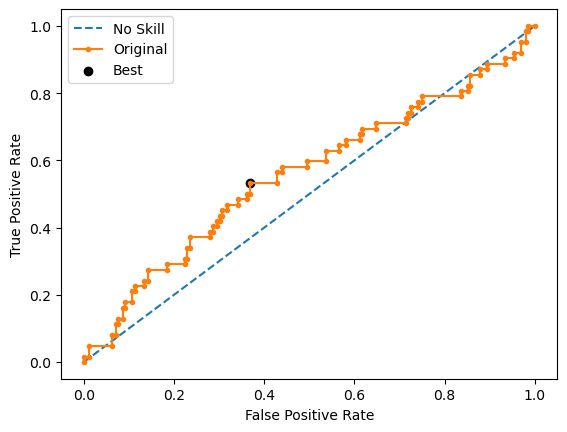

Run 2 - Random State: 1
Test G-mean: 0.4988465959263239
Best Threshold=0.499969, G-Mean=0.565


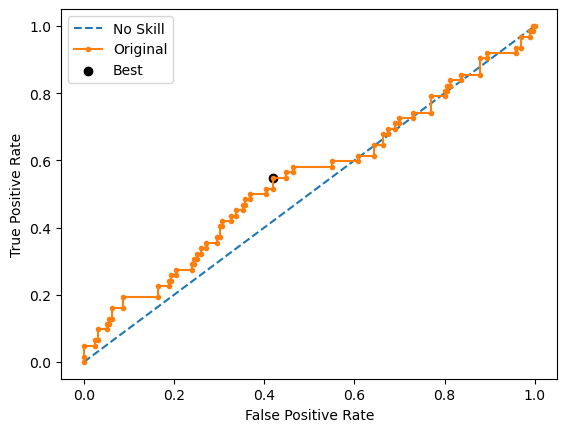

Run 3 - Random State: 2
Test G-mean: 0.4589824736585708
Best Threshold=0.499952, G-Mean=0.561


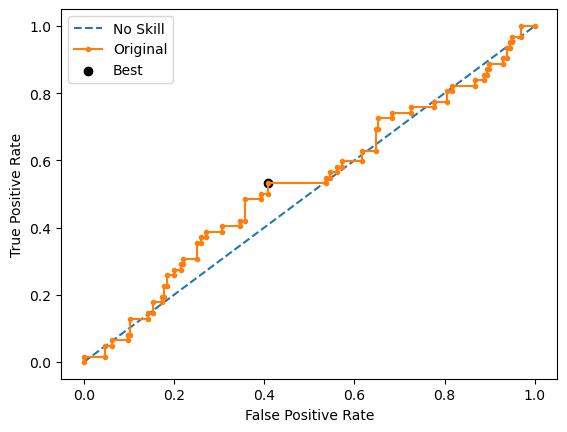

Run 4 - Random State: 3
Test G-mean: 0.3165918741006215
Best Threshold=0.499816, G-Mean=0.555


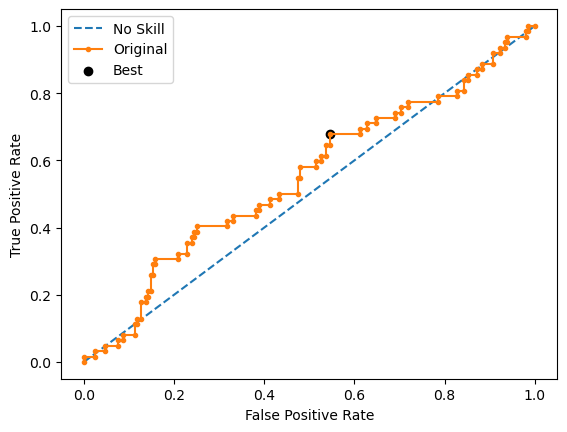

Run 5 - Random State: 4
Test G-mean: 0.4425522958501198
Best Threshold=0.499931, G-Mean=0.570


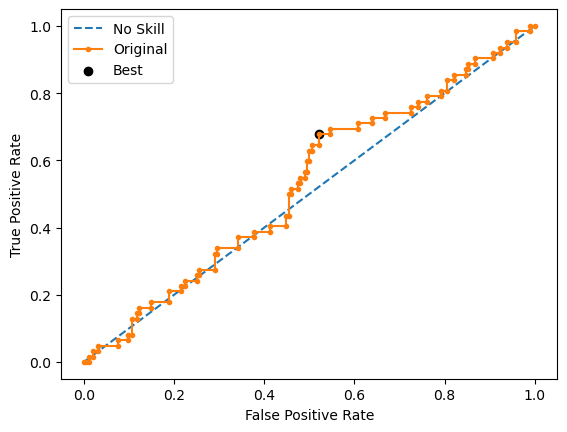

Ave Test G-mean: 0.4079741099089308
Stdev Test G-mean: 0.08313255639777291
Ave Test Specificity: 0.8153061224489797
Ave Test Recall: 0.2193548387096774
Ave Test NPV: 0.7677217288629278
Ave Test Accuracy: 0.6720930232558139
Ave Test Precision: 0.2775602762848866
Ave Test F1-Score: 0.23283550757234966
Ave Runtime: 0.029479503631591797


In [78]:
ho_t05_logreg_gs, ho_t05_logreg_be, ho_t05_logreg_model_info, ho_t05_logreg_metrics_df = logreg_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


[LibSVM]Best Hyperparameters: {'classifier__C': 1.0, 'classifier__kernel': 'poly', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.46952380952380957
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(kernel='poly', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2952894908359903
Std Train Score (G-mean) 0.07042198764001888
GridSearchCV Runtime: 110.75757265090942 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.2160069123317937
Best Threshold=0.370895, G-Mean=0.458


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


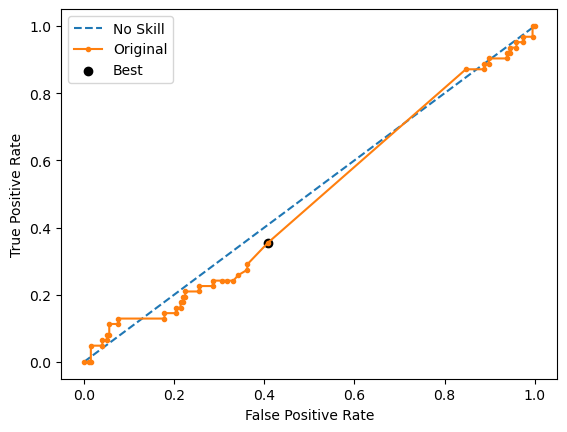

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.2781250115577218
Best Threshold=0.392599, G-Mean=0.501


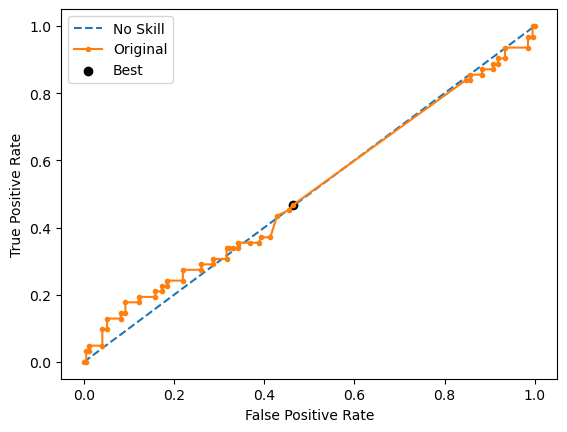

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.392341, G-Mean=0.456


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


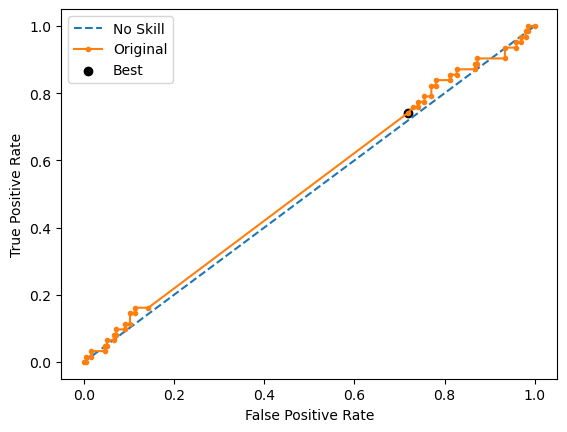

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.21486097898330503
Best Threshold=0.356169, G-Mean=0.494


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


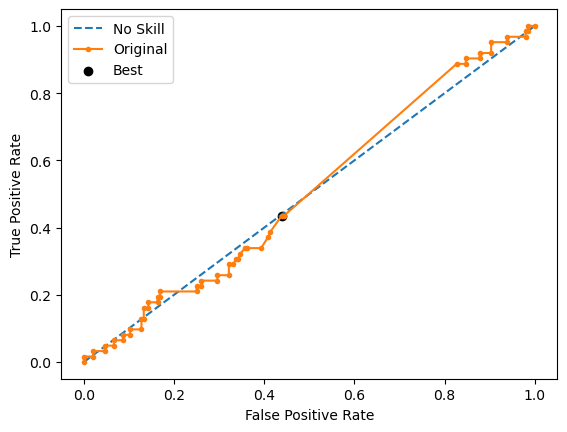

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.2160069123317937
Best Threshold=0.400493, G-Mean=0.443


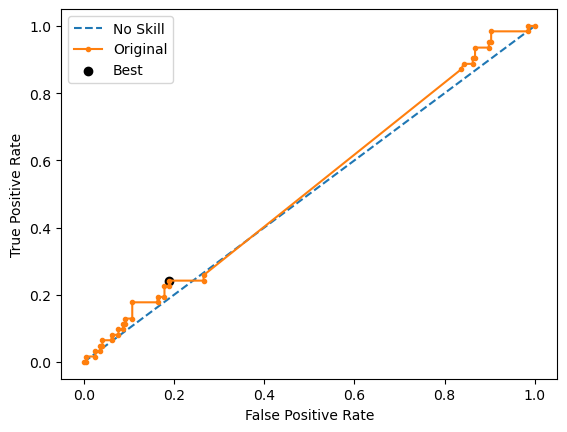

Ave Test G-mean: 0.18499996304092287
Stdev Test G-mean: 0.10690159384705572
Ave Test Specificity: 0.9683673469387756
Ave Test Recall: 0.04516129032258065
Ave Test NPV: 0.7622786022538487
Ave Test Accuracy: 0.7465116279069768
Ave Test Precision: 0.24692307692307694
Ave Test F1-Score: 0.07621621621621621
Ave Runtime: 0.07445855140686035


In [79]:
ho_t05_svm_gs, ho_t05_svm_be, ho_t05_svm_model_info, ho_t05_svm_metrics_df = svm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [80]:
ho_t05_knn_gs, ho_t05_knn_be, ho_t05_knn_model_info, ho_t05_knn_metrics_df = knn_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 6, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.4777489177489177
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=6))])
Mean Train Score (G-mean) 0.5208001196418653
Std Train Score (G-mean) 0.018486282027178967
GridSearchCV Runtime: 87.48757886886597 secs
Run 1 - Random State: 0
Test G-mean: 0.34135616145958947
Run 2 - Random State: 1
Test G-mean: 0.35794840029608
Run 3 - Random State: 2
Test G-mean: 0.2989448197688375
Run 4 - Random State: 3
Test G-mean: 0.31568081645894214
Run 5 - Random State: 4
Test G-mean: 0.2721431292861225
Ave Test G-mean: 0.31721466545391436
Stdev Test G-mean: 0.03394713651475023
Ave Test Specificity: 0.9020408163265307
Ave Te

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.4821645021645022
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints=None, learning_rate=0.1,


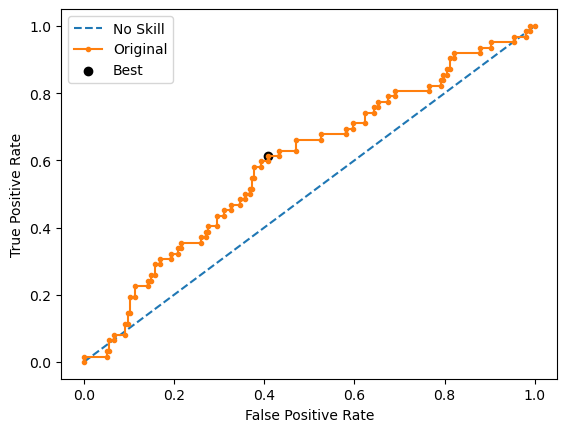

Run 2 - Random State: 1
Test G-mean: 0.41092711376134144
Best Threshold=0.201199, G-Mean=0.591


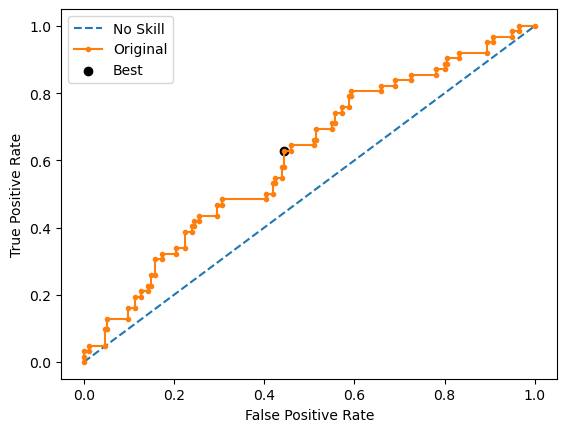

Run 3 - Random State: 2
Test G-mean: 0.3859361027998952
Best Threshold=0.222274, G-Mean=0.528


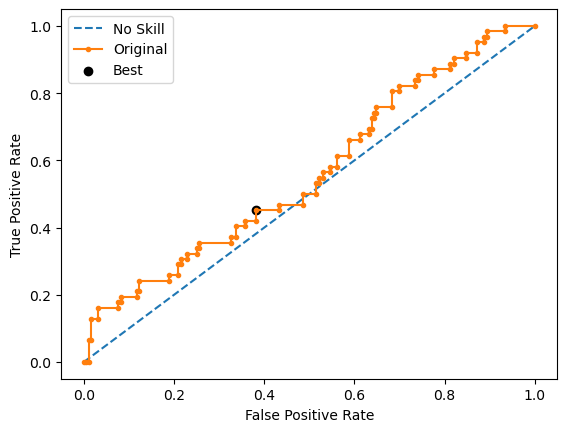

Run 4 - Random State: 3
Test G-mean: 0.38164779078101785
Best Threshold=0.252068, G-Mean=0.622


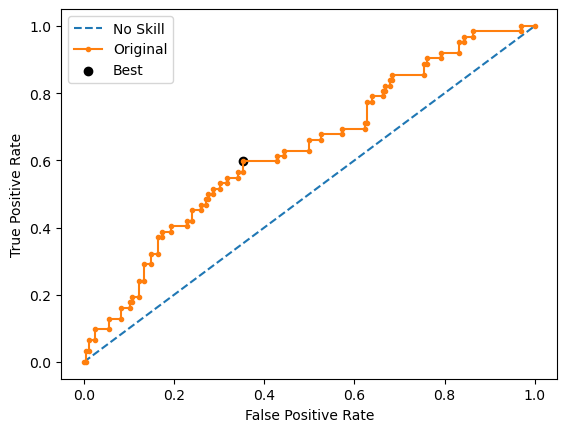

Run 5 - Random State: 4
Test G-mean: 0.31840616903455665
Best Threshold=0.218685, G-Mean=0.563


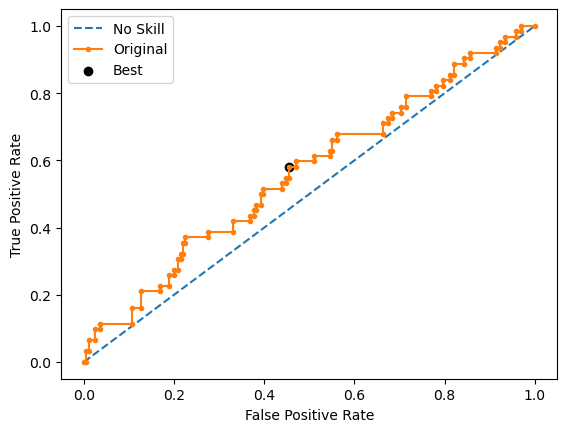

Ave Test G-mean: 0.3822866482738781
Stdev Test G-mean: 0.03857931392095154
Ave Test Specificity: 0.8969387755102041
Ave Test Recall: 0.16451612903225804
Ave Test NPV: 0.7724391861651954
Ave Test Accuracy: 0.7209302325581395
Ave Test Precision: 0.3362704692522137
Ave Test F1-Score: 0.21987857809244868
Ave Runtime: 0.1354196548461914


In [81]:
ho_t05_xgb_gs, ho_t05_xgb_be, ho_t05_xgb_model_info, ho_t05_xgb_metrics_df = xgb_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6511
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

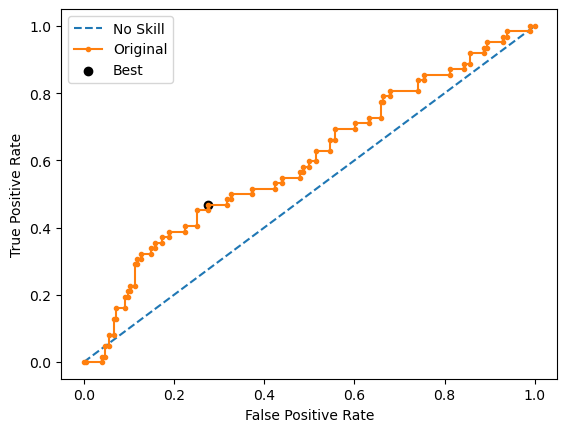

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001374 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6152
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

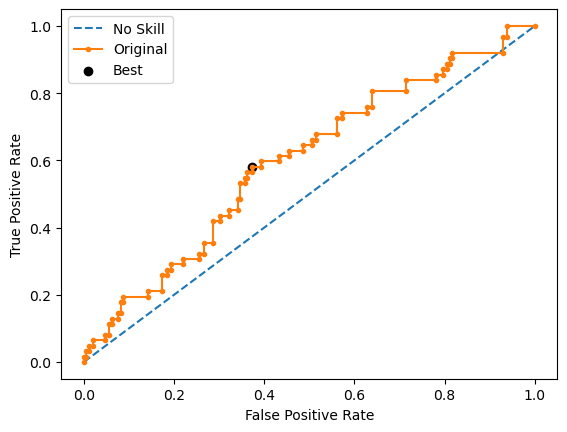

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6460
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

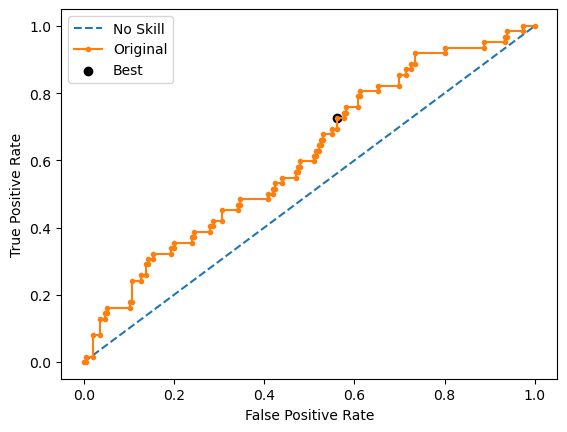

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001494 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6597
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

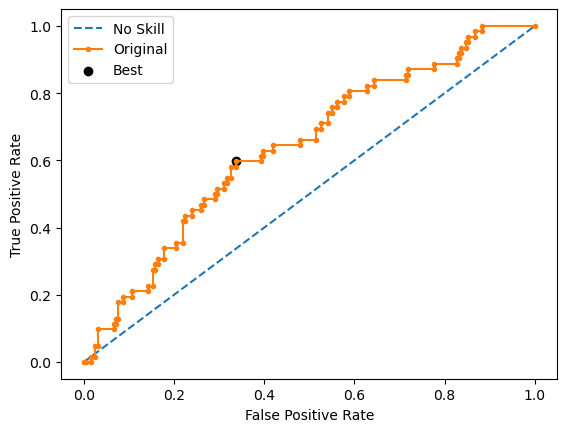

[LightGBM] [Info] Number of positive: 588, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001525 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6520
[LightGBM] [Info] Number of data points in the train set: 1176, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Run 5 - Random State: 4
Test G-mean: 0.2788637247089075
Best Threshold=0.291551, G-Mean=0.555


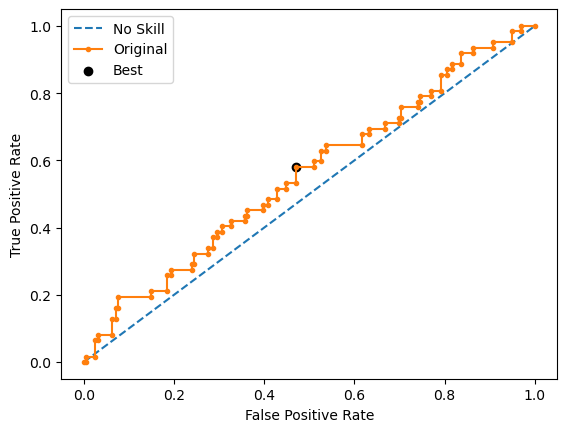

Ave Test G-mean: 0.2791333207941533
Stdev Test G-mean: 0.04818539865873307
Ave Test Specificity: 0.9540816326530612
Ave Test Recall: 0.08387096774193548
Ave Test NPV: 0.767043450550952
Ave Test Accuracy: 0.7449612403100775
Ave Test Precision: 0.3772649572649573
Ave Test F1-Score: 0.13503051134758454
Ave Runtime: 0.1512500286102295


In [82]:
ho_t05_lgbm_gs, ho_t05_lgbm_be, ho_t05_lgbm_model_info, ho_t05_lgbm_metrics_df = lgbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME.R', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.4712121212121211
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8311968950982169
Std Train Score (G-mean) 0.01085284523778204
GridSearchCV Runtime: 10.427187204360962 secs
Run 1 - Random State: 0
Test G-mean: 0.17636890537566463
Best Threshold=0.350000, G-Mean=0.556


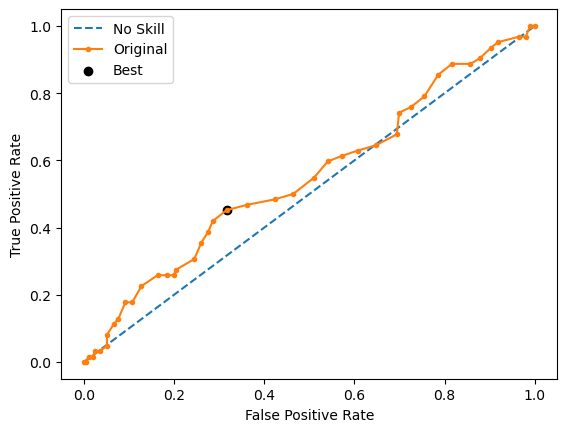

Run 2 - Random State: 1
Test G-mean: 0.329081951610197
Best Threshold=0.320000, G-Mean=0.581


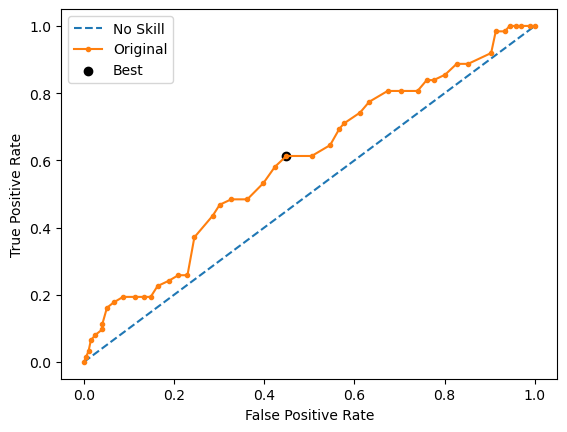

Run 3 - Random State: 2
Test G-mean: 0.21486097898330503
Best Threshold=0.350000, G-Mean=0.594


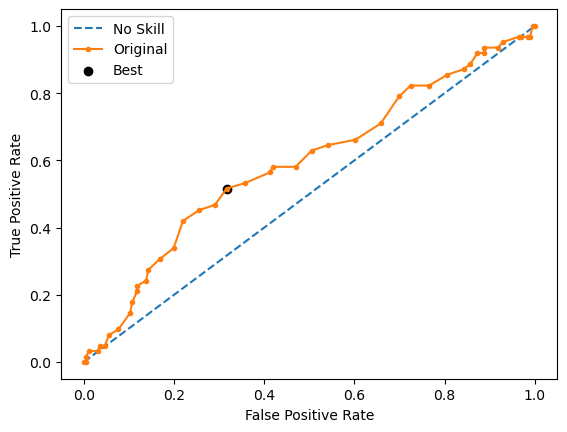

Run 4 - Random State: 3
Test G-mean: 0.1754332547146526
Best Threshold=0.300000, G-Mean=0.622


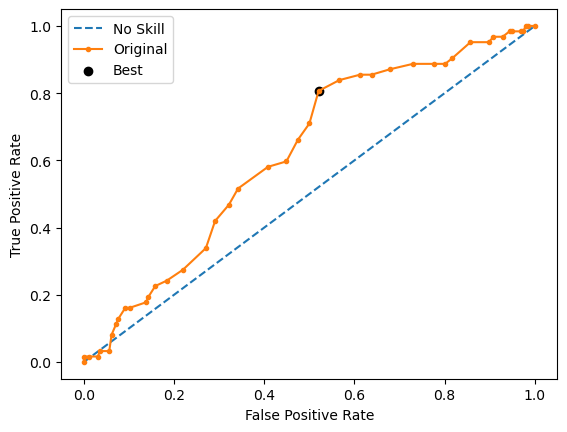

Run 5 - Random State: 4
Test G-mean: 0.25008227744175365
Best Threshold=0.290000, G-Mean=0.529


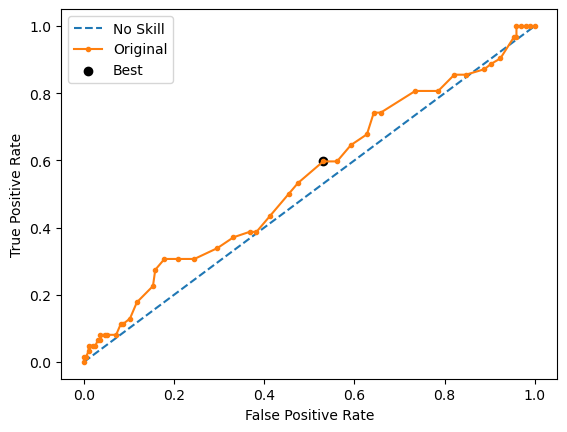

Ave Test G-mean: 0.22916547362511458
Stdev Test G-mean: 0.06383584962574991
Ave Test Specificity: 0.960204081632653
Ave Test Recall: 0.058064516129032254
Ave Test NPV: 0.7632150700291277
Ave Test Accuracy: 0.7434108527131783
Ave Test Precision: 0.30414141414141416
Ave Test F1-Score: 0.09702858454546666
Ave Runtime: 0.4837893009185791


In [83]:
ho_t05_adaboost_gs, ho_t05_adaboost_be, ho_t05_adaboost_model_info, ho_t05_adaboost_metrics_df = adaboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.44732600732600736
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.792104575621484
Std Train Score (G-mean) 0.015959584738160077
GridSearchCV Runtime: 77.70399785041809 secs
Run 1 - Random State: 0
Test G-mean: 0.3827243734296478
Best Threshold=0.274857, G-Mean=0.615


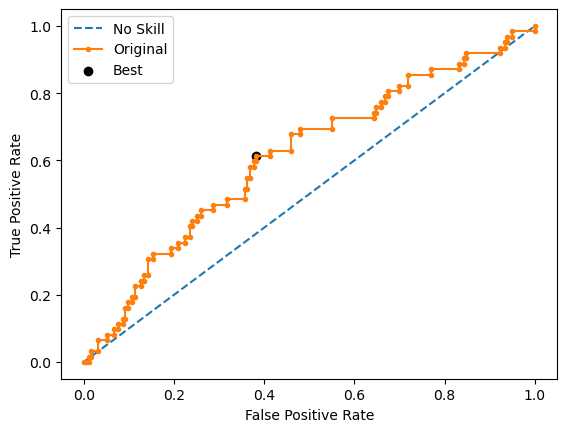

Run 2 - Random State: 1
Test G-mean: 0.42277181851827056
Best Threshold=0.222153, G-Mean=0.565


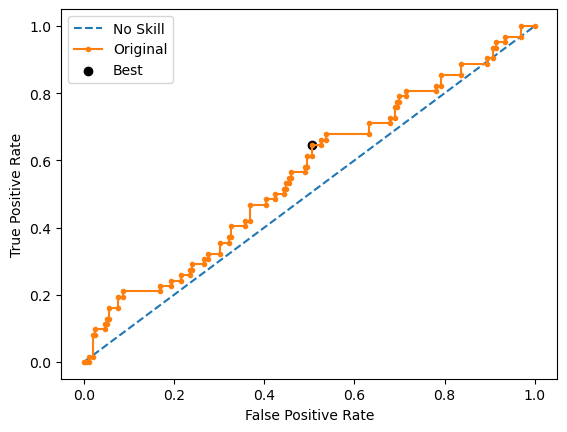

Run 3 - Random State: 2
Test G-mean: 0.37015467471401725
Best Threshold=0.268062, G-Mean=0.567


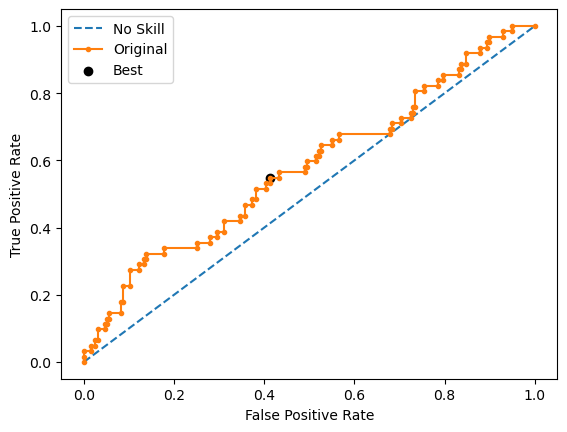

Run 4 - Random State: 3
Test G-mean: 0.4168915346690743
Best Threshold=0.379410, G-Mean=0.614


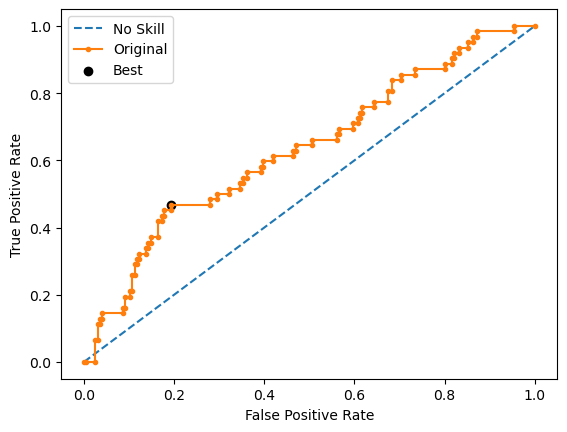

Run 5 - Random State: 4
Test G-mean: 0.34135616145958947
Best Threshold=0.233972, G-Mean=0.552


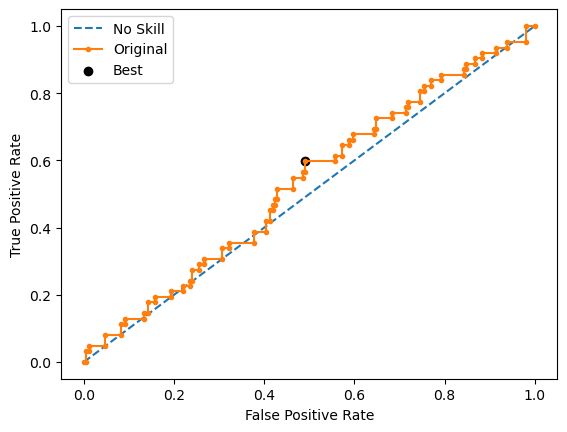

Ave Test G-mean: 0.3867797125581199
Stdev Test G-mean: 0.03375755535970445
Ave Test Specificity: 0.9153061224489797
Ave Test Recall: 0.16451612903225807
Ave Test NPV: 0.7759537159156922
Ave Test Accuracy: 0.7348837209302326
Ave Test Precision: 0.3845767195767196
Ave Test F1-Score: 0.22929835370550694
Ave Runtime: 1.5261021614074708


In [84]:
ho_t05_gbm_gs, ho_t05_gbm_be, ho_t05_gbm_model_info, ho_t05_gbm_metrics_df = gbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4217965367965368
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=3,
                                        n_estimators=200, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.4803782276383551
Std Train Score (G-mean) 0.025048077334461363
GridSearchCV Runtime: 224.9149260520935 secs
Run 1 - Random State: 0
Test G-mean: 0.17636890537566463
Best Threshold=0.387865, G-Mean=0.665


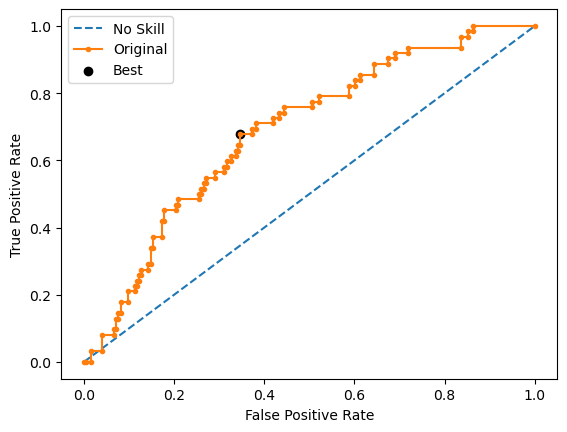

Run 2 - Random State: 1
Test G-mean: 0.24810008810871542
Best Threshold=0.397918, G-Mean=0.583


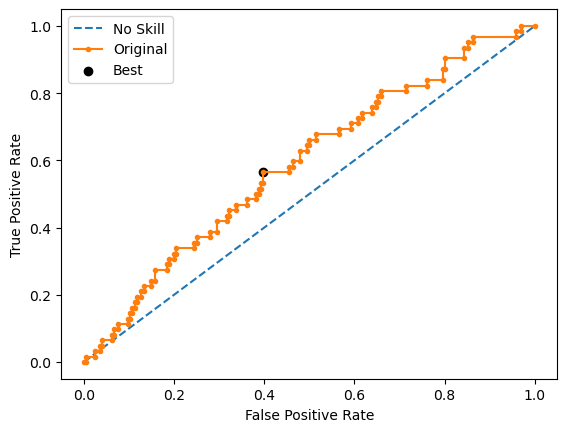

Run 3 - Random State: 2
Test G-mean: 0.2520488787147369
Best Threshold=0.398372, G-Mean=0.598


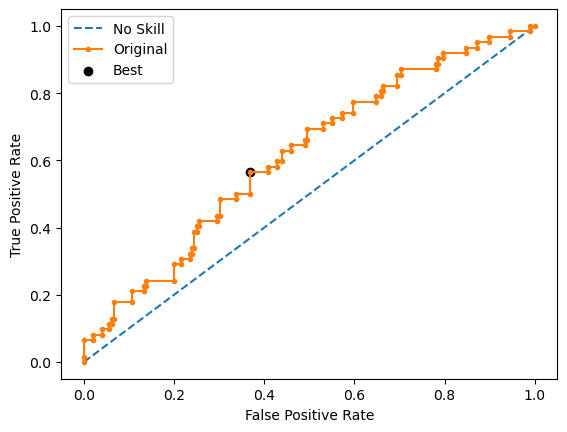

Run 4 - Random State: 3
Test G-mean: 0.0
Best Threshold=0.372181, G-Mean=0.604


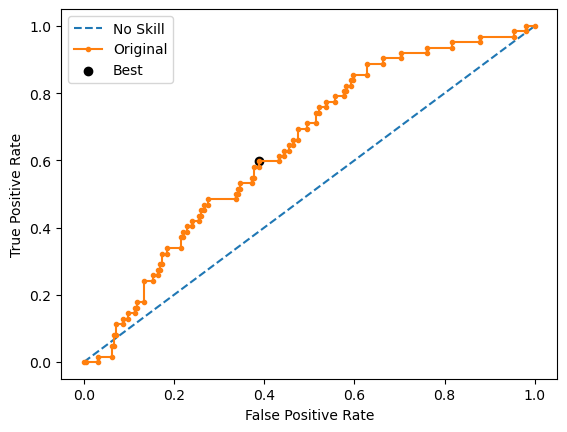

Run 5 - Random State: 4
Test G-mean: 0.24743582965269675
Best Threshold=0.402295, G-Mean=0.595


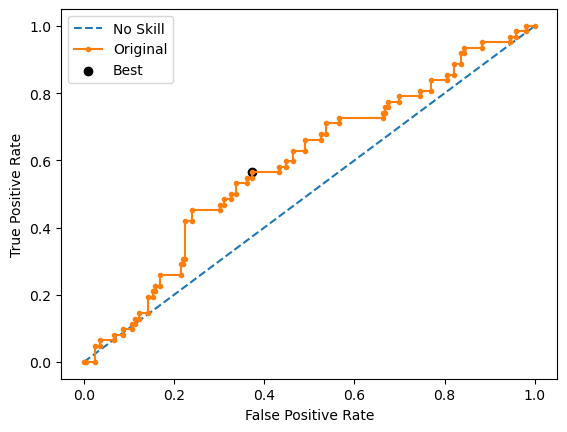

Ave Test G-mean: 0.18479074037036275
Stdev Test G-mean: 0.10802162159390008
Ave Test Specificity: 0.9683673469387756
Ave Test Recall: 0.04516129032258064
Ave Test NPV: 0.7622666670913639
Ave Test Accuracy: 0.7465116279069768
Ave Test Precision: 0.2774114774114774
Ave Test F1-Score: 0.07684197634318497
Ave Runtime: 0.2657025814056396


In [85]:
ho_t05_rf_gs, ho_t05_rf_be, ho_t05_rf_model_info, ho_t05_rf_metrics_df = rf_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.011041
0:	learn: 0.6884658	total: 4.32ms	remaining: 4.32s
1:	learn: 0.6849709	total: 7.46ms	remaining: 3.72s
2:	learn: 0.6813828	total: 10.7ms	remaining: 3.54s
3:	learn: 0.6767746	total: 14.3ms	remaining: 3.56s
4:	learn: 0.6729958	total: 18ms	remaining: 3.58s
5:	learn: 0.6694030	total: 21.4ms	remaining: 3.54s
6:	learn: 0.6655849	total: 24.8ms	remaining: 3.51s
7:	learn: 0.6612580	total: 28.8ms	remaining: 3.57s
8:	learn: 0.6573925	total: 32.6ms	remaining: 3.59s
9:	learn: 0.6523555	total: 35.7ms	remaining: 3.54s
10:	learn: 0.6479023	total: 41ms	remaining: 3.69s
11:	learn: 0.6444646	total: 44.1ms	remaining: 3.63s
12:	learn: 0.6407042	total: 47.5ms	remaining: 3.61s
13:	learn: 0.6362626	total: 50.1ms	remaining: 3.53s
14:	learn: 0.6321410	total: 53.1ms	remaining: 3.49s
15:	learn: 0.6287414	total: 56.4ms	remaining: 3.47s
16:	learn: 0.6245139	total: 60ms	remaining: 3.47s
17:	learn: 0.6216309	total: 63.5ms	remaining: 3.46s
18:	learn: 0.6176939	total: 66.3ms	remaining: 3.42

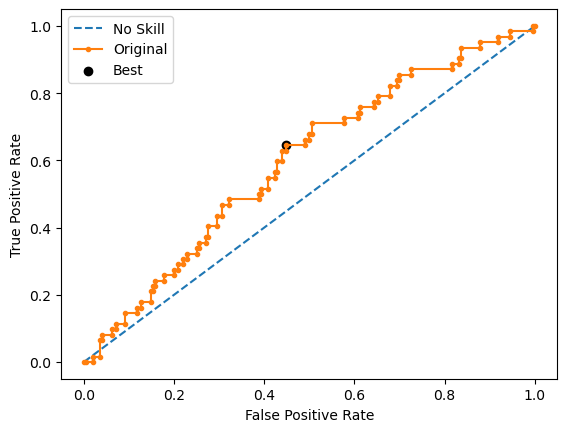

Learning rate set to 0.011041
0:	learn: 0.6875650	total: 7.24ms	remaining: 7.24s
1:	learn: 0.6836973	total: 12.1ms	remaining: 6.03s
2:	learn: 0.6795757	total: 17.5ms	remaining: 5.81s
3:	learn: 0.6756831	total: 21.1ms	remaining: 5.26s
4:	learn: 0.6718707	total: 25.5ms	remaining: 5.08s
5:	learn: 0.6680808	total: 30ms	remaining: 4.96s
6:	learn: 0.6642306	total: 34.1ms	remaining: 4.83s
7:	learn: 0.6602628	total: 39.1ms	remaining: 4.85s
8:	learn: 0.6568616	total: 44.4ms	remaining: 4.89s
9:	learn: 0.6540683	total: 48.4ms	remaining: 4.79s
10:	learn: 0.6498246	total: 51ms	remaining: 4.58s
11:	learn: 0.6471671	total: 54.8ms	remaining: 4.51s
12:	learn: 0.6444397	total: 59ms	remaining: 4.48s
13:	learn: 0.6405019	total: 63.4ms	remaining: 4.46s
14:	learn: 0.6378099	total: 66.8ms	remaining: 4.39s
15:	learn: 0.6355016	total: 69.5ms	remaining: 4.27s
16:	learn: 0.6317042	total: 73.2ms	remaining: 4.23s
17:	learn: 0.6279410	total: 76.1ms	remaining: 4.15s
18:	learn: 0.6243873	total: 80.1ms	remaining: 4.13

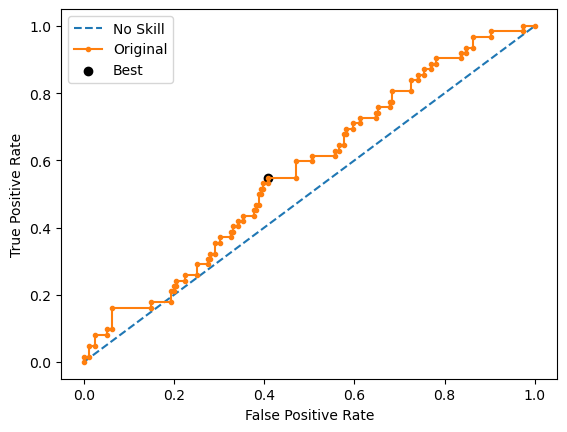

Learning rate set to 0.011041
0:	learn: 0.6884594	total: 3.36ms	remaining: 3.36s
1:	learn: 0.6843416	total: 5.94ms	remaining: 2.96s
2:	learn: 0.6808615	total: 9.52ms	remaining: 3.16s
3:	learn: 0.6766437	total: 13.4ms	remaining: 3.32s
4:	learn: 0.6725868	total: 16.6ms	remaining: 3.29s
5:	learn: 0.6682193	total: 20.3ms	remaining: 3.36s
6:	learn: 0.6642167	total: 22.6ms	remaining: 3.2s
7:	learn: 0.6601809	total: 25.2ms	remaining: 3.13s
8:	learn: 0.6571197	total: 29.3ms	remaining: 3.23s
9:	learn: 0.6532490	total: 31.7ms	remaining: 3.14s
10:	learn: 0.6481395	total: 34ms	remaining: 3.06s
11:	learn: 0.6434396	total: 36.3ms	remaining: 2.99s
12:	learn: 0.6406075	total: 38.5ms	remaining: 2.93s
13:	learn: 0.6354393	total: 40.9ms	remaining: 2.88s
14:	learn: 0.6325728	total: 43.1ms	remaining: 2.83s
15:	learn: 0.6292372	total: 45.4ms	remaining: 2.79s
16:	learn: 0.6243069	total: 47.8ms	remaining: 2.76s
17:	learn: 0.6213979	total: 50.5ms	remaining: 2.75s
18:	learn: 0.6175560	total: 53.2ms	remaining: 2

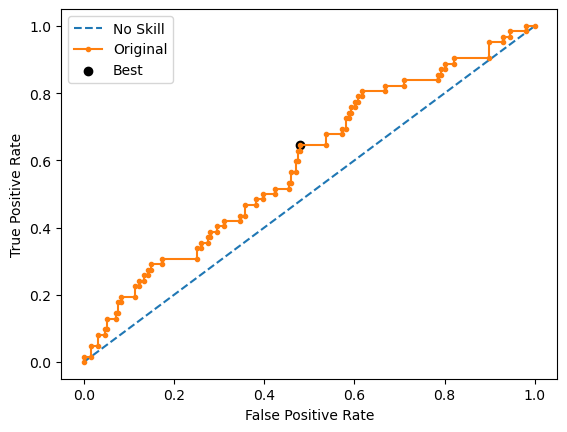

Learning rate set to 0.011041
0:	learn: 0.6879942	total: 3.56ms	remaining: 3.56s
1:	learn: 0.6837389	total: 7.92ms	remaining: 3.95s
2:	learn: 0.6798683	total: 11.2ms	remaining: 3.74s
3:	learn: 0.6756381	total: 14ms	remaining: 3.48s
4:	learn: 0.6719555	total: 16.4ms	remaining: 3.25s
5:	learn: 0.6677571	total: 18.9ms	remaining: 3.13s
6:	learn: 0.6636683	total: 21.6ms	remaining: 3.07s
7:	learn: 0.6605874	total: 24.8ms	remaining: 3.08s
8:	learn: 0.6563978	total: 28.2ms	remaining: 3.11s
9:	learn: 0.6524710	total: 32.1ms	remaining: 3.17s
10:	learn: 0.6477809	total: 34.5ms	remaining: 3.1s
11:	learn: 0.6445013	total: 37ms	remaining: 3.05s
12:	learn: 0.6406752	total: 39.4ms	remaining: 2.99s
13:	learn: 0.6369695	total: 42ms	remaining: 2.96s
14:	learn: 0.6332757	total: 44.2ms	remaining: 2.9s
15:	learn: 0.6298657	total: 47.1ms	remaining: 2.89s
16:	learn: 0.6264402	total: 49.3ms	remaining: 2.85s
17:	learn: 0.6243496	total: 51.6ms	remaining: 2.81s
18:	learn: 0.6203333	total: 53.7ms	remaining: 2.77s


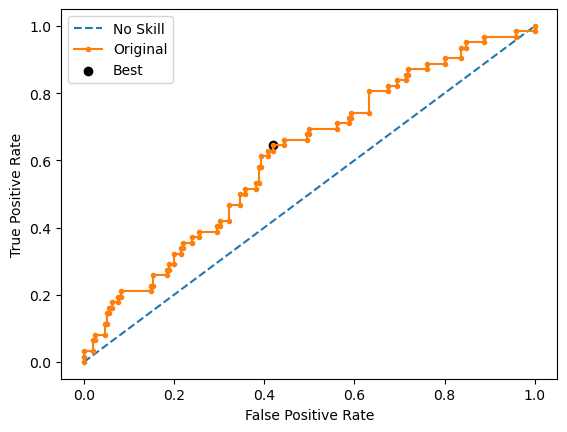

Learning rate set to 0.011041
0:	learn: 0.6879524	total: 3.07ms	remaining: 3.07s
1:	learn: 0.6826163	total: 6.04ms	remaining: 3.01s
2:	learn: 0.6792419	total: 9.36ms	remaining: 3.11s
3:	learn: 0.6741861	total: 12.8ms	remaining: 3.19s
4:	learn: 0.6701891	total: 15.9ms	remaining: 3.16s
5:	learn: 0.6655910	total: 18.3ms	remaining: 3.04s
6:	learn: 0.6603207	total: 21.1ms	remaining: 2.99s
7:	learn: 0.6550248	total: 23.6ms	remaining: 2.92s
8:	learn: 0.6509770	total: 26.8ms	remaining: 2.95s
9:	learn: 0.6472173	total: 29.6ms	remaining: 2.93s
10:	learn: 0.6425342	total: 32.3ms	remaining: 2.91s
11:	learn: 0.6389293	total: 35.3ms	remaining: 2.91s
12:	learn: 0.6342943	total: 38.8ms	remaining: 2.95s
13:	learn: 0.6318845	total: 42ms	remaining: 2.96s
14:	learn: 0.6299079	total: 45.5ms	remaining: 2.99s
15:	learn: 0.6262736	total: 48.8ms	remaining: 3s
16:	learn: 0.6211856	total: 52.9ms	remaining: 3.06s
17:	learn: 0.6181275	total: 55.6ms	remaining: 3.03s
18:	learn: 0.6145346	total: 57.7ms	remaining: 2.9

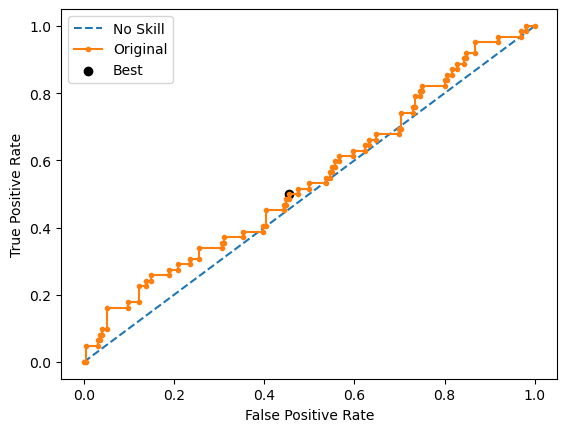

Ave Test G-mean: 0.3241807747622104
Stdev Test G-mean: 0.04019647672794242
Ave Test Specificity: 0.9448979591836736
Ave Test Recall: 0.1129032258064516
Ave Test NPV: 0.771065052841134
Ave Test Accuracy: 0.7449612403100775
Ave Test Precision: 0.39583333333333337
Ave Test F1-Score: 0.17394026135970658
Ave Runtime: 3.014123487472534


In [86]:
ho_t05_catboost_gs, ho_t05_catboost_be, ho_t05_catboost_model_info, ho_t05_catboost_metrics_df = catboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [87]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t05_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t05_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t05_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
2,Logistic Regression,0.407974,0.083133,0.366889,NaN,0.815306,0.219355,0.277560,0.232836,0.672093
5,Gradient Boosting Machine (GBM),0.386780,0.033758,0.447326,0.792105,0.915306,0.164516,0.384577,0.229298,0.734884
7,Extreme Gradient Boosting (XGBoost),0.382287,0.038579,0.482165,0.762728,0.896939,0.164516,0.336270,0.219879,0.720930
9,CatBoost,0.324181,0.040196,0.460819,0.841802,0.944898,0.112903,0.395833,0.173940,0.744961
0,k-Nearest Neighbors,0.317215,0.033947,0.477749,0.520800,0.902041,0.112903,0.266938,0.157700,0.712403
6,LightGBM,0.279133,0.048185,0.535476,0.655685,0.954082,0.083871,0.377265,0.135031,0.744961
8,AdaBoost,0.229165,0.063836,0.471212,0.831197,0.960204,0.058065,0.304141,0.097029,0.743411
1,SVM Classifier,0.185000,0.106902,0.469524,0.295289,0.968367,0.045161,0.246923,0.076216,0.746512
4,Random Forest,0.184791,0.108022,0.421797,0.480378,0.968367,0.045161,0.277411,0.076842,0.746512
3,Decision Tree,0.102945,0.099175,0.550000,NaN,0.971429,0.019355,0.114103,0.032765,0.742636


In [88]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t05_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.746512,SVM Classifier
Highest Test G-mean,0.407974,Logistic Regression
Highest Test Recall,0.219355,Logistic Regression
Highest Test Precision,0.395833,CatBoost
Highest Test Specificity,0.971429,Decision Tree
Highest Test F1-score,0.232836,Logistic Regression


# HO-T06 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2046 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': TomekLinks()}
Best Validation Score (G-mean): 0.4625541125541126
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()), ('resampling', TomekLinks()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=3, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 106.97581577301025 secs
Run 1 - Random State: 0
Test G-mean: 0.39572684603001235
Best Threshold=0.253394, G-Mean=0.645


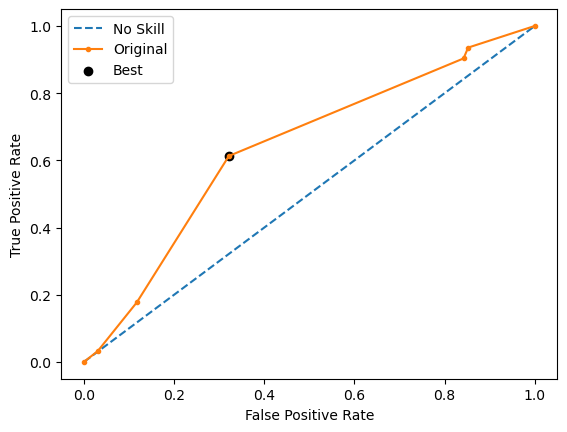

Run 2 - Random State: 1
Test G-mean: 0.17776314766807289
Best Threshold=0.247126, G-Mean=0.626


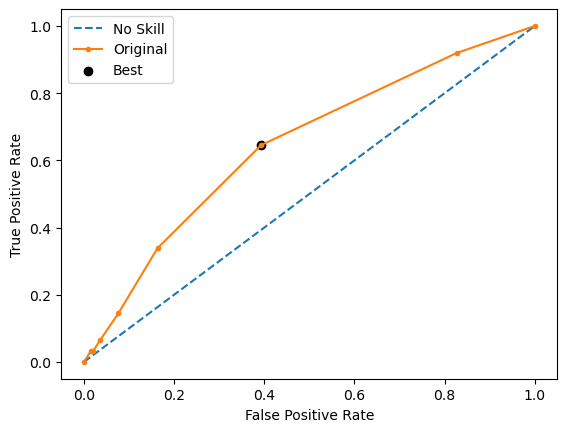

Run 3 - Random State: 2
Test G-mean: 0.21370890108793617
Best Threshold=0.262376, G-Mean=0.639


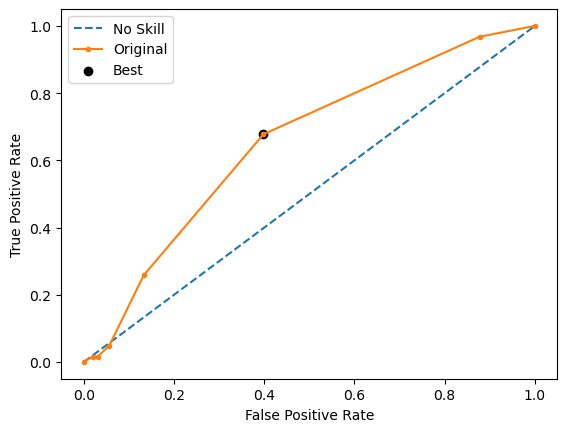

Run 4 - Random State: 3
Test G-mean: 0.2744016172169373
Best Threshold=0.310219, G-Mean=0.595


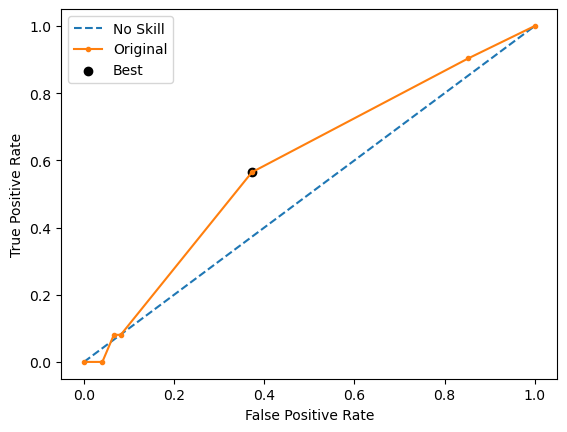

Run 5 - Random State: 4
Test G-mean: 0.21657760530082668
Best Threshold=0.254144, G-Mean=0.558


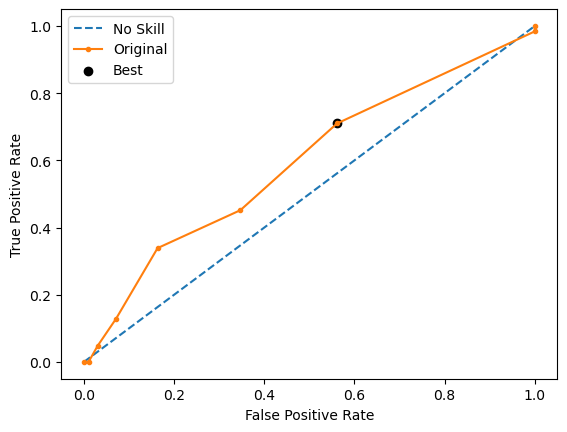

Ave Test G-mean: 0.2556356234607571
Stdev Test G-mean: 0.08562303206526392
Ave Test Specificity: 0.9418367346938776
Ave Test Recall: 0.07741935483870968
Ave Test NPV: 0.7635950241246016
Ave Test Accuracy: 0.7341085271317829
Ave Test Precision: 0.29645191409897287
Ave Test F1-Score: 0.11528892135060102
Ave Runtime: 0.035015439987182616


In [89]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.3358333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 46.3796751499176 secs
Run 1 - Random State: 0
Test G-mean: 0.21543470758536035
Best Threshold=0.384707, G-Mean=0.569


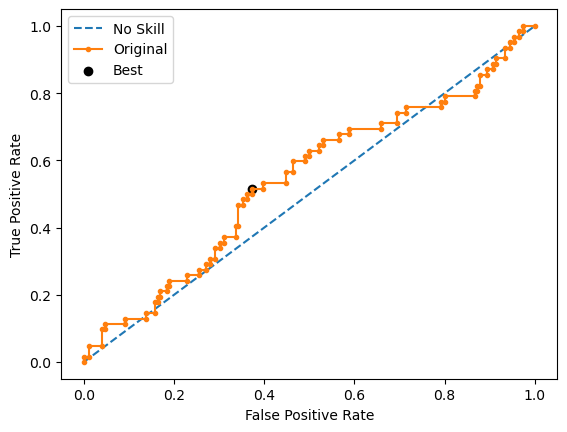

Run 2 - Random State: 1
Test G-mean: 0.41451606499257926
Best Threshold=0.387148, G-Mean=0.561


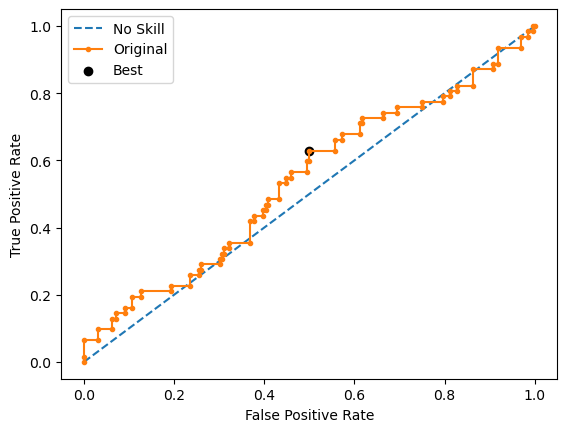

Run 3 - Random State: 2
Test G-mean: 0.21196904390980506
Best Threshold=0.365893, G-Mean=0.545


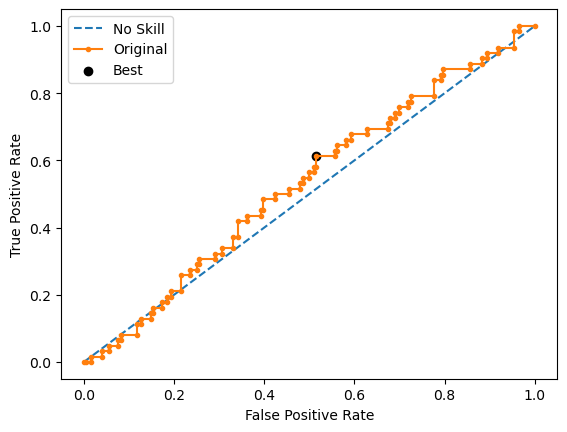

Run 4 - Random State: 3
Test G-mean: 0.31750031750047625
Best Threshold=0.352382, G-Mean=0.527


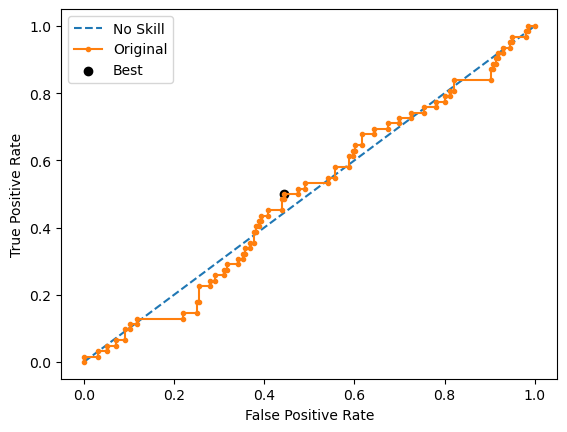

Run 5 - Random State: 4
Test G-mean: 0.29478683118376914
Best Threshold=0.375843, G-Mean=0.529


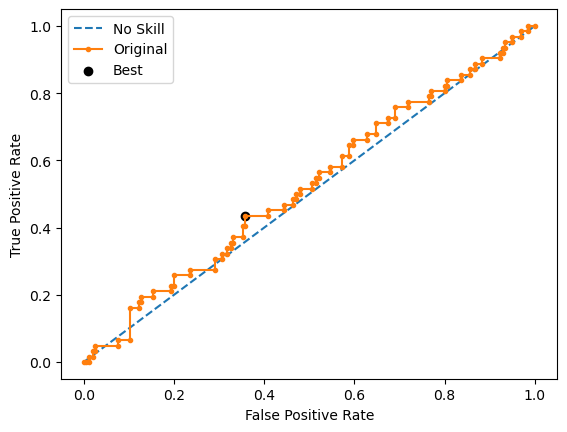

Ave Test G-mean: 0.290841393034398
Stdev Test G-mean: 0.08355941731289794
Ave Test Specificity: 0.9132653061224489
Ave Test Recall: 0.1
Ave Test NPV: 0.7625192588777692
Ave Test Accuracy: 0.717829457364341
Ave Test Precision: 0.2565816536404772
Ave Test F1-Score: 0.14001206796594345
Ave Runtime: 0.04801630973815918


In [90]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, 'precision',
                       'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'linear', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.41428571428571426
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(C=1e-06, kernel='linear', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.29320477823974417
Std Train Score (G-mean) 0.06906683072816527
GridSearchCV Runtime: 97.98576736450195 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.17822547132965613
Best Threshold=0.387310, G-Mean=0.529


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


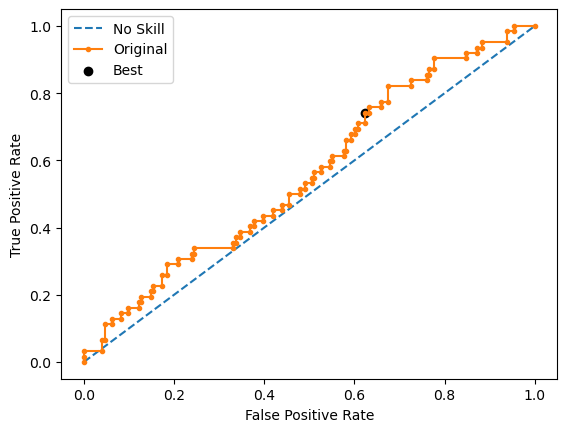

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.3508665094293052
Best Threshold=0.383597, G-Mean=0.564


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


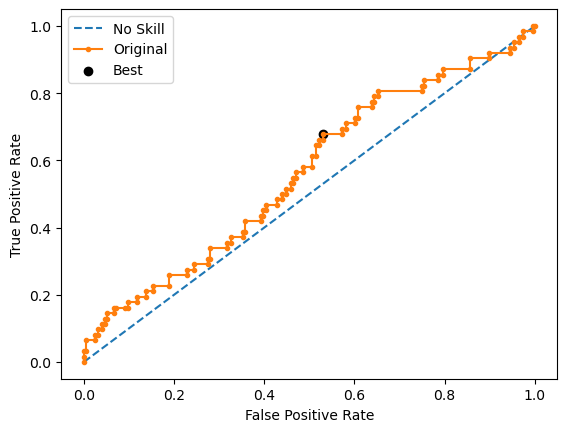

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.1759017021566112
Best Threshold=0.371168, G-Mean=0.503


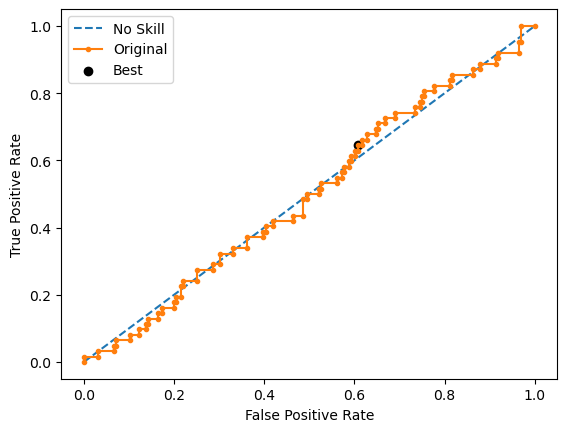

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.24610193406117403
Best Threshold=0.347850, G-Mean=0.573


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


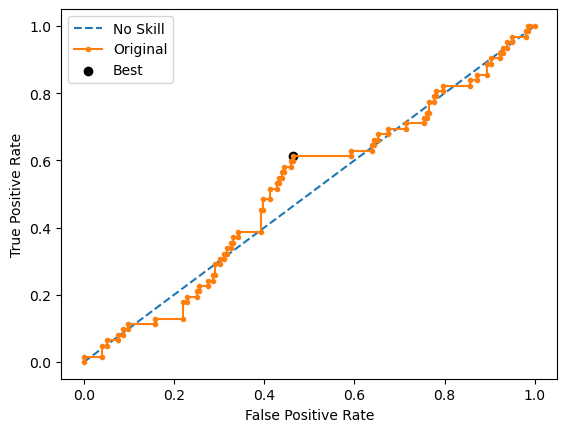

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.24942329796316198
Best Threshold=0.378738, G-Mean=0.522


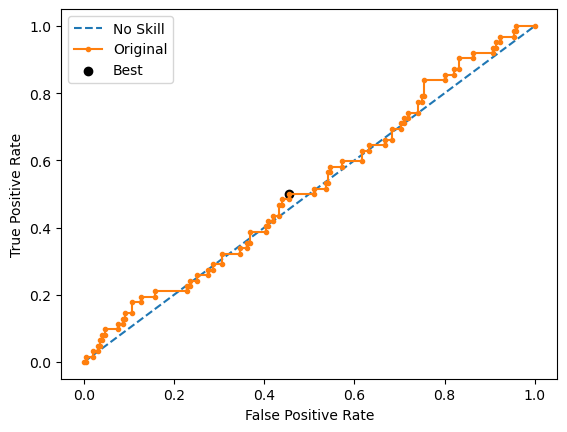

Ave Test G-mean: 0.24010378298798168
Stdev Test G-mean: 0.0713127712635465
Ave Test Specificity: 0.960204081632653
Ave Test Recall: 0.06451612903225806
Ave Test NPV: 0.764471348127425
Ave Test Accuracy: 0.7449612403100775
Ave Test Precision: 0.3368449197860962
Ave Test F1-Score: 0.10598836746449643
Ave Runtime: 0.06882562637329101


In [91]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [92]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 4, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.451031746031746
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=4))])
Mean Train Score (G-mean) 0.5131824307600684
Std Train Score (G-mean) 0.01886846465692443
GridSearchCV Runtime: 80.42578315734863 secs
Run 1 - Random State: 0
Test G-mean: 0.2728980353945144
Run 2 - Random State: 1
Test G-mean: 0.3827243734296478
Run 3 - Random State: 2
Test G-mean: 0.29976949670050446
Run 4 - Random State: 3
Test G-mean: 0.37292325984758873
Run 5 - Random State: 4
Test G-mean: 0.2713861232876521
Ave Test G-mean: 0.31994025773198154
Stdev Test G-mean: 0.05414420087090363
Ave Test Specificity: 0.9071428571428573
Ave Test Recall: 0.11612903225806452
Ave Test NPV: 0.7644607172272003

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.49069264069264074
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
           

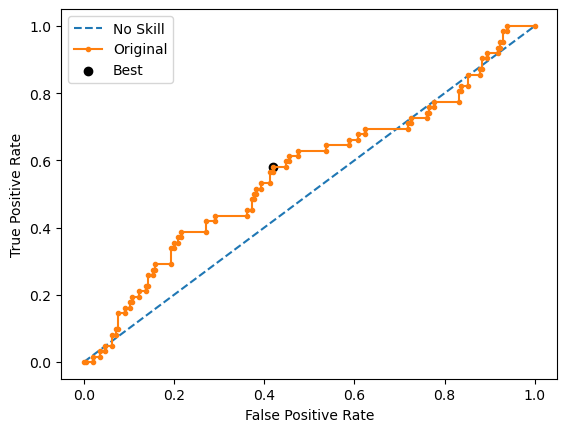

Run 2 - Random State: 1
Test G-mean: 0.3859361027998952
Best Threshold=0.385453, G-Mean=0.607


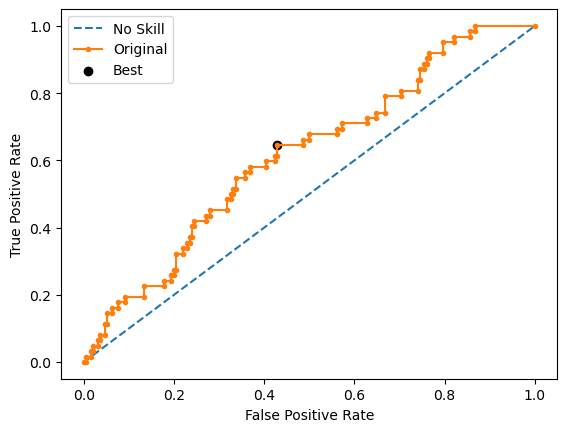

Run 3 - Random State: 2
Test G-mean: 0.3461439992297498
Best Threshold=0.347709, G-Mean=0.571


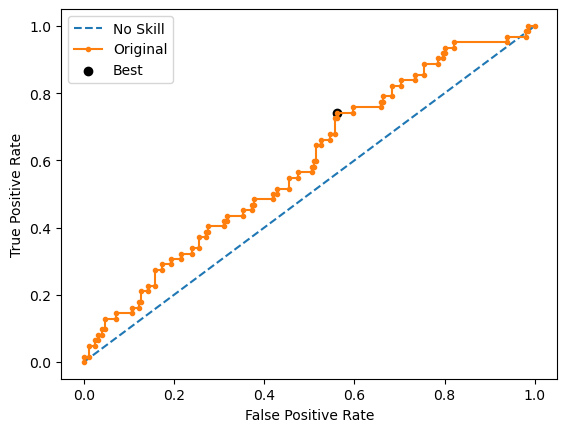

Run 4 - Random State: 3
Test G-mean: 0.45916172868343197
Best Threshold=0.407701, G-Mean=0.601


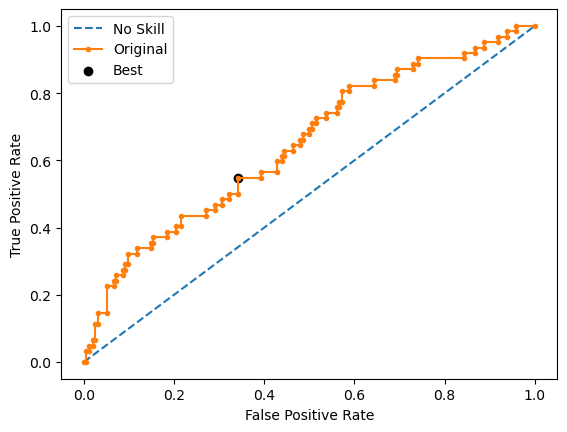

Run 5 - Random State: 4
Test G-mean: 0.3922806830559986
Best Threshold=0.417785, G-Mean=0.542


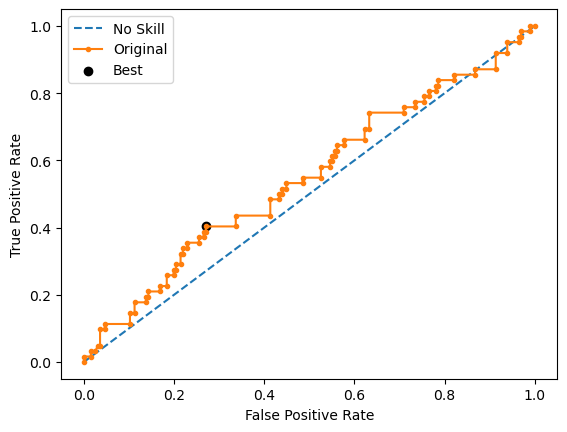

Ave Test G-mean: 0.38972816715700914
Stdev Test G-mean: 0.042857726046548736
Ave Test Specificity: 0.9142857142857143
Ave Test Recall: 0.16774193548387095
Ave Test NPV: 0.7763962450584987
Ave Test Accuracy: 0.7348837209302326
Ave Test Precision: 0.3878904358904359
Ave Test F1-Score: 0.23281735269336976
Ave Runtime: 0.13813772201538085


In [93]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 582, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001635 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6140
[LightGBM] [Info] Number of data points in the train set: 1170, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.497436 -> initscore=-0.010257
[LightGBM] [Info] Start training from score -0.010257
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Best Hyperparameters: {'classifier__boosting_type': 'dart'

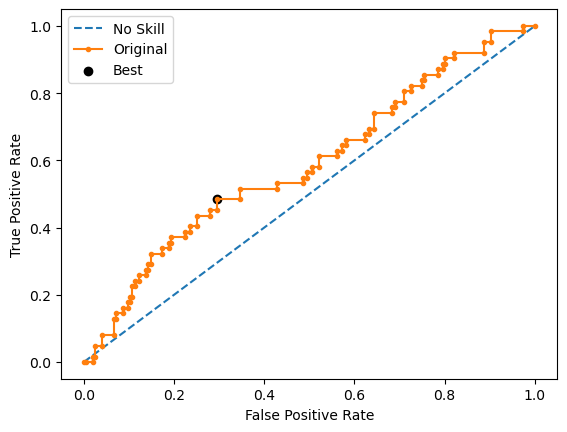

[LightGBM] [Info] Number of positive: 585, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6019
[LightGBM] [Info] Number of data points in the train set: 1173, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.498721 -> initscore=-0.005115
[LightGBM] [Info] Start training from score -0.005115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Run 2 - Random State: 1
Test G-mean: 0.2781250115577218
Best Threshold=0.360711, G-Mean=0.616


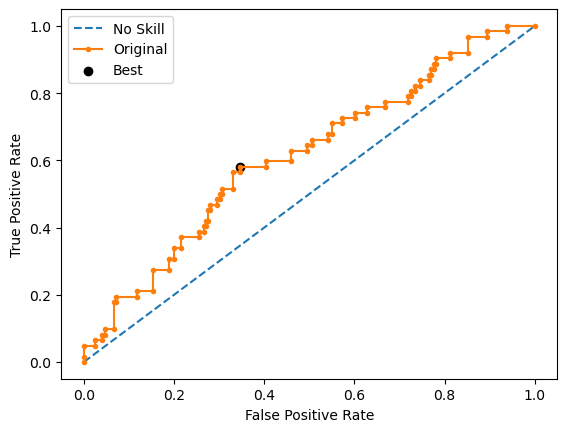

[LightGBM] [Info] Number of positive: 587, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001257 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5955
[LightGBM] [Info] Number of data points in the train set: 1175, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499574 -> initscore=-0.001702
[LightGBM] [Info] Start training from score -0.001702
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

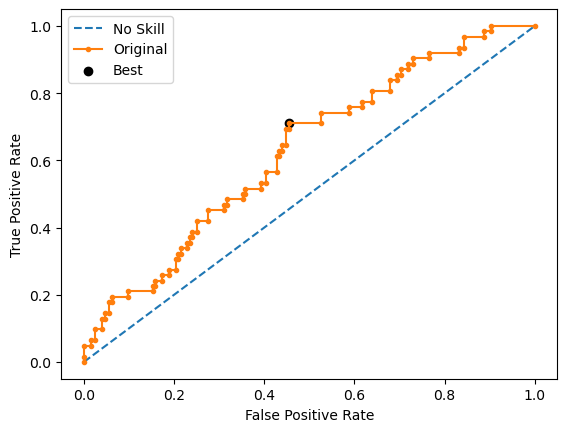

[LightGBM] [Info] Number of positive: 579, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001260 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5992
[LightGBM] [Info] Number of data points in the train set: 1167, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.496144 -> initscore=-0.015424
[LightGBM] [Info] Start training from score -0.015424
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

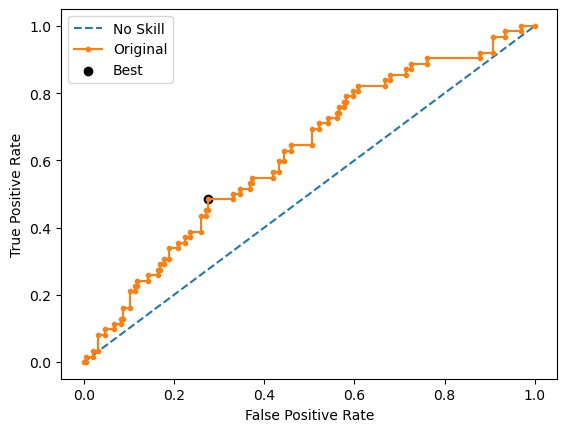

[LightGBM] [Info] Number of positive: 581, number of negative: 588
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000872 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5845
[LightGBM] [Info] Number of data points in the train set: 1169, number of used features: 45
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.497006 -> initscore=-0.011976
[LightGBM] [Info] Start training from score -0.011976
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Run 5 - Random State: 4
Test G-mean: 0.3030457633656632
Best Threshold=0.330195, G-Mean=0.537


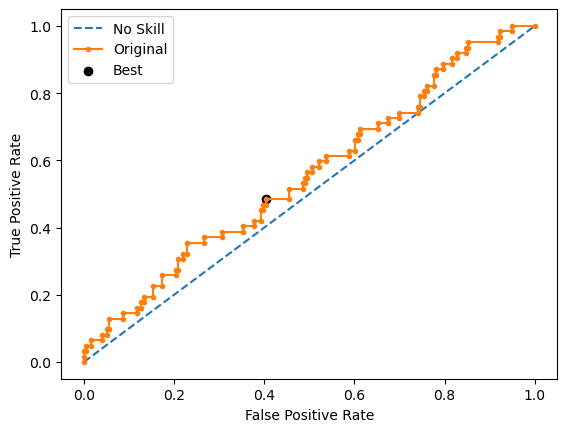

Ave Test G-mean: 0.28934879679175846
Stdev Test G-mean: 0.04713813423181483
Ave Test Specificity: 0.9510204081632653
Ave Test Recall: 0.0903225806451613
Ave Test NPV: 0.7677273642432496
Ave Test Accuracy: 0.7441860465116279
Ave Test Precision: 0.3759230769230769
Ave Test F1-Score: 0.14331660573039884
Ave Runtime: 0.09786734580993653


In [94]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4913095238095237
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8327263578179511
Std Train Score (G-mean) 0.009532453604004277
GridSearchCV Runtime: 10.470661640167236 secs
Run 1 - Random State: 0
Test G-mean: 0.2803353113105987
Best Threshold=0.880797, G-Mean=0.280


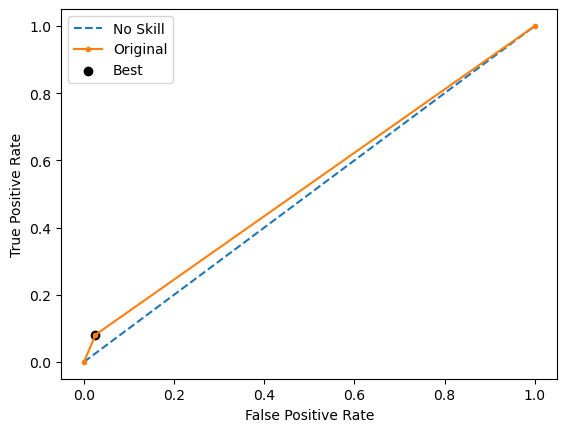

Run 2 - Random State: 1
Test G-mean: 0.3046706852730985
Best Threshold=0.880797, G-Mean=0.305


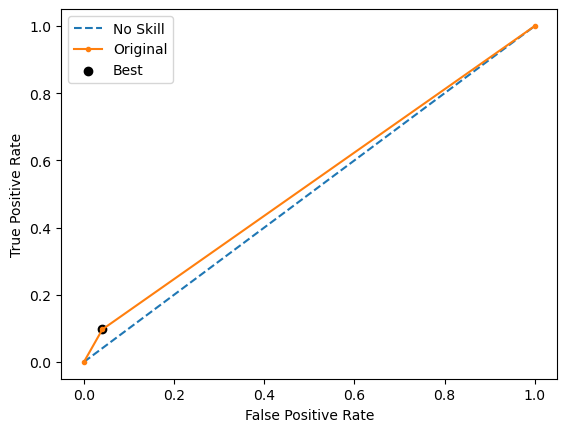

Run 3 - Random State: 2
Test G-mean: 0.24810008810871542
Best Threshold=0.880797, G-Mean=0.248


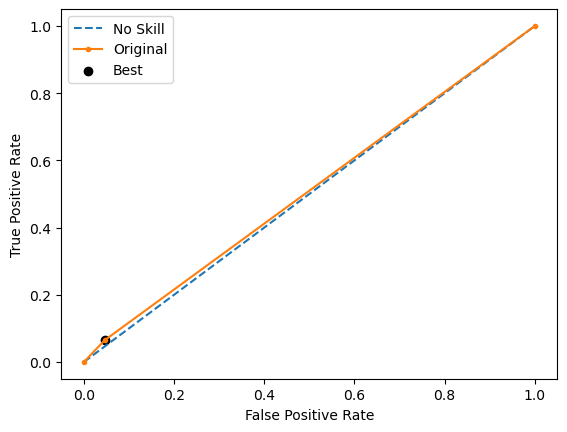

Run 4 - Random State: 3
Test G-mean: 0.21543470758536035
Best Threshold=0.880797, G-Mean=0.215


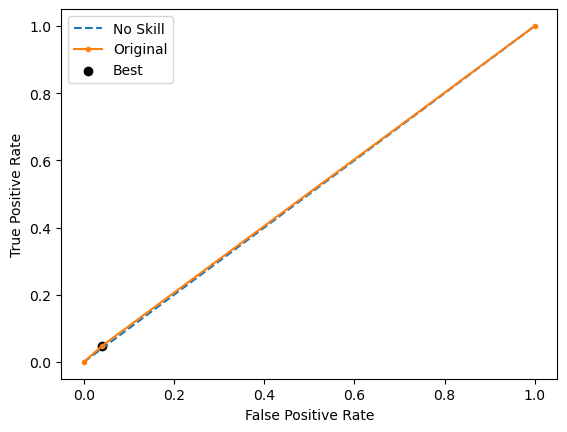

Run 5 - Random State: 4
Test G-mean: 0.3508665094293052
Best Threshold=0.880797, G-Mean=0.351


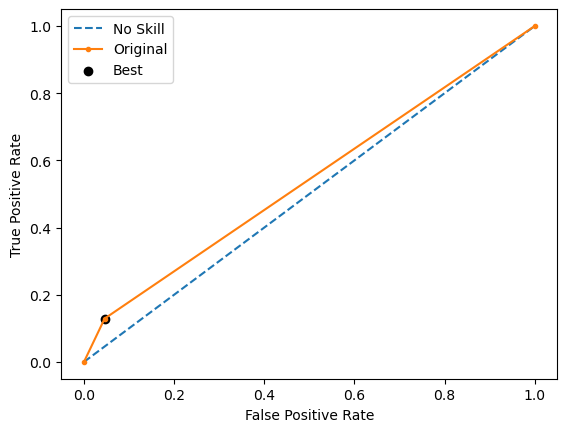

Ave Test G-mean: 0.2798814603414156
Stdev Test G-mean: 0.05200247207878548
Ave Test Specificity: 0.960204081632653
Ave Test Recall: 0.08387096774193549
Ave Test NPV: 0.7681971225842182
Ave Test Accuracy: 0.7496124031007751
Ave Test Precision: 0.3959158488570253
Ave Test F1-Score: 0.13763474375783977
Ave Runtime: 0.4768063068389893


In [95]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.41500000000000004
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.4928667492751597
Std Train Score (G-mean) 0.030087161379141684
GridSearchCV Runtime: 206.73481559753418 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=0.402152, G-Mean=0.686


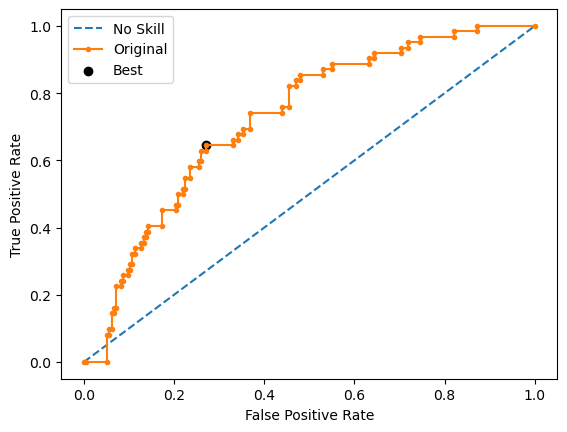

Run 2 - Random State: 1
Test G-mean: 0.1754332547146526
Best Threshold=0.427635, G-Mean=0.562


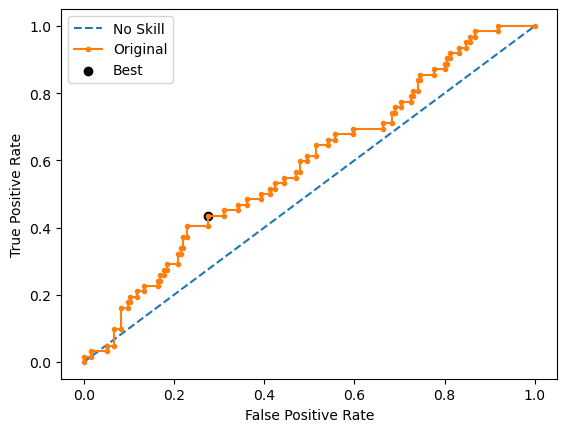

Run 3 - Random State: 2
Test G-mean: 0.21940880527332549
Best Threshold=0.403533, G-Mean=0.590


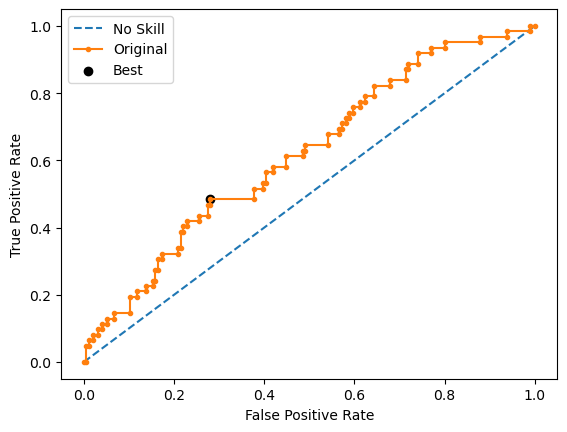

Run 4 - Random State: 3
Test G-mean: 0.0
Best Threshold=0.355793, G-Mean=0.603


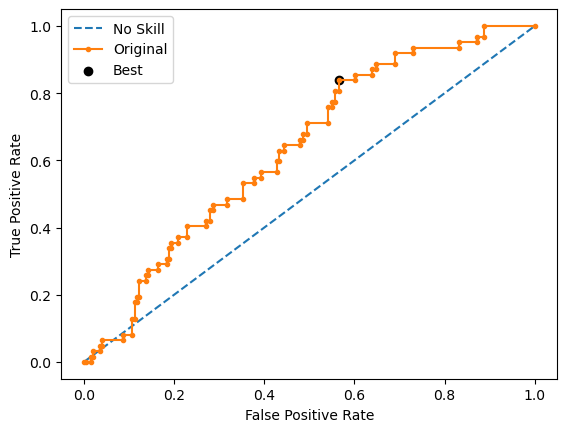

Run 5 - Random State: 4
Test G-mean: 0.24942329796316198
Best Threshold=0.409728, G-Mean=0.610


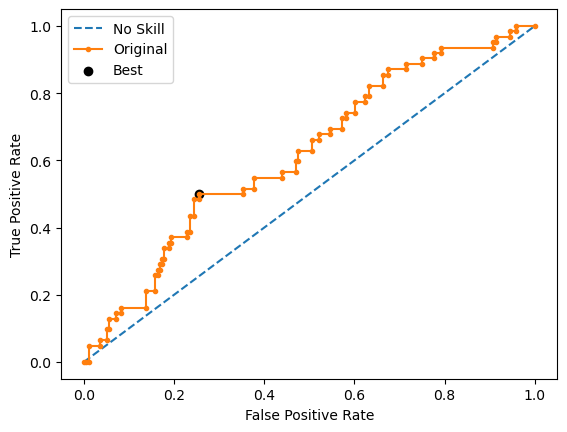

Ave Test G-mean: 0.12885307159022802
Stdev Test G-mean: 0.120533669535614
Ave Test Specificity: 0.9734693877551021
Ave Test Recall: 0.029032258064516127
Ave Test NPV: 0.7601629481954193
Ave Test Accuracy: 0.7465116279069768
Ave Test Precision: 0.2590909090909091
Ave Test F1-Score: 0.0510585305105853
Ave Runtime: 0.3245288372039795


In [96]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3971328671328671
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.7886942707012883
Std Train Score (G-mean) 0.016952515901053296
GridSearchCV Runtime: 70.88527154922485 secs
Run 1 - Random State: 0
Test G-mean: 0.3630842208295547
Best Threshold=0.362951, G-Mean=0.594


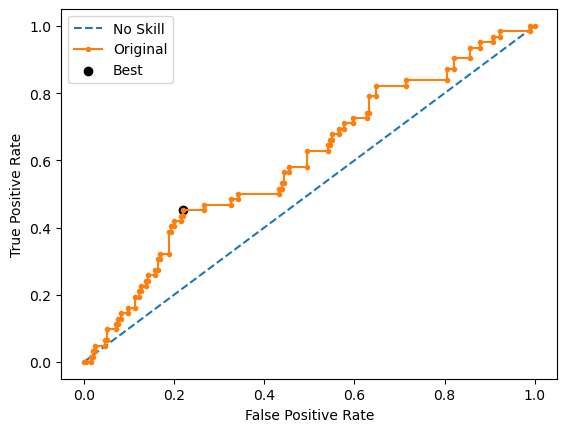

Run 2 - Random State: 1
Test G-mean: 0.3589814425603351
Best Threshold=0.213455, G-Mean=0.590


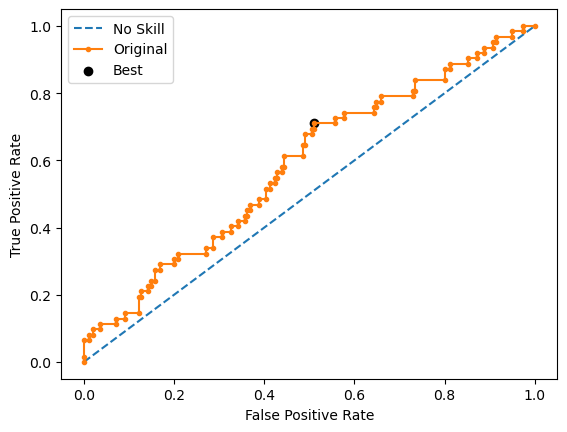

Run 3 - Random State: 2
Test G-mean: 0.3282055666944371
Best Threshold=0.248390, G-Mean=0.568


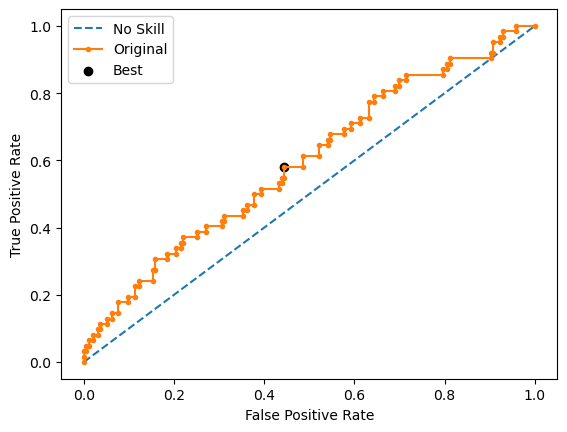

Run 4 - Random State: 3
Test G-mean: 0.314767121875562
Best Threshold=0.224153, G-Mean=0.593


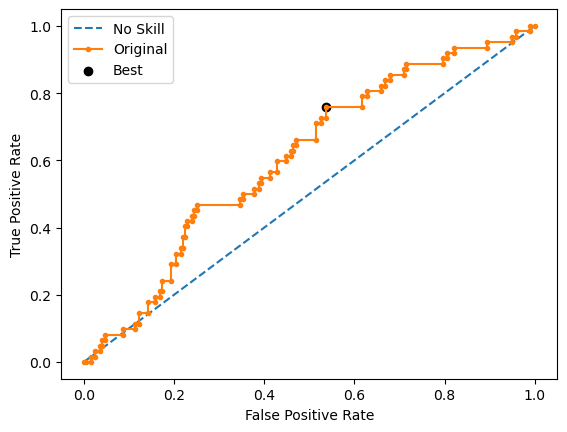

Run 5 - Random State: 4
Test G-mean: 0.3442368552439281
Best Threshold=0.240890, G-Mean=0.546


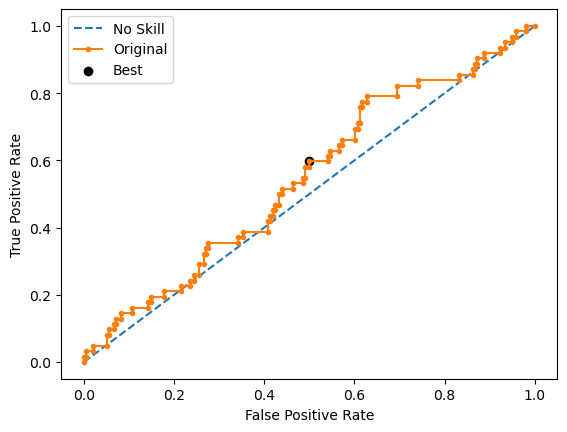

Ave Test G-mean: 0.3418550414407634
Stdev Test G-mean: 0.020431154256700196
Ave Test Specificity: 0.9091836734693878
Ave Test Recall: 0.12903225806451613
Ave Test NPV: 0.7673499774821362
Ave Test Accuracy: 0.7217054263565891
Ave Test Precision: 0.3240591397849462
Ave Test F1-Score: 0.18237338072633974
Ave Runtime: 1.225952959060669


In [97]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.011041
0:	learn: 0.6893247	total: 2.98ms	remaining: 2.98s
1:	learn: 0.6856733	total: 5.54ms	remaining: 2.76s
2:	learn: 0.6815668	total: 8.11ms	remaining: 2.69s
3:	learn: 0.6778573	total: 11.6ms	remaining: 2.89s
4:	learn: 0.6751033	total: 14.2ms	remaining: 2.83s
5:	learn: 0.6719645	total: 17ms	remaining: 2.81s
6:	learn: 0.6686257	total: 19.8ms	remaining: 2.81s
7:	learn: 0.6651245	total: 22.9ms	remaining: 2.83s
8:	learn: 0.6618904	total: 25.7ms	remaining: 2.83s
9:	learn: 0.6587400	total: 28.3ms	remaining: 2.8s
10:	learn: 0.6548022	total: 31.1ms	remaining: 2.8s
11:	learn: 0.6516023	total: 33.8ms	remaining: 2.78s
12:	learn: 0.6482226	total: 36.6ms	remaining: 2.78s
13:	learn: 0.6442469	total: 39.4ms	remaining: 2.78s
14:	learn: 0.6399754	total: 42.1ms	remaining: 2.76s
15:	learn: 0.6379717	total: 44.8ms	remaining: 2.76s
16:	learn: 0.6335271	total: 47.4ms	remaining: 2.74s
17:	learn: 0.6308007	total: 50.4ms	rema

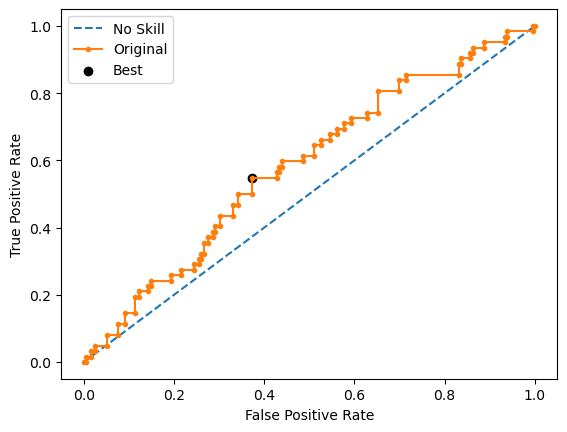

Learning rate set to 0.011041
0:	learn: 0.6887638	total: 3.21ms	remaining: 3.2s
1:	learn: 0.6840335	total: 6.05ms	remaining: 3.02s
2:	learn: 0.6795511	total: 8.16ms	remaining: 2.71s
3:	learn: 0.6750607	total: 11.4ms	remaining: 2.85s
4:	learn: 0.6707126	total: 13.4ms	remaining: 2.67s
5:	learn: 0.6679109	total: 16.2ms	remaining: 2.68s
6:	learn: 0.6643796	total: 19.4ms	remaining: 2.75s
7:	learn: 0.6611534	total: 21.4ms	remaining: 2.65s
8:	learn: 0.6575546	total: 24.2ms	remaining: 2.67s
9:	learn: 0.6537806	total: 27.3ms	remaining: 2.7s
10:	learn: 0.6503619	total: 29.4ms	remaining: 2.64s
11:	learn: 0.6463337	total: 31.2ms	remaining: 2.57s
12:	learn: 0.6433569	total: 33.4ms	remaining: 2.54s
13:	learn: 0.6388912	total: 35.8ms	remaining: 2.52s
14:	learn: 0.6349061	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6317447	total: 40.1ms	remaining: 2.46s
16:	learn: 0.6270200	total: 42.1ms	remaining: 2.43s
17:	learn: 0.6244638	total: 44.2ms	remaining: 2.41s
18:	learn: 0.6214106	total: 46.6ms	remaining: 

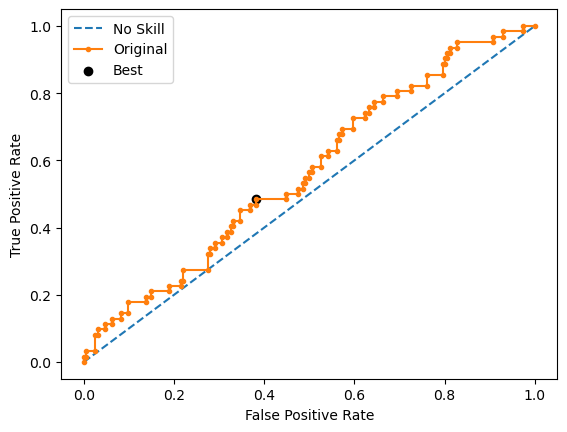

Learning rate set to 0.011041
0:	learn: 0.6891419	total: 2.86ms	remaining: 2.86s
1:	learn: 0.6859563	total: 5.32ms	remaining: 2.65s
2:	learn: 0.6814307	total: 8.65ms	remaining: 2.88s
3:	learn: 0.6777289	total: 11.9ms	remaining: 2.97s
4:	learn: 0.6741664	total: 14.2ms	remaining: 2.82s
5:	learn: 0.6700224	total: 16.3ms	remaining: 2.7s
6:	learn: 0.6649461	total: 18.2ms	remaining: 2.58s
7:	learn: 0.6616107	total: 20.3ms	remaining: 2.52s
8:	learn: 0.6576710	total: 22.3ms	remaining: 2.46s
9:	learn: 0.6542677	total: 24.4ms	remaining: 2.42s
10:	learn: 0.6502979	total: 26.5ms	remaining: 2.38s
11:	learn: 0.6458709	total: 28.6ms	remaining: 2.35s
12:	learn: 0.6439330	total: 30.8ms	remaining: 2.34s
13:	learn: 0.6394230	total: 33ms	remaining: 2.32s
14:	learn: 0.6337599	total: 35.7ms	remaining: 2.34s
15:	learn: 0.6308307	total: 37.9ms	remaining: 2.33s
16:	learn: 0.6260879	total: 40.3ms	remaining: 2.33s
17:	learn: 0.6231314	total: 42.6ms	remaining: 2.33s
18:	learn: 0.6198059	total: 45ms	remaining: 2.3

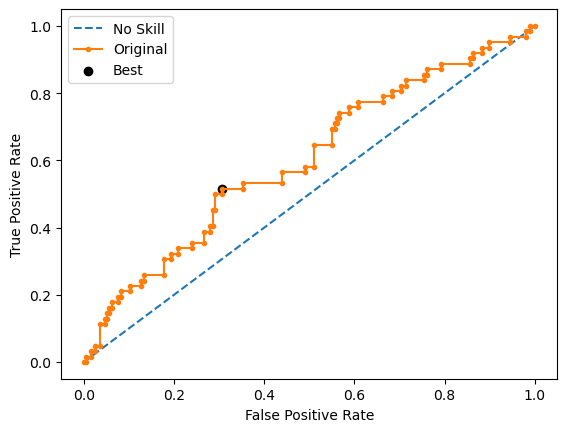

Learning rate set to 0.011041
0:	learn: 0.6885759	total: 2.96ms	remaining: 2.96s
1:	learn: 0.6854646	total: 6.34ms	remaining: 3.17s
2:	learn: 0.6811031	total: 8.97ms	remaining: 2.98s
3:	learn: 0.6762108	total: 11.1ms	remaining: 2.77s
4:	learn: 0.6714041	total: 13.3ms	remaining: 2.65s
5:	learn: 0.6674086	total: 16.3ms	remaining: 2.7s
6:	learn: 0.6643517	total: 19ms	remaining: 2.69s
7:	learn: 0.6616430	total: 21.1ms	remaining: 2.62s
8:	learn: 0.6574253	total: 23.3ms	remaining: 2.57s
9:	learn: 0.6548805	total: 25.3ms	remaining: 2.5s
10:	learn: 0.6519802	total: 27.4ms	remaining: 2.46s
11:	learn: 0.6490156	total: 29.7ms	remaining: 2.45s
12:	learn: 0.6446727	total: 32.1ms	remaining: 2.44s
13:	learn: 0.6408858	total: 34.5ms	remaining: 2.43s
14:	learn: 0.6384261	total: 36.7ms	remaining: 2.41s
15:	learn: 0.6355178	total: 38.8ms	remaining: 2.38s
16:	learn: 0.6304979	total: 40.9ms	remaining: 2.37s
17:	learn: 0.6274249	total: 43.2ms	remaining: 2.35s
18:	learn: 0.6223270	total: 45.7ms	remaining: 2.

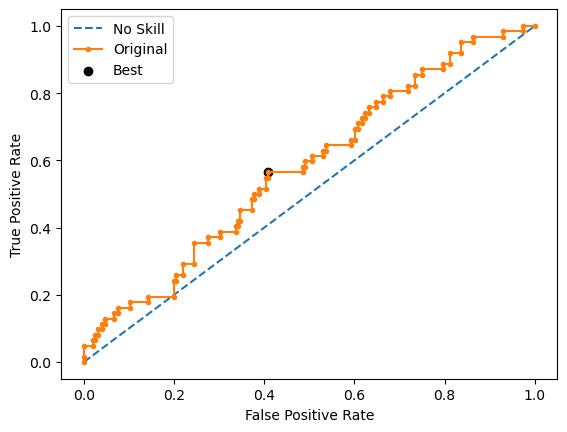

Learning rate set to 0.011041
0:	learn: 0.6867460	total: 3.35ms	remaining: 3.35s
1:	learn: 0.6825415	total: 5.41ms	remaining: 2.7s
2:	learn: 0.6782937	total: 8.01ms	remaining: 2.66s
3:	learn: 0.6751039	total: 10.3ms	remaining: 2.56s
4:	learn: 0.6707100	total: 12.8ms	remaining: 2.56s
5:	learn: 0.6667387	total: 14.9ms	remaining: 2.46s
6:	learn: 0.6611340	total: 17.6ms	remaining: 2.5s
7:	learn: 0.6567844	total: 19.9ms	remaining: 2.46s
8:	learn: 0.6525692	total: 21.9ms	remaining: 2.41s
9:	learn: 0.6487164	total: 24.1ms	remaining: 2.39s
10:	learn: 0.6446290	total: 26.3ms	remaining: 2.37s
11:	learn: 0.6401352	total: 29.1ms	remaining: 2.39s
12:	learn: 0.6363951	total: 31.9ms	remaining: 2.42s
13:	learn: 0.6326632	total: 34.4ms	remaining: 2.42s
14:	learn: 0.6274813	total: 36.6ms	remaining: 2.4s
15:	learn: 0.6243492	total: 38.7ms	remaining: 2.38s
16:	learn: 0.6200779	total: 40.8ms	remaining: 2.36s
17:	learn: 0.6169409	total: 43.1ms	remaining: 2.35s
18:	learn: 0.6132804	total: 45.7ms	remaining: 2

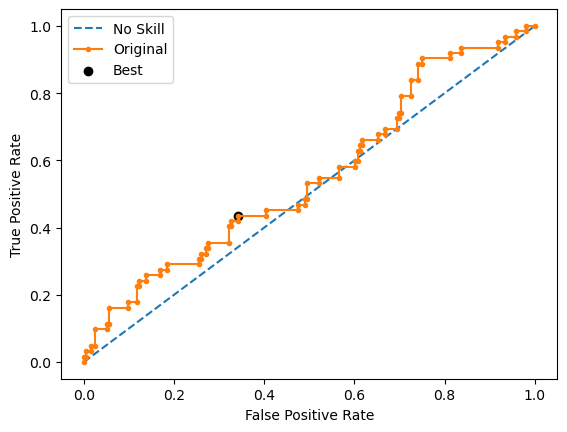

Ave Test G-mean: 0.29777059655677063
Stdev Test G-mean: 0.02057294269332872
Ave Test Specificity: 0.9520408163265307
Ave Test Recall: 0.0935483870967742
Ave Test NPV: 0.7685338196426403
Ave Test Accuracy: 0.7457364341085271
Ave Test Precision: 0.38523182957393487
Ave Test F1-Score: 0.14998373243987279
Ave Runtime: 2.405022144317627


In [98]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [99]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
7,Extreme Gradient Boosting (XGBoost),0.389728,0.042858,0.490693,0.757282,0.914286,0.167742,0.387890,0.232817,0.734884
5,Gradient Boosting Machine (GBM),0.341855,0.020431,0.397133,0.788694,0.909184,0.129032,0.324059,0.182373,0.721705
0,k-Nearest Neighbors,0.319940,0.054144,0.451032,0.513182,0.907143,0.116129,0.280937,0.162317,0.717054
9,CatBoost,0.297771,0.020573,0.495357,0.846208,0.952041,0.093548,0.385232,0.149984,0.745736
2,Logistic Regression,0.290841,0.083559,0.335833,NaN,0.913265,0.100000,0.256582,0.140012,0.717829
6,LightGBM,0.289349,0.047138,0.566667,0.645481,0.951020,0.090323,0.375923,0.143317,0.744186
8,AdaBoost,0.279881,0.052002,0.491310,0.832726,0.960204,0.083871,0.395916,0.137635,0.749612
3,Decision Tree,0.255636,0.085623,0.462554,NaN,0.941837,0.077419,0.296452,0.115289,0.734109
1,SVM Classifier,0.240104,0.071313,0.414286,0.293205,0.960204,0.064516,0.336845,0.105988,0.744961
4,Random Forest,0.128853,0.120534,0.415000,0.492867,0.973469,0.029032,0.259091,0.051059,0.746512


In [100]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t06_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.749612,AdaBoost
Highest Test G-mean,0.389728,Extreme Gradient Boosting (XGBoost)
Highest Test Recall,0.167742,Extreme Gradient Boosting (XGBoost)
Highest Test Precision,0.395916,AdaBoost
Highest Test Specificity,0.973469,Random Forest
Highest Test F1-score,0.232817,Extreme Gradient Boosting (XGBoost)


# HO-T06 Runs: StandardScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


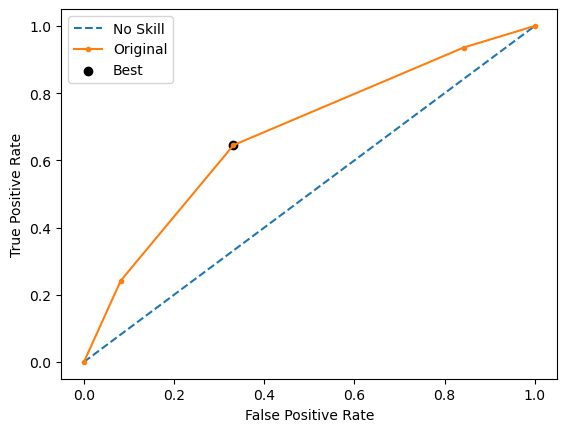

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


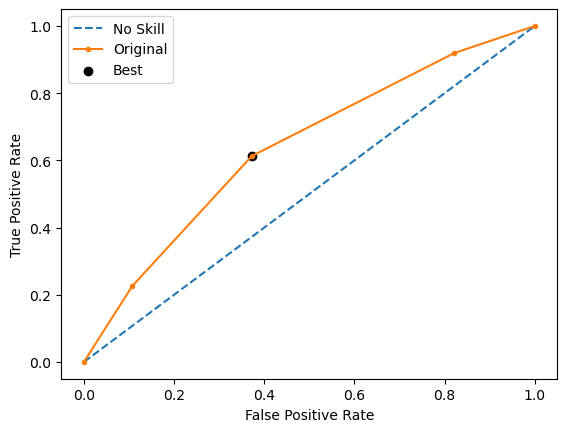

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


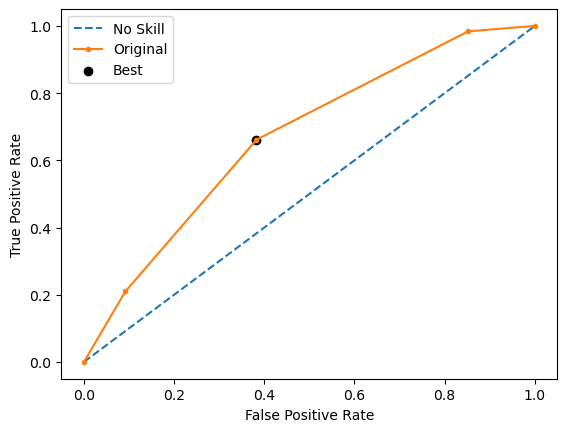

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


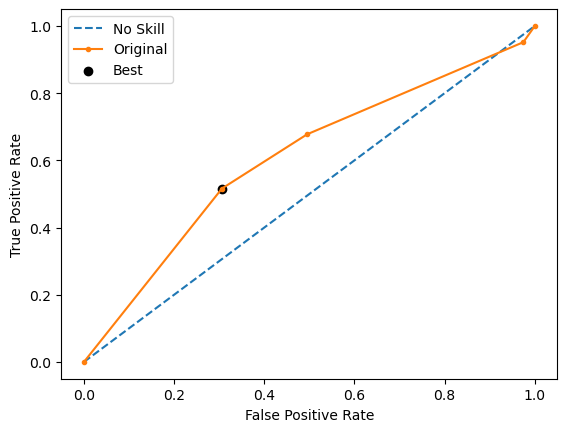

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


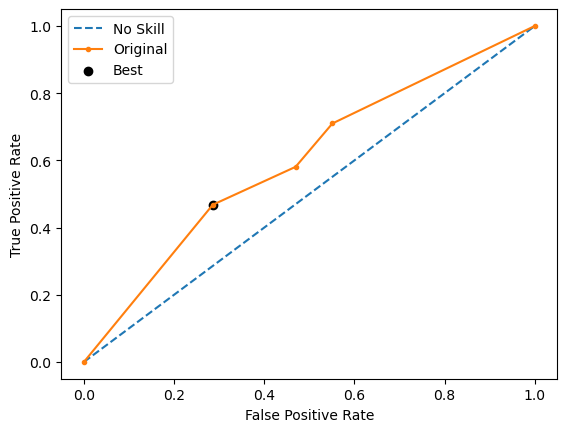

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

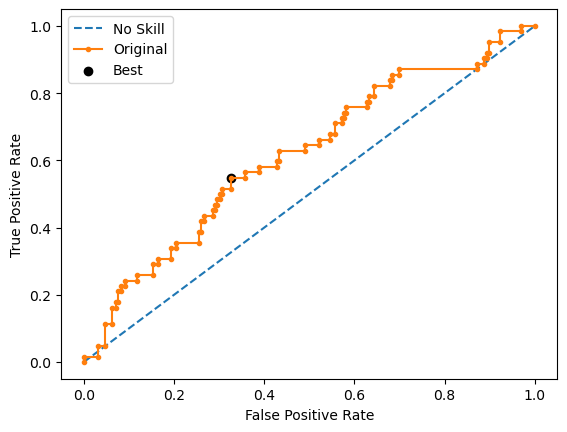

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


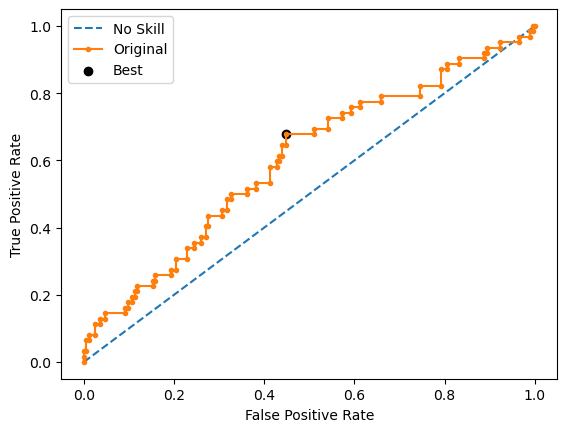

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


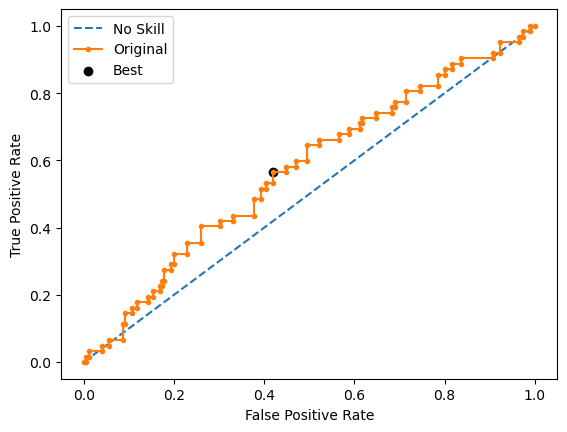

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


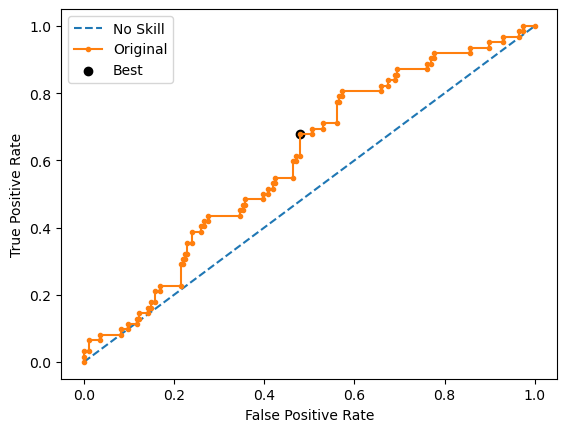

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


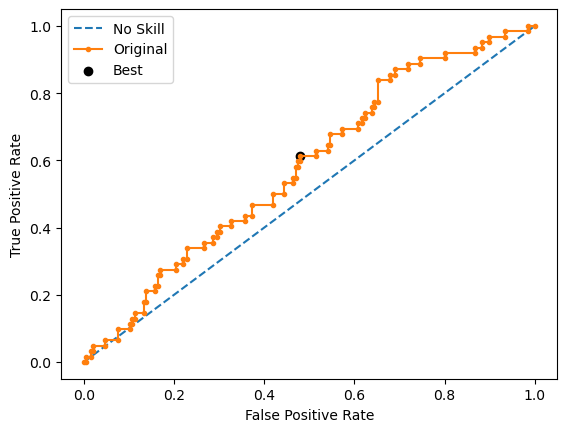

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


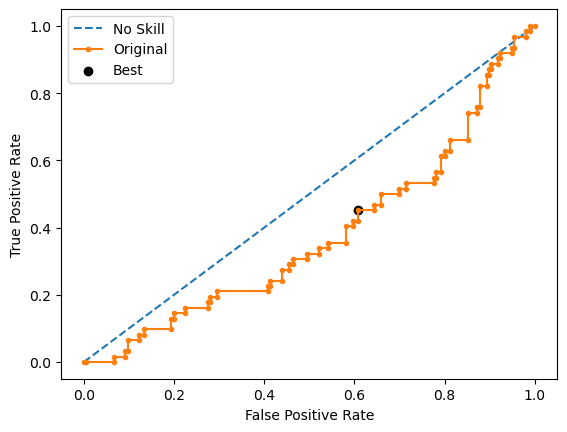

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


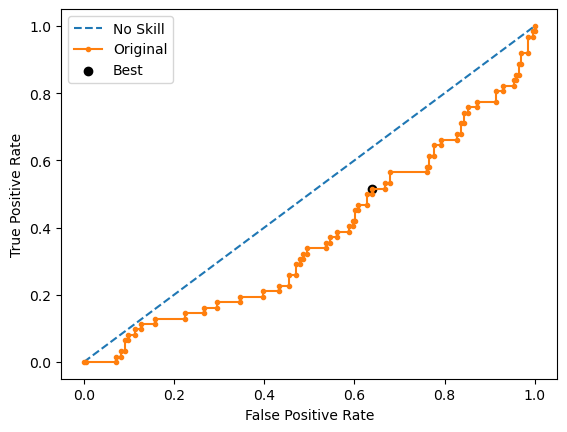

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


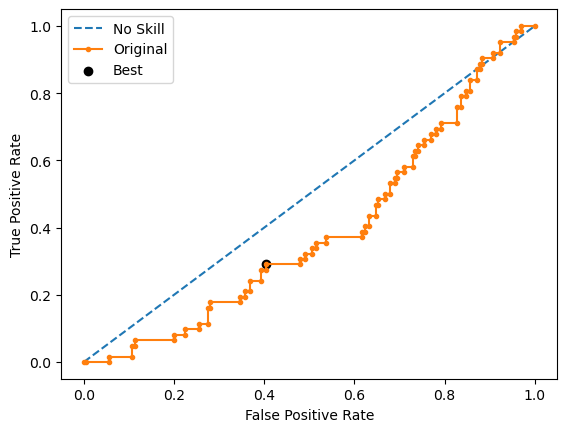

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


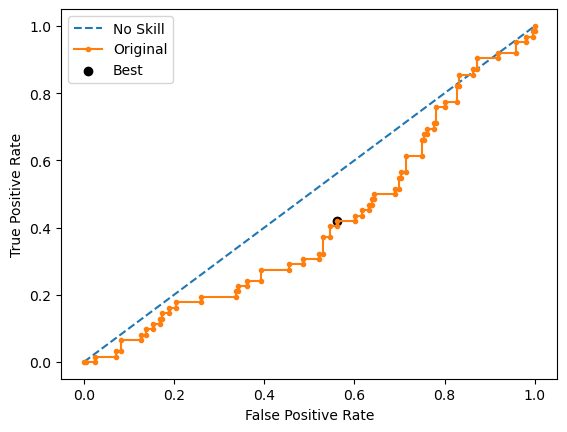

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


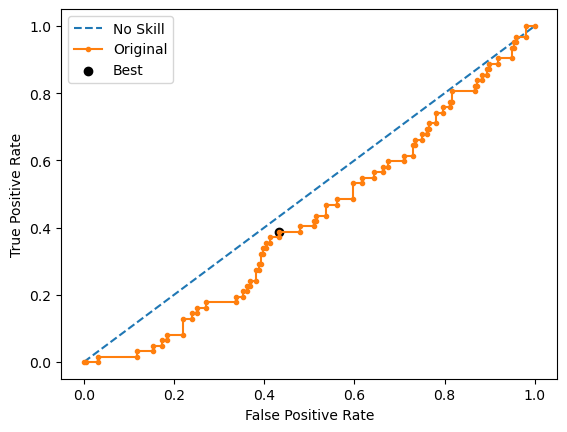

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_

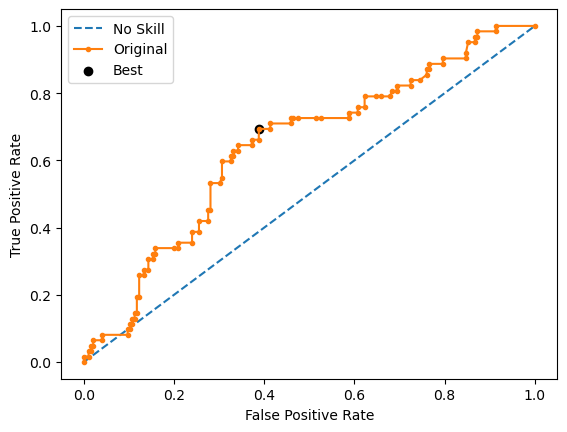

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


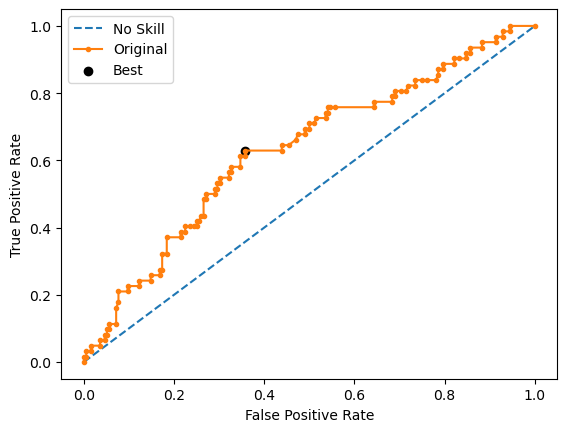

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


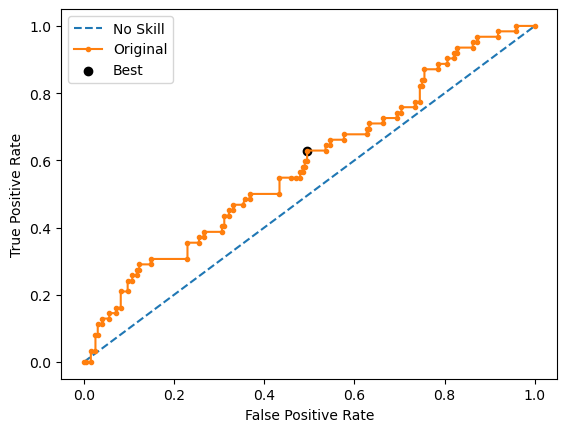

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


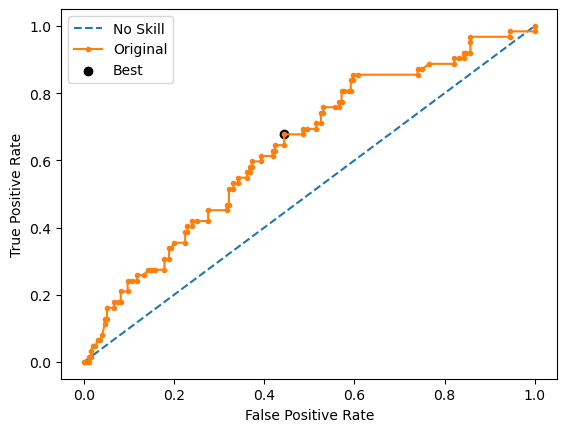

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


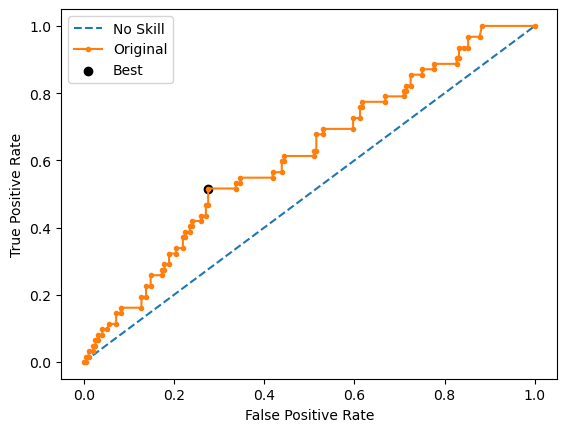

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.19665169715881348


In [224]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'goss', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__n_estimators': 300, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.577998778688951
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='goss', learning_rate=0.01,
                                max_depth=3, n_estimators=300,
                                random_state=0))])
Mean Train Score (G-mean) 0.7598671718538652
Std Train Score (G-mean) 0.016532797612759057
GridSearchCV Runtime: 35.78956937789917 secs
Run 1 - Random State: 0
Test G-mean: 0.6109598099719176
Best Threshold=0.489740, G-Mean=0.626


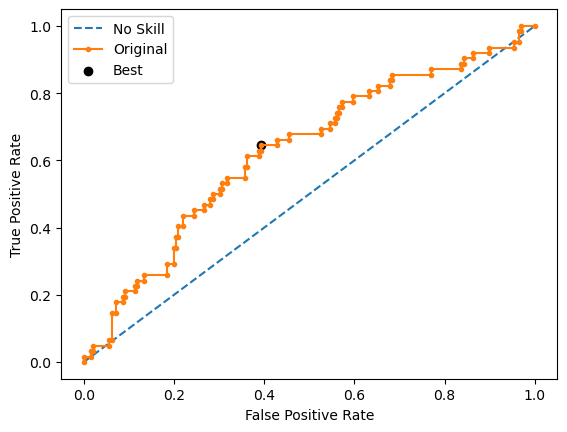

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.542979, G-Mean=0.621


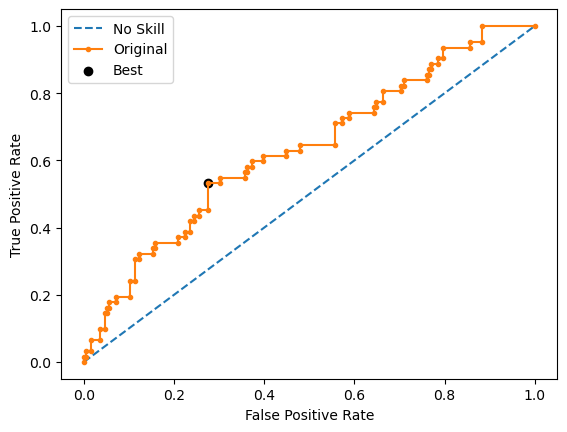

Run 3 - Random State: 2
Test G-mean: 0.6085305366932837
Best Threshold=0.503764, G-Mean=0.618


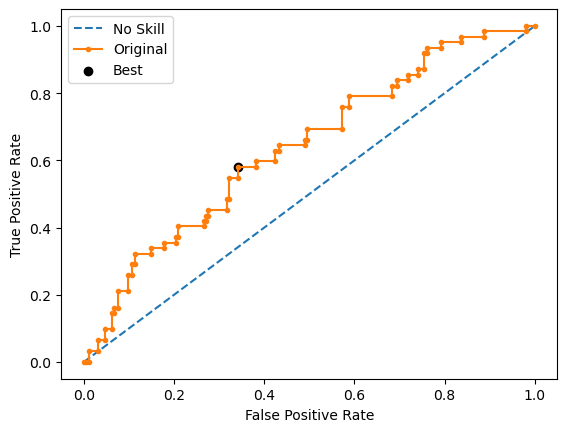

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.472611, G-Mean=0.591


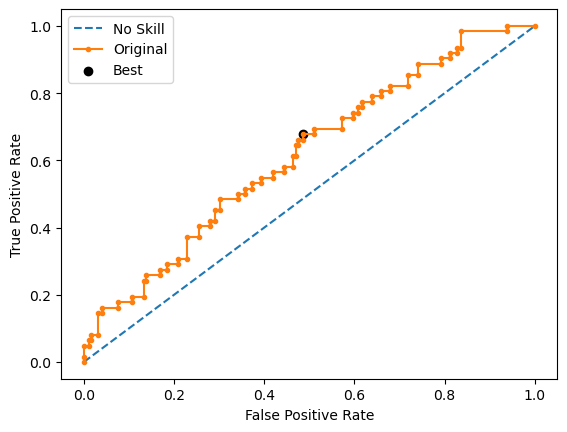

Run 5 - Random State: 4
Test G-mean: 0.5572846327942754
Best Threshold=0.554358, G-Mean=0.588


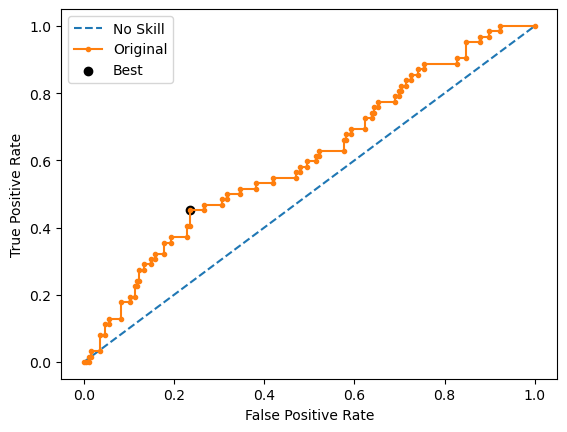

Ave Test G-mean: 0.5906856249389232
Stdev Test G-mean: 0.02411122756127123
Ave Test Specificity: 0.6112244897959184
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8178674166078368
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3182412107715316
Ave Test F1-Score: 0.40848232467154577
Ave Runtime: 0.3433506011962891


In [225]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5708017601192481
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9476864629106763
Std Train Score (G-mean) 0.0038326194544914087
GridSearchCV Runtime: 10.719450235366821 secs
Run 1 - Random State: 0
Test G-mean: 0.5937462102716796
Best Threshold=0.731059, G-Mean=0.594


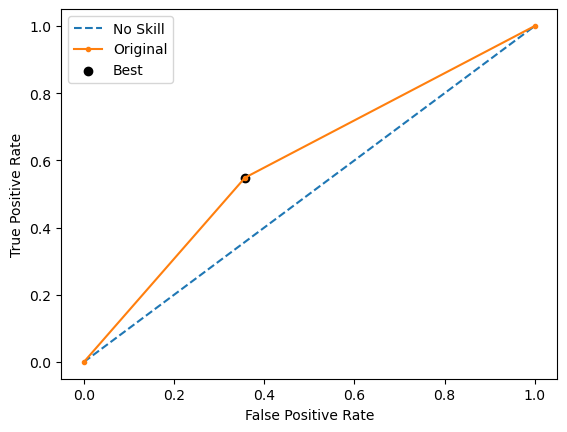

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


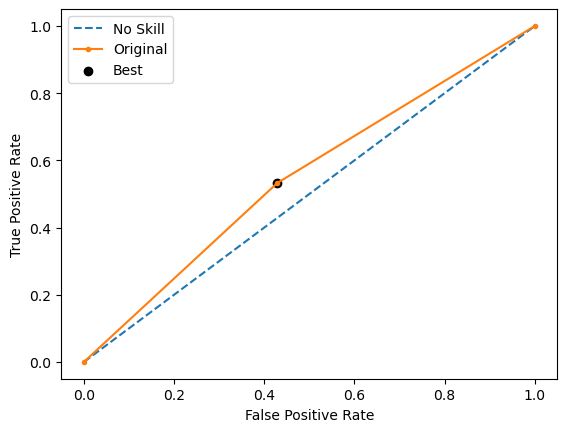

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


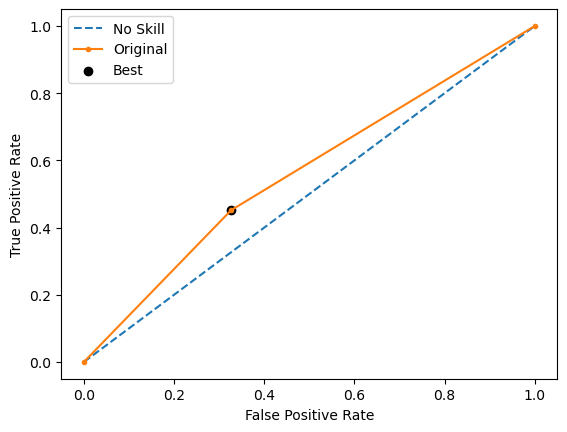

Run 4 - Random State: 3
Test G-mean: 0.6017310994101656
Best Threshold=0.731059, G-Mean=0.602


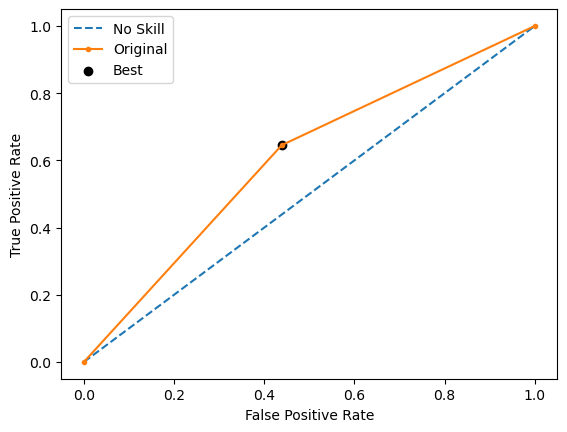

Run 5 - Random State: 4
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


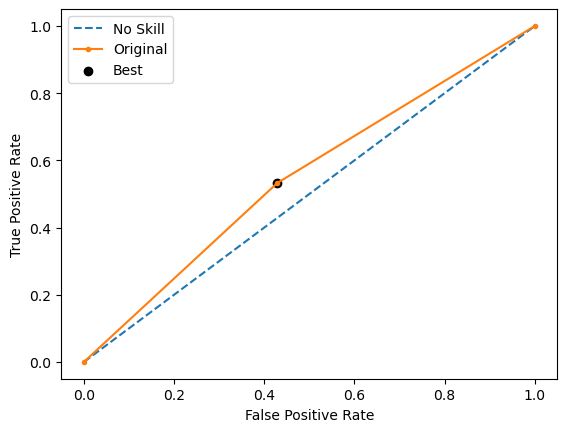

Ave Test G-mean: 0.5699928592630987
Stdev Test G-mean: 0.025485174455446857
Ave Test Specificity: 0.6040816326530611
Ave Test Recall: 0.5419354838709677
Ave Test NPV: 0.8070696713352443
Ave Test Accuracy: 0.5891472868217054
Ave Test Precision: 0.302566756914583
Ave Test F1-Score: 0.38724740006892266
Ave Runtime: 0.2264254570007324


In [226]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5680904738623496
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8771095131586388
Std Train Score (G-mean) 0.010527366294144738
GridSearchCV Runtime: 88.82423067092896 secs
Run 1 - Random State: 0
Test G-mean: 0.5597892954492245
Best Threshold=0.555999, G-Mean=0.580


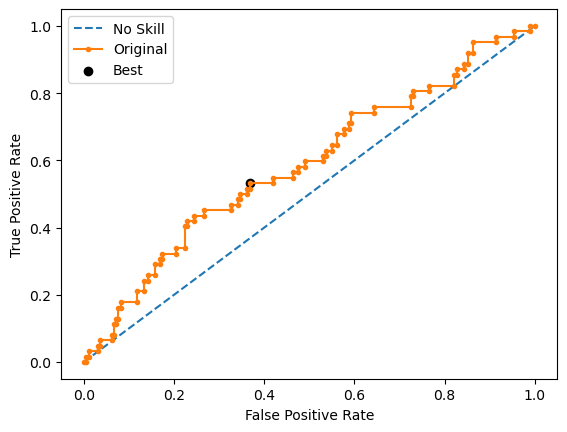

Run 2 - Random State: 1
Test G-mean: 0.5968564788564029
Best Threshold=0.521194, G-Mean=0.613


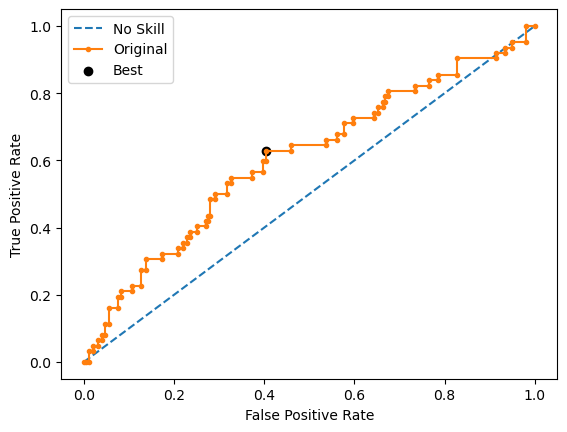

Run 3 - Random State: 2
Test G-mean: 0.48300613958372834
Best Threshold=0.295774, G-Mean=0.528


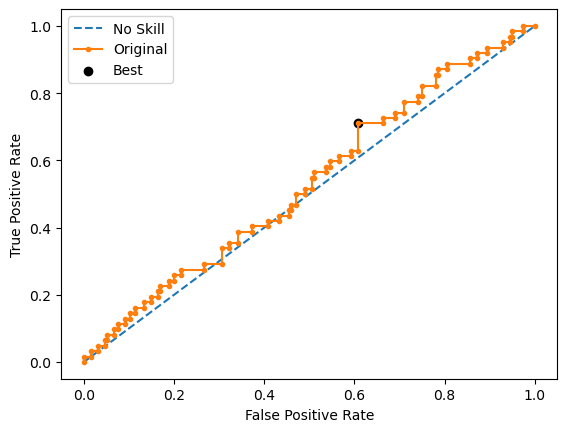

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


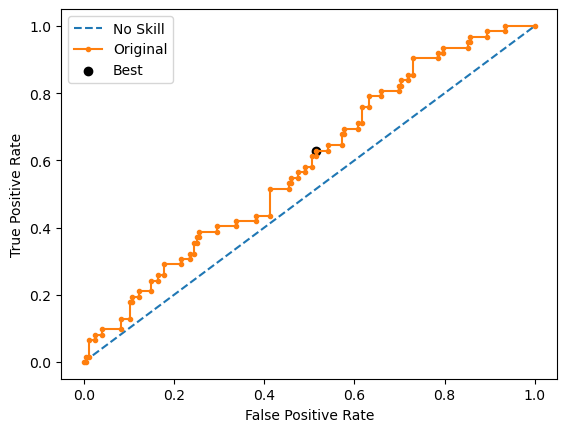

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.582


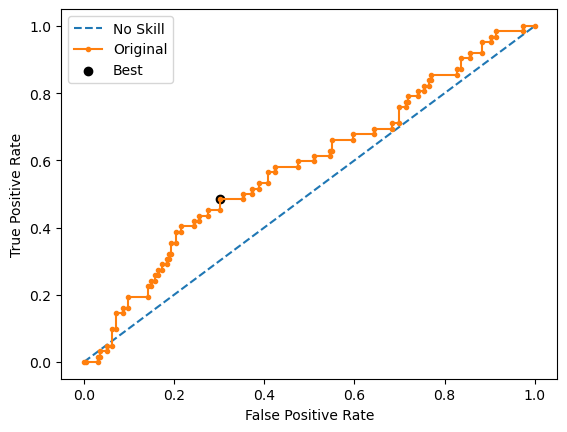

Ave Test G-mean: 0.54888471638605
Stdev Test G-mean: 0.04268531193466081
Ave Test Specificity: 0.5846938775510204
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7975992512186542
Ave Test Accuracy: 0.5705426356589147
Ave Test Precision: 0.2839449785968609
Ave Test F1-Score: 0.36694904582001353
Ave Runtime: 0.39573121070861816


In [228]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5767544617781283
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.619682586626071
Std Train Score (G-mean) 0.02081374722807044
GridSearchCV Runtime: 357.49217915534973 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best 

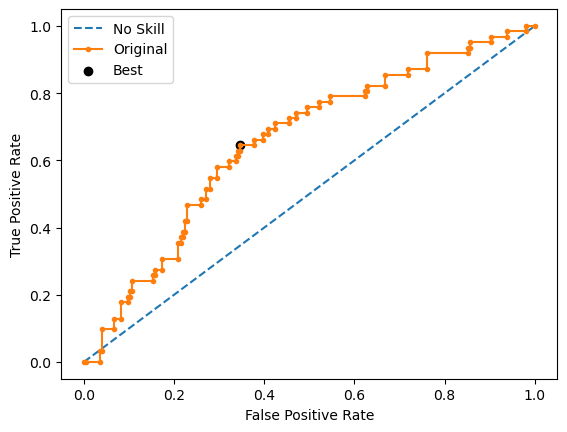

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.500755, G-Mean=0.624


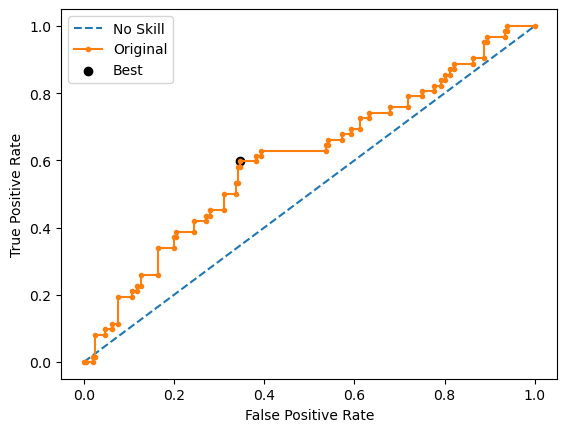

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


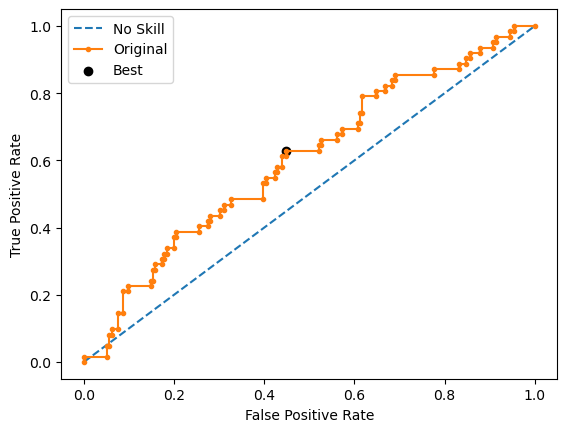

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


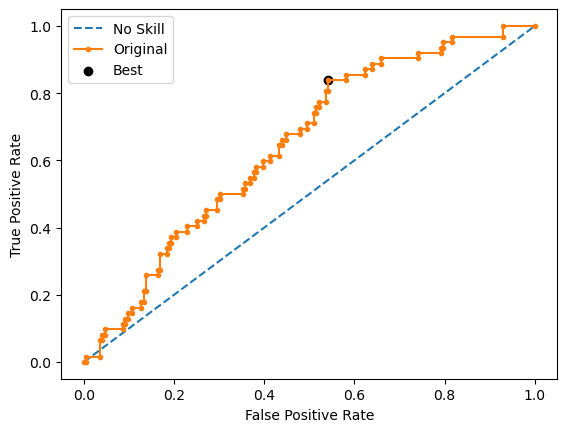

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


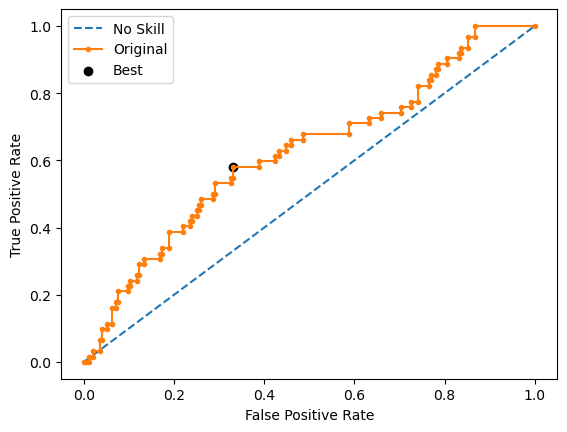

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.5530432224273681


In [227]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6904773	total: 4.3ms	remaining: 2.15s
2:	learn: 0.6892748	total: 6.39ms	remaining: 2.13s
3:	learn: 0.6883518	total: 9.02ms	remaining: 2.25s
4:	learn: 0.6874894	total: 11.3ms	remaining: 2.25s
5:	learn: 0.6864793	total: 13.7ms	remaining: 2.26s
6:	learn: 0.6849713	total: 15.7ms	remaining: 2.23s
7:	learn: 0.6835259	total: 17.8ms	remaining: 2.2s
8:	learn: 0.6820508	total: 19.8ms	remaining: 2.19s
9:	learn: 0.6808529	total: 21.9ms	remaining: 2.17s
10:	learn: 0.6794658	total: 23.9ms	remaining: 2.15s
11:	learn: 0.6782565	total: 26.2ms	remaining: 2.15s
12:	learn: 0.6770542	total: 28.4ms	remaining: 2.15s
13:	learn: 0.6758270	total: 30.5ms	remaining: 2.15s
14:	learn: 0.6747007	total: 32.6ms	remaining: 2.14s
15:	learn: 0.6735646	total: 34.5ms	remaining: 2.12s
16:	learn: 0.6724274	total: 36.5ms	remaining: 2.11s
17:	learn: 0.6714028	total: 38.5ms	re

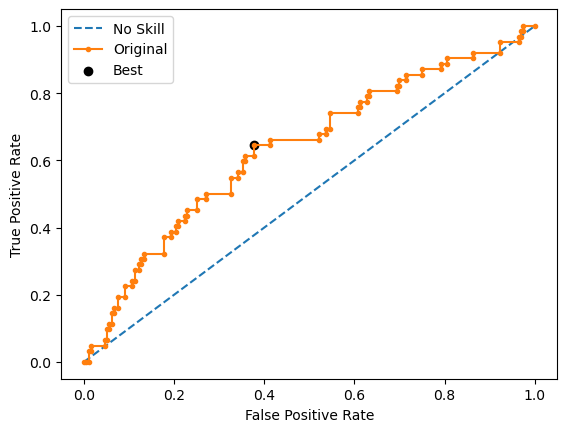

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 4.65ms	remaining: 4.64s
1:	learn: 0.6892966	total: 6.37ms	remaining: 3.18s
2:	learn: 0.6879854	total: 8.06ms	remaining: 2.68s
3:	learn: 0.6869652	total: 10ms	remaining: 2.49s
4:	learn: 0.6857235	total: 12.1ms	remaining: 2.4s
5:	learn: 0.6845124	total: 13.8ms	remaining: 2.29s
6:	learn: 0.6829168	total: 15.5ms	remaining: 2.21s
7:	learn: 0.6809996	total: 17.3ms	remaining: 2.15s
8:	learn: 0.6789838	total: 19.2ms	remaining: 2.12s
9:	learn: 0.6771489	total: 20.9ms	remaining: 2.07s
10:	learn: 0.6755326	total: 22.7ms	remaining: 2.04s
11:	learn: 0.6742410	total: 24.4ms	remaining: 2.01s
12:	learn: 0.6725502	total: 26.4ms	remaining: 2.01s
13:	learn: 0.6705914	total: 28.2ms	remaining: 1.99s
14:	learn: 0.6692993	total: 30.3ms	remaining: 1.99s
15:	learn: 0.6680835	total: 32.1ms	remaining: 1.97s
16:	learn: 0.6669018	total: 33.8ms	remaining: 1.95s
17:	learn: 0.6658209	total: 35.8ms	remaining: 1.95s
18:	learn: 0.6646626	total: 37.4ms	remaining: 1

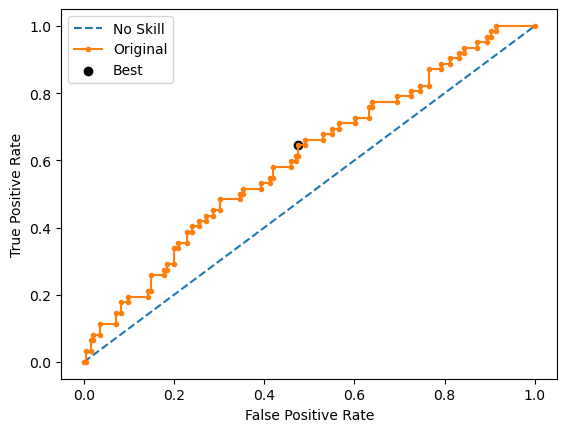

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 3.81ms	remaining: 3.81s
1:	learn: 0.6900261	total: 7.11ms	remaining: 3.55s
2:	learn: 0.6889845	total: 10.3ms	remaining: 3.41s
3:	learn: 0.6882180	total: 13.2ms	remaining: 3.29s
4:	learn: 0.6870207	total: 15.7ms	remaining: 3.12s
5:	learn: 0.6858179	total: 18.8ms	remaining: 3.12s
6:	learn: 0.6851150	total: 21.4ms	remaining: 3.04s
7:	learn: 0.6832779	total: 23.8ms	remaining: 2.95s
8:	learn: 0.6823443	total: 25.8ms	remaining: 2.84s
9:	learn: 0.6812690	total: 27.5ms	remaining: 2.72s
10:	learn: 0.6800280	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6792044	total: 31.4ms	remaining: 2.59s
12:	learn: 0.6783522	total: 33.3ms	remaining: 2.52s
13:	learn: 0.6772651	total: 35.5ms	remaining: 2.5s
14:	learn: 0.6763484	total: 37.2ms	remaining: 2.44s
15:	learn: 0.6753359	total: 39ms	remaining: 2.4s
16:	learn: 0.6745798	total: 41ms	remaining: 2.37s
17:	learn: 0.6740406	total: 42.8ms	remaining: 2.34s
18:	learn: 0.6730462	total: 44.7ms	remaining: 2.31

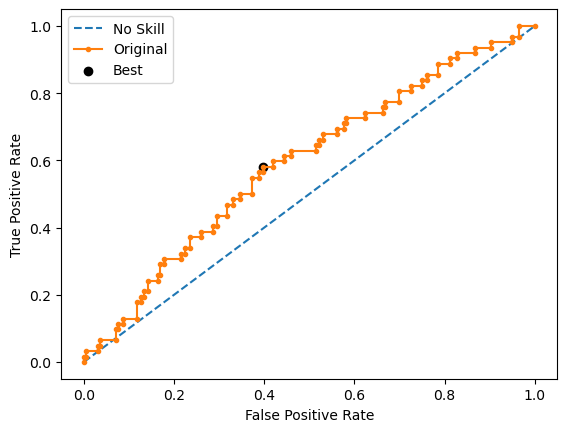

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 4.3ms	remaining: 4.29s
1:	learn: 0.6903289	total: 9.16ms	remaining: 4.57s
2:	learn: 0.6890073	total: 11.5ms	remaining: 3.84s
3:	learn: 0.6876582	total: 14.8ms	remaining: 3.69s
4:	learn: 0.6870475	total: 17.5ms	remaining: 3.49s
5:	learn: 0.6853816	total: 19.5ms	remaining: 3.23s
6:	learn: 0.6842847	total: 21.4ms	remaining: 3.03s
7:	learn: 0.6824566	total: 24.3ms	remaining: 3.02s
8:	learn: 0.6813194	total: 27.5ms	remaining: 3.03s
9:	learn: 0.6800294	total: 30.8ms	remaining: 3.04s
10:	learn: 0.6789221	total: 32.9ms	remaining: 2.95s
11:	learn: 0.6774388	total: 34.8ms	remaining: 2.87s
12:	learn: 0.6757157	total: 36.6ms	remaining: 2.77s
13:	learn: 0.6746996	total: 38.4ms	remaining: 2.7s
14:	learn: 0.6730859	total: 40.6ms	remaining: 2.66s
15:	learn: 0.6718456	total: 42.6ms	remaining: 2.62s
16:	learn: 0.6709146	total: 44.5ms	remaining: 2.57s
17:	learn: 0.6697991	total: 46.6ms	remaining: 2.54s
18:	learn: 0.6687022	total: 48.2ms	remaining: 

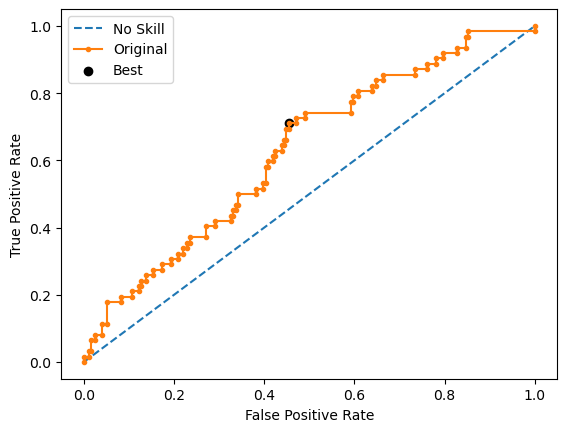

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 7.1ms	remaining: 7.09s
1:	learn: 0.6914337	total: 12.6ms	remaining: 6.31s
2:	learn: 0.6905395	total: 18.7ms	remaining: 6.22s
3:	learn: 0.6893376	total: 24.1ms	remaining: 5.99s
4:	learn: 0.6886264	total: 29.6ms	remaining: 5.89s
5:	learn: 0.6873547	total: 36.1ms	remaining: 5.99s
6:	learn: 0.6865741	total: 41.9ms	remaining: 5.94s
7:	learn: 0.6851301	total: 48.2ms	remaining: 5.98s
8:	learn: 0.6836135	total: 54.3ms	remaining: 5.98s
9:	learn: 0.6819828	total: 59.6ms	remaining: 5.9s
10:	learn: 0.6807787	total: 65.1ms	remaining: 5.86s
11:	learn: 0.6794977	total: 70.6ms	remaining: 5.82s
12:	learn: 0.6787670	total: 75.5ms	remaining: 5.73s
13:	learn: 0.6780396	total: 78.3ms	remaining: 5.51s
14:	learn: 0.6766027	total: 82.7ms	remaining: 5.43s
15:	learn: 0.6753885	total: 85.8ms	remaining: 5.28s
16:	learn: 0.6744288	total: 88.7ms	remaining: 5.13s
17:	learn: 0.6732602	total: 91.9ms	remaining: 5.01s
18:	learn: 0.6727781	total: 93.8ms	remaining: 

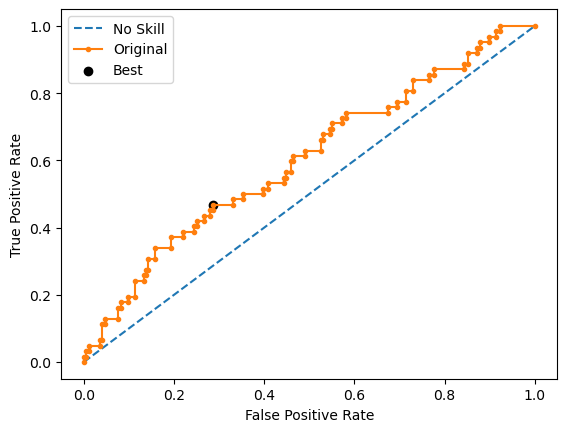

Ave Test G-mean: 0.5780613563062795
Stdev Test G-mean: 0.021632265673870815
Ave Test Specificity: 0.6091836734693878
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8112190842702608
Ave Test Accuracy: 0.5953488372093023
Ave Test Precision: 0.30989017763489235
Ave Test F1-Score: 0.3958123097316304
Ave Runtime: 2.033609962463379


In [250]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [249]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.611160,0.041101,0.586133,0.504563,0.589796,0.635484
4,Random Forest,0.601543,0.031002,0.576754,0.619683,0.638776,0.567742
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.864548,0.642857,0.561290
6,LightGBM,0.590686,0.024111,0.577999,0.759867,0.611224,0.570968
1,SVM Classifier,0.579030,0.019596,0.583602,0.521988,0.643878,0.522581
8,AdaBoost,0.569993,0.025485,0.570802,0.947686,0.604082,0.541935
5,Gradient Boosting Machine (GBM),0.548885,0.042685,0.568090,0.877110,0.584694,0.525806
2,Logistic Regression,0.547066,0.019058,0.551183,NaN,0.663265,0.451613
0,k-Nearest Neighbors,0.521198,0.040743,0.561944,0.692605,0.601020,0.454839


# HO-T07 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) 0.5046837575262252
Std Train Score (G-mean) 0.06523744177119856
GridSearchCV Runtime: 109.23559808731079 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.571125, G-Mean=0.647


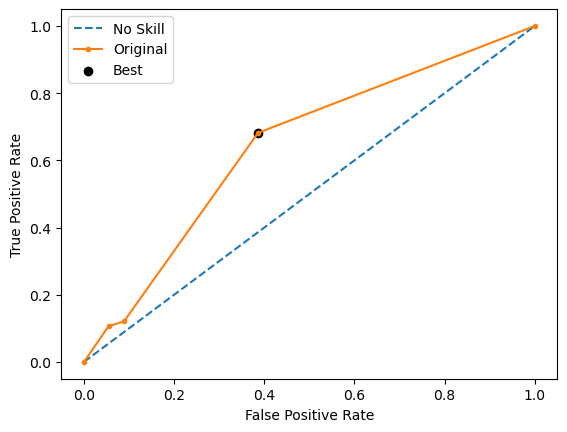

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


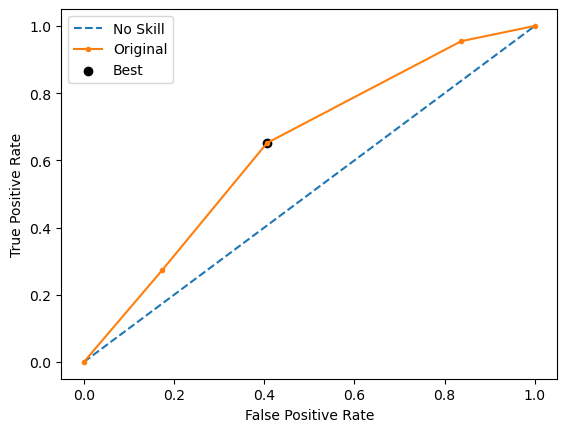

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


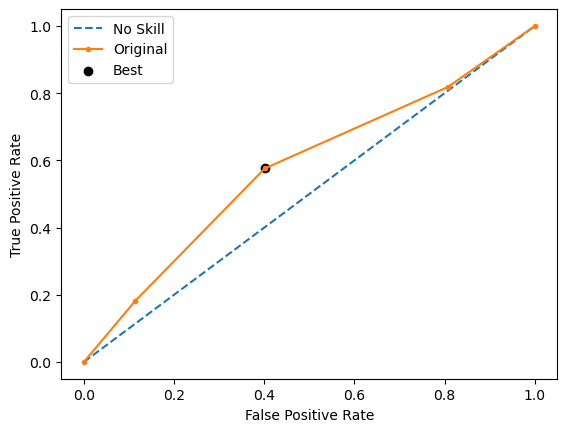

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


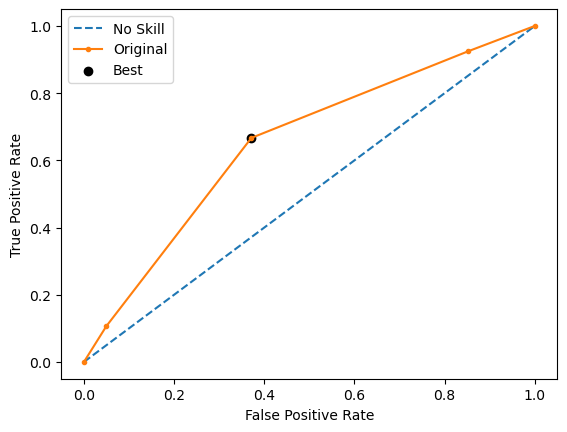

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


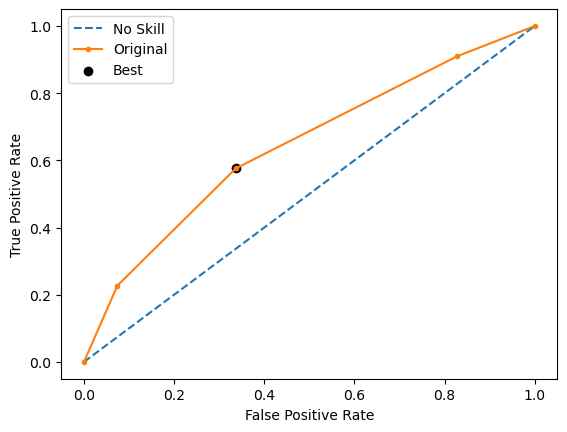

Ave Test G-mean: 0.6243528621539446
Stdev Test G-mean: 0.024812658646035383
Ave Test Specificity: 0.6198019801980198
Ave Test Recall: 0.6303030303030303
Ave Test NPV: 0.837184655396489
Ave Test Accuracy: 0.6223880597014926
Ave Test Precision: 0.3514839709652844
Ave Test F1-Score: 0.45095984157959074
Ave Runtime: 0.044297981262207034


In [253]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6028860756941616
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 103.42858576774597 secs
Run 1 - Random State: 0
Test G-mean: 0.6052574936862545
Best Threshold=0.516985, G-Mean=0.613


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


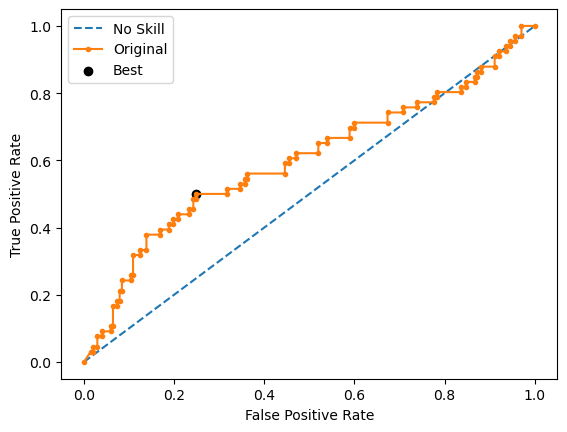

Run 2 - Random State: 1
Test G-mean: 0.5818795909686458
Best Threshold=0.494786, G-Mean=0.585


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


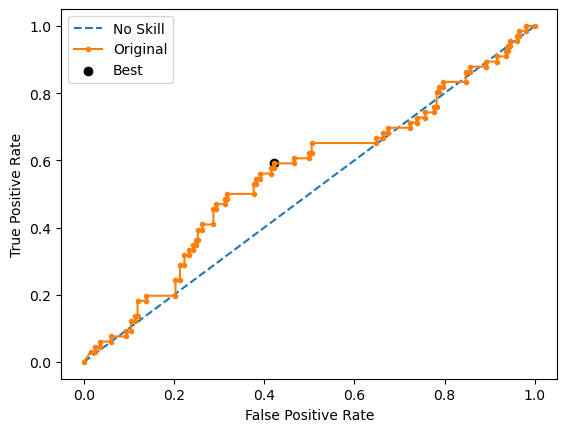

Run 3 - Random State: 2
Test G-mean: 0.6000300022501874
Best Threshold=0.507981, G-Mean=0.610


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


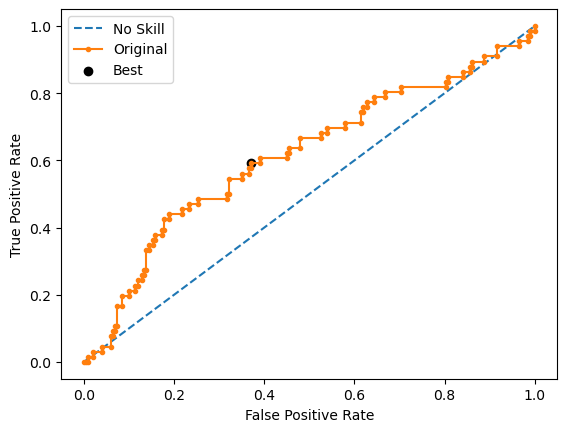

Run 4 - Random State: 3
Test G-mean: 0.5794899316278807
Best Threshold=0.517572, G-Mean=0.582


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


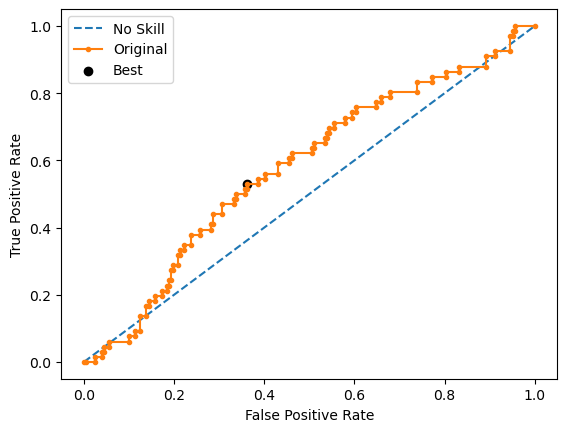

Run 5 - Random State: 4
Test G-mean: 0.5498001709919726
Best Threshold=0.455935, G-Mean=0.567


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


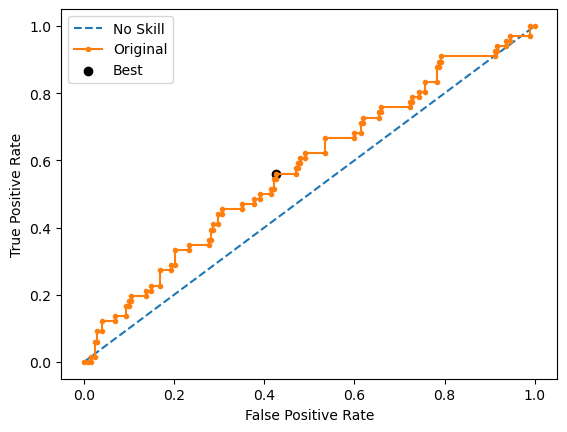

Ave Test G-mean: 0.5832914379049882
Stdev Test G-mean: 0.02179906456771411
Ave Test Specificity: 0.6346534653465347
Ave Test Recall: 0.5393939393939393
Ave Test NPV: 0.8084179681286464
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.327589741869245
Ave Test F1-Score: 0.4060627733963201
Ave Runtime: 0.6266489505767823


In [254]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.525756832540497
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.252068334547509
Std Train Score (G-mean) 0.05114472320145939
GridSearchCV Runtime: 182.0276017189026 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5222329678670935
Best Threshold=0.505154, G-Mean=0.297


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


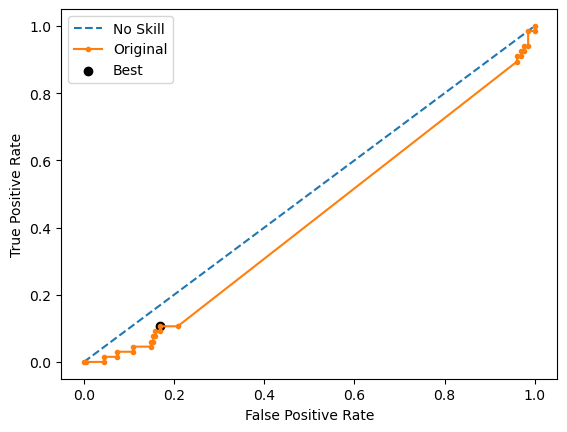

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5620779244547112
Best Threshold=0.500000, G-Mean=0.236


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


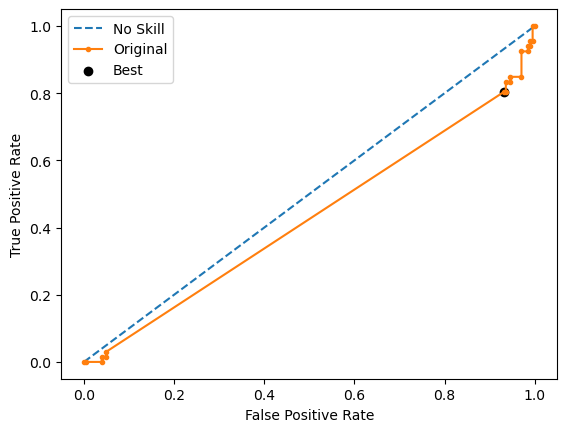

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5035130112869513
Best Threshold=0.494625, G-Mean=0.373


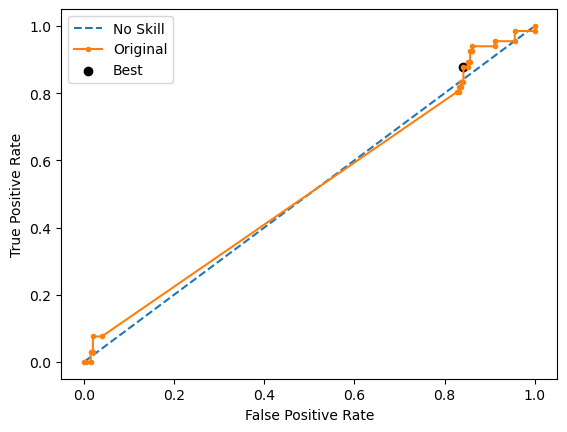

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.49358318694647985
Best Threshold=0.506519, G-Mean=0.359


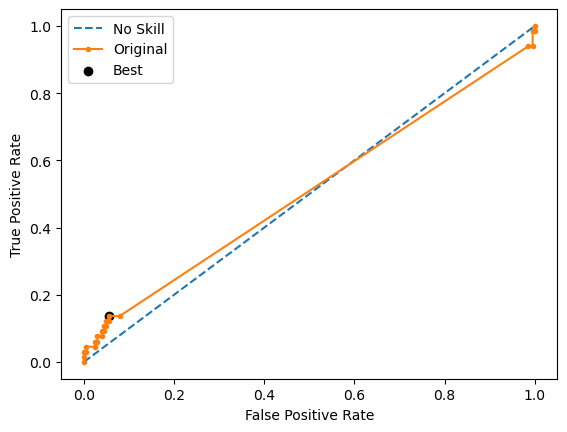

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5260253513539311
Best Threshold=0.505944, G-Mean=0.475


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


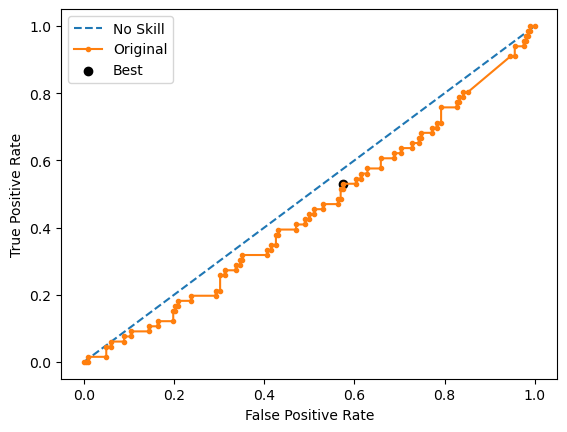

Ave Test G-mean: 0.5214864883818333
Stdev Test G-mean: 0.026317595354782956
Ave Test Specificity: 0.5643564356435644
Ave Test Recall: 0.4878787878787879
Ave Test NPV: 0.7720206747682841
Ave Test Accuracy: 0.5455223880597014
Ave Test Precision: 0.2673880462672968
Ave Test F1-Score: 0.344334146128061
Ave Runtime: 0.3679812431335449


In [255]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [256]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 14, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5616302635069764
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=14))])
Mean Train Score (G-mean) 0.6886934920016934
Std Train Score (G-mean) 0.014052201123921772
GridSearchCV Runtime: 117.2994921207428 secs
Run 1 - Random State: 0
Test G-mean: 0.5545545537413857
Run 2 - Random State: 1
Test G-mean: 0.5148558124861417
Run 3 - Random State: 2
Test G-mean: 0.5405129188294597
Run 4 - Random State: 3
Test G-mean: 0.5664645515906718
Run 5 - Random State: 4
Test G-mean: 0.495251983794861
Ave Test G-mean: 0.534327964088504
Stdev Test G-mean: 0.02909564303445095
Ave Test Specificity: 

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5923832184748289
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7420279935572658
Std Train Score (G-mean) 0.02116929085852266
GridSearchCV Runtime: 45.67667579650879 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.527040, G-Mean=0.690


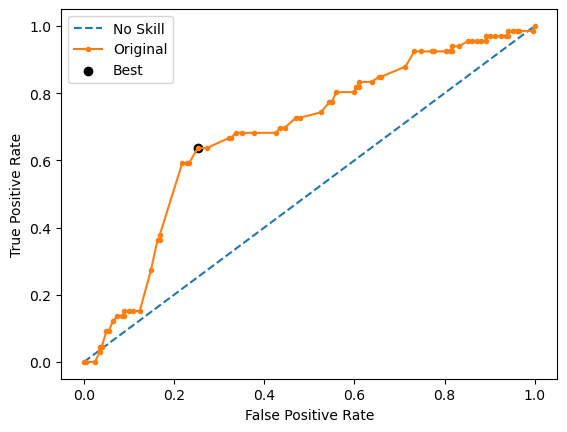

Run 2 - Random State: 1
Test G-mean: 0.6224859427126748
Best Threshold=0.515278, G-Mean=0.642


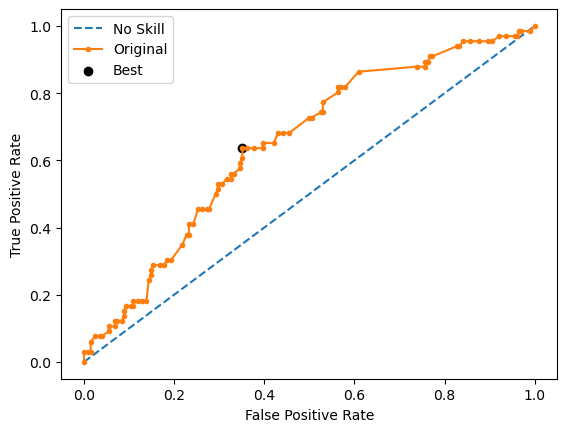

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.534545, G-Mean=0.587


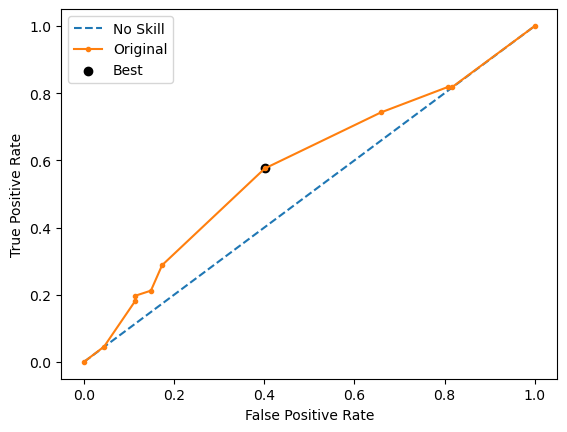

Run 4 - Random State: 3
Test G-mean: 0.6374877560109734
Best Threshold=0.527584, G-Mean=0.665


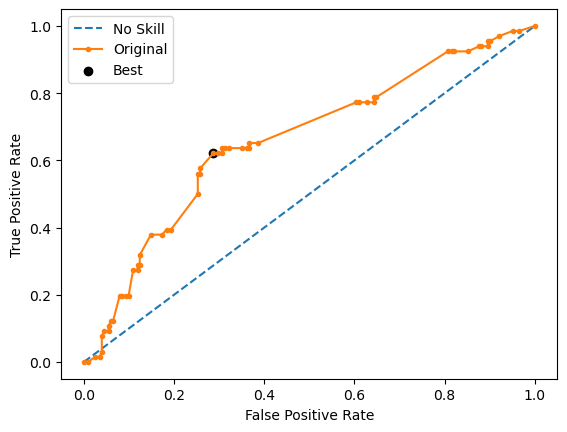

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


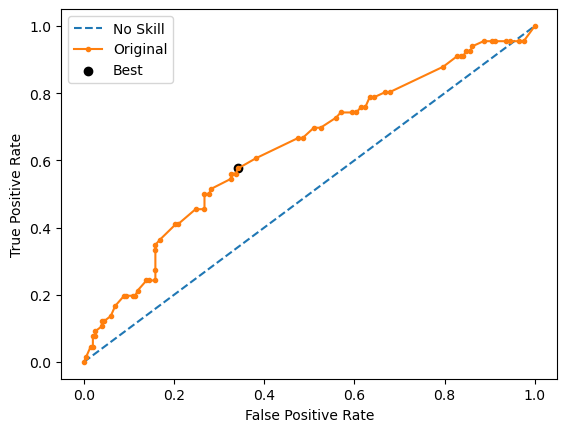

Ave Test G-mean: 0.6213187062333223
Stdev Test G-mean: 0.023230156834298615
Ave Test Specificity: 0.6158415841584158
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8349878938043582
Ave Test Accuracy: 0.6186567164179103
Ave Test Precision: 0.3478773121660482
Ave Test F1-Score: 0.4474892031398528
Ave Runtime: 0.3838043689727783


In [258]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6020912873576488
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9436587297011378
Std Train Score (G-mean) 0.004484499732313889
GridSearchCV Runtime: 12.505472421646118 secs
Run 1 - Random State: 0
Test G-mean: 0.596896664895069
Best Threshold=0.731059, G-Mean=0.597


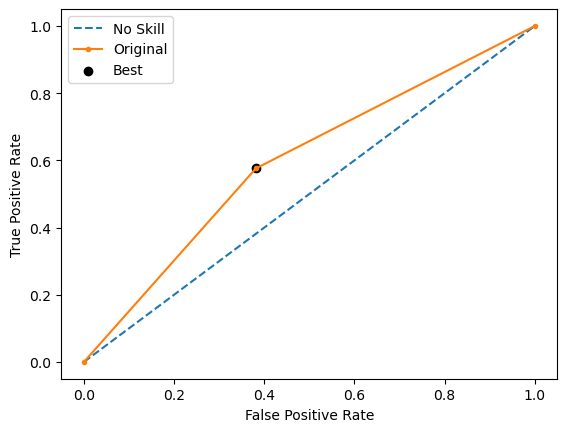

Run 2 - Random State: 1
Test G-mean: 0.5757891569970136
Best Threshold=0.731059, G-Mean=0.576


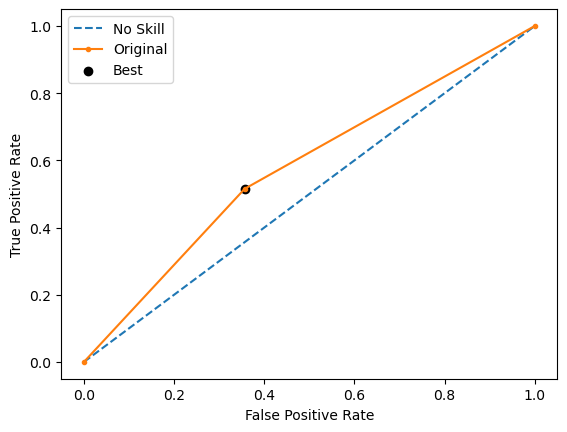

Run 3 - Random State: 2
Test G-mean: 0.5518427792816578
Best Threshold=0.731059, G-Mean=0.552


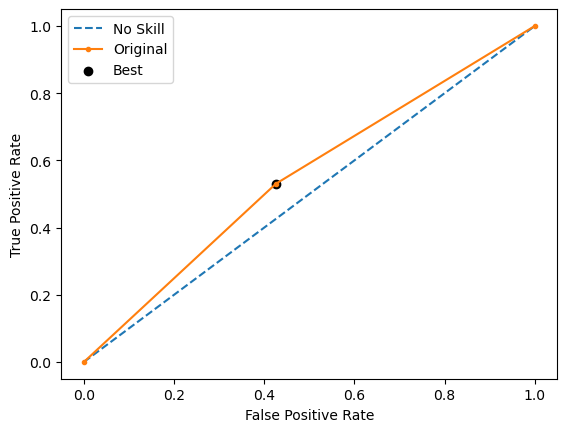

Run 4 - Random State: 3
Test G-mean: 0.5682493209226676
Best Threshold=0.731059, G-Mean=0.568


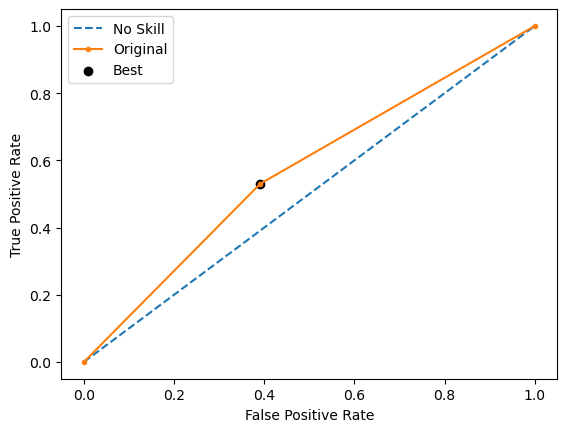

Run 5 - Random State: 4
Test G-mean: 0.58458033957476
Best Threshold=0.731059, G-Mean=0.585


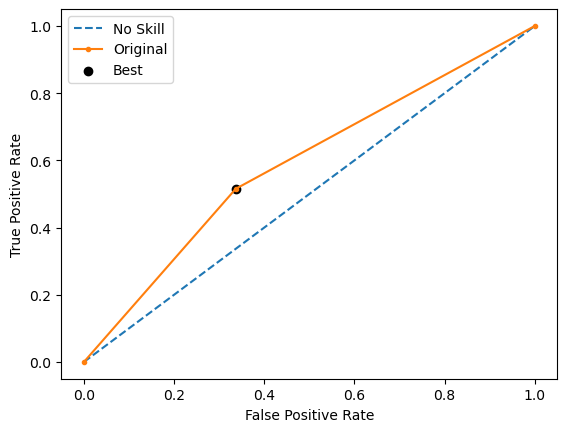

Ave Test G-mean: 0.5754716523342337
Stdev Test G-mean: 0.016974877528584738
Ave Test Specificity: 0.6217821782178218
Ave Test Recall: 0.5333333333333333
Ave Test NPV: 0.8029016920954419
Ave Test Accuracy: 0.6
Ave Test Precision: 0.3161593150259835
Ave Test F1-Score: 0.3966441368849332
Ave Runtime: 0.26468625068664553


In [259]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5820526945931113
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8829407400855935
Std Train Score (G-mean) 0.010635227990922288
GridSearchCV Runtime: 147.33878827095032 secs
Run 1 - Random State: 0
Test G-mean: 0.5650725003865162
Best Threshold=0.373778, G-Mean=0.622


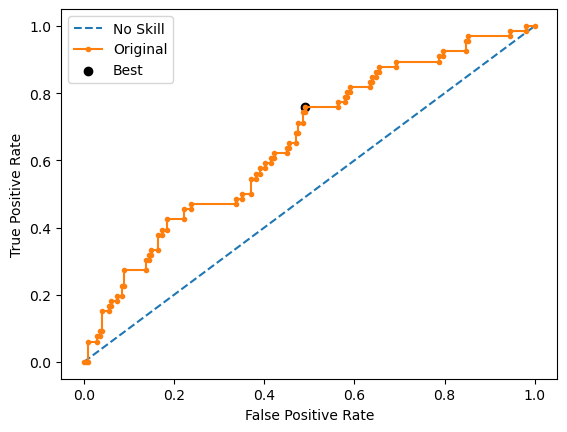

Run 2 - Random State: 1
Test G-mean: 0.5347930444200224
Best Threshold=0.434090, G-Mean=0.562


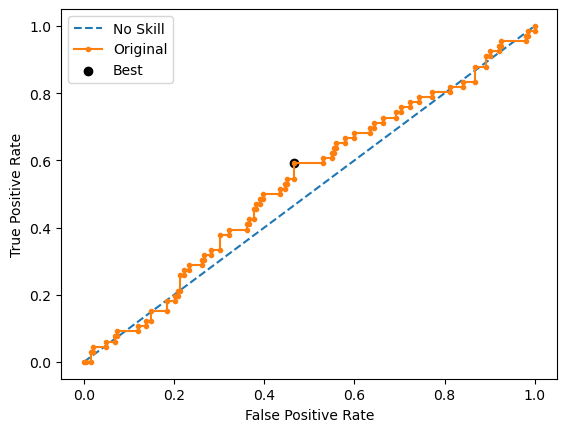

Run 3 - Random State: 2
Test G-mean: 0.6082244599647156
Best Threshold=0.514068, G-Mean=0.608


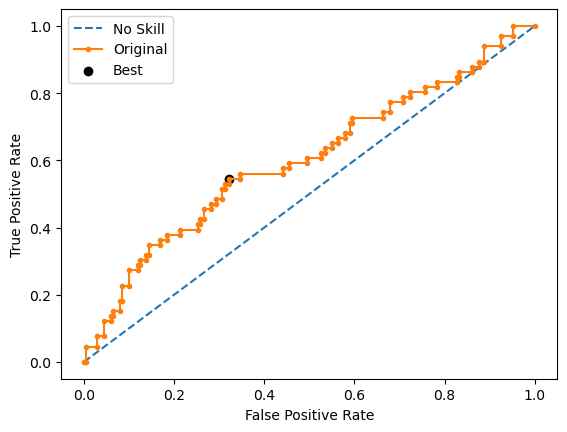

Run 4 - Random State: 3
Test G-mean: 0.541898851665644
Best Threshold=0.355166, G-Mean=0.584


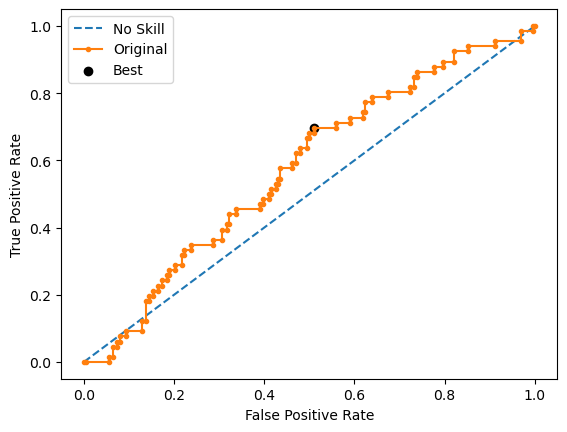

Run 5 - Random State: 4
Test G-mean: 0.5324738048348328
Best Threshold=0.431802, G-Mean=0.600


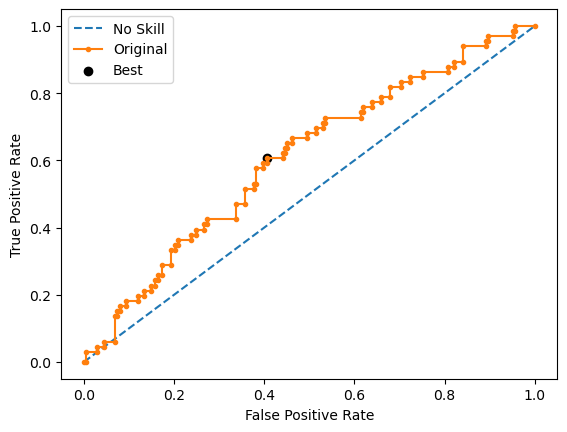

Ave Test G-mean: 0.5564925322543463
Stdev Test G-mean: 0.031664454637771115
Ave Test Specificity: 0.6524752475247525
Ave Test Recall: 0.47575757575757577
Ave Test NPV: 0.7920734264262264
Ave Test Accuracy: 0.608955223880597
Ave Test Precision: 0.30927895110762316
Ave Test F1-Score: 0.374596432074146
Ave Runtime: 0.6857966423034668


In [260]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.594776223443463
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
       

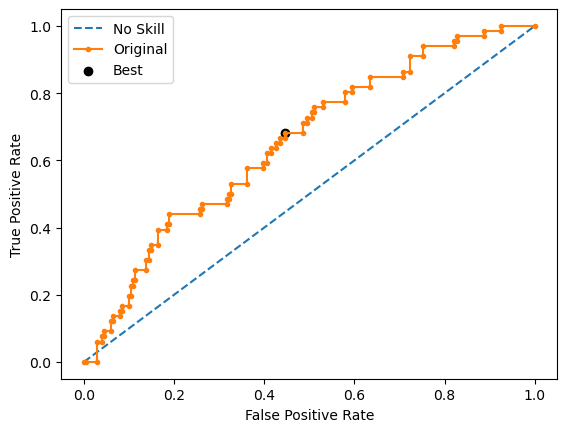

Run 2 - Random State: 1
Test G-mean: 0.5455545462887259
Best Threshold=0.390412, G-Mean=0.577


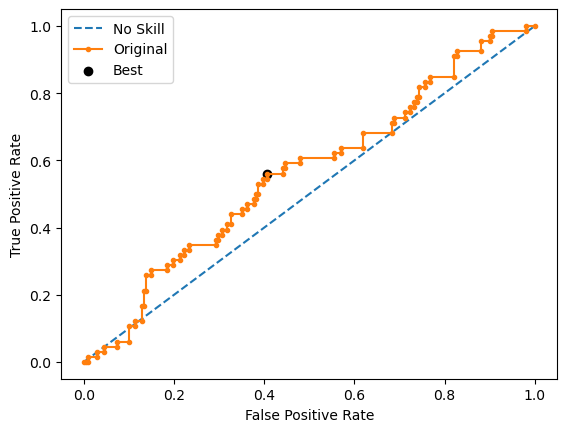

Run 3 - Random State: 2
Test G-mean: 0.60296049301394
Best Threshold=0.345868, G-Mean=0.610


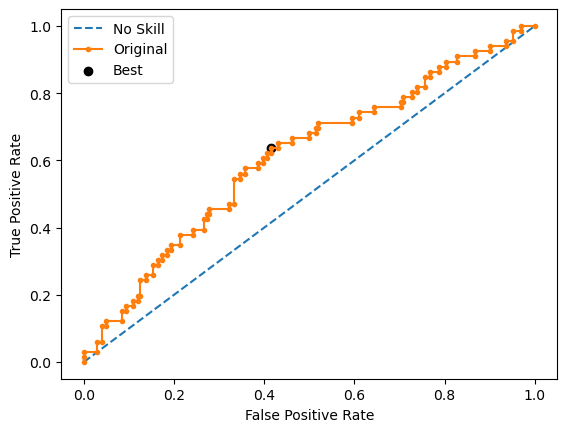

Run 4 - Random State: 3
Test G-mean: 0.5776100443520124
Best Threshold=0.746747, G-Mean=0.614


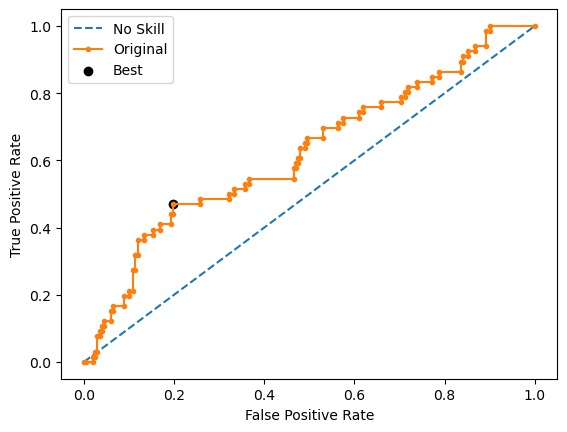

Run 5 - Random State: 4
Test G-mean: 0.5228788963364495
Best Threshold=0.370161, G-Mean=0.577


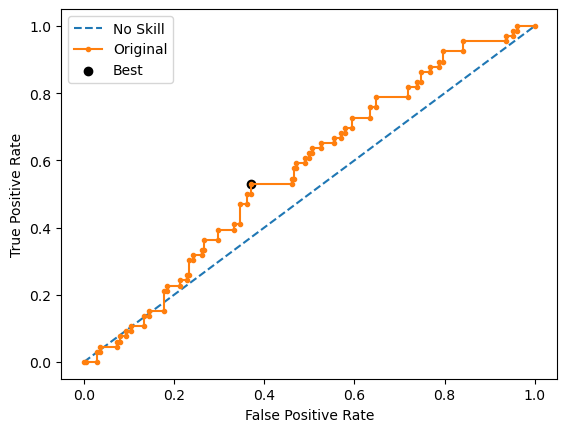

Ave Test G-mean: 0.5671267374504626
Stdev Test G-mean: 0.032394268272267525
Ave Test Specificity: 0.6742574257425742
Ave Test Recall: 0.4787878787878788
Ave Test NPV: 0.7984199040153084
Ave Test Accuracy: 0.6261194029850746
Ave Test Precision: 0.3253225435999957
Ave Test F1-Score: 0.38669440203548416
Ave Runtime: 0.3103505611419678


In [261]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6016644629517163
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6227262963253994
Std Train Score (G-mean) 0.022477704456260326
GridSearchCV Runtime: 392.5867874622345 secs
Run 1 - Random State: 0
Test G-mean: 0.6467161851866847
Best Threshold=0.504757, G-Mean=0.653


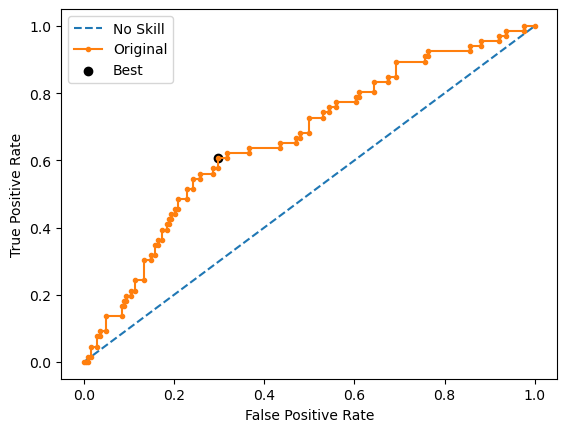

Run 2 - Random State: 1
Test G-mean: 0.563610473355994
Best Threshold=0.477636, G-Mean=0.573


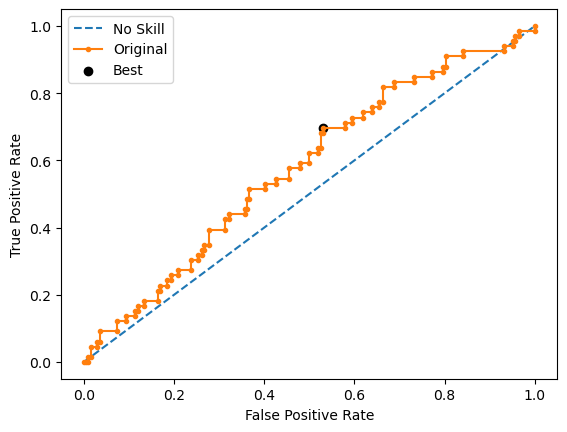

Run 3 - Random State: 2
Test G-mean: 0.6074840769027358
Best Threshold=0.503476, G-Mean=0.619


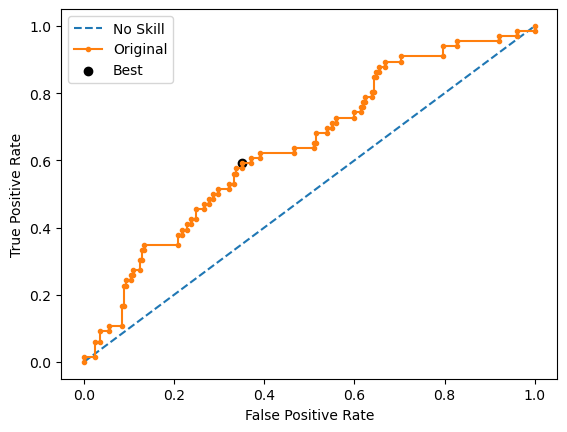

Run 4 - Random State: 3
Test G-mean: 0.6500132704223603
Best Threshold=0.508920, G-Mean=0.665


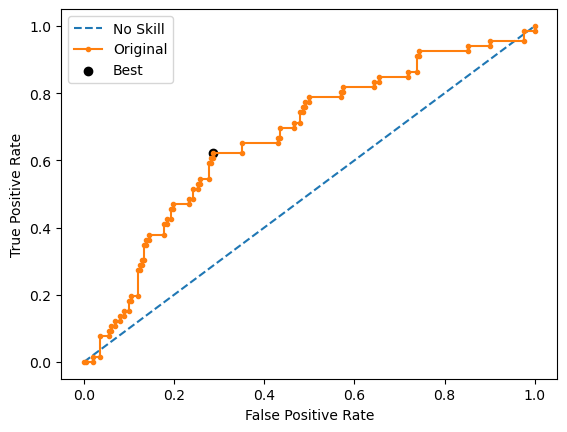

Run 5 - Random State: 4
Test G-mean: 0.584452015494721
Best Threshold=0.476340, G-Mean=0.612


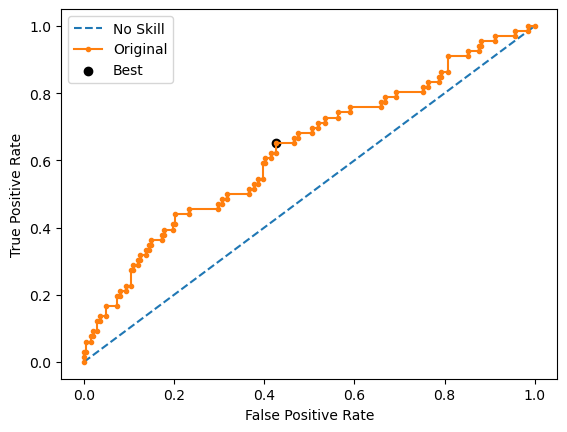

Ave Test G-mean: 0.6104552042724991
Stdev Test G-mean: 0.037944438240259996
Ave Test Specificity: 0.6425742574257426
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8247886757374111
Ave Test Accuracy: 0.6276119402985074
Ave Test Precision: 0.3476870659658312
Ave Test F1-Score: 0.43474440191841524
Ave Runtime: 0.5993012905120849


In [262]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6925932	total: 3.02ms	remaining: 3.01s
1:	learn: 0.6915944	total: 5.72ms	remaining: 2.85s
2:	learn: 0.6907981	total: 8.29ms	remaining: 2.75s
3:	learn: 0.6899970	total: 11ms	remaining: 2.73s
4:	learn: 0.6889704	total: 13.6ms	remaining: 2.7s
5:	learn: 0.6878691	total: 16.1ms	remaining: 2.67s
6:	learn: 0.6866138	total: 18.7ms	remaining: 2.65s
7:	learn: 0.6859139	total: 21ms	remaining: 2.6s
8:	learn: 0.6848884	total: 23.4ms	remaining: 2.58s
9:	learn: 0.6836013	total: 25.9ms	remaining: 2.57s
10:	learn: 0.6821693	total: 28.7ms	remaining: 2.58s
11:	learn: 0.6817355	total: 31.1ms	remaining: 2.56s
12:	learn: 0.6805076	total: 33.5ms	remaining: 2.54s
13:	learn: 0.6794318	total: 36.1ms	remaining: 2.54s
14:	learn: 0.6788873	total: 38.7ms	remaining: 2.54s
15:	learn: 0.6779862	total: 41.2ms	remaining: 2.53s
16:	learn: 0.6769858	total: 44.1ms	remaining: 2.55s
17:	learn: 0.6760934	total: 46.8ms	remain

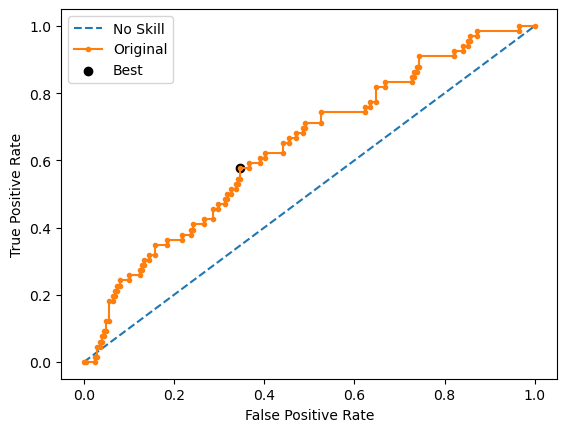

Learning rate set to 0.006922
0:	learn: 0.6917757	total: 3.66ms	remaining: 3.66s
1:	learn: 0.6907574	total: 6.14ms	remaining: 3.07s
2:	learn: 0.6899608	total: 8.73ms	remaining: 2.9s
3:	learn: 0.6885274	total: 11.5ms	remaining: 2.85s
4:	learn: 0.6877070	total: 14ms	remaining: 2.78s
5:	learn: 0.6868436	total: 16.6ms	remaining: 2.75s
6:	learn: 0.6854144	total: 19.1ms	remaining: 2.71s
7:	learn: 0.6841373	total: 21.5ms	remaining: 2.67s
8:	learn: 0.6827903	total: 24.1ms	remaining: 2.65s
9:	learn: 0.6816773	total: 26.5ms	remaining: 2.63s
10:	learn: 0.6802913	total: 28.8ms	remaining: 2.59s
11:	learn: 0.6790553	total: 31.4ms	remaining: 2.58s
12:	learn: 0.6782002	total: 33.9ms	remaining: 2.58s
13:	learn: 0.6771877	total: 36.5ms	remaining: 2.57s
14:	learn: 0.6758085	total: 38.8ms	remaining: 2.55s
15:	learn: 0.6743024	total: 41.4ms	remaining: 2.55s
16:	learn: 0.6727772	total: 44ms	remaining: 2.54s
17:	learn: 0.6723835	total: 46.3ms	remaining: 2.53s
18:	learn: 0.6711152	total: 48.9ms	remaining: 2.5

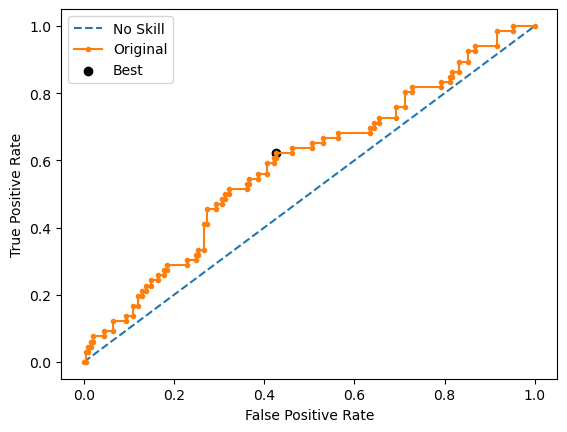

Learning rate set to 0.006922
0:	learn: 0.6915608	total: 2.64ms	remaining: 2.63s
1:	learn: 0.6891043	total: 5.35ms	remaining: 2.67s
2:	learn: 0.6877437	total: 7.9ms	remaining: 2.63s
3:	learn: 0.6859936	total: 10.4ms	remaining: 2.6s
4:	learn: 0.6848356	total: 13ms	remaining: 2.6s
5:	learn: 0.6837831	total: 15.4ms	remaining: 2.55s
6:	learn: 0.6822884	total: 17.7ms	remaining: 2.51s
7:	learn: 0.6811639	total: 20.1ms	remaining: 2.49s
8:	learn: 0.6797561	total: 22.7ms	remaining: 2.5s
9:	learn: 0.6786867	total: 25.2ms	remaining: 2.49s
10:	learn: 0.6777130	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6771724	total: 30.3ms	remaining: 2.5s
12:	learn: 0.6759269	total: 32.8ms	remaining: 2.49s
13:	learn: 0.6743493	total: 35.2ms	remaining: 2.48s
14:	learn: 0.6731938	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6728976	total: 40.4ms	remaining: 2.48s
16:	learn: 0.6712511	total: 43ms	remaining: 2.48s
17:	learn: 0.6699981	total: 45.4ms	remaining: 2.48s
18:	learn: 0.6688468	total: 47.8ms	remaining: 2.47s
1

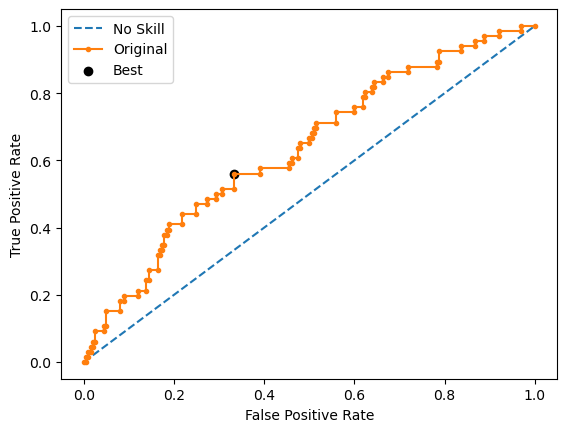

Learning rate set to 0.006922
0:	learn: 0.6922818	total: 2.8ms	remaining: 2.8s
1:	learn: 0.6910777	total: 5.41ms	remaining: 2.7s
2:	learn: 0.6898807	total: 7.77ms	remaining: 2.58s
3:	learn: 0.6889244	total: 10.2ms	remaining: 2.53s
4:	learn: 0.6879907	total: 12.7ms	remaining: 2.52s
5:	learn: 0.6867908	total: 15ms	remaining: 2.49s
6:	learn: 0.6857551	total: 17.5ms	remaining: 2.49s
7:	learn: 0.6846771	total: 19.9ms	remaining: 2.47s
8:	learn: 0.6838094	total: 22.2ms	remaining: 2.44s
9:	learn: 0.6831921	total: 24.7ms	remaining: 2.44s
10:	learn: 0.6820158	total: 27.1ms	remaining: 2.43s
11:	learn: 0.6807095	total: 29.7ms	remaining: 2.44s
12:	learn: 0.6797208	total: 32.3ms	remaining: 2.45s
13:	learn: 0.6781180	total: 34.9ms	remaining: 2.45s
14:	learn: 0.6774925	total: 37.1ms	remaining: 2.44s
15:	learn: 0.6767942	total: 39.8ms	remaining: 2.44s
16:	learn: 0.6758322	total: 42.1ms	remaining: 2.43s
17:	learn: 0.6749166	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6740625	total: 46.8ms	remaining: 2.4

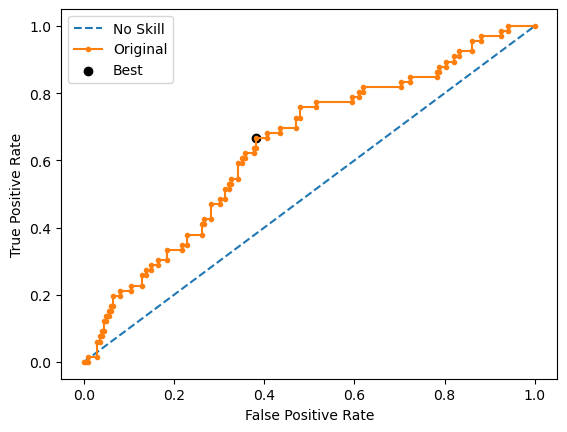

Learning rate set to 0.006922
0:	learn: 0.6918770	total: 3.03ms	remaining: 3.03s
1:	learn: 0.6908344	total: 5.73ms	remaining: 2.86s
2:	learn: 0.6898347	total: 8.16ms	remaining: 2.71s
3:	learn: 0.6889398	total: 10.7ms	remaining: 2.66s
4:	learn: 0.6877485	total: 13.2ms	remaining: 2.62s
5:	learn: 0.6863435	total: 15.8ms	remaining: 2.61s
6:	learn: 0.6851576	total: 18.2ms	remaining: 2.59s
7:	learn: 0.6840617	total: 20.7ms	remaining: 2.56s
8:	learn: 0.6824181	total: 22.9ms	remaining: 2.53s
9:	learn: 0.6812613	total: 25.4ms	remaining: 2.51s
10:	learn: 0.6794770	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6782449	total: 30.3ms	remaining: 2.49s
12:	learn: 0.6774971	total: 32.9ms	remaining: 2.5s
13:	learn: 0.6764224	total: 35.4ms	remaining: 2.49s
14:	learn: 0.6747983	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6737534	total: 40.2ms	remaining: 2.47s
16:	learn: 0.6723031	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6708492	total: 45.2ms	remaining: 2.47s
18:	learn: 0.6697755	total: 47.7ms	remaining:

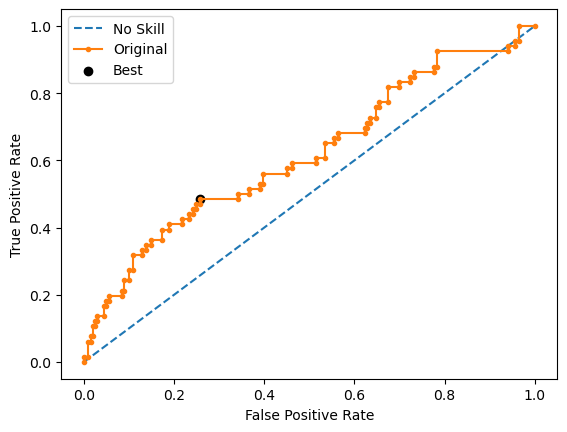

Ave Test G-mean: 0.5978506203204994
Stdev Test G-mean: 0.026702887539368426
Ave Test Specificity: 0.6227722772277228
Ave Test Recall: 0.5757575757575757
Ave Test NPV: 0.8185451642933618
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.33207704455584613
Ave Test F1-Score: 0.4209373515085228
Ave Runtime: 2.6942410469055176


In [263]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [264]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.624353,0.024813,0.594305,0.504684,0.619802,0.630303
6,LightGBM,0.621319,0.023230,0.592383,0.742028,0.615842,0.627273
4,Random Forest,0.610455,0.037944,0.601664,0.622726,0.642574,0.581818
2,Logistic Regression,0.583291,0.021799,0.602886,NaN,0.634653,0.539394
8,AdaBoost,0.575472,0.016975,0.602091,0.943659,0.621782,0.533333
7,Extreme Gradient Boosting (XGBoost),0.567127,0.032394,0.594776,0.850648,0.674257,0.478788
5,Gradient Boosting Machine (GBM),0.556493,0.031664,0.582053,0.882941,0.652475,0.475758
0,k-Nearest Neighbors,0.534328,0.029096,0.561630,0.688693,0.550495,0.527273
1,SVM Classifier,0.521486,0.026318,0.525757,0.252068,0.564356,0.487879


# HO-T08 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5966131815002639
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=3,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) 0.5520784197104317
Std Train Score (G-mean) 0.049809375846590453
GridSearchCV Runtime: 66.08575892448425 secs
Run 1 - Random State: 0
Test G-mean: 0.6547273224684294
Best Threshold=0.582692, G-Mean=0.663


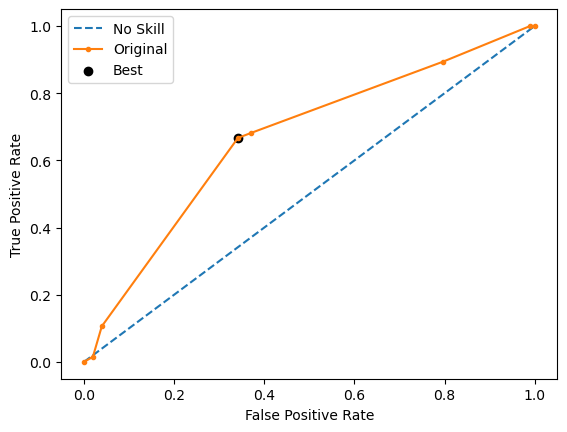

Run 2 - Random State: 1
Test G-mean: 0.596016378594041
Best Threshold=0.655556, G-Mean=0.596


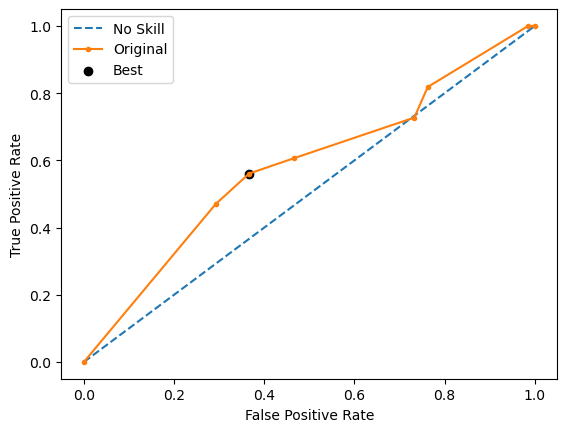

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.612648, G-Mean=0.587


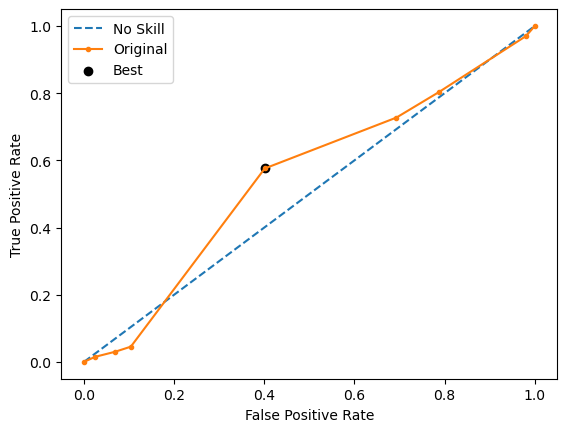

Run 4 - Random State: 3
Test G-mean: 0.6371346749780661
Best Threshold=0.592937, G-Mean=0.637


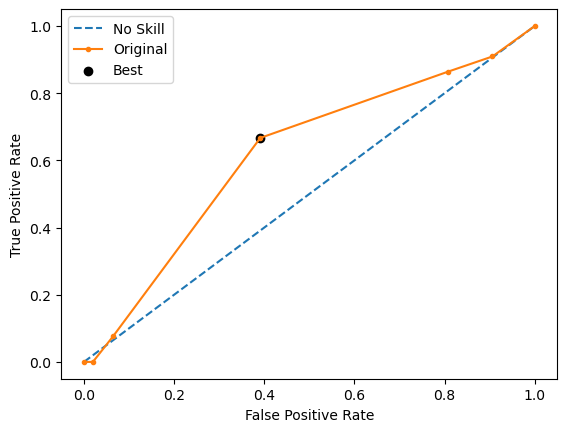

Run 5 - Random State: 4
Test G-mean: 0.5996548662321182
Best Threshold=0.564576, G-Mean=0.600


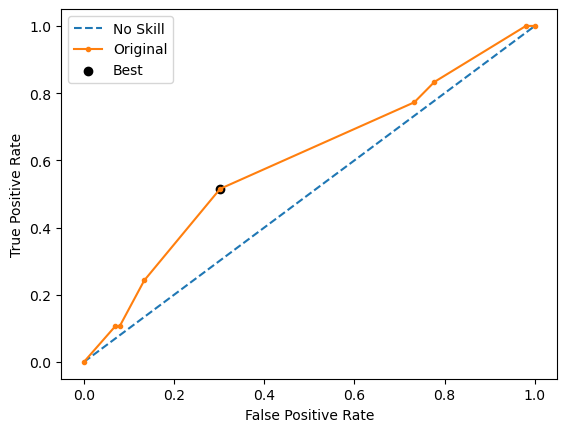

Ave Test G-mean: 0.6149603820603801
Stdev Test G-mean: 0.029296219567977642
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8297560066055503
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.34865587570072953
Ave Test F1-Score: 0.4401459177307229
Ave Runtime: 0.025896835327148437


In [281]:
ho_t08_dt_gs, ho_t08_dt_be, ho_t08_dt_model_info, ho_t08_dt_metrics_df = dt_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 100.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6078975550078626
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=100.0, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 52.069857358932495 secs
Run 1 - Random State: 0
Test G-mean: 0.6188604841399094
Best Threshold=0.512718, G-Mean=0.634


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


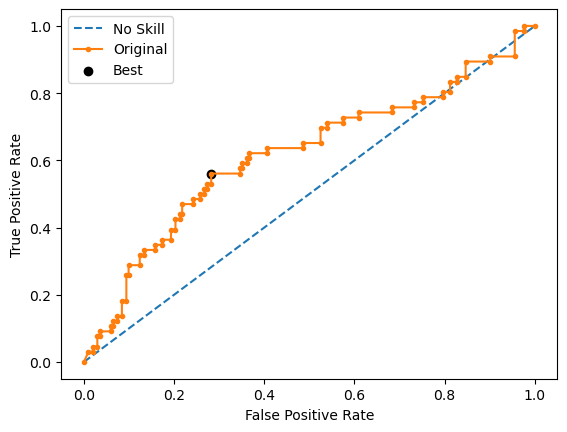

Run 2 - Random State: 1
Test G-mean: 0.5763099975892594
Best Threshold=0.494359, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


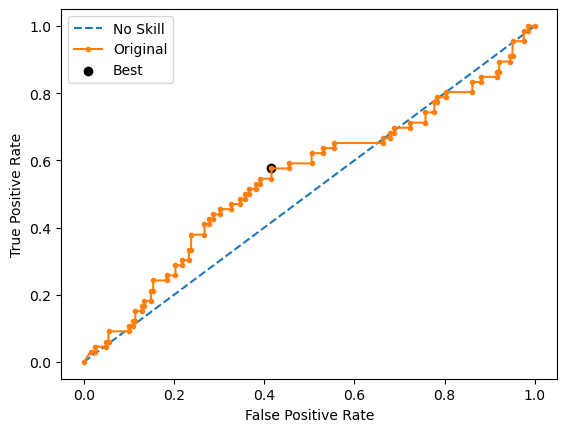

Run 3 - Random State: 2
Test G-mean: 0.6150307523064422
Best Threshold=0.499350, G-Mean=0.620


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


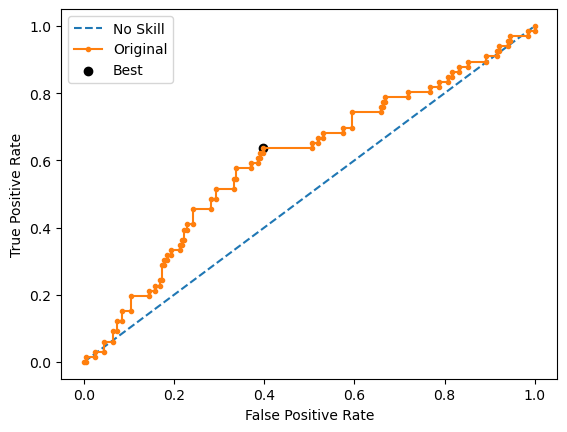

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.497402, G-Mean=0.592


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


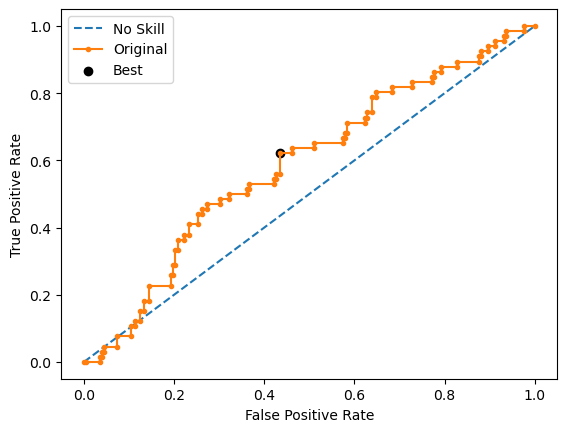

Run 5 - Random State: 4
Test G-mean: 0.560273496284684
Best Threshold=0.486683, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


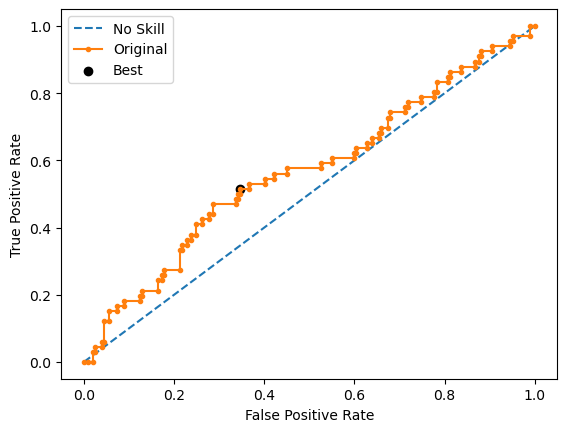

Ave Test G-mean: 0.5865905705414255
Stdev Test G-mean: 0.028416016593412613
Ave Test Specificity: 0.6267326732673267
Ave Test Recall: 0.5515151515151515
Ave Test NPV: 0.8105340798718748
Ave Test Accuracy: 0.6082089552238805
Ave Test Precision: 0.3266746618406295
Ave Test F1-Score: 0.4094494756438197
Ave Runtime: 0.369551420211792


In [282]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5271837717242484
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.25173061573833866
Std Train Score (G-mean) 0.05385039016863185
GridSearchCV Runtime: 118.15375328063965 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5470648297896689
Best Threshold=0.494878, G-Mean=0.567


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


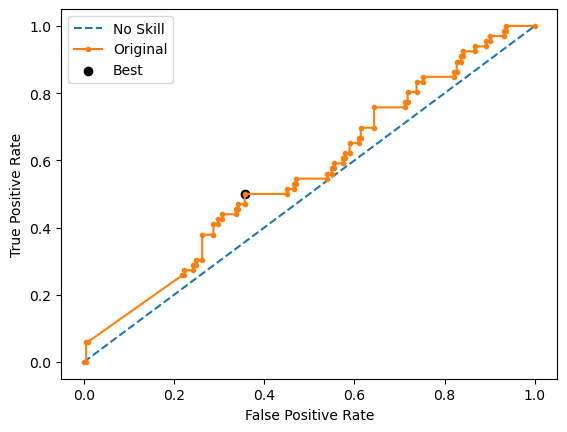

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.50714960324544
Best Threshold=0.521705, G-Mean=0.293


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


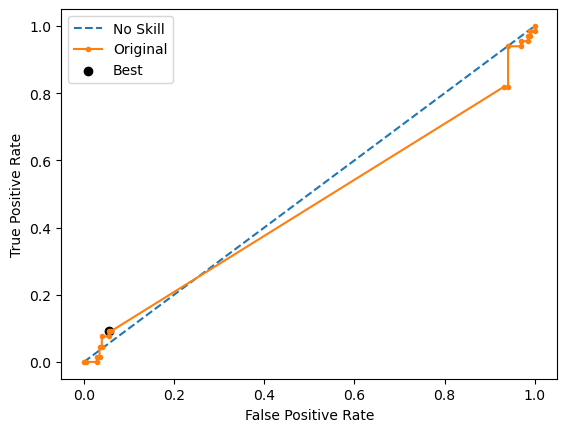

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.5199298344039033
Best Threshold=0.519037, G-Mean=0.401


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


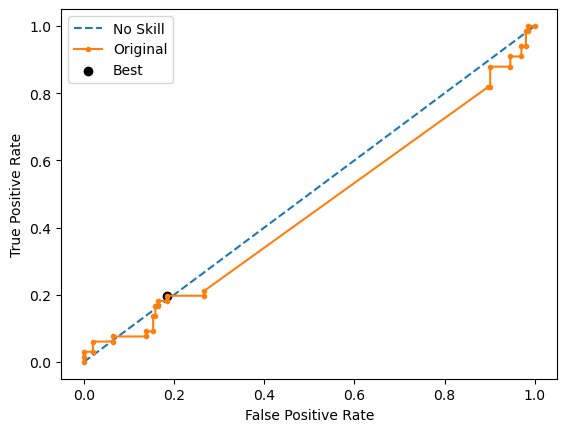

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.4756286600513327
Best Threshold=0.500000, G-Mean=0.118


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


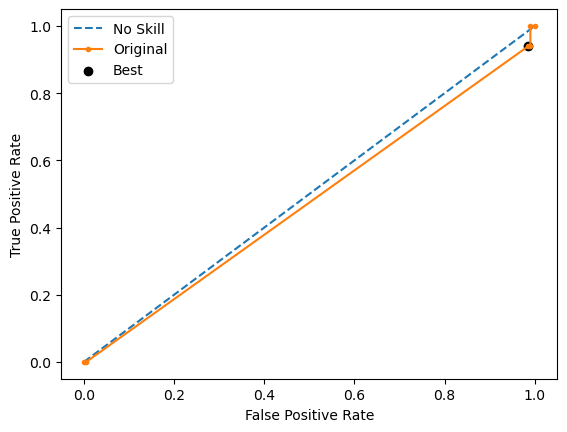

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5391929829915173
Best Threshold=0.493064, G-Mean=0.287


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


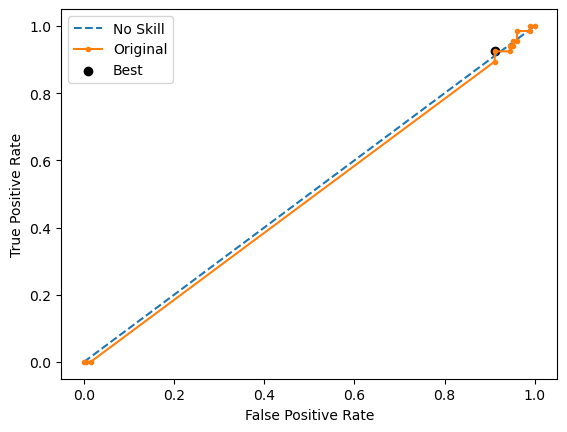

Ave Test G-mean: 0.5177931820963725
Stdev Test G-mean: 0.02833054363296901
Ave Test Specificity: 0.5900990099009901
Ave Test Recall: 0.45757575757575764
Ave Test NPV: 0.7689140185823027
Ave Test Accuracy: 0.5574626865671642
Ave Test Precision: 0.2680212057309454
Ave Test F1-Score: 0.3371681339390776
Ave Runtime: 0.060284757614135744


In [283]:
ho_t08_svm_gs, ho_t08_svm_be, ho_t08_svm_model_info, ho_t08_svm_metrics_df = svm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [284]:
ho_t08_knn_gs, ho_t08_knn_be, ho_t08_knn_model_info, ho_t08_knn_metrics_df = knn_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 3, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5594153075270116
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=3))])
Mean Train Score (G-mean) 0.686828076239181
Std Train Score (G-mean) 0.01544186972704155
GridSearchCV Runtime: 77.13261294364929 secs
Run 1 - Random State: 0
Test G-mean: 0.5682493209226677
Run 2 - Random State: 1
Test G-mean: 0.487004843273388
Run 3 - Random State: 2
Test G-mean: 0.5098048549190267
Run 4 - Random State: 3
Test G-mean: 0.4846116845975599
Run 5 - Random State: 4
Test G-mean: 0.5447289903863175
Ave Test G-mean: 0.5188799388197919
Stdev Test G-mean: 0.036668111034816334
Ave Test Specificity: 0.4851

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5965566786253891
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7460883092264341
Std Train Score (G-mean) 0.01766791496110193
GridSearchCV Runtime: 38.253618001937866 secs
Run 1 - Random State: 0
Test G-mean: 0.6575281243592797
Best Threshold=0.526146, G-Mean=0.684


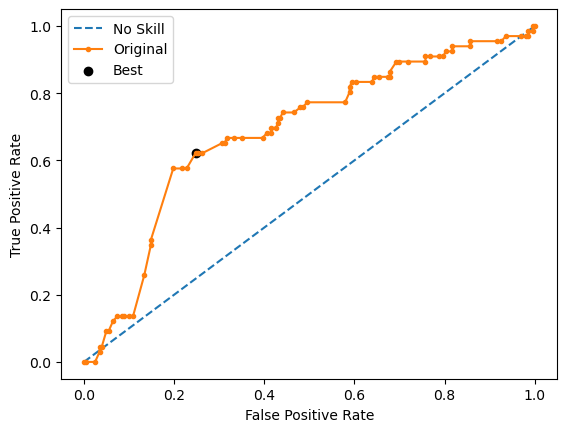

Run 2 - Random State: 1
Test G-mean: 0.6247111543766769
Best Threshold=0.507078, G-Mean=0.632


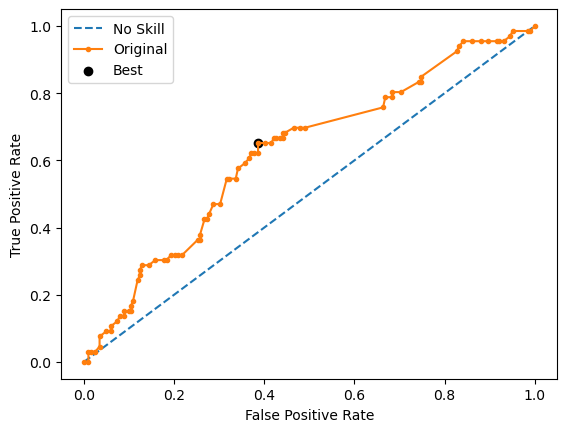

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.533153, G-Mean=0.587


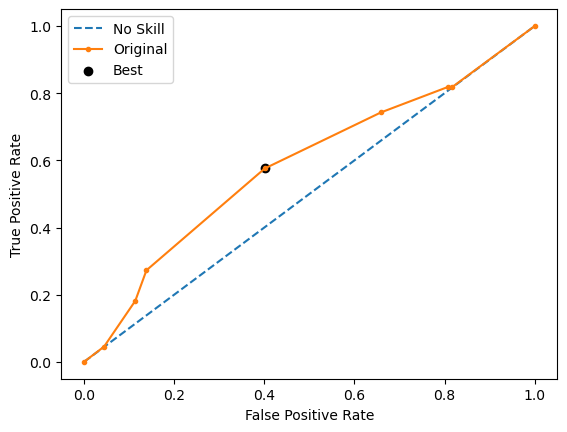

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.503032, G-Mean=0.663


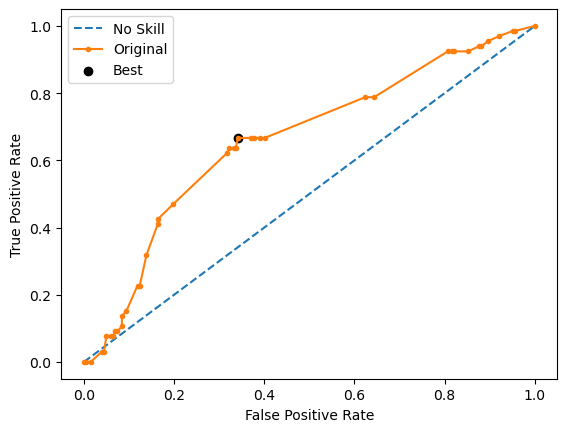

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


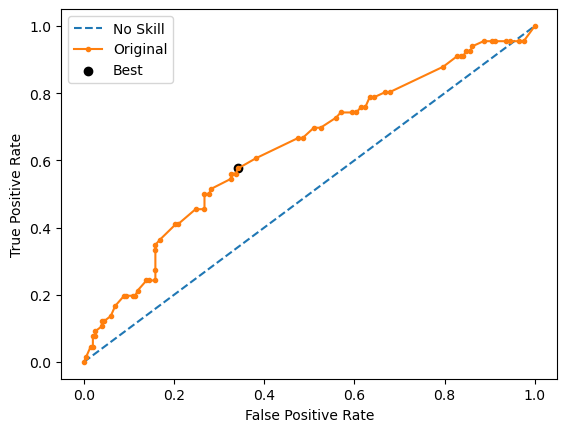

Ave Test G-mean: 0.6258645414318889
Stdev Test G-mean: 0.02801359494945503
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.6333333333333333
Ave Test NPV: 0.8377462055684683
Ave Test Accuracy: 0.6223880597014925
Ave Test Precision: 0.3520677722666008
Ave Test F1-Score: 0.4524928761366155
Ave Runtime: 0.36489238739013674


In [285]:
ho_t08_lgbm_gs, ho_t08_lgbm_be, ho_t08_lgbm_model_info, ho_t08_lgbm_metrics_df = lgbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5684631509057696
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9439618467435441
Std Train Score (G-mean) 0.004924049647730128
GridSearchCV Runtime: 10.690007209777832 secs
Run 1 - Random State: 0
Test G-mean: 0.6150307523064422
Best Threshold=0.731059, G-Mean=0.615


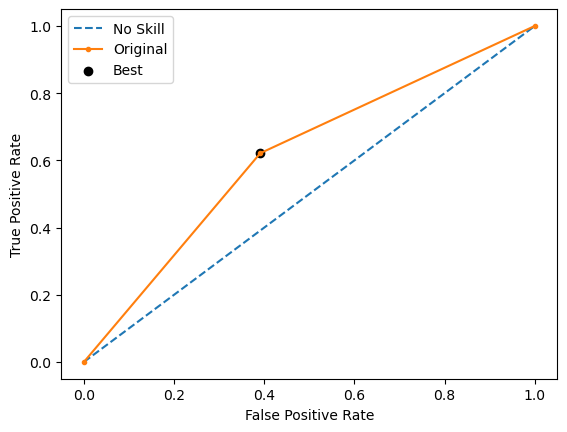

Run 2 - Random State: 1
Test G-mean: 0.5866297072611855
Best Threshold=0.731059, G-Mean=0.587


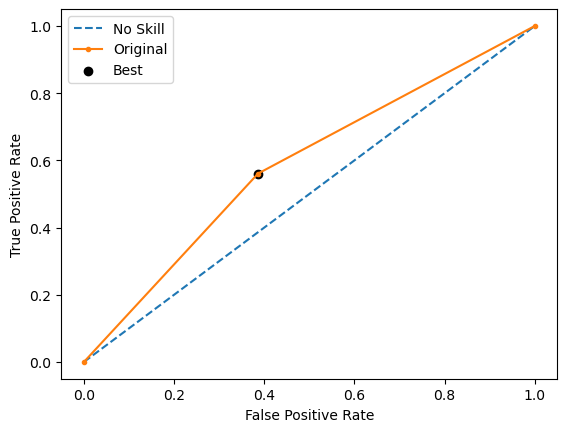

Run 3 - Random State: 2
Test G-mean: 0.5705546014671388
Best Threshold=0.731059, G-Mean=0.571


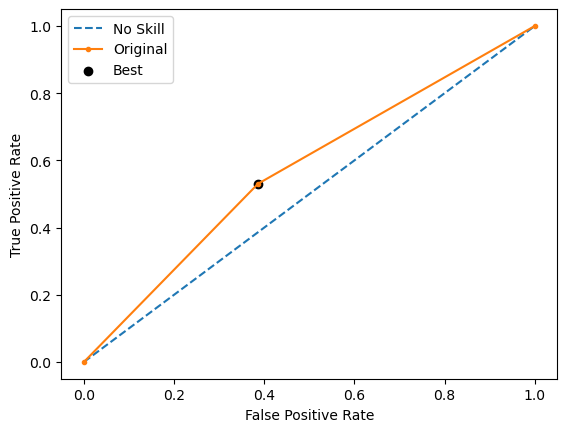

Run 4 - Random State: 3
Test G-mean: 0.5945042838654349
Best Threshold=0.731059, G-Mean=0.595


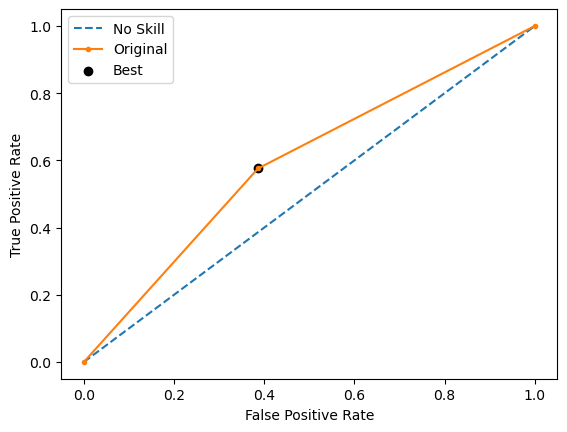

Run 5 - Random State: 4
Test G-mean: 0.5841952827718153
Best Threshold=0.731059, G-Mean=0.584


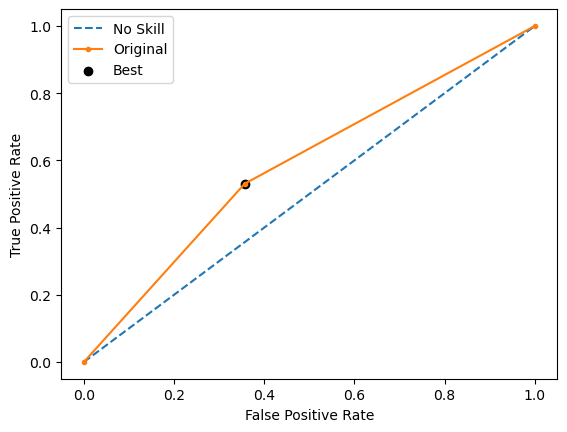

Ave Test G-mean: 0.5901829255344033
Stdev Test G-mean: 0.01635418115312937
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.5636363636363636
Ave Test NPV: 0.812956297450846
Ave Test Accuracy: 0.6052238805970149
Ave Test Precision: 0.325565864202131
Ave Test F1-Score: 0.41259362832246393
Ave Runtime: 0.24993081092834474


In [286]:
ho_t08_adaboost_gs, ho_t08_adaboost_be, ho_t08_adaboost_model_info, ho_t08_adaboost_metrics_df = adaboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5554183683577887
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8739859712005135
Std Train Score (G-mean) 0.010264201605379183
GridSearchCV Runtime: 95.3643696308136 secs
Run 1 - Random State: 0
Test G-mean: 0.5705546014671388
Best Threshold=0.317432, G-Mean=0.606


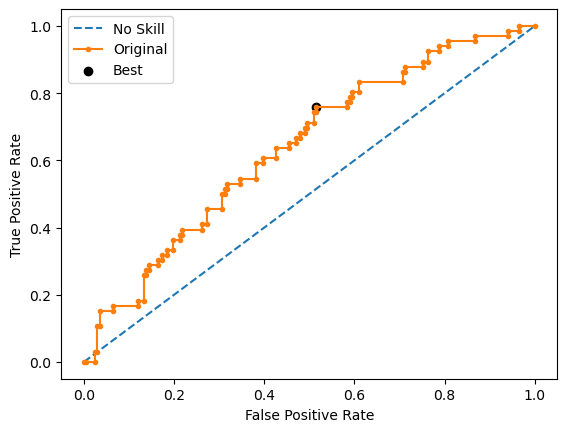

Run 2 - Random State: 1
Test G-mean: 0.5412756210377417
Best Threshold=0.352152, G-Mean=0.557


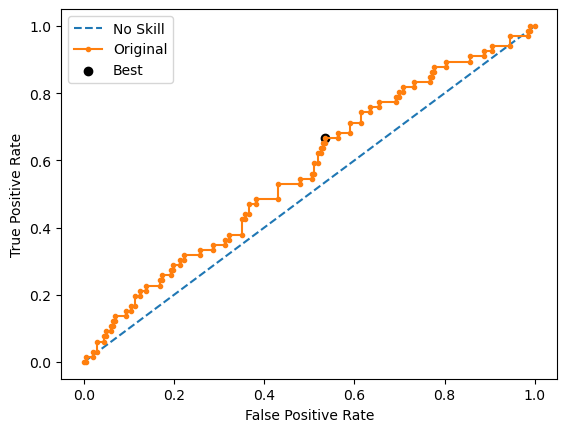

Run 3 - Random State: 2
Test G-mean: 0.5997174051973226
Best Threshold=0.461918, G-Mean=0.606


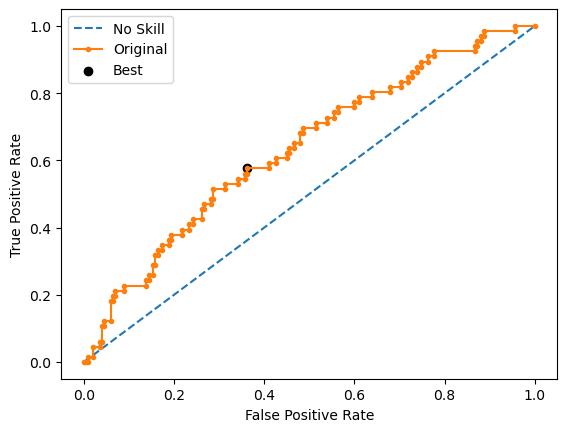

Run 4 - Random State: 3
Test G-mean: 0.5285148368714726
Best Threshold=0.386964, G-Mean=0.562


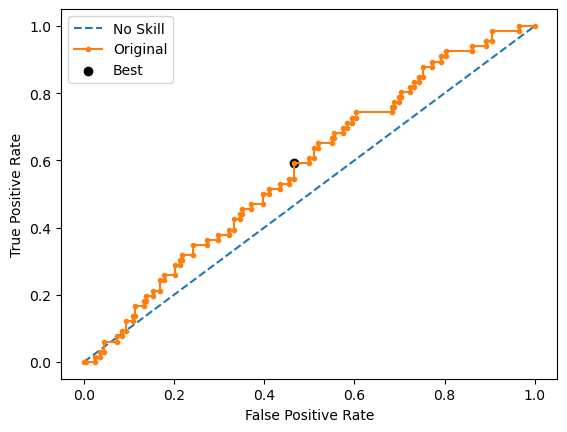

Run 5 - Random State: 4
Test G-mean: 0.5632776652529525
Best Threshold=0.553565, G-Mean=0.575


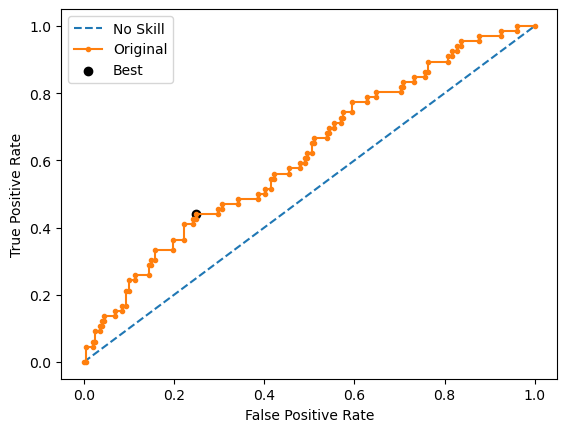

Ave Test G-mean: 0.5606680259653257
Stdev Test G-mean: 0.02756493038513496
Ave Test Specificity: 0.6702970297029702
Ave Test Recall: 0.4696969696969697
Ave Test NPV: 0.7944945666795336
Ave Test Accuracy: 0.6208955223880597
Ave Test Precision: 0.31827661659726403
Ave Test F1-Score: 0.37914584882009894
Ave Runtime: 0.4677495002746582


In [287]:
ho_t08_gbm_gs, ho_t08_gbm_be, ho_t08_gbm_model_info, ho_t08_gbm_metrics_df = gbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5948596762089723
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_t

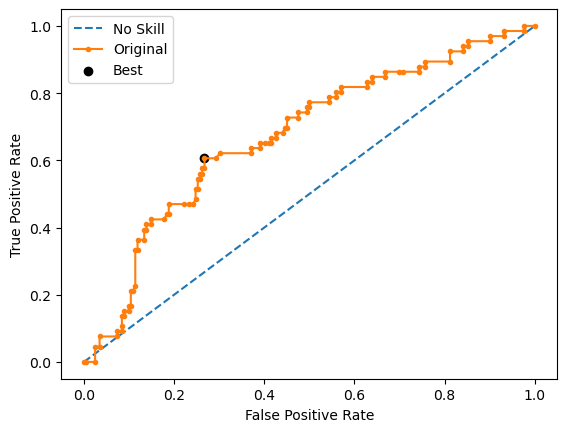

Run 2 - Random State: 1
Test G-mean: 0.5841952827718153
Best Threshold=0.457776, G-Mean=0.616


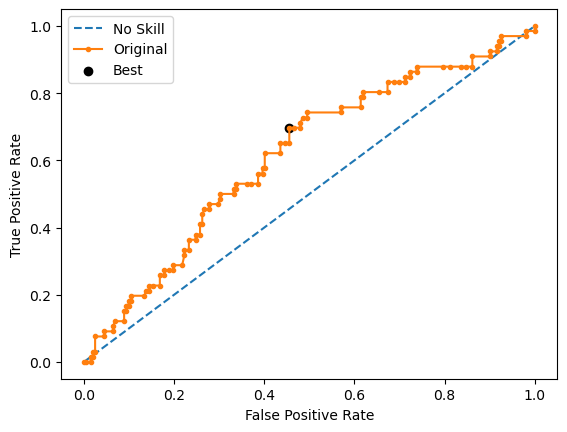

Run 3 - Random State: 2
Test G-mean: 0.6063718072905993
Best Threshold=0.508422, G-Mean=0.616


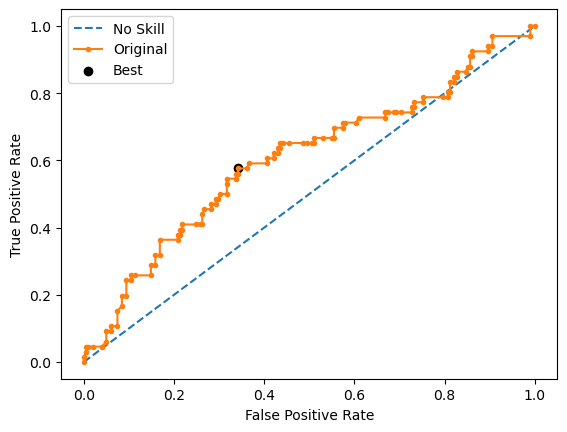

Run 4 - Random State: 3
Test G-mean: 0.644334165361162
Best Threshold=0.497775, G-Mean=0.648


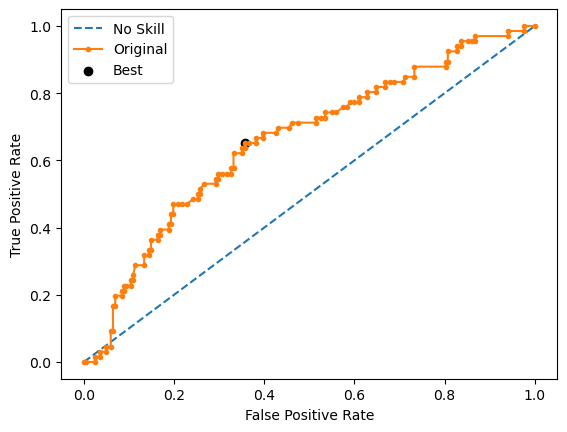

Run 5 - Random State: 4
Test G-mean: 0.6275263970048541
Best Threshold=0.484426, G-Mean=0.635


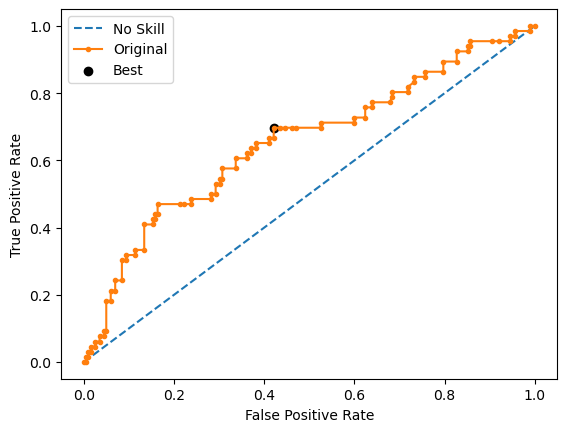

Ave Test G-mean: 0.6218287675230231
Stdev Test G-mean: 0.02652138884785633
Ave Test Specificity: 0.6485148514851485
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8313012276991074
Ave Test Accuracy: 0.6358208955223881
Ave Test Precision: 0.3570387044548672
Ave Test F1-Score: 0.4466619339413196
Ave Runtime: 0.19590449333190918


In [288]:
ho_t08_xgb_gs, ho_t08_xgb_be, ho_t08_xgb_model_info, ho_t08_xgb_metrics_df = xgb_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6919902	total: 1.94ms	remaining: 1.93s
1:	learn: 0.6910596	total: 3.72ms	remaining: 1.85s
2:	learn: 0.6904154	total: 5.02ms	remaining: 1.67s
3:	learn: 0.6893298	total: 6.74ms	remaining: 1.68s
4:	learn: 0.6880167	total: 8.41ms	remaining: 1.67s
5:	learn: 0.6868941	total: 10.1ms	remaining: 1.67s
6:	learn: 0.6859046	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6851172	total: 13.5ms	remaining: 1.67s
8:	learn: 0.6846377	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6838396	total: 16.9ms	remaining: 1.67s
10:	learn: 0.6830388	total: 18.6ms	remaining: 1.67s
11:	learn: 0.6817997	total: 20.5ms	remaining: 1.68s
12:	learn: 0.6811250	total: 22.1ms	remaining: 1.68s
13:	learn: 0.6803405	total: 23.6ms	remaining: 1.66s
14:	learn: 0.6795190	total: 25.3ms	remaining: 1.66s
15:	learn: 0.6786109	total: 27ms	remaining: 1.66s
16:	learn: 0.6777963	total: 28.6ms	remaining: 1.66s
17:	learn: 0.6776718	total: 29.4ms	re

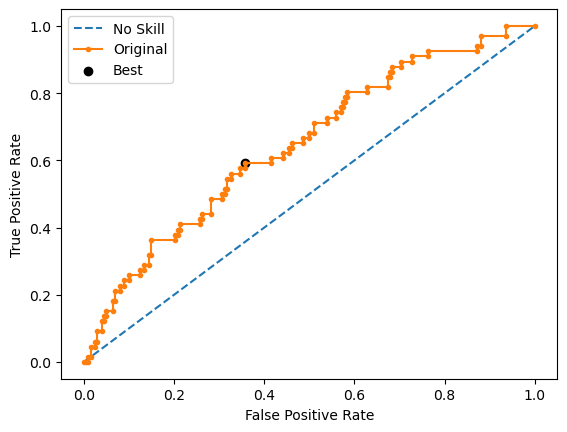

Learning rate set to 0.006922
0:	learn: 0.6914947	total: 2.43ms	remaining: 2.43s
1:	learn: 0.6902797	total: 5.23ms	remaining: 2.61s
2:	learn: 0.6895612	total: 8.84ms	remaining: 2.94s
3:	learn: 0.6881041	total: 12.1ms	remaining: 3s
4:	learn: 0.6871697	total: 15.5ms	remaining: 3.09s
5:	learn: 0.6860296	total: 18.7ms	remaining: 3.09s
6:	learn: 0.6848762	total: 22.1ms	remaining: 3.13s
7:	learn: 0.6838265	total: 24.8ms	remaining: 3.07s
8:	learn: 0.6823009	total: 27.5ms	remaining: 3.02s
9:	learn: 0.6812723	total: 30ms	remaining: 2.97s
10:	learn: 0.6799702	total: 32.4ms	remaining: 2.92s
11:	learn: 0.6782471	total: 35.1ms	remaining: 2.89s
12:	learn: 0.6767136	total: 37.2ms	remaining: 2.82s
13:	learn: 0.6753772	total: 39.3ms	remaining: 2.77s
14:	learn: 0.6740560	total: 41.1ms	remaining: 2.7s
15:	learn: 0.6733935	total: 43ms	remaining: 2.65s
16:	learn: 0.6724746	total: 44.9ms	remaining: 2.6s
17:	learn: 0.6715246	total: 46.9ms	remaining: 2.56s
18:	learn: 0.6703512	total: 48.7ms	remaining: 2.52s
1

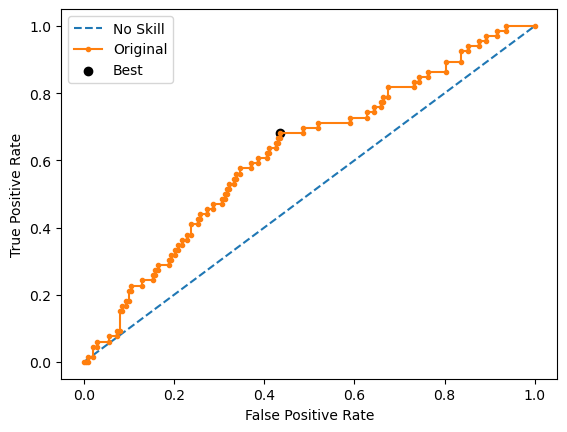

Learning rate set to 0.006922
0:	learn: 0.6916007	total: 2.8ms	remaining: 2.79s
1:	learn: 0.6906099	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6896611	total: 6.39ms	remaining: 2.12s
3:	learn: 0.6885565	total: 8.21ms	remaining: 2.04s
4:	learn: 0.6874643	total: 9.97ms	remaining: 1.98s
5:	learn: 0.6855903	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6845379	total: 14.1ms	remaining: 2s
7:	learn: 0.6830962	total: 16ms	remaining: 1.99s
8:	learn: 0.6819924	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6802917	total: 19.7ms	remaining: 1.95s
10:	learn: 0.6793248	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6779212	total: 23ms	remaining: 1.9s
12:	learn: 0.6760875	total: 24.7ms	remaining: 1.87s
13:	learn: 0.6749760	total: 26.3ms	remaining: 1.85s
14:	learn: 0.6737902	total: 27.8ms	remaining: 1.83s
15:	learn: 0.6727685	total: 29.6ms	remaining: 1.82s
16:	learn: 0.6716598	total: 31.3ms	remaining: 1.81s
17:	learn: 0.6705489	total: 32.8ms	remaining: 1.79s
18:	learn: 0.6692961	total: 34.5ms	remaining: 1.78s
1

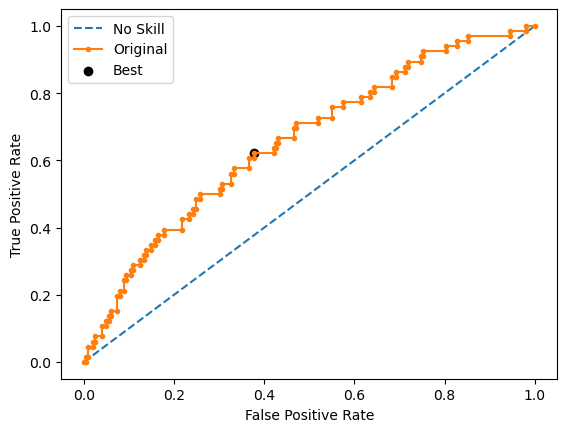

Learning rate set to 0.006922
0:	learn: 0.6921436	total: 2.39ms	remaining: 2.39s
1:	learn: 0.6907547	total: 4.16ms	remaining: 2.07s
2:	learn: 0.6900516	total: 6ms	remaining: 2s
3:	learn: 0.6892551	total: 7.88ms	remaining: 1.96s
4:	learn: 0.6882943	total: 9.63ms	remaining: 1.92s
5:	learn: 0.6872237	total: 11.4ms	remaining: 1.9s
6:	learn: 0.6865761	total: 13ms	remaining: 1.84s
7:	learn: 0.6848859	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6838586	total: 16.3ms	remaining: 1.79s
9:	learn: 0.6831848	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6820082	total: 19.5ms	remaining: 1.76s
11:	learn: 0.6806971	total: 21.2ms	remaining: 1.74s
12:	learn: 0.6795370	total: 22.8ms	remaining: 1.73s
13:	learn: 0.6787919	total: 24.5ms	remaining: 1.73s
14:	learn: 0.6776370	total: 26.1ms	remaining: 1.71s
15:	learn: 0.6763227	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6756414	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6746330	total: 31.1ms	remaining: 1.7s
18:	learn: 0.6734429	total: 32.9ms	remaining: 1.7s
19:	

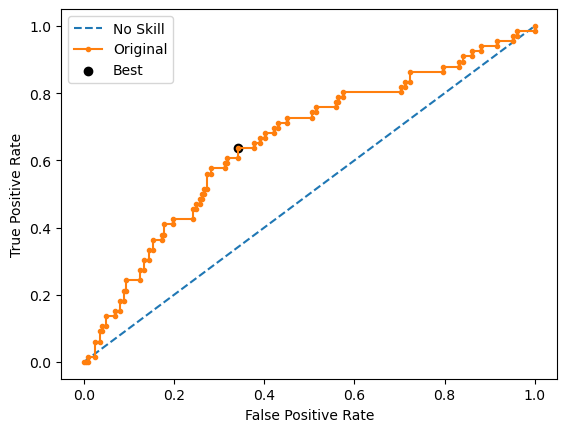

Learning rate set to 0.006922
0:	learn: 0.6914900	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6902983	total: 4.27ms	remaining: 2.13s
2:	learn: 0.6895627	total: 5.91ms	remaining: 1.96s
3:	learn: 0.6890878	total: 7.64ms	remaining: 1.9s
4:	learn: 0.6880513	total: 9.66ms	remaining: 1.92s
5:	learn: 0.6862832	total: 11.2ms	remaining: 1.85s
6:	learn: 0.6854552	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6838742	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6822738	total: 16.2ms	remaining: 1.78s
9:	learn: 0.6812647	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6803056	total: 19.3ms	remaining: 1.74s
11:	learn: 0.6787749	total: 20.9ms	remaining: 1.72s
12:	learn: 0.6771524	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6759314	total: 24.1ms	remaining: 1.7s
14:	learn: 0.6745352	total: 25.7ms	remaining: 1.69s
15:	learn: 0.6733417	total: 27.3ms	remaining: 1.68s
16:	learn: 0.6725769	total: 29.2ms	remaining: 1.69s
17:	learn: 0.6714911	total: 30.8ms	remaining: 1.68s
18:	learn: 0.6702564	total: 32.6ms	remaining: 

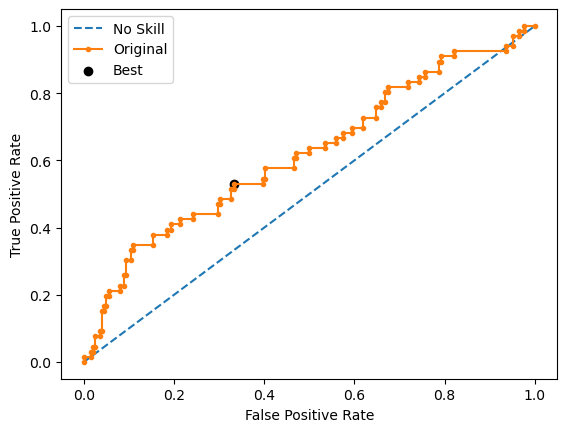

Ave Test G-mean: 0.6129672258498672
Stdev Test G-mean: 0.014948695302344868
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.593939393939394
Ave Test NPV: 0.8271293923959459
Ave Test Accuracy: 0.6238805970149255
Ave Test Precision: 0.3461636342354292
Ave Test F1-Score: 0.43716737663412797
Ave Runtime: 1.8529942512512207


In [289]:
ho_t08_catboost_gs, ho_t08_catboost_be, ho_t08_catboost_model_info, ho_t08_catboost_metrics_df = catboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6002747134052935
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6277561829255867
Std Train Score (G-mean) 0.01965083989099662
GridSearchCV Runtime: 363.1061005592346 secs
Run 1 - Random State: 0
Test G-mean: 0.6350120660526092
Best Threshold=0.515332, G-Mean=0.652


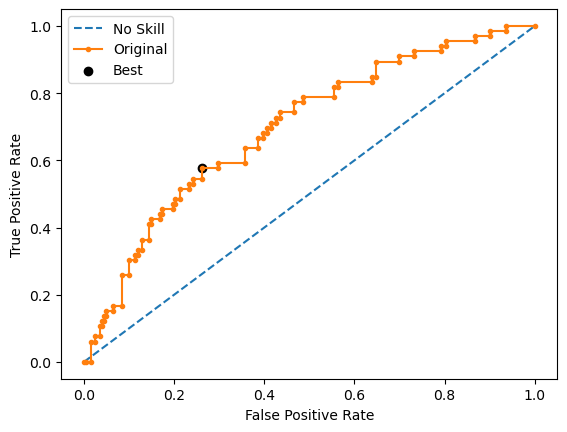

Run 2 - Random State: 1
Test G-mean: 0.5896904047696111
Best Threshold=0.498371, G-Mean=0.603


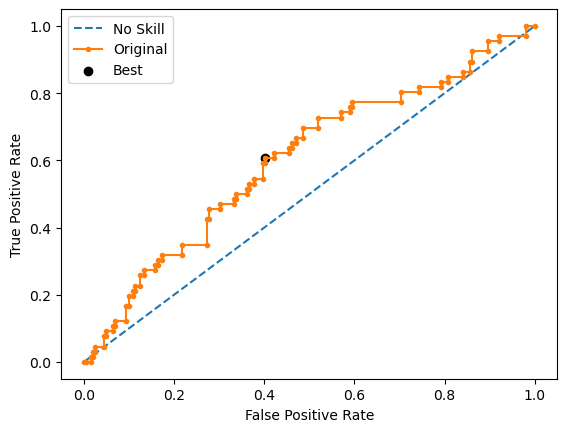

Run 3 - Random State: 2
Test G-mean: 0.5823949848615106
Best Threshold=0.523332, G-Mean=0.628


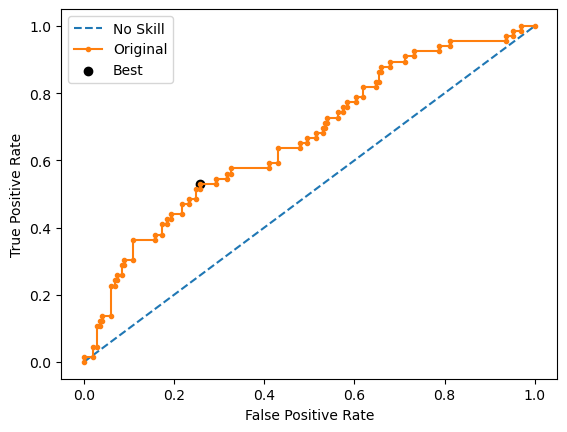

Run 4 - Random State: 3
Test G-mean: 0.659350797639189
Best Threshold=0.495704, G-Mean=0.668


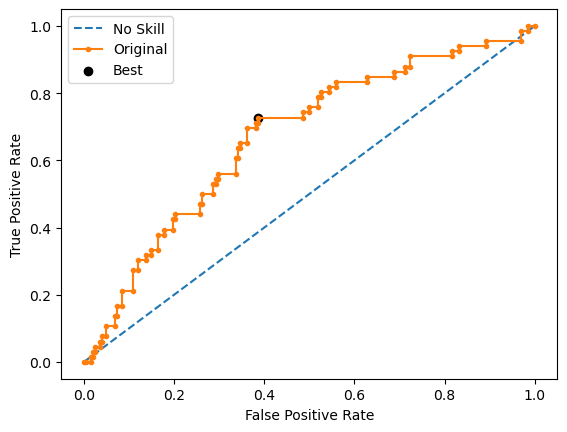

Run 5 - Random State: 4
Test G-mean: 0.5823305855706784
Best Threshold=0.536047, G-Mean=0.611


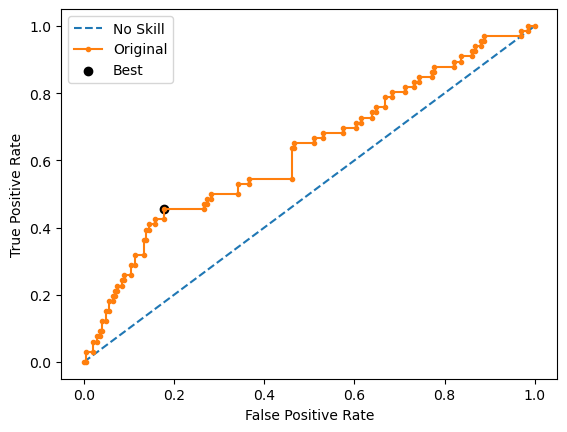

Ave Test G-mean: 0.6097557677787196
Stdev Test G-mean: 0.03535858963192227
Ave Test Specificity: 0.6257425742574257
Ave Test Recall: 0.596969696969697
Ave Test NPV: 0.8267716915172703
Ave Test Accuracy: 0.6186567164179105
Ave Test Precision: 0.3423872649609211
Ave Test F1-Score: 0.43455995572334
Ave Runtime: 0.5589699268341064


In [290]:
ho_t08_rf_gs, ho_t08_rf_be, ho_t08_rf_model_info, ho_t08_rf_metrics_df = rf_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [291]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t08_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t08_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t08_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
6,LightGBM,0.625865,0.028014,0.596557,0.746088,0.618812,0.633333
7,Extreme Gradient Boosting (XGBoost),0.621829,0.026521,0.594860,0.853936,0.648515,0.596970
3,Decision Tree,0.614960,0.029296,0.596613,0.552078,0.633663,0.600000
4,Random Forest,0.609756,0.035359,0.600275,0.627756,0.625743,0.596970
8,AdaBoost,0.590183,0.016354,0.568463,0.943962,0.618812,0.563636
2,Logistic Regression,0.586591,0.028416,0.607898,NaN,0.626733,0.551515
5,Gradient Boosting Machine (GBM),0.560668,0.027565,0.555418,0.873986,0.670297,0.469697
0,k-Nearest Neighbors,0.518880,0.036668,0.559415,0.686828,0.485149,0.557576
1,SVM Classifier,0.517793,0.028331,0.527184,0.251731,0.590099,0.457576


# HO-T07 Runs: Retain Top 30 Features

In [ ]:
model = ho_t07_logreg_be.named_steps['classifier']
coefficients = model.coef_[0]

# 3. Get Absolute Values of Coefficients
abs_coefficients = abs(coefficients)

# 4. Sort Features Based on Absolute Coefficient Values
sorted_idx = abs_coefficients.argsort()[::-1]
top_20_features = sorted_idx[:20]

# 5. Retain Only the Top 20 Features and Extract the Feature Names
feature_names = list(ho_t07_X_num.columns)  # Assuming X is a DataFrame before train-test split
top_20_feature_names = [feature_names[i] for i in top_20_features]

# Place all dropped features into a list
dropped_features = [feature for feature in feature_names if feature not in top_20_feature_names]

# 6. (Optional) Print the Top 20 Features and Dropped Features
print("Top 20 Features:", top_20_feature_names)
print("Dropped Features:", dropped_features)

sorted_indices = abs_coefficients.argsort()[::-1]
top_20_indices = sorted_indices[:20]
top_20_importances = coefficients[top_20_indices]
# Plot
plt.figure(figsize=(10, 8))
plt.barh(top_20_feature_names, top_20_importances, align='center')
plt.xlabel('Importance')
plt.title('Top 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis()  # To display the feature with the highest importance at the top
plt.show()

ho_t08_full = ho_t07_full.copy()
ho_t08_logreg = ho_t08_full.copy().drop(columns=dropped_features).drop(['gender', 'province', 'job'], axis=1)

In [ ]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08_logreg, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


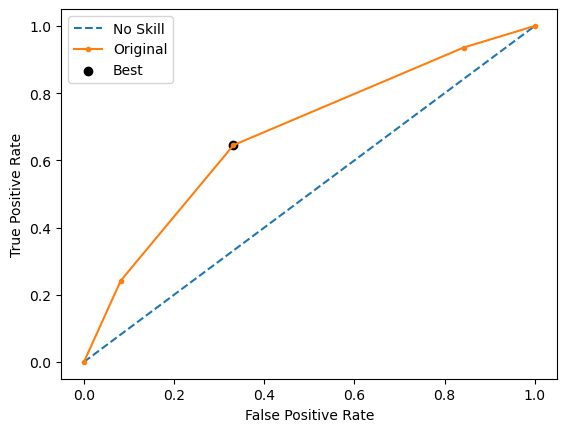

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


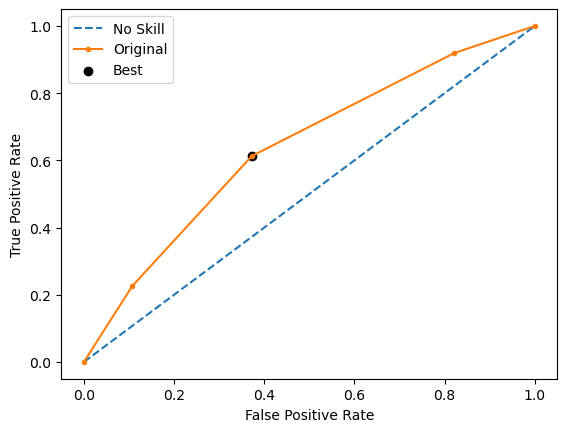

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


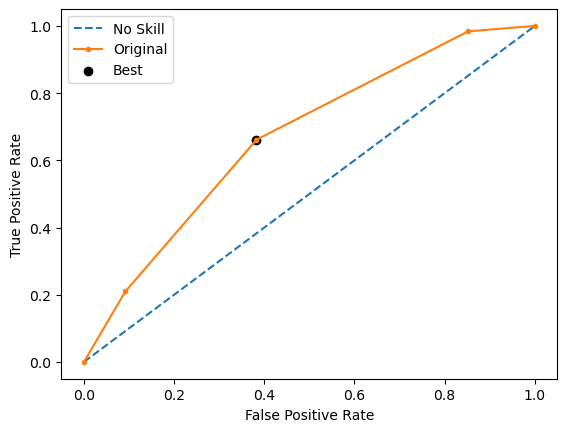

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


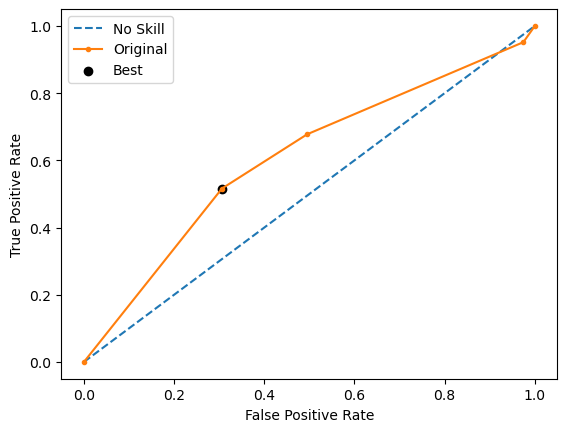

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


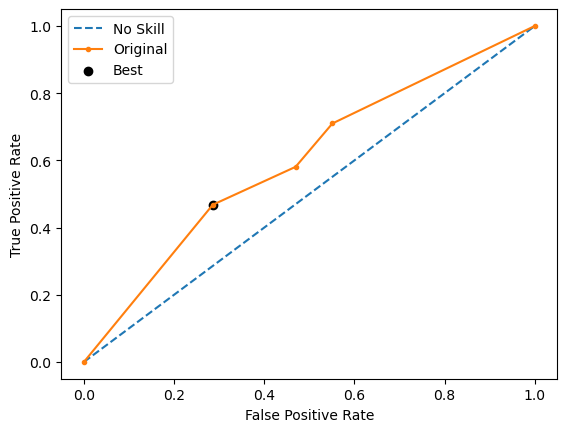

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

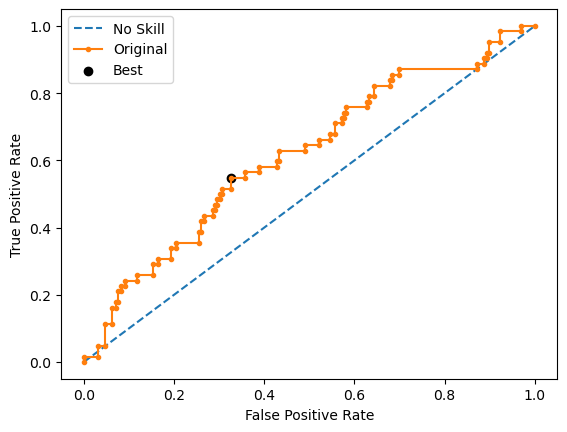

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


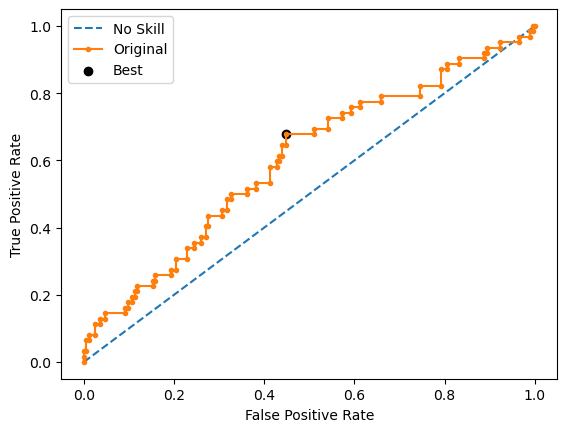

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


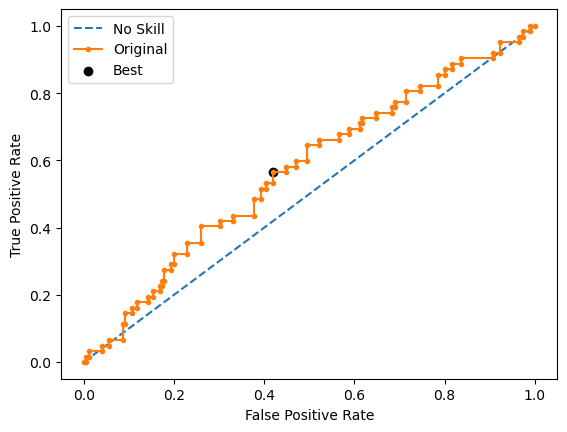

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


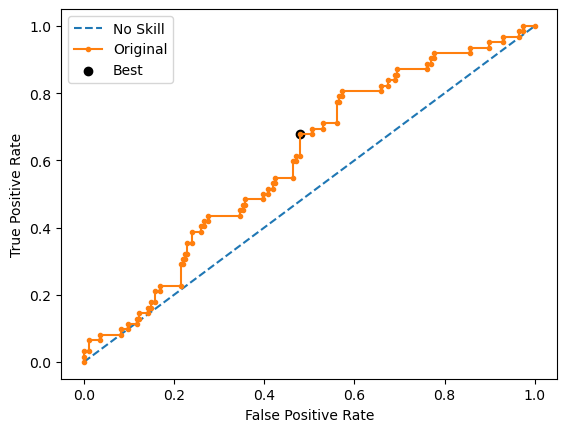

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


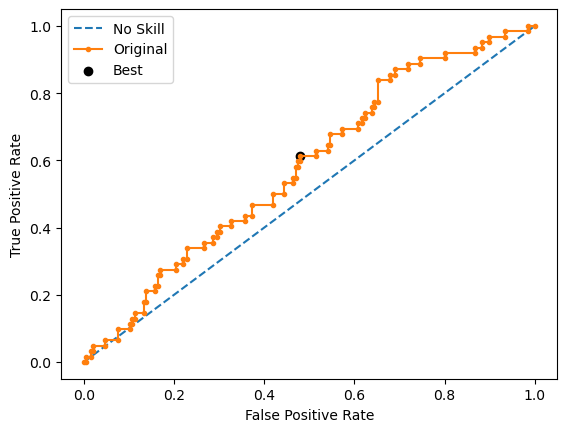

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


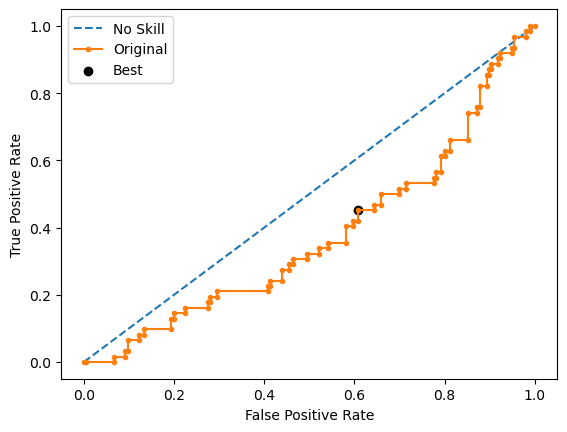

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


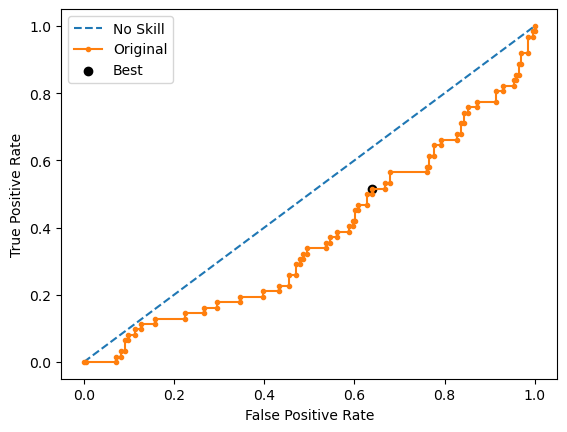

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


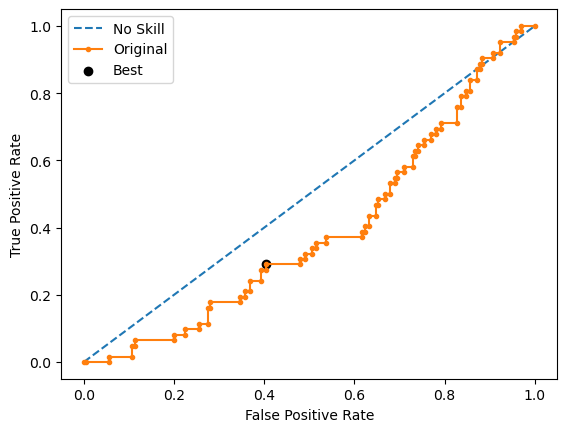

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


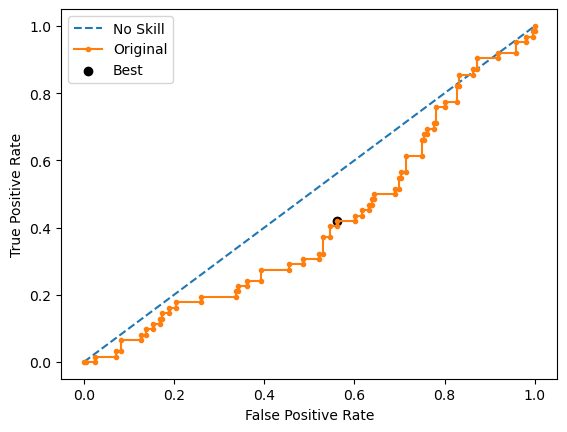

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


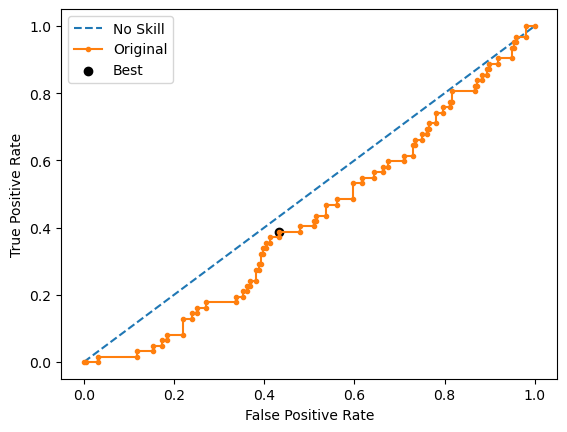

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

In [ ]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


In [ ]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# HO-T07 Runs

In [ ]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# Best Model Explainability Methods

In [301]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Access the trained Random Forest model from the dictionary
model = ho_t02_xgb_be.named_steps.classifier

# Ensure the model has been trained
if hasattr(model, "estimators_"):
    # Visualize the first tree
    plt.figure(figsize=(20, 10))
    plot_tree(model.estimators_[0], filled=True, feature_names=X_train.columns, class_names=True, rounded=True)
    plt.show()
else:
    print("The model hasn't been trained yet.")

The model hasn't been trained yet.


In [302]:
from sklearn.tree import _tree

def tree_rules(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            yield f"{indent}if {name} <= {threshold:.2f}:"
            yield from recurse(tree_.children_left[node], depth + 1)
            yield f"{indent}else:  # if {name} > {threshold:.2f}"
            yield from recurse(tree_.children_right[node], depth + 1)
        else:
            yield f"{indent}return Class {tree_.value[node].argmax()}"

    return "\n".join(recurse(0, 1))

In [303]:
model = ho_t02_xgb_be.named_steps.classifier
rules = tree_rules(model.estimators_[0], X_train.columns)
print(rules)

AttributeError: 'XGBClassifier' object has no attribute 'estimators_'

In [304]:
from xgboost import plot_tree

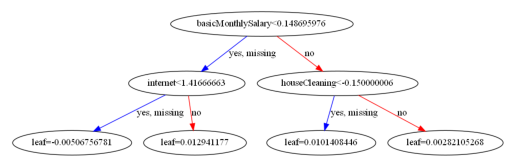

In [313]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)

model.named_steps['classifier'].get_booster().feature_names = X.columns.to_list()

plot_tree(model.named_steps['classifier'],
          rank_dir='LR'); plt.show()

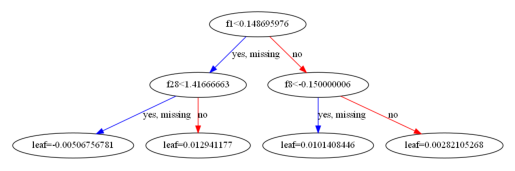

In [118]:
# model.named_steps['classifier'].feature_importances_

Permutation explainer: 269it [00:13,  4.83it/s]                         


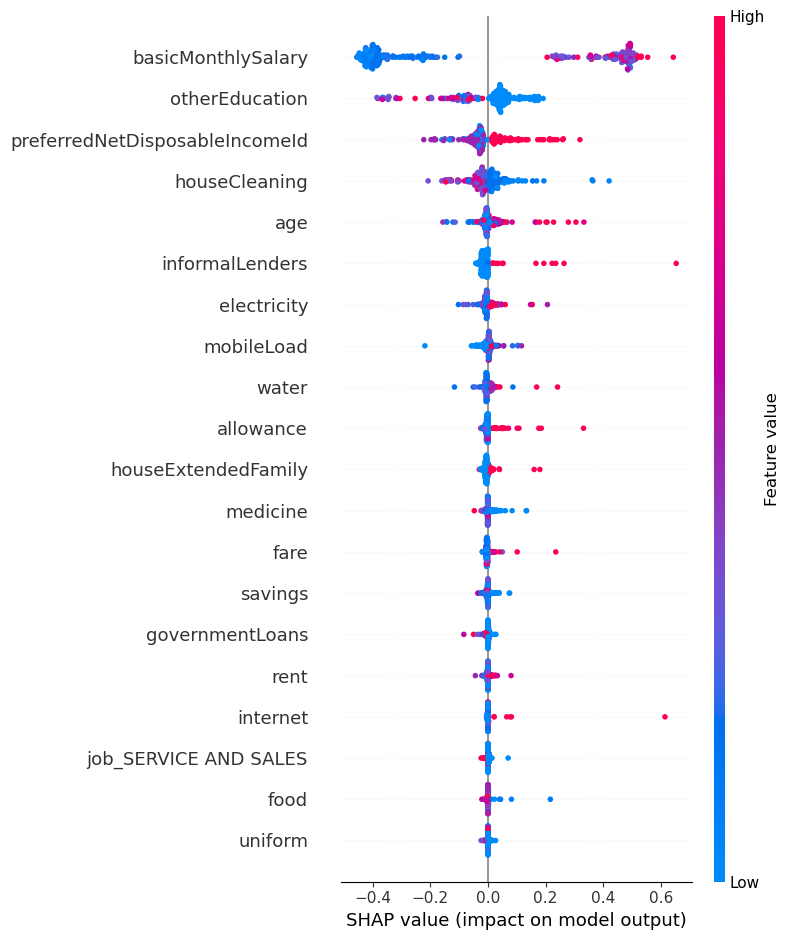

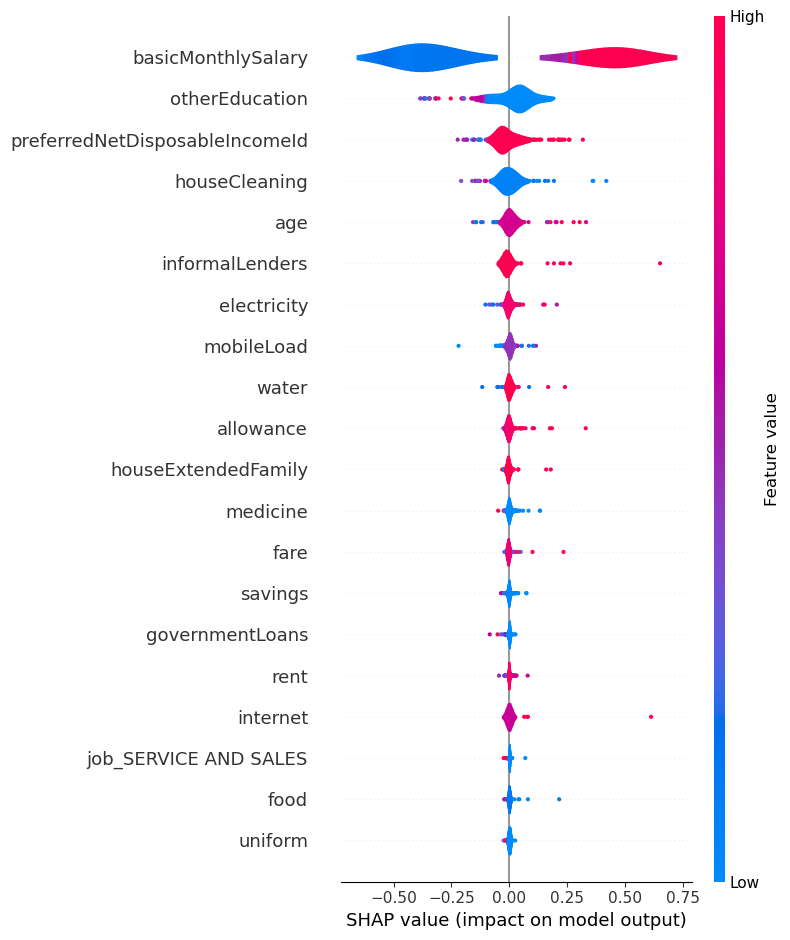

In [325]:
df = ho_t02
# model = ho_t02_xgb_be.named_steps['classifier']
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)
# explainer = shap.TreeExplainer(model=model,
#                                data=X_test,
#                                model_output='raw',
# #                                feature_perturbation='tree_path_dependent'
#                               )

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)
# shap_values = explainer.shap_values(X_test)


feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

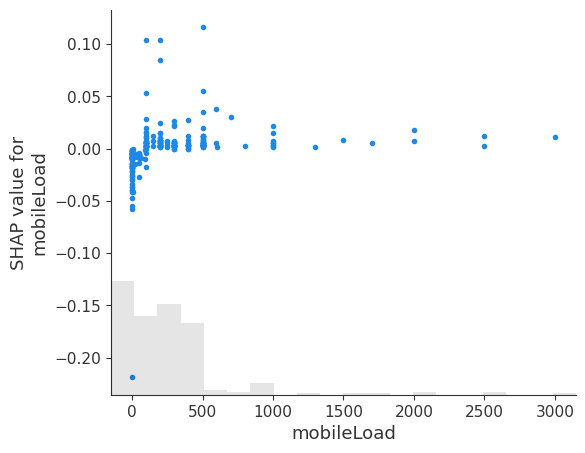

In [354]:
feature_name = 'mobileLoad' # Replace with the name of the feature you're interested in

shap.plots.scatter(shap_values[:, feature_name])
plt.show()

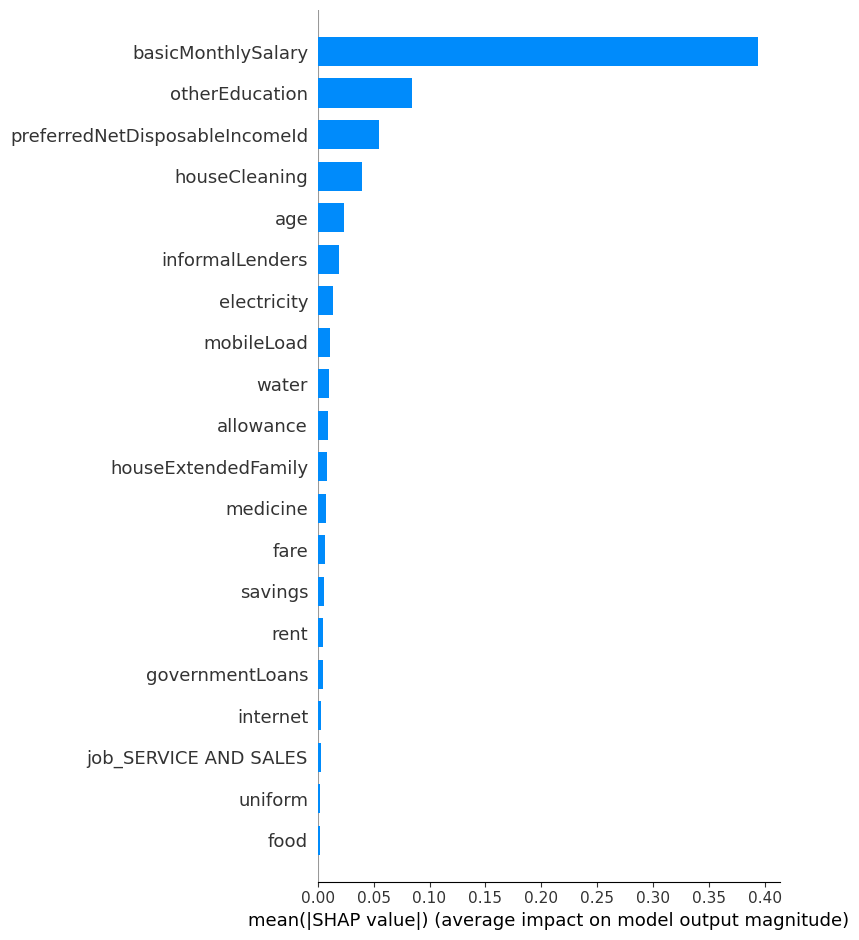

In [315]:
shap.summary_plot(shap_values, feature_names=feature_names,
                  plot_type='bar')

Permutation explainer: 269it [00:13,  4.92it/s]                         


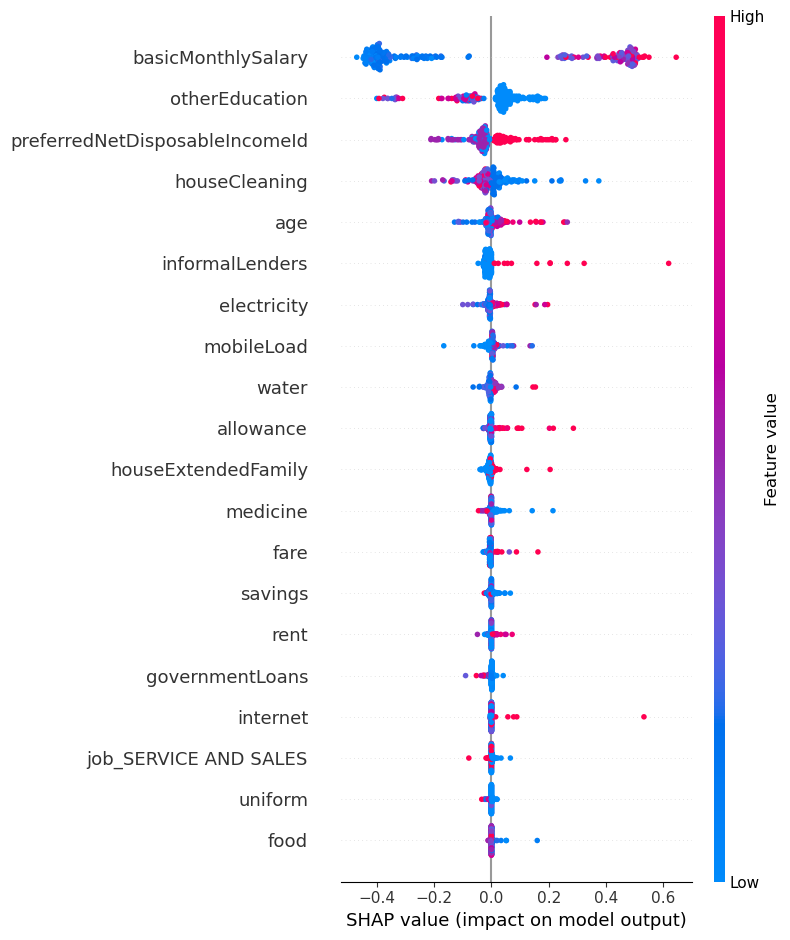

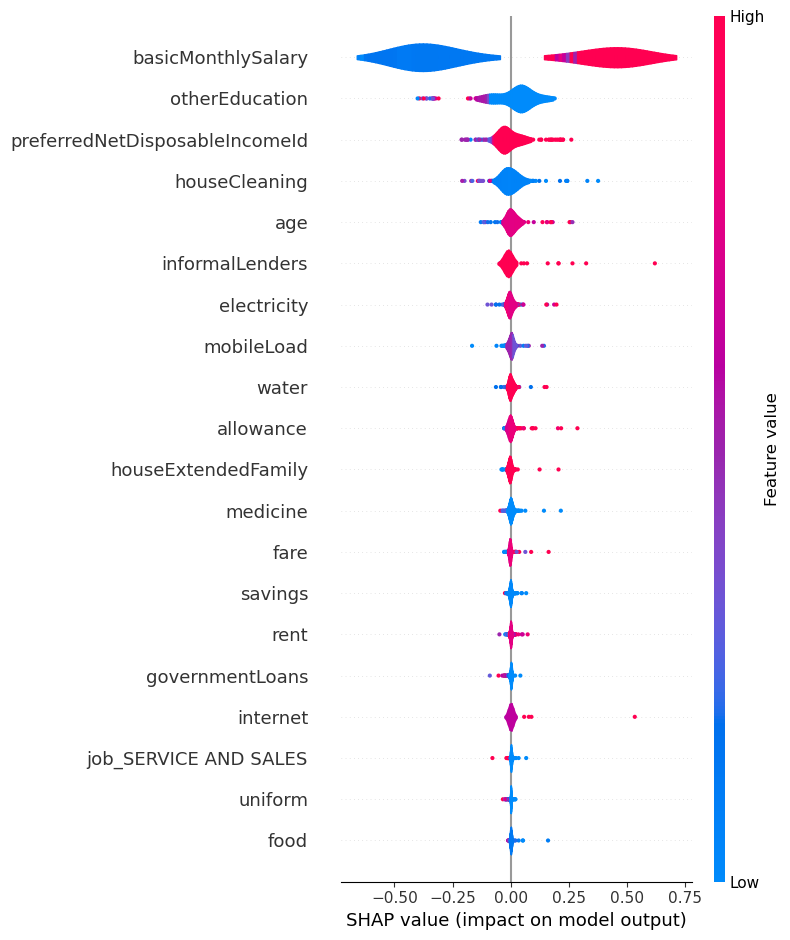

In [296]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)

feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

In [47]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [355]:
ho_t02
df = ho_t02.copy()
df['userId'] = df['userId'].astype('str')
df = adjust_data_types(df)

# ho_t03_dice['gender_MALE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_CAVITE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_METRO MANILA'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_ASSOCIATE PROFESSIONAL'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_SERVICE AND SALES'] = ho_t03_dice['userId'].astype('str')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [359]:
items_list = [
    'food', 'hygiene', 'houseCleaning',
    'fare', 'parking', 'gasoline', 'tuition', 'allowance',
    'uniform', 'otherEducation', 'emergency', 'medicine',
    'water', 'electricity', 'rent', 'repair', 
    'dineOut', 'leisure', 'personalCare', 'clothing',
    'mobileLoad', 'internet', 
    'smoking', 'gambling',
]

result_dict = {}
for item in items_list:
    result_dict[item] = [0, query_instance[item].values[0]]

print(result_dict)

{'food': [0, 3000.0], 'hygiene': [0, 1000.0], 'houseCleaning': [0, 1000.0], 'fare': [0, 2000.0], 'parking': [0, 0.0], 'gasoline': [0, 0.0], 'tuition': [0, 0.0], 'allowance': [0, 0.0], 'uniform': [0, 0.0], 'otherEducation': [0, 0.0], 'emergency': [0, 1000.0], 'medicine': [0, 1000.0], 'water': [0, 500.0], 'electricity': [0, 1500.0], 'rent': [0, 500.0], 'repair': [0, 0.0], 'dineOut': [0, 0.0], 'leisure': [0, 0.0], 'personalCare': [0, 0.0], 'clothing': [0, 1000.0], 'mobileLoad': [0, 2000.0], 'internet': [0, 0.0], 'smoking': [0, 0.0], 'gambling': [0, 0.0]}


In [419]:
df = df
model = ho_t02_xgb_be


X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
# exp = dice_ml.Dice(d, m, method='genetic')
exp = dice_ml.Dice(d, m)

In [421]:
max_limit = len(X_test[X_test['home_ownership_class'] == 0])

init = 40
for i in range(init, max_limit):
    try:
        # Generate counterfactual examples
        query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
        dice_exp = exp.generate_counterfactuals(
            query_instance, total_CFs=1,
            desired_class="opposite", verbose=True,
           features_to_vary=[
                'food', 'hygiene', 'houseCleaning',
                'fare', 'parking', 'gasoline', 'tuition', 'allowance',
                'uniform', 'otherEducation', 'emergency', 'medicine',
                'water', 'electricity', 'rent', 'repair', 
                'dineOut', 'leisure', 'personalCare', 'clothing',
                'mobileLoad', 'internet', 
                'smoking', 'gambling', 'savings', 'payFamilySupport'
            ],
            permitted_range=result_dict
        )
        # Visualize counterfactual explanation
        dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                        show_only_changes=True)
        break
    except Exception as e:
        print(f"Error at i={i}: {e}")
        continue


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=40: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=41: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1,1,1,1,0,1,0,1,0,0,0,0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0.0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,159.3,-,-,-,-,-,-,95.9,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0


In [422]:
df = df
model = ho_t02_xgb_be
i = 42

X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
exp = dice_ml.Dice(d, m, method='genetic')
# exp = dice_ml.Dice(d, m)


# Generate counterfactual examples
query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
dice_exp = exp.generate_counterfactuals(
    query_instance, total_CFs=30,
    desired_class="opposite", verbose=True,
   features_to_vary=[
        'food', 'hygiene', 'houseCleaning',
        'fare', 'parking', 'gasoline', 'tuition', 'allowance',
        'uniform', 'otherEducation', 'emergency', 'medicine',
        'water', 'electricity', 'rent', 'repair', 
        'dineOut', 'leisure', 'personalCare', 'clothing',
        'mobileLoad', 'internet', 
        'smoking', 'gambling', 'savings', 'payFamilySupport'
    ],
    permitted_range=result_dict
)

# Visualize counterfactual explanation
dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                show_only_changes=True)

  0%|          | 0/1 [00:00<?, ?it/s]

Initializing initial parameters to the genetic algorithm...
Initialization complete! Generating counterfactuals...


100%|██████████| 1/1 [00:16<00:00, 16.78s/it]

Only 16 (required 30)  Diverse Counterfactuals found for the given configuation, perhaps  change the query instance or the features to vary...; total time taken: 00 min 16 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,331.6,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,3000.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,300.0,0.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,3000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,30.6,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,-,500.0,-,-,-,-,-,-,0.0,300.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1799.1,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,300.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1282.3,-,-,-,-,-,-,0.0,0.0,-,1000.0,-,500.0,1000.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,2450.2,-,-,-,-,-,-,0.0,0.0,-,496.0,-,300.0,750.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1982.1,-,-,1000.0,-,-,-,0.0,0.0,-,500.0,500.0,350.0,1000.0,-,-,-,-,-,0.0,-,50.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,805.2,-,-,0.0,-,-,-,0.0,0.0,-,500.0,500.0,500.0,1000.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0


In [410]:
ho_t02[
    (ho_t02['age'] == 40) &
    (ho_t02['basicMonthlySalary'] == 30000) &
    (ho_t02['monthlyFamilyIncome'] == 30000) &
    (ho_t02['residentsCount'] == 5)
]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
69,10492,"GARCIA, FRANCO",40,30000,2,1,5,30000.0,4000,2000,1000,0,0,400,0,500,500,500,5000,2000,250,1000,4000,0,0,500,500,200,500,0,1000,0,0,0,0,374,0,0,0,0,0,1000,0,0,1,1,0,1,0,0,1,0,0,0,0


In [394]:
ho_t02[ho_t02['userId'] == 11666]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
607,11742,"DAYAO, ANGELO",27,26000,2,3,4,35000.0,5000,5000,5000,0,0,0,0,0,0,3000,3000,0,1000,1000,5000,0,0,0,0,500,0,0,0,0,0,0,0,0,0,0,0,0,0,3000,0,0,0,1,0,1,0,0,1,0,1,0,0


In [414]:
# Saving examples to csv
dice_exp.cf_examples_list[0].final_cfs_df.to_csv('new_10492.csv')

In [ ]:
#     permitted_range={'food': [0, query_instance['food'].values[0]]}
#     features_to_vary = [
#         'monthlyVices',
#         'monthlyUtilityBills',
#         'totalMonthlyExpenses',
# #         'monthlyFamilyIncome - totalMonthlyExpenses',
# #         'basicMonthlySalary - totalMonthlyExpenses',
#         'monthlyFamilyIncome / workingFamilyCount',
# #         'monthlyFamilyIncome / residentsCount',
#         'basicMonthlySalary / monthlyFamilyIncome',
#         'totalMonthlyExpenses / basicMonthlySalary',
#         'totalMonthlyExpenses / monthlyFamilyIncome'
#     ]

#     features_to_vary=[
#         'food', 'hygiene', 'houseCleaning',
#         'fare', 'parking', 'gasoline', 'tuition', 'allowance',
#         'uniform', 'otherEducation', 'emergency', 'medicine',
#         'water', 'electricity', 'rent', 'repair', 
#         'dineOut', 'leisure', 'personalCare', 'clothing',
#         'mobileLoad', 'internet', 'vehicleLoan', 'informalLenders',
#         'companyLoan', 'privateLoans', 'governmentLoans',
#         'smoking', 'gambling', 'savings', 'loanSSS', 'payFamilySupport',
#         'houseHasPrivateEmployee', 'houseHasOFW',
#         'houseOnlyFamily', 'houseExtendedFamily'
#     ]
#     features_to_vary=[
#         'water', 'electricity', 'rent',
# #         'preferredNetDisposableIncomeId',
#         'mobileLoad', 'internet'
#     ]

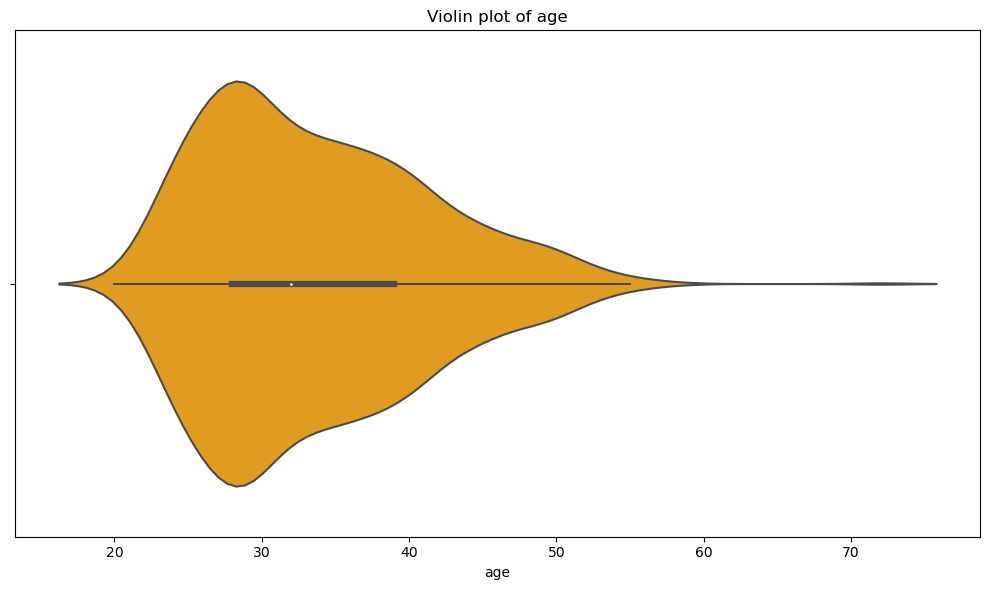

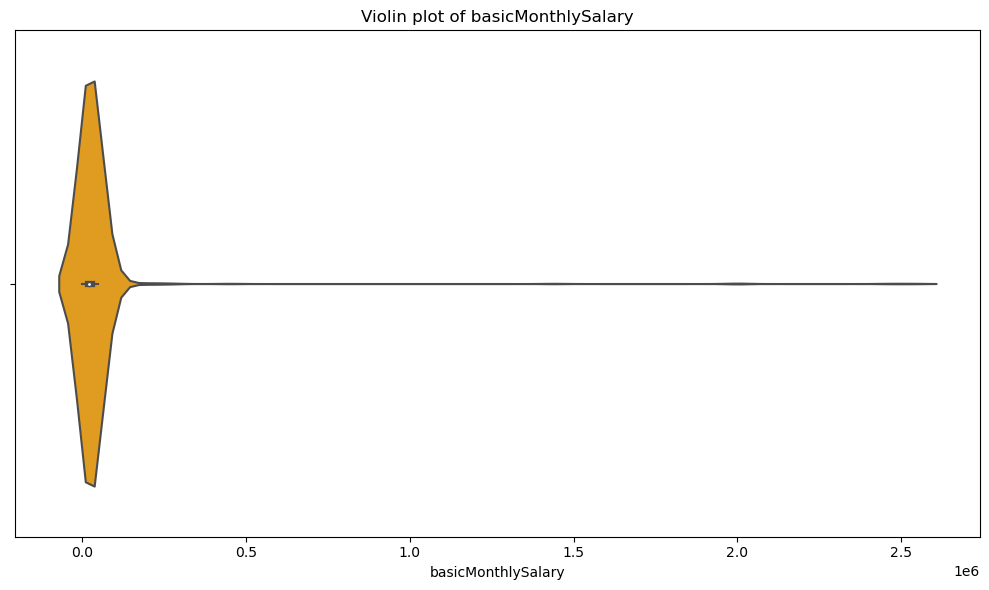

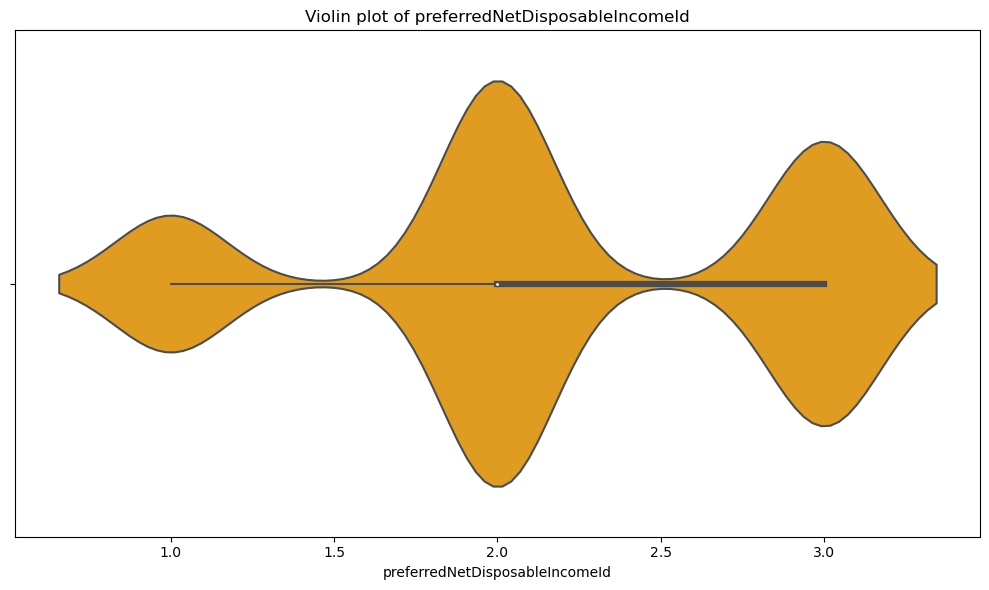

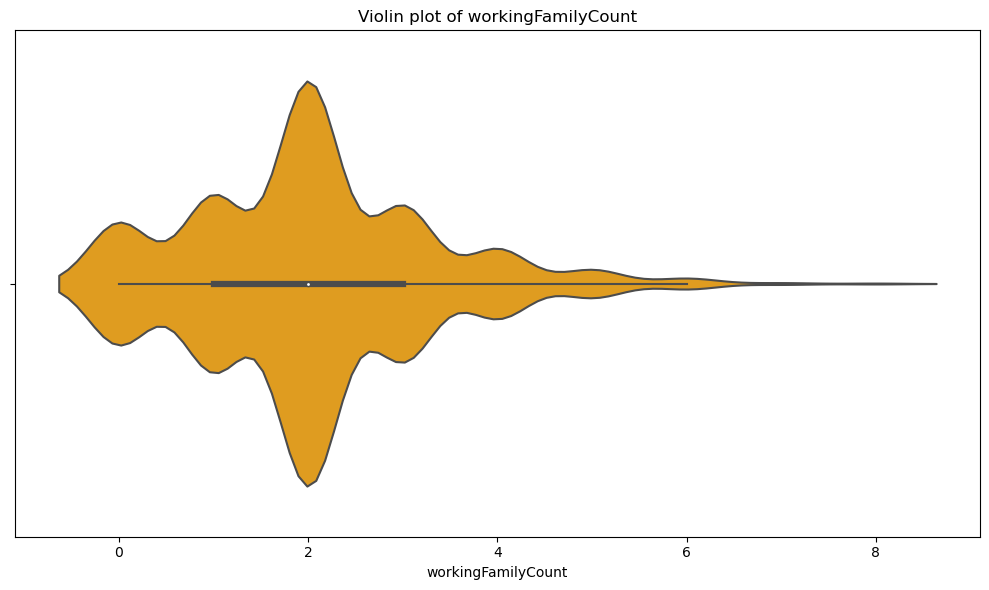

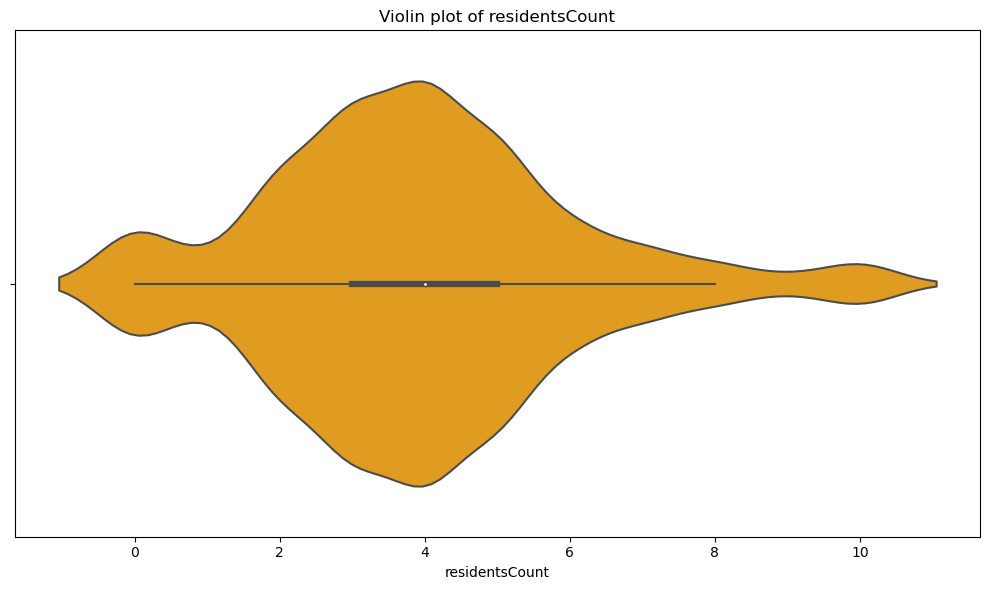

...

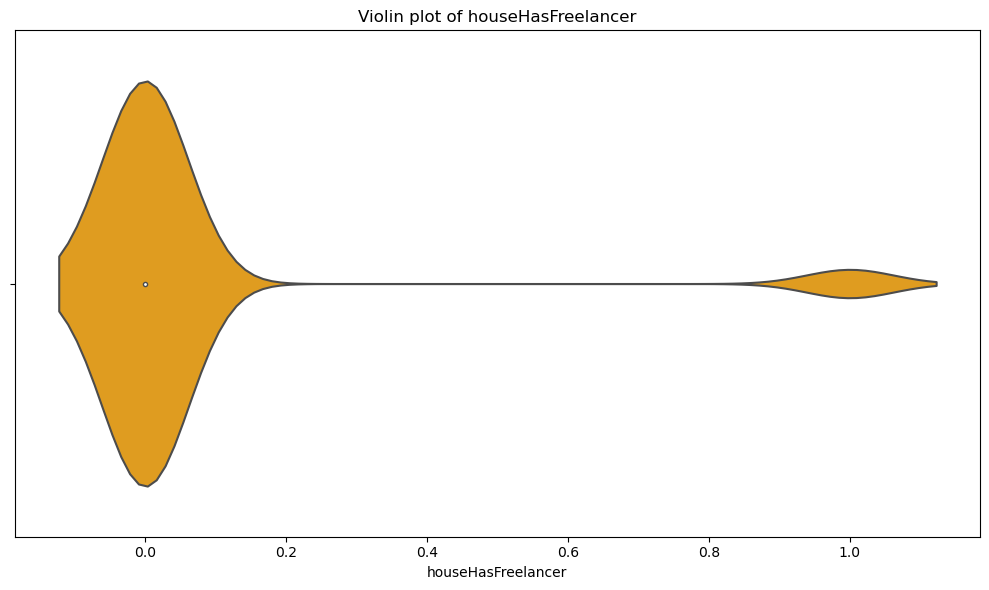

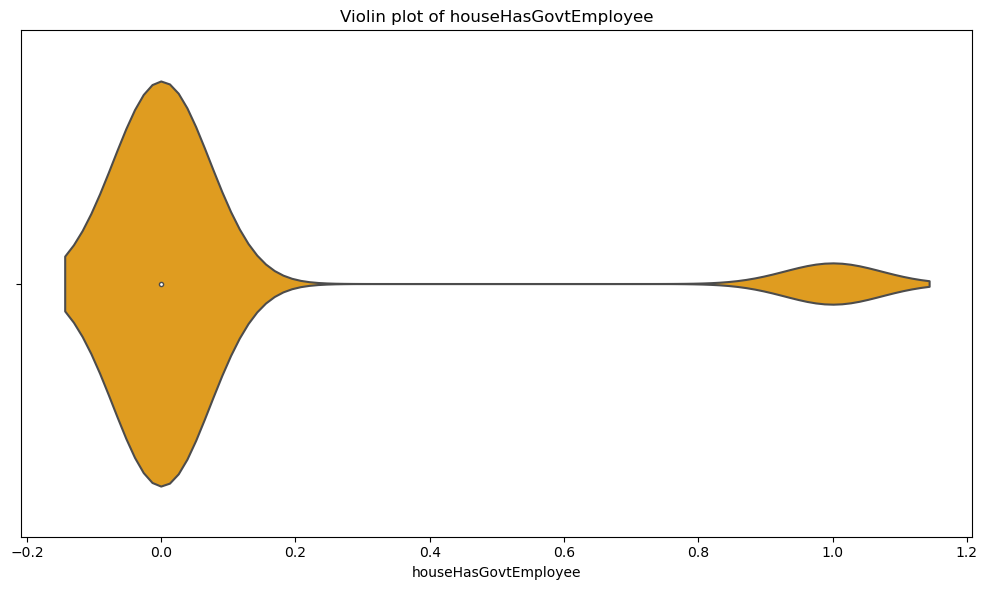

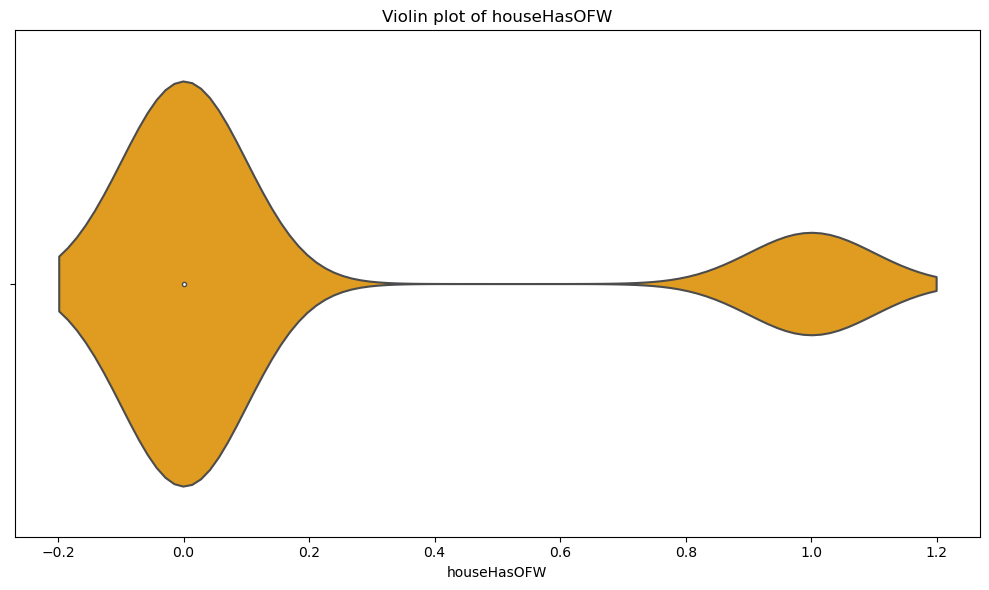

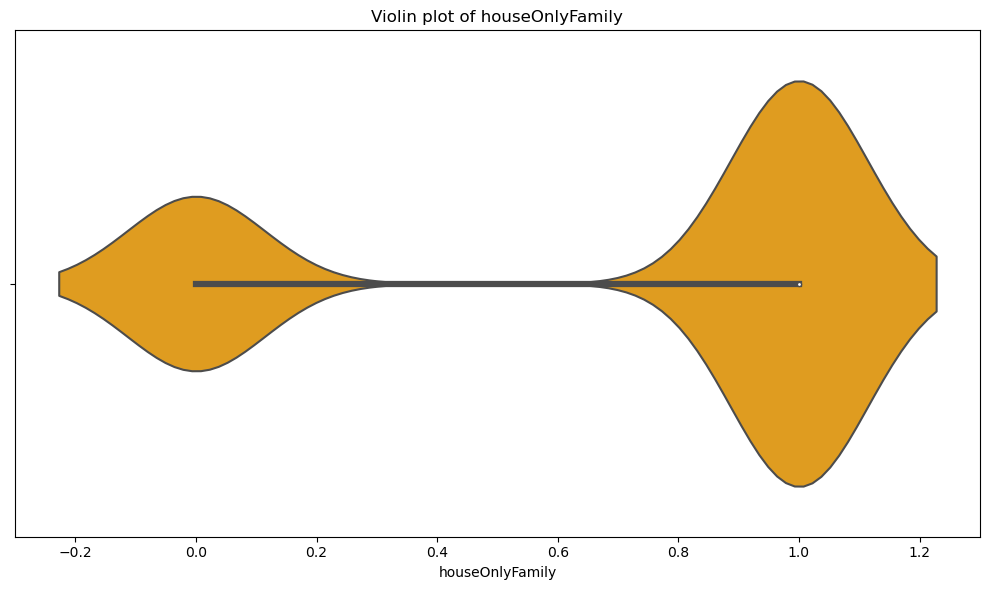

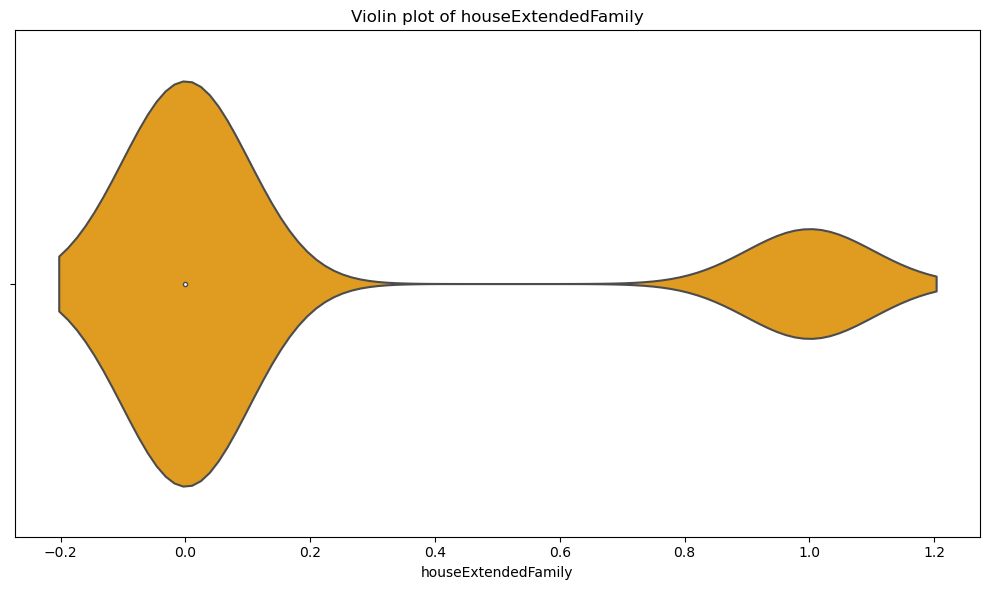

In [435]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your dataframe
df = ho_t01.drop(columns=['userId', 'lastFirstName', 'home_ownership_class', 'gender', 'job', 'province'])
features = df.columns

for feature in features:
    plt.figure(figsize=(10, 6))
    sns.violinplot(x=df[feature], color='orange')
    plt.title('Violin plot of {}'.format(feature))
    plt.tight_layout()
    plt.show()


In [8]:
1/(1+np.exp(-1*0.0101408446))

0.5025351894241549